In [1]:
!pip install scikit-learn pyarrow

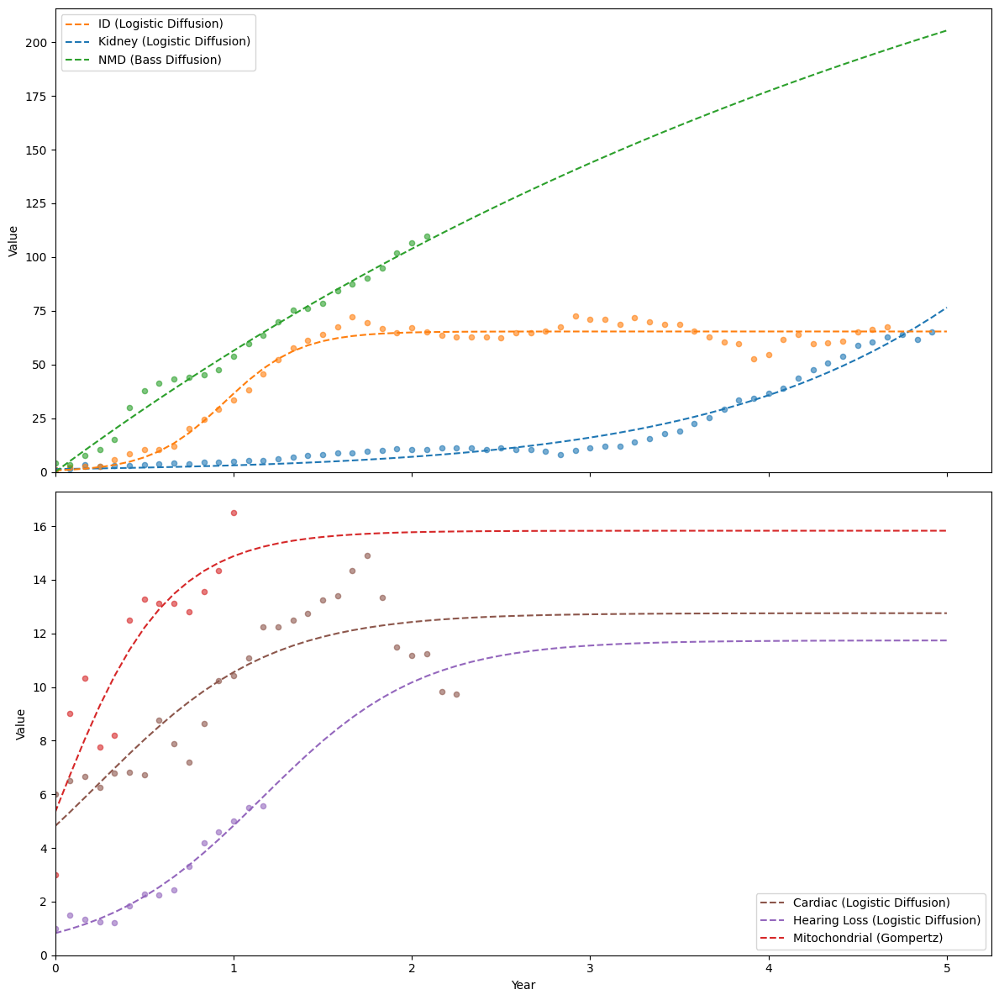

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
# - Drop: KT-NB, KT-BL, CMA, FMR1
# - Group Kidney: ALP (73298), SKD (73401) and CKD (73402)
# - Group ID: CS-P (73358) and CS-T (73359) [renamed from CS to ID]
# - Group NMD: remains as NMD (73422)
# - Group Mitochondrial: (73456, 73457, 73460)
# - Group Hearing Loss: (73440, 73441, 73444)
# - Group Cardiac: (73416)
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# Define diffusion model functions
def logistic_diffusion(t, K, r, t0):
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, M):
    return M * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    # Use 'ME' (month end) to avoid the future deprecation warning for 'M'
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    
    # Apply a 12-month moving average to smooth the data
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    
    # Use only the first 60 months (5 years) of available data for fitting
    group_data = group_data.iloc[:60]
    
    if group_data.empty:
        print(f"Group {group} has no data after processing. Skipping.")
        continue

    # Create a time axis (in years) for the available data
    fitted_years = np.arange(len(group_data)) / 12.0

    # Define diffusion models to fit
    models = {
        "Logistic Diffusion": logistic_diffusion,
        "Gompertz": gompertz,
        "Bass Diffusion": bass_diffusion
    }
    
    results = {}
    max_val = group_data.max()
    mid_t = np.median(fitted_years)
    
    # Fit each diffusion model
    for model_name, model_func in models.items():
        try:
            if model_name == "Gompertz":
                p0 = [max_val, 1.0, 0.1]
                bounds = (0, [np.inf, np.inf, np.inf])
                # Increase maxfev for the Gompertz model to help convergence
                params, _ = curve_fit(
                    model_func,
                    fitted_years,
                    group_data,
                    p0=p0,
                    bounds=bounds,
                    maxfev=100000
                )
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.1, mid_t]
                bounds = ([0, 0, 0], [np.inf, np.inf, np.inf])
                params, _ = curve_fit(
                    model_func,
                    fitted_years,
                    group_data,
                    p0=p0,
                    bounds=bounds,
                    maxfev=10000
                )
            elif model_name == "Bass Diffusion":
                p0 = [0.01, 0.1, max_val * 1.2]
                bounds = ([0, 0, 0], [np.inf, np.inf, np.inf])
                params, _ = curve_fit(
                    model_func,
                    fitted_years,
                    group_data,
                    p0=p0,
                    bounds=bounds,
                    maxfev=10000
                )
            # Compute predictions on the fitted range and calculate R² on the available data
            fitted_pred = model_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'func': model_func
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    # Select the best-performing diffusion model based on the highest R² score
    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        # Create a time axis that spans a full 5 years (60 months)
        full_years = np.linspace(0, 5, 61)  # 61 points from 0 to 5 years
        best_pred_full = best_model_metrics['func'](full_years, *best_model_metrics['params'])
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'Years': full_years,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'Predicted': best_pred_full
        })

# Separate predictions into two subgroups:
# Subplot 1: Kidney, ID, NMD
# Subplot 2: Cardiac, Mitochondrial, Hearing Loss
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

# Create a figure with two subplots (stacked vertically)
fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1.plot(bp['Years'], bp['Predicted'], linestyle='--',
             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color)
ax1.set_ylabel("Value")
ax1.set_xlim(left=0)
ax1.set_ylim(bottom=0)
# Sort legend entries alphabetically
handles1, labels1 = ax1.get_legend_handles_labels()
sorted_handles_labels1 = sorted(zip(labels1, handles1), key=lambda x: x[0])
if sorted_handles_labels1:
    sorted_labels1, sorted_handles1 = zip(*sorted_handles_labels1)
    ax1.legend(sorted_handles1, sorted_labels1)
#ax1.set_title("Diffusion Model Predictions (Kidney, ID, NMD)")

# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2.plot(bp['Years'], bp['Predicted'], linestyle='--',
             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color)
ax2.set_xlabel("Year")
ax2.set_ylabel("Value")
ax2.set_xlim(left=0)
ax2.set_ylim(bottom=0)
# Sort legend entries alphabetically
handles2, labels2 = ax2.get_legend_handles_labels()
sorted_handles_labels2 = sorted(zip(labels2, handles2), key=lambda x: x[0])
if sorted_handles_labels2:
    sorted_labels2, sorted_handles2 = zip(*sorted_handles_labels2)
    ax2.legend(sorted_handles2, sorted_labels2)
#ax2.set_title("Diffusion Model Predictions (Cardiac, Mitochondrial, Hearing Loss)")

plt.tight_layout()
plt.show()


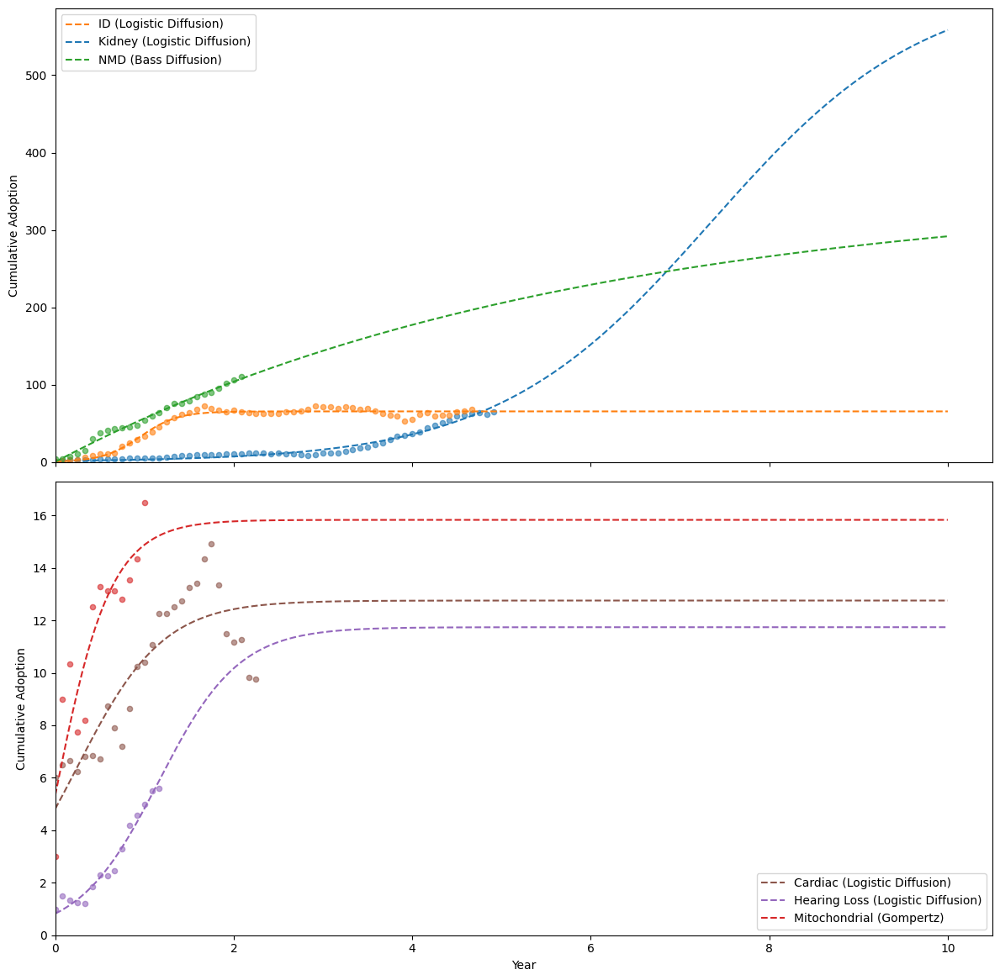

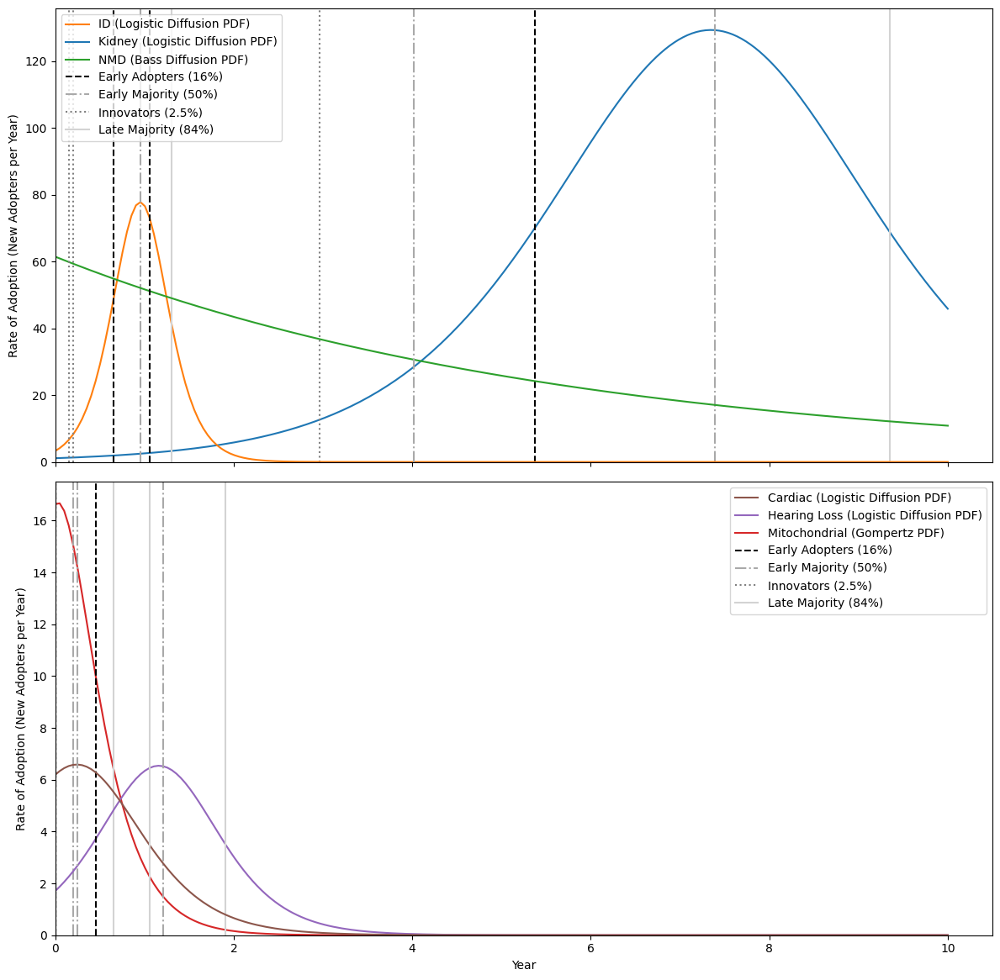


--- Adopter Category Time Points (Years) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33)
  Innovators: 2.96 years
  Early Adopters: 5.38 years
  Early Majority: 7.39 years
  Late Majority: 9.35 years
  Laggards: Not reached within the 10-year prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36)
  Innovators: 0.20 years
  Early Adopters: 0.65 years
  Early Majority: 0.95 years
  Late Majority: 1.31 years
  Laggards: 8.69 years

Group: NMD (Best Model: Bass Diffusion, Market Potential: 354.31)
  Innovators: 0.15 years
  Early Adopters: 1.06 years
  Early Majority: 4.02 years
  Late Majority: Not reached within the 10-year prediction horizon.
  Laggards: Not reached within the 10-year prediction horizon.

Group: Mitochondrial (Best Model: Gompertz, Market Potential: 15.83)
  Innovators: 0.00 years
  Early Adopters: 0.00 years
  Early Majority: 0.20 years
  Late Majority: 0.65 years
  Laggards: Not reached within the 10-yea

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) ---
def logistic_diffusion(t, K, r, t0):
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c):
    return a * np.exp(-b * np.exp(-c * t))

def bass_diffusion(t, p, q, M):
    return M * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))

# --- Probability Distribution Functions (PDF) ---
def logistic_pdf(t, K, r, t0):
    # Derivative of K / (1 + exp(-r * (t - t0)))
    # dN/dt = K * r * exp(-r * (t - t0)) / (1 + exp(-r * (t - t0)))^2
    return K * r * np.exp(-r * (t - t0)) / (1 + np.exp(-r * (t - t0)))**2

def gompertz_pdf(t, a, b, c):
    # Derivative of a * exp(-b * exp(-c * t))
    # dN/dt = a * b * c * exp(-c * t) * exp(-b * exp(-c * t))
    return a * b * c * np.exp(-c * t) * np.exp(-b * np.exp(-c * t))

def bass_pdf(t, p, q, M):
    # Derivative of M * (1 - np.exp(-(p + q) * t)) / (1 + (q / p) * np.exp(-(p + q) * t))
    # This is often written as: n(t) = (p + q * N(t)/M) * (M - N(t))
    # Or directly from the derivative of the CDF:
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * t)
    denominator = (p + q * np.exp(-(p + q) * t))**2
    return numerator / denominator

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        # np.argmax returns the index of the first True value
        time_index = np.argmax(cumulative_adoption_values >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[0] < target_value:
            # If target not reached even at the first time point
            adopter_times[category] = None # Or a very small value if appropriate
        elif time_index == 0 and cumulative_adoption_values[0] >= target_value:
             adopter_times[category] = years_range[0]
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    # Use 'ME' (month end) to avoid the future deprecation warning for 'M'
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    
    # Apply a 12-month moving average to smooth the data
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    
    # Use only the first 60 months (5 years) of available data for fitting
    group_data = group_data.iloc[:60]
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    # Create a time axis (in years) for the available data
    fitted_years = np.arange(len(group_data)) / 12.0

    # Define diffusion models to fit
    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf}
    }
    
    results = {}
    max_val = group_data.max()
    mid_t = np.median(fitted_years)
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            if model_name == "Gompertz":
                p0 = [max_val, 1.0, 0.1]
                bounds = (0, [np.inf, np.inf, np.inf])
                params, _ = curve_fit(
                    cdf_func,
                    fitted_years,
                    group_data,
                    p0=p0,
                    bounds=bounds,
                    maxfev=100000
                )
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.1, mid_t]
                bounds = ([0, 0, 0], [np.inf, np.inf, np.inf])
                params, _ = curve_fit(
                    cdf_func,
                    fitted_years,
                    group_data,
                    p0=p0,
                    bounds=bounds,
                    maxfev=10000
                )
            elif model_name == "Bass Diffusion":
                # Ensure M is greater than current max_val, and p, q are positive
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1)] # M must be > current cumulative
                bounds = ([1e-9, 1e-9, max_val], [1, 10, np.inf]) # p,q typically <1, M > max_val
                params, _ = curve_fit(
                    cdf_func,
                    fitted_years,
                    group_data,
                    p0=p0,
                    bounds=bounds,
                    maxfev=10000
                )
            
            # Compute predictions on the fitted range and calculate R² on the available data
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    # Select the best-performing diffusion model based on the highest R² score
    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Create a time axis that spans a reasonable future period for PDF visualization
        # We'll extend to 10 years for better visualization of the full diffusion curve
        full_years = np.linspace(0, 10, 200) # 200 points from 0 to 10 years
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        # Determine the market potential (K or M) for adopter category calculation
        if best_model_name == "Bass Diffusion":
            market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            market_potential,
            full_years
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': market_potential
        })

# --- Plotting the CDFs (original part) ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='--',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color)
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=0)
ax1_cdf.set_ylim(bottom=0)
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
if sorted_handles_labels1_cdf:
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)

# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='--',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color)
ax2_cdf.set_xlabel("Year")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=0)
ax2_cdf.set_ylim(bottom=0)
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
if sorted_handles_labels2_cdf:
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf)
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

#plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02) # Add a title for the figure
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()


# --- Plotting the PDFs and Adopter Categories ---
fig_pdf, (ax1_pdf, ax2_pdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Define vertical lines for adopter categories
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':', 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--', 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.', 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-', 'label': 'Late Majority (84%)'}
}
adopter_category_labels_drawn = [] # To ensure labels are only added once per subplot

# Plot in subplot 1: Kidney, ID, NMD (PDFs)
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_pdf.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"{bp['Group']} ({bp['BestModel']} PDF)", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            label_to_use = details['label'] if category_name not in adopter_category_labels_drawn else "_nolegend_"
            ax1_pdf.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=label_to_use)
            if category_name not in adopter_category_labels_drawn:
                adopter_category_labels_drawn.append(category_name)

ax1_pdf.set_ylabel("Rate of Adoption (New Adopters per Year)")
ax1_pdf.set_xlim(left=0)
ax1_pdf.set_ylim(bottom=0)
handles1_pdf, labels1_pdf = ax1_pdf.get_legend_handles_labels()
# Separate group labels from adopter category labels for independent sorting
group_labels_handles = [(l, h) for l, h in zip(labels1_pdf, handles1_pdf) if not l.startswith('Inno') and not l.startswith('Early') and not l.startswith('Late')]
adopter_labels_handles = [(l, h) for l, h in zip(labels1_pdf, handles1_pdf) if l.startswith('Inno') or l.startswith('Early') or l.startswith('Late')]

sorted_group_labels_handles1 = sorted(group_labels_handles, key=lambda x: x[0])
sorted_adopter_labels_handles1 = sorted(adopter_labels_handles, key=lambda x: x[0]) # Sort by percentage for consistent order

sorted_labels1_pdf = [lh[0] for lh in sorted_group_labels_handles1] + [lh[0] for lh in sorted_adopter_labels_handles1]
sorted_handles1_pdf = [lh[1] for lh in sorted_group_labels_handles1] + [lh[1] for lh in sorted_adopter_labels_handles1]

if sorted_labels1_pdf:
    ax1_pdf.legend(sorted_handles1_pdf, sorted_labels1_pdf)

adopter_category_labels_drawn = [] # Reset for the next subplot

# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss (PDFs)
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_pdf.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"{bp['Group']} ({bp['BestModel']} PDF)", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            label_to_use = details['label'] if category_name not in adopter_category_labels_drawn else "_nolegend_"
            ax2_pdf.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=label_to_use)
            if category_name not in adopter_category_labels_drawn:
                adopter_category_labels_drawn.append(category_name)

ax2_pdf.set_xlabel("Year")
ax2_pdf.set_ylabel("Rate of Adoption (New Adopters per Year)")
ax2_pdf.set_xlim(left=0)
ax2_pdf.set_ylim(bottom=0)
handles2_pdf, labels2_pdf = ax2_pdf.get_legend_handles_labels()
group_labels_handles = [(l, h) for l, h in zip(labels2_pdf, handles2_pdf) if not l.startswith('Inno') and not l.startswith('Early') and not l.startswith('Late')]
adopter_labels_handles = [(l, h) for l, h in zip(labels2_pdf, handles2_pdf) if l.startswith('Inno') or l.startswith('Early') or l.startswith('Late')]

sorted_group_labels_handles2 = sorted(group_labels_handles, key=lambda x: x[0])
sorted_adopter_labels_handles2 = sorted(adopter_labels_handles, key=lambda x: x[0])

sorted_labels2_pdf = [lh[0] for lh in sorted_group_labels_handles2] + [lh[0] for lh in sorted_adopter_labels_handles2]
sorted_handles2_pdf = [lh[1] for lh in sorted_group_labels_handles2] + [lh[1] for lh in sorted_adopter_labels_handles2]

if sorted_labels2_pdf:
    ax2_pdf.legend(sorted_handles2_pdf, sorted_labels2_pdf)

#plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories", fontsize=16, y=1.02) # Add a title for the figure
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f})")
    for category, time in bp['AdopterTimes'].items():
        if time is not None:
            print(f"  {category}: {time:.2f} years")
        else:
            print(f"  {category}: Not reached within the 10-year prediction horizon.")

/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/2613740982.py:278: UserWarning: Legend does not support handles for str instances.
A proxy artist may be used instead.
See: https://matplotlib.org/stable/users/explain/axes/legend_guide.html#controlling-the-legend-entries
  ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/2613740982.py:299: UserWarning: Legend does not support handles for str instances.
A proxy artist may be used instead.
See: https://matplotlib.org/stable/users/explain/axes/legend_guide.html#controlling-the-legend-entries
  ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)


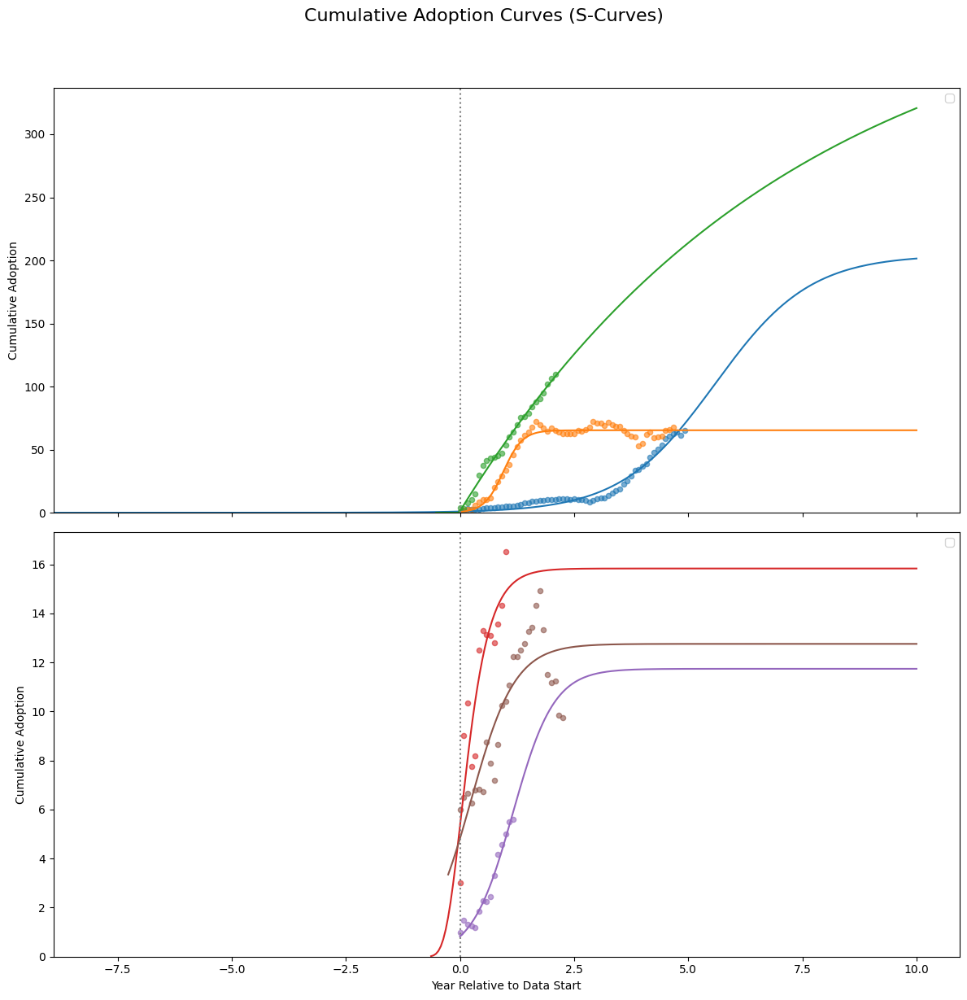

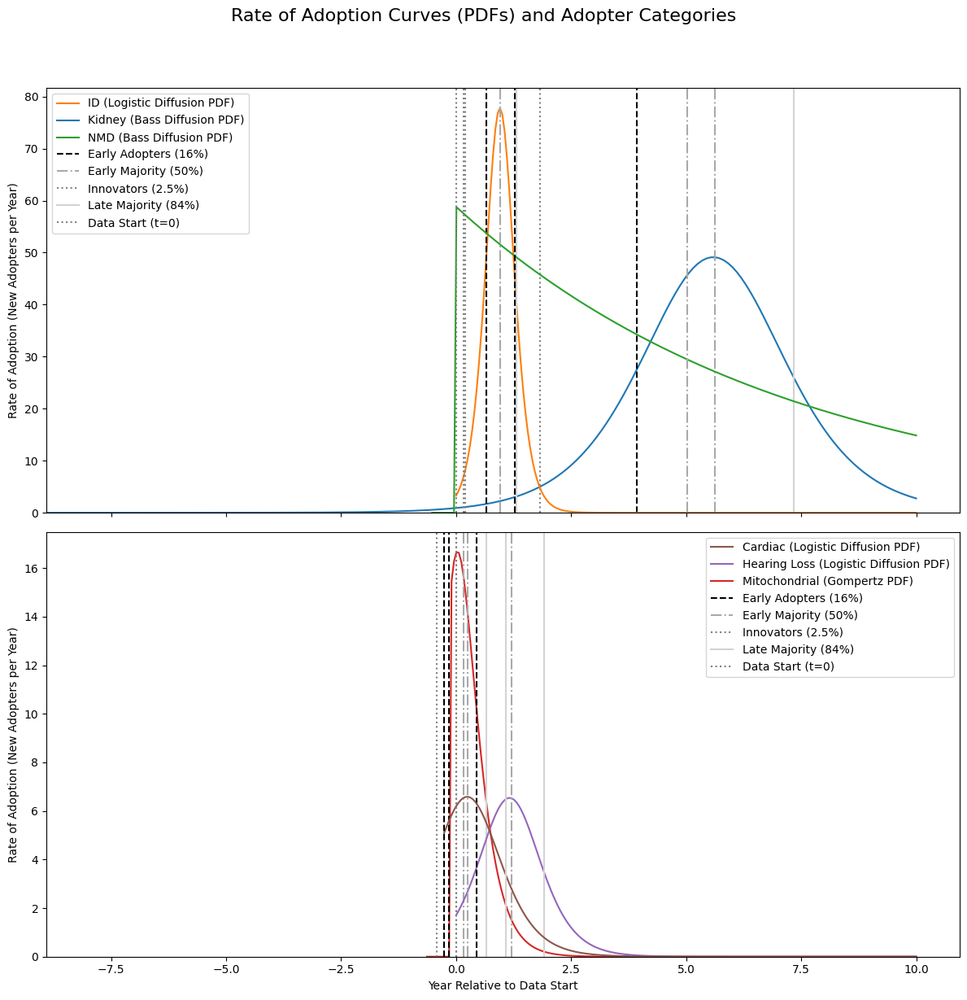


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Bass Diffusion, Market Potential: 204.40, Estimated Diffusion Start (t=0 of curve): -8.41 years)
  Innovators ends at: 1.83 years
  Early Adopters ends at: 3.92 years
  Early Majority ends at: 5.63 years
  Late Majority ends at: 7.34 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.20 years
  Early Adopters ends at: 0.65 years
  Early Majority ends at: 0.95 years
  Late Majority ends at: 1.31 years
  Laggards ends at: 8.69 years

Group: NMD (Best Model: Bass Diffusion, Market Potential: 428.68, Estimated Diffusion Start (t=0 of curve): -0.02 years)
  Innovators ends at: 0.17 years
  Early Adopters ends at: 1.28 years
  Early Majority ends at: 5.03 years
  Late Majority ends at: Not reached within the prediction horizon.


In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    return M * (1 - np.exp(-(p + q) * effective_t)) / (1 + (q / p) * np.exp(-(p + q) * effective_t))

# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    pdf[valid_indices] = numerator / denominator
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    # Ensure years_range starts from the estimated t_offset (or t0 for Logistic)
    # This allows for finding categories that occurred before observed data's t=0
    # For plotting, we might want to extend it even earlier to see the curve's base.
    
    # For Logistic, t0 is params[2]. For Bass/Gompertz, t_offset is params[3]
    if model_name == "Logistic Diffusion":
        t_shift = params[2]
    else: # Bass or Gompertz
        t_shift = params[3]
    
    # Ensure calculations are performed on the part of the curve where t - t_shift >= 0
    # This means the years_range used in CDF should also consider the shift.
    # However, `years_range` is typically the plotting range.
    # We pass years_range as is, and the CDF/PDF functions handle the (t - t_offset) internally.
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        time_index = np.argmax(cumulative_adoption_values >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[0] < target_value:
            # If target not reached even at the very first time point in years_range
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -10.0], # Allowing t_offset up to 10 years before data starts
                          [np.inf, 10.0, 10.0, 5.0]) # Allowing t_offset up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -10.0], # Allowing t0 up to 10 years before data starts
                          [np.inf, 10.0, 5.0]) # Allowing t0 up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                bounds = ([1e-9, 1e-9, max_val * 1.05, -10.0], # Allowing t_offset up to 10 years before data starts
                          [1.0, 1.0, np.inf, 5.0]) # Allowing t_offset up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # Create a full time axis that extends *before* the observed data's t=0
        # This will be from the estimated t_offset to a future point (e.g., 10 years after data's t=0)
        plot_start_year = min(0, estimated_t_offset - 0.5) # Start slightly before estimated t_offset or 0
        plot_end_year = max(10, fitted_years[-1] + 5) # Extend 5 years beyond current data or up to 10 years

        full_years = np.linspace(plot_start_year, plot_end_year, 200) 
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        if best_model_name == "Bass Diffusion":
            market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            market_potential,
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': market_potential,
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp['Group'] == subplot1_predictions[0]['Group'] else "") # Label once
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=min(0, min(bp['CDF_Years'][0] for bp in best_predictions))) # Ensure x-axis starts from earliest inferred time
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)' if 'Data Start (t=0)' not in ax1_cdf.get_legend_handles_labels()[1] else "") # Mark data start
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
# Sort legend entries alphabetically, with 'Data Start' at the end
sorted_handles_labels1_cdf = sorted([(label, handle) for label, handle in zip(labels1_cdf, handles1_cdf) if "Data Start" not in label], key=lambda x: x[0])
data_start_handle_label = next(((h,l) for h,l in zip(handles1_cdf,labels1_cdf) if "Data Start" in l), None)
if data_start_handle_label: sorted_handles_labels1_cdf.append((data_start_handle_label[1], data_start_handle_label[0]))
if sorted_handles_labels1_cdf:
    sorted_labels1_cdf = [l for _, l in sorted_handles_labels1_cdf]
    sorted_handles1_cdf = [h for h, _ in sorted_handles_labels1_cdf]
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)


for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp['Group'] == subplot2_predictions[0]['Group'] else "") # Label once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=min(0, min(bp['CDF_Years'][0] for bp in best_predictions)))
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)' if 'Data Start (t=0)' not in ax2_cdf.get_legend_handles_labels()[1] else "")
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted([(label, handle) for label, handle in zip(labels2_cdf, handles2_cdf) if "Data Start" not in label], key=lambda x: x[0])
data_start_handle_label = next(((h,l) for h,l in zip(handles2_cdf,labels2_cdf) if "Data Start" in l), None)
if data_start_handle_label: sorted_handles_labels2_cdf.append((data_start_handle_label[1], data_start_handle_label[0]))
if sorted_handles_labels2_cdf:
    sorted_labels2_cdf = [l for _, l in sorted_handles_labels2_cdf]
    sorted_handles2_cdf = [h for h, _ in sorted_handles_labels2_cdf]
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories ---
fig_pdf, (ax1_pdf, ax2_pdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':', 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--', 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.', 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-', 'label': 'Late Majority (84%)'}
}
adopter_category_labels_drawn = []

for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_pdf.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"{bp['Group']} ({bp['BestModel']} PDF)", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            # Shift the vertical lines to be relative to the inferred start (t=0 of the curve)
            # The line is drawn at `bp['AdopterTimes'][category_name]` which is already in the full_years range
            # which is relative to data's t=0.
            # If we want to show it relative to the *true* inferred t=0 of the curve, we would do:
            # x_val = bp['AdopterTimes'][category_name] - bp['EstimatedOffset']
            # However, `bp['AdopterTimes'][category_name]` is already using the full_years range which starts earlier
            # if t_offset is negative, so the values are already what we want.
            label_to_use = details['label'] if category_name not in adopter_category_labels_drawn else "_nolegend_"
            ax1_pdf.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=label_to_use)
            if category_name not in adopter_category_labels_drawn:
                adopter_category_labels_drawn.append(category_name)

ax1_pdf.set_ylabel("Rate of Adoption (New Adopters per Year)")
ax1_pdf.set_xlim(left=min(0, min(bp['PDF_Years'][0] for bp in best_predictions))) # Adjust x-axis to show negative time if present
ax1_pdf.set_ylim(bottom=0)
ax1_pdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)' if 'Data Start (t=0)' not in ax1_pdf.get_legend_handles_labels()[1] else "")
handles1_pdf, labels1_pdf = ax1_pdf.get_legend_handles_labels()
# Sort legend entries, group labels first then adopter categories.
group_labels_handles = [(l, h) for l, h in zip(labels1_pdf, handles1_pdf) if not (l.startswith('Inno') or l.startswith('Early') or l.startswith('Late') or l.startswith('Data Start'))]
adopter_labels_handles = [(l, h) for l, h in zip(labels1_pdf, handles1_pdf) if (l.startswith('Inno') or l.startswith('Early') or l.startswith('Late'))]
data_start_handle_label = next(((h,l) for h,l in zip(handles1_pdf,labels1_pdf) if "Data Start" in l), None)

sorted_group_labels_handles1 = sorted(group_labels_handles, key=lambda x: x[0])
sorted_adopter_labels_handles1 = sorted(adopter_labels_handles, key=lambda x: x[0])

sorted_labels1_pdf = [lh[0] for lh in sorted_group_labels_handles1] + [lh[0] for lh in sorted_adopter_labels_handles1]
sorted_handles1_pdf = [lh[1] for lh in sorted_group_labels_handles1] + [lh[1] for lh in sorted_adopter_labels_handles1]
if data_start_handle_label:
    sorted_labels1_pdf.append(data_start_handle_label[1])
    sorted_handles1_pdf.append(data_start_handle_label[0])

if sorted_labels1_pdf:
    ax1_pdf.legend(sorted_handles1_pdf, sorted_labels1_pdf)

adopter_category_labels_drawn = [] # Reset for the next subplot

for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_pdf.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"{bp['Group']} ({bp['BestModel']} PDF)", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            label_to_use = details['label'] if category_name not in adopter_category_labels_drawn else "_nolegend_"
            ax2_pdf.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=label_to_use)
            if category_name not in adopter_category_labels_drawn:
                adopter_category_labels_drawn.append(category_name)

ax2_pdf.set_xlabel("Year Relative to Data Start")
ax2_pdf.set_ylabel("Rate of Adoption (New Adopters per Year)")
ax2_pdf.set_xlim(left=min(0, min(bp['PDF_Years'][0] for bp in best_predictions)))
ax2_pdf.set_ylim(bottom=0)
ax2_pdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)' if 'Data Start (t=0)' not in ax2_pdf.get_legend_handles_labels()[1] else "")
handles2_pdf, labels2_pdf = ax2_pdf.get_legend_handles_labels()
group_labels_handles = [(l, h) for l, h in zip(labels2_pdf, handles2_pdf) if not (l.startswith('Inno') or l.startswith('Early') or l.startswith('Late') or l.startswith('Data Start'))]
adopter_labels_handles = [(l, h) for l, h in zip(labels2_pdf, handles2_pdf) if (l.startswith('Inno') or l.startswith('Early') or l.startswith('Late'))]
data_start_handle_label = next(((h,l) for h,l in zip(handles2_pdf,labels2_pdf) if "Data Start" in l), None)

sorted_group_labels_handles2 = sorted(group_labels_handles, key=lambda x: x[0])
sorted_adopter_labels_handles2 = sorted(adopter_labels_handles, key=lambda x: x[0])

sorted_labels2_pdf = [lh[0] for lh in sorted_group_labels_handles2] + [lh[0] for lh in sorted_adopter_labels_handles2]
sorted_handles2_pdf = [lh[1] for lh in sorted_group_labels_handles2] + [lh[1] for lh in sorted_adopter_labels_handles2]
if data_start_handle_label:
    sorted_labels2_pdf.append(data_start_handle_label[1])
    sorted_handles2_pdf.append(data_start_handle_label[0])

if sorted_labels2_pdf:
    ax2_pdf.legend(sorted_handles2_pdf, sorted_labels2_pdf)

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            # Time is already relative to data's t=0 due to how full_years is set up for plotting
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")

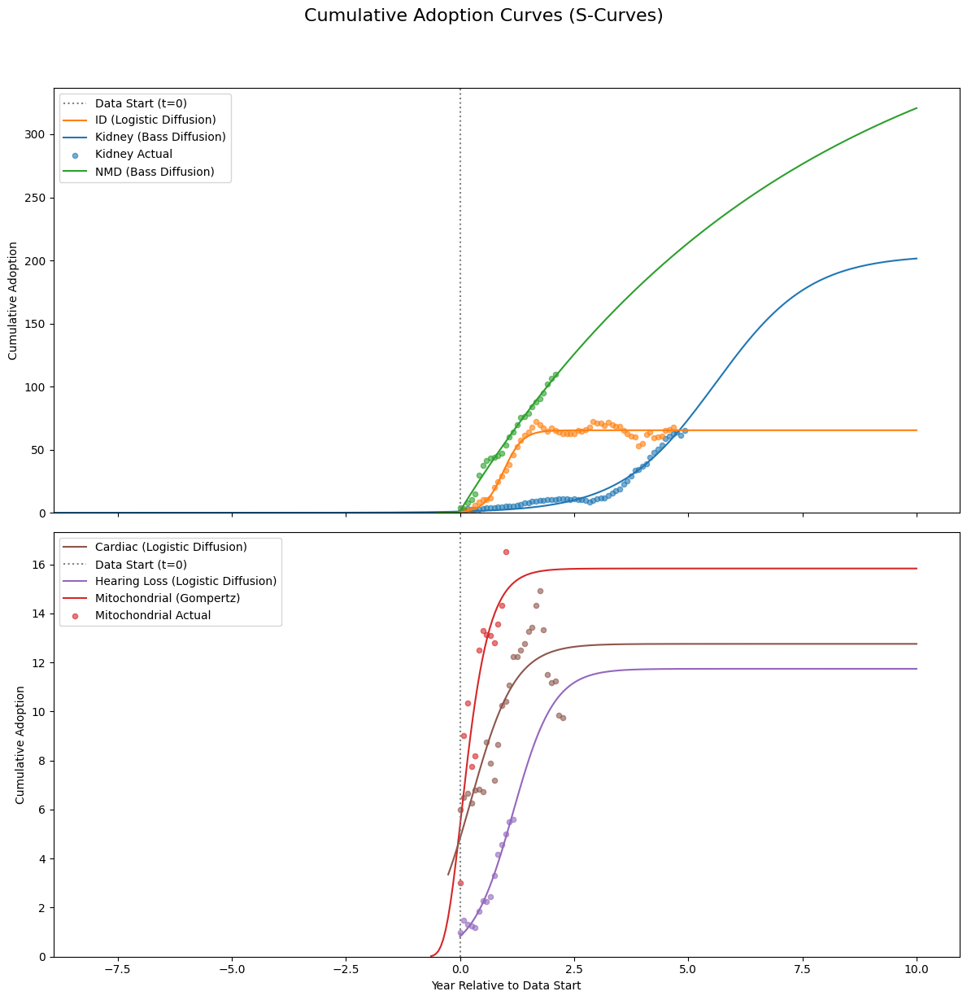

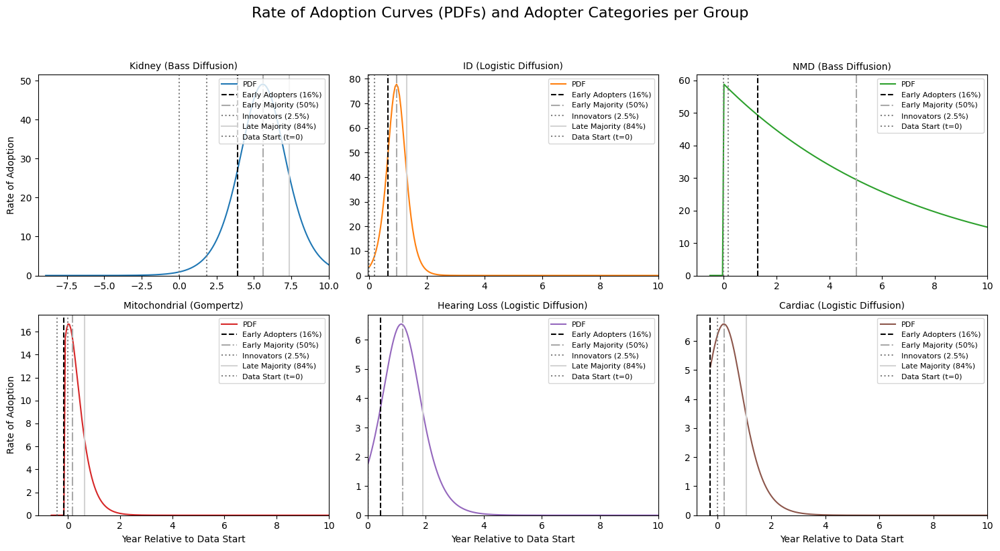


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Bass Diffusion, Market Potential: 204.40, Estimated Diffusion Start (t=0 of curve): -8.41 years)
  Innovators ends at: 1.83 years
  Early Adopters ends at: 3.92 years
  Early Majority ends at: 5.63 years
  Late Majority ends at: 7.34 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.20 years
  Early Adopters ends at: 0.65 years
  Early Majority ends at: 0.95 years
  Late Majority ends at: 1.31 years
  Laggards ends at: 8.69 years

Group: NMD (Best Model: Bass Diffusion, Market Potential: 428.68, Estimated Diffusion Start (t=0 of curve): -0.02 years)
  Innovators ends at: 0.17 years
  Early Adopters ends at: 1.28 years
  Early Majority ends at: 5.03 years
  Late Majority ends at: Not reached within the prediction horizon.


In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math # Import math for ceil

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    return M * (1 - np.exp(-(p + q) * effective_t)) / (1 + (q / p) * np.exp(-(p + q) * effective_t))

# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    pdf[valid_indices] = numerator / denominator
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    # For Logistic, t0 is params[2]. For Bass/Gompertz, t_offset is params[3]
    if model_name == "Logistic Diffusion":
        t_shift = params[2]
    else: # Bass or Gompertz
        t_shift = params[3]
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        time_index = np.argmax(cumulative_adoption_values >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[0] < target_value:
            # If target not reached even at the very first time point in years_range
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -10.0], # Allowing t_offset up to 10 years before data starts
                          [np.inf, 10.0, 10.0, 5.0]) # Allowing t_offset up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -10.0], # Allowing t0 up to 10 years before data starts
                          [np.inf, 10.0, 5.0]) # Allowing t0 up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                bounds = ([1e-9, 1e-9, max_val * 1.05, -10.0], # Allowing t_offset up to 10 years before data starts
                          [1.0, 1.0, np.inf, 5.0]) # Allowing t_offset up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # Create a full time axis that extends *before* the observed data's t=0
        # This will be from the estimated t_offset to a future point (e.g., 10 years after data's t=0)
        plot_start_year = min(0, estimated_t_offset - 0.5) # Start slightly before estimated t_offset or 0
        plot_end_year = max(10, fitted_years[-1] + 5) # Extend 5 years beyond current data or up to 10 years

        full_years = np.linspace(plot_start_year, plot_end_year, 200) 
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        if best_model_name == "Bass Diffusion":
            market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            market_potential,
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': market_potential,
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

# --- Plotting the CDFs (original part) ---
# This section remains unchanged as the request was specific to PDFs
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=min(0, min(bp['CDF_Years'][0] for bp in best_predictions)))
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=min(0, min(bp['CDF_Years'][0] for bp in best_predictions)))
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf)
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':', 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--', 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.', 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-', 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits based on the specific group's inferred diffusion
    ax.set_xlim(left=min(0, bp['EstimatedOffset'] - 1), right=max(10, bp['PDF_Years'][-1]))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")

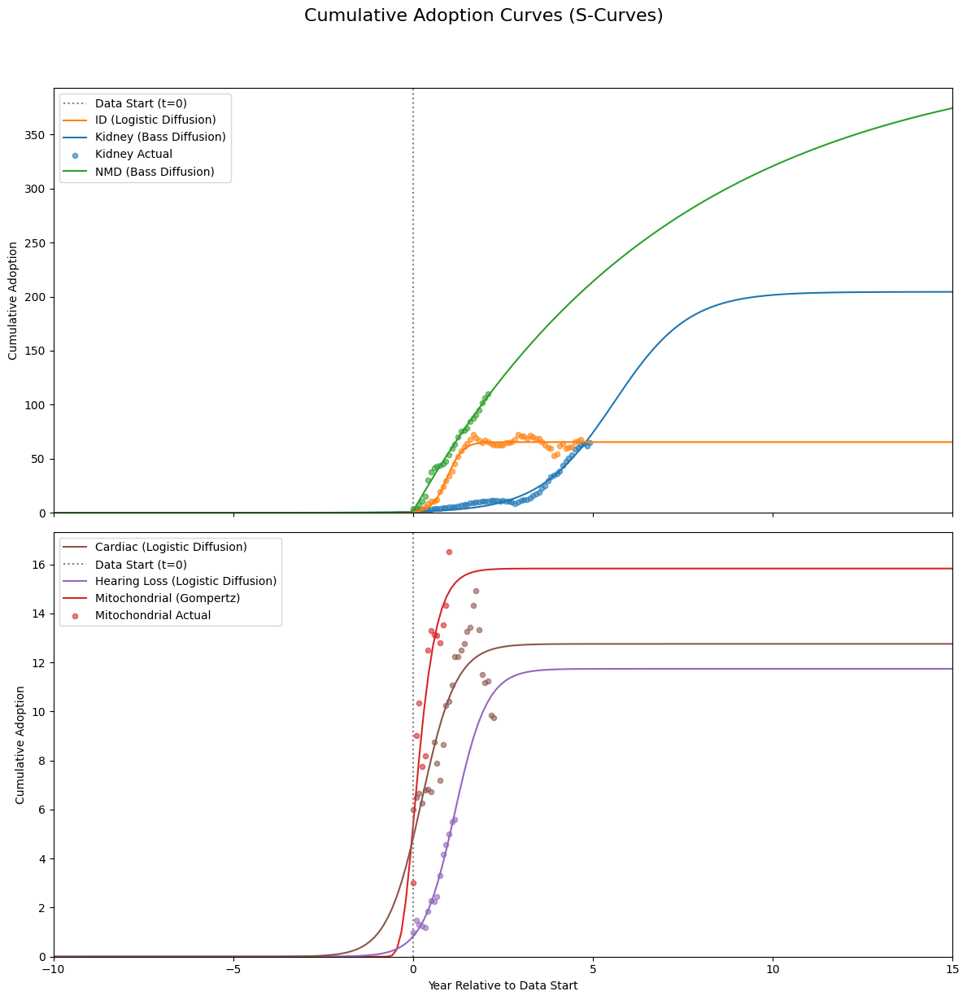

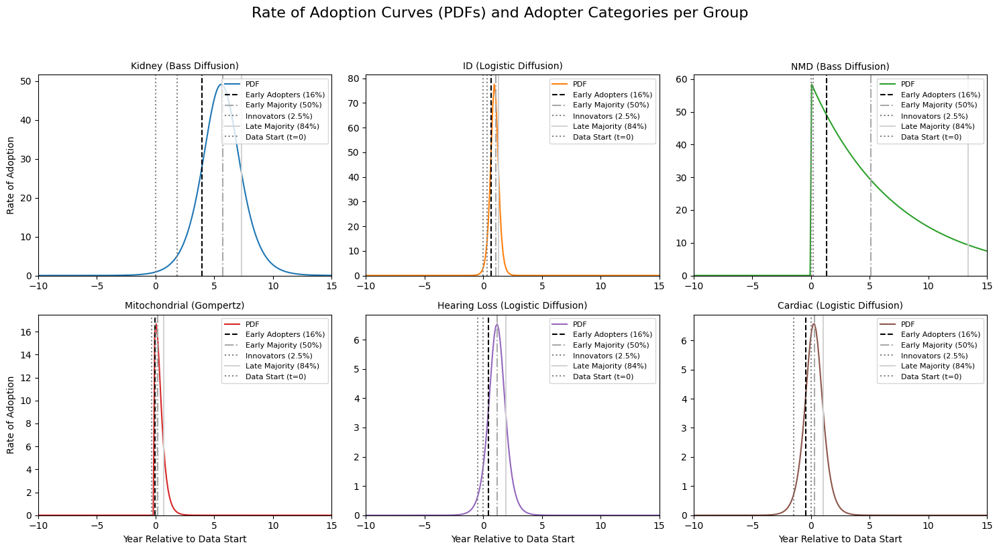


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Bass Diffusion, Market Potential: 204.40, Estimated Diffusion Start (t=0 of curve): -8.41 years)
  Innovators ends at: 1.81 years
  Early Adopters ends at: 3.94 years
  Early Majority ends at: 5.70 years
  Late Majority ends at: 7.34 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.30 years
  Early Adopters ends at: 0.68 years
  Early Majority ends at: 1.06 years
  Late Majority ends at: 1.31 years
  Laggards ends at: 8.72 years

Group: NMD (Best Model: Bass Diffusion, Market Potential: 428.68, Estimated Diffusion Start (t=0 of curve): -0.02 years)
  Innovators ends at: 0.18 years
  Early Adopters ends at: 1.31 years
  Early Majority ends at: 5.08 years
  Late Majority ends at: 13.37 years
  Laggards ends at: Not reached

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math # Import math for ceil

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    return M * (1 - np.exp(-(p + q) * effective_t)) / (1 + (q / p) * np.exp(-(p + q) * effective_t))

# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    pdf[valid_indices] = numerator / denominator
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    # For Logistic, t0 is params[2]. For Bass/Gompertz, t_offset is params[3]
    if model_name == "Logistic Diffusion":
        t_shift = params[2]
    else: # Bass or Gompertz
        t_shift = params[3]
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        time_index = np.argmax(cumulative_adoption_values >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[0] < target_value:
            # If target not reached even at the very first time point in years_range
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -10.0], # Allowing t_offset up to 10 years before data starts
                          [np.inf, 10.0, 10.0, 5.0]) # Allowing t_offset up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -10.0], # Allowing t0 up to 10 years before data starts
                          [np.inf, 10.0, 5.0]) # Allowing t0 up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                bounds = ([1e-9, 1e-9, max_val * 1.05, -10.0], # Allowing t_offset up to 10 years before data starts
                          [1.0, 1.0, np.inf, 5.0]) # Allowing t_offset up to 5 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # *** MODIFIED: Set a wider, fixed plotting range for full distribution visualization ***
        plot_start_year = -10.0 # Start 10 years before data's t=0
        plot_end_year = 15.0   # End 15 years after data's t=0
        
        full_years = np.linspace(plot_start_year, plot_end_year, 200) 
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        if best_model_name == "Bass Diffusion":
            market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            market_potential,
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': market_potential,
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

# --- Plotting the CDFs (original part) ---
# This section remains unchanged as the request was specific to PDFs
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
# Ensure CDF x-limit includes the full theoretical curve
ax1_cdf.set_xlim(left=min(bp['CDF_Years'][0] for bp in best_predictions),
                 right=max(bp['CDF_Years'][-1] for bp in best_predictions))
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
# Ensure CDF x-limit includes the full theoretical curve
ax2_cdf.set_xlim(left=min(bp['CDF_Years'][0] for bp in best_predictions),
                 right=max(bp['CDF_Years'][-1] for bp in best_predictions))
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf)
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':', 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--', 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.', 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-', 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # *** MODIFIED: Set x-axis limits for each subplot to cover the full fixed range ***
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")

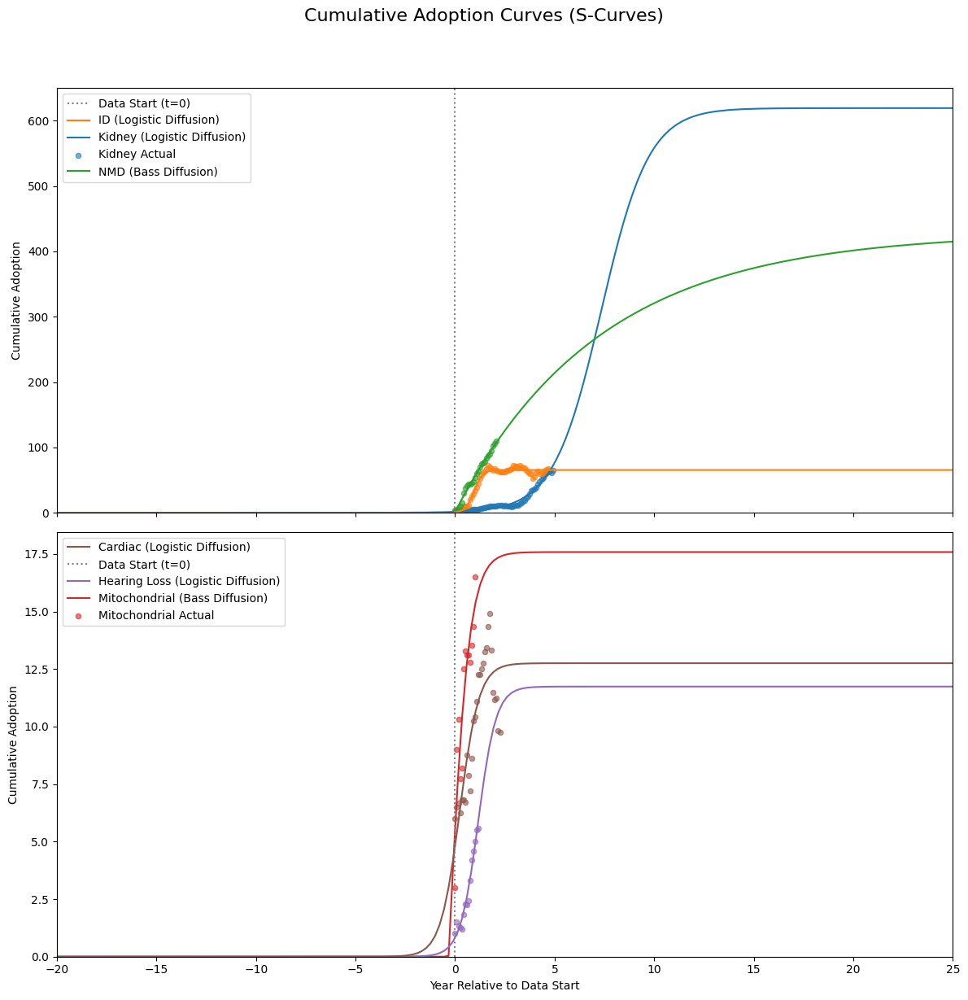

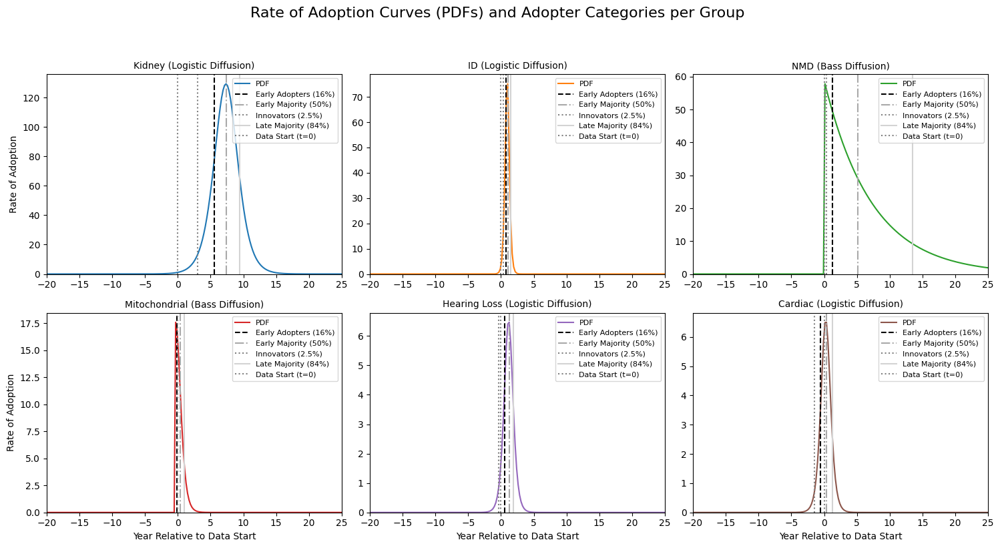


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 3.07 years
  Early Adopters ends at: 5.55 years
  Early Majority ends at: 7.36 years
  Late Majority ends at: 9.40 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.35 years
  Early Adopters ends at: 0.80 years
  Early Majority ends at: 1.03 years
  Late Majority ends at: 1.48 years
  Laggards ends at: 8.72 years

Group: NMD (Best Model: Bass Diffusion, Market Potential: 428.68, Estimated Diffusion Start (t=0 of curve): -0.02 years)
  Innovators ends at: 0.35 years
  Early Adopters ends at: 1.26 years
  Early Majority ends at: 5.10 years
  Late Majority ends at: 13.47 years
  Laggards ends at: Not reac

In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    return M * (1 - np.exp(-(p + q) * effective_t)) / (1 + (q / p) * np.exp(-(p + q) * effective_t))

# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    pdf[valid_indices] = numerator / denominator
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    # For Logistic, t0 is params[2]. For Bass/Gompertz, t_offset is params[3]
    if model_name == "Logistic Diffusion":
        t_shift = params[2]
    else: # Bass or Gompertz
        t_shift = params[3]
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        time_index = np.argmax(cumulative_adoption_values >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[0] < target_value:
            # If target not reached even at the very first time point in years_range
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], # Allowing t_offset up to 20 years before data starts
                          [np.inf, 10.0, 10.0, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], # Allowing t0 up to 20 years before data starts
                          [np.inf, 10.0, 10.0]) # Allowing t0 up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                bounds = ([1e-9, 1e-9, max_val * 1.05, -20.0], # Allowing t_offset up to 20 years before data starts
                          [1.0, 1.0, np.inf, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # Set an even wider, fixed plotting range for full distribution visualization
        plot_start_year = -20.0 # Start 20 years before data's t=0
        plot_end_year = 25.0   # End 25 years after data's t=0 (total 45 years)
        
        full_years = np.linspace(plot_start_year, plot_end_year, 200) 
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        if best_model_name == "Bass Diffusion":
            market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            market_potential,
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': market_potential,
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
# Ensure CDF x-limit includes the full theoretical curve
ax1_cdf.set_xlim(left=min(bp['CDF_Years'][0] for bp in best_predictions),
                 right=max(bp['CDF_Years'][-1] for bp in best_predictions))
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
# Ensure CDF x-limit includes the full theoretical curve
ax2_cdf.set_xlim(left=min(bp['CDF_Years'][0] for bp in best_predictions),
                 right=max(bp['CDF_Years'][-1] for bp in best_predictions))
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
# --- FIX APPLIED HERE ---
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) # Corrected variable name
# ------------------------
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':', 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--', 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.', 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-', 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits for each subplot to cover the full, even wider fixed range
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")

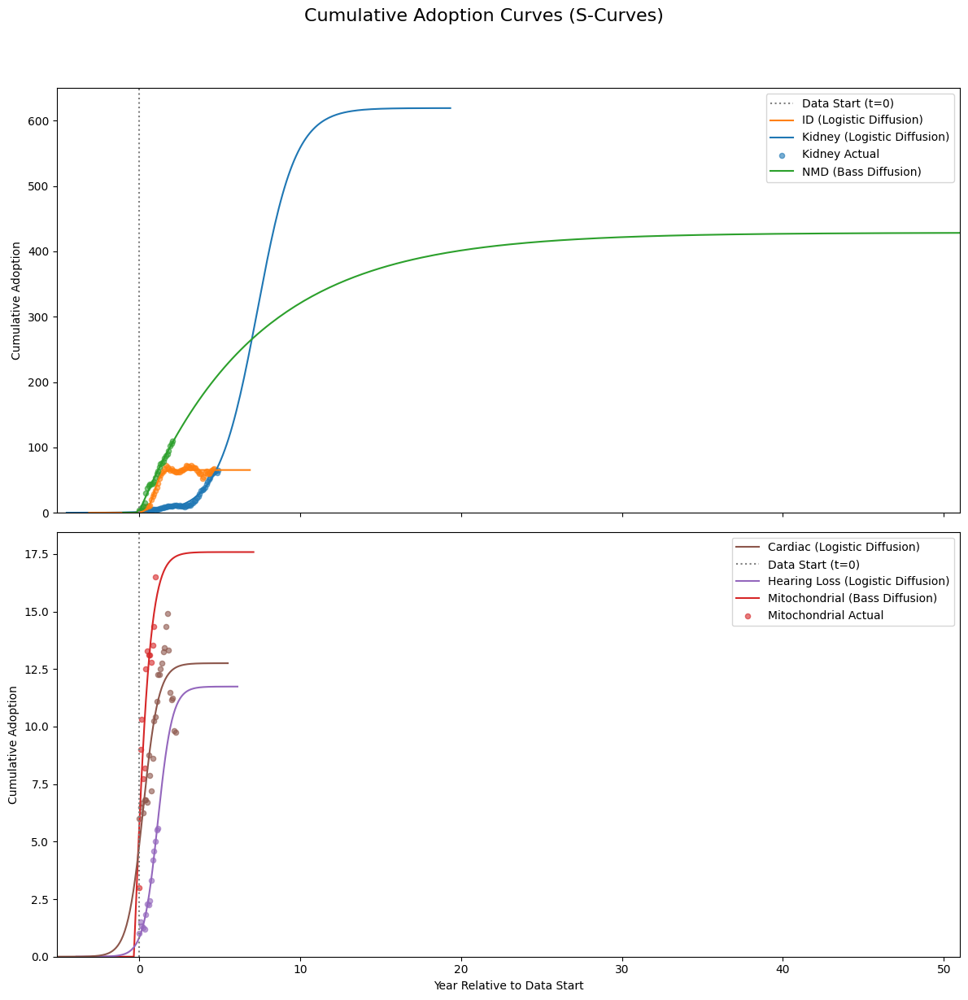

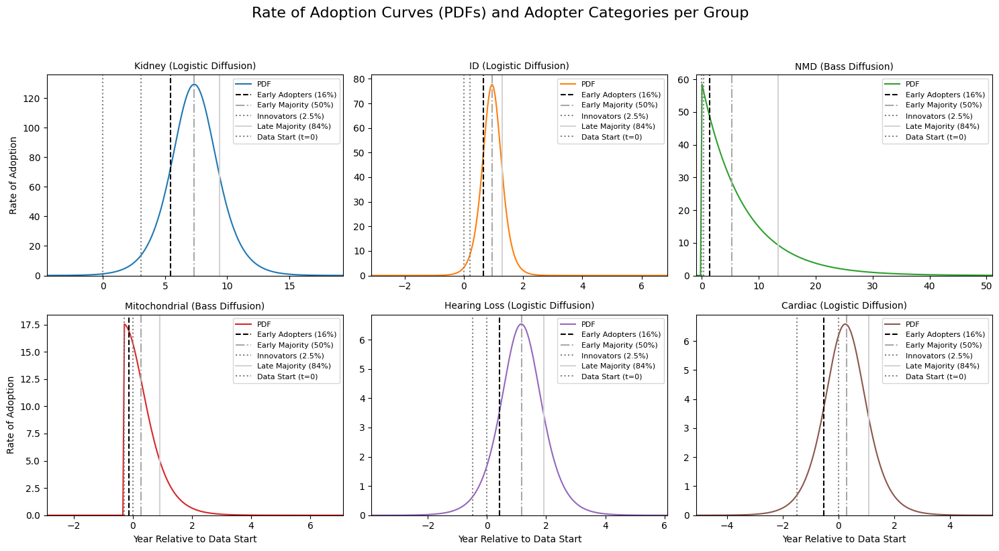


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 3.04 years
  Early Adopters ends at: 5.44 years
  Early Majority ends at: 7.35 years
  Late Majority ends at: 9.39 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.20 years
  Early Adopters ends at: 0.65 years
  Early Majority ends at: 0.95 years
  Late Majority ends at: 1.30 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Bass Diffusion, Market Potential: 428.68, Estimated Diffusion Start (t=0 of curve): -0.02 years)
  Innovators ends at: 0.31 years
  Early Adopters ends at: 1.35 years
  Early Majority ends at: 5.27 years
  Late Majority ends at: 13.37 ye

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    return M * (1 - np.exp(-(p + q) * effective_t)) / (1 + (q / p) * np.exp(-(p + q) * effective_t))

# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    pdf[valid_indices] = numerator / denominator
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    # For Logistic, t0 is params[2]. For Bass/Gompertz, t_offset is params[3]
    if model_name == "Logistic Diffusion":
        t_shift = params[2]
    else: # Bass or Gompertz
        t_shift = params[3]
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        time_index = np.argmax(cumulative_adoption_values >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[0] < target_value:
            # If target not reached even at the very first time point in years_range
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], # Allowing t_offset up to 20 years before data starts
                          [np.inf, 10.0, 10.0, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], # Allowing t0 up to 20 years before data starts
                          [np.inf, 10.0, 10.0]) # Allowing t0 up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                bounds = ([1e-9, 1e-9, max_val * 1.05, -20.0], # Allowing t_offset up to 20 years before data starts
                          [1.0, 1.0, np.inf, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # *** DYNAMIC RANGE CALCULATION START ***
        # Define a very wide initial range to find true start/end of diffusion
        temp_wide_years = np.linspace(-50.0, 50.0, 500) # From 50 years before t=0 to 50 years after

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])

        # Determine the effective market potential for this specific model run
        if best_model_name == "Bass Diffusion":
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            current_market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz
            
        # Find where CDF is very low (e.g., 0.01% of market potential) for start of visible curve
        # and very high (e.g., 99.99% of market potential) for end of visible curve
        threshold_low = 0.0001 * current_market_potential # 0.01%
        threshold_high = 0.9999 * current_market_potential # 99.99%

        # Find the index where the CDF first exceeds the low threshold
        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        # Find the index where the CDF first exceeds the high threshold
        # Use a reversed array for argmax to find the last occurrence efficiently
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        # Convert reversed index back to original index
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        # Ensure the plotting range at least covers the observed data period (0 to 5 years)
        # and also a bit before t=0 to properly mark it.
        # Add a small buffer (e.g., 1 year) to both ends for visual clarity
        plot_start_year = min(t_start_visible - 1.0, -1.0) # Ensure it starts at least 1 year before calculated start or -1 year
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0) # Ensure it ends at least 1 year after calculated end or observed data end

        # Ensure a reasonable minimum span for very fast diffusions
        if plot_end_year - plot_start_year < 10.0: # If total span is less than 10 years
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        full_years = np.linspace(plot_start_year, plot_end_year, 200)
        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, # Use the dynamically determined market potential
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, # Store the dynamically determined market potential
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
# Set x-limit for CDFs based on the combined max/min of all groups' full_years ranges
all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x)
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
# Set x-limit for CDFs based on the combined max/min of all groups' full_years ranges
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x)
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) # Corrected variable name
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':', 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--', 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.', 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-', 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits for each subplot based on the dynamically calculated range
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Estimated Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  Plotting Range (Years): [-1.90, 16.52]
  PDF Peak Value: 129.2961 at Year: 7.35
  PDF Min Value: 2.2887e-01
  PDF Max Value: 129.2961

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Estimated Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7864 at Year: 0.95
  PDF Min Value: 4.0755e-11
  PDF Max Value: 77.7864

--- Diagnostic Info for Group: NMD ---
  Best Model: Bass Diffusion
  R-squared: 0.9885
  Estimated Parameters: [ 1.37600683e-01  1.02330608e-09  4.28683877e+02 -2.13232350e-02]
  Market Potential: 428.68
  Estimated Diffusion Start (t=0 of curve): -0.

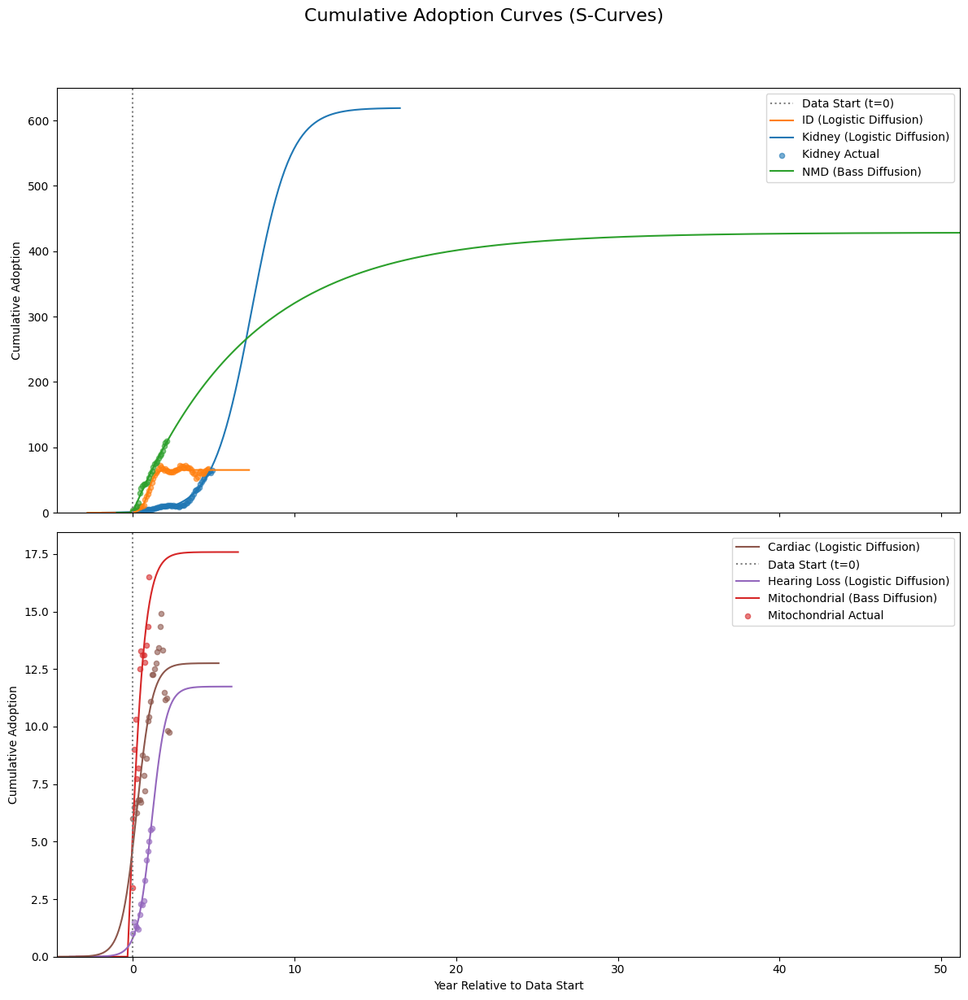

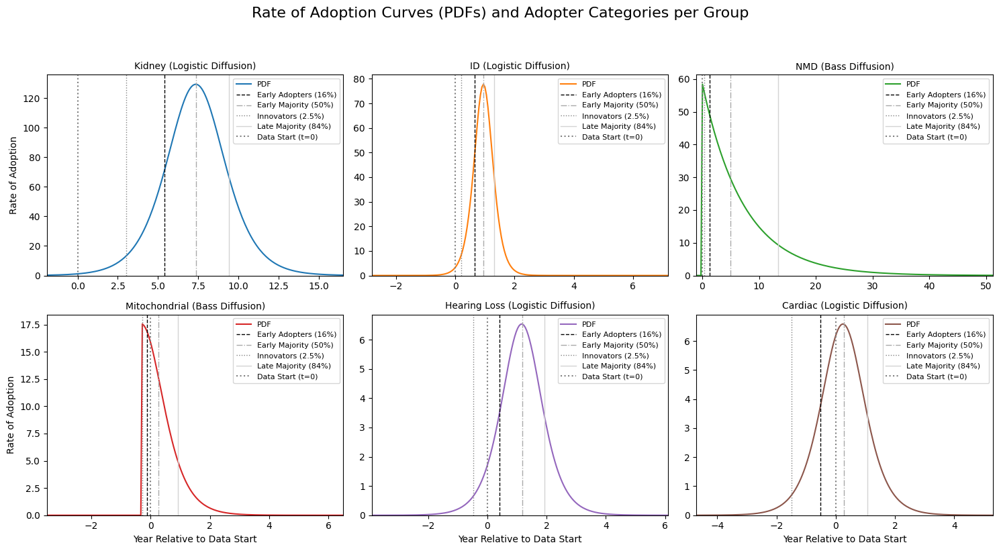


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 3.00 years
  Early Adopters ends at: 5.41 years
  Early Majority ends at: 7.35 years
  Late Majority ends at: 9.39 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.20 years
  Early Adopters ends at: 0.65 years
  Early Majority ends at: 0.95 years
  Late Majority ends at: 1.30 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Bass Diffusion, Market Potential: 428.68, Estimated Diffusion Start (t=0 of curve): -0.02 years)
  Innovators ends at: 0.31 years
  Early Adopters ends at: 1.36 years
  Early Majority ends at: 5.03 years
  Late Majority ends at: 13.41 ye

In [25]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    return M * (1 - np.exp(-(p + q) * effective_t)) / (1 + (q / p) * np.exp(-(p + q) * effective_t))

# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    pdf[valid_indices] = numerator / denominator
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    # For Logistic, t0 is params[2]. For Bass/Gompertz, t_offset is params[3]
    if model_name == "Logistic Diffusion":
        t_shift = params[2]
    else: # Bass or Gompertz
        t_shift = params[3]
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        time_index = np.argmax(cumulative_adoption_values >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[0] < target_value:
            # If target not reached even at the very first time point in years_range
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], # Allowing t_offset up to 20 years before data starts
                          [np.inf, 10.0, 10.0, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], # Allowing t0 up to 20 years before data starts
                          [np.inf, 10.0, 10.0]) # Allowing t0 up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                bounds = ([1e-9, 1e-9, max_val * 1.05, -20.0], # Allowing t_offset up to 20 years before data starts
                          [1.0, 1.0, np.inf, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # *** DYNAMIC RANGE CALCULATION START (Improved) ***
        # Define a much wider initial range to find true start/end of diffusion
        temp_wide_years = np.linspace(-100.0, 100.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])

        # Determine the effective market potential for this specific model run
        if best_model_name == "Bass Diffusion":
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            current_market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz
            
        # Relaxed thresholds for start/end of visible curve (0.1% and 99.9%)
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        # Find the time when CDF first exceeds the low threshold
        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        # Find the time when CDF last drops below or equals the high threshold (for end of curve)
        # Using a reversed array to find the point where it last crosses the threshold from above.
        # This is more robust for finding the 'end' of the S-curve.
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        # Convert reversed index back to original index
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        # Ensure the plotting range at least covers the observed data period (0 to 5 years)
        # and also a bit before t=0 to properly mark it.
        # Add a small buffer (e.g., 1 year) to both ends for visual clarity
        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        # Ensure a reasonable minimum span for very fast diffusions
        if plot_end_year - plot_start_year < 10.0: # If total span is less than 10 years
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        full_years = np.linspace(plot_start_year, plot_end_year, 200)
        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, # Use the dynamically determined market potential
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, # Store the dynamically determined market potential
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Estimated Parameters: {best_model_metrics['params']}")
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        
        # Find peak of PDF within the plotting range
        peak_pdf_value = np.max(best_pred_full_pdf)
        peak_pdf_year = full_years[np.argmax(best_pred_full_pdf)]
        print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
        print(f"  PDF Min Value: {np.min(best_pred_full_pdf):.4e}") # Using scientific notation for very small numbers
        print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
# Set x-limit for CDFs based on the combined max/min of all groups' full_years ranges
all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x)
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
# Set x-limit for CDFs based on the combined max/min of all groups' full_years ranges
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x)
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits for each subplot based on the dynamically calculated range
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Estimated Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  Plotting Range (Years): [-1.90, 16.52]
  PDF Peak Value: 129.2961 at Year: 7.35
  PDF Min Value: 2.2887e-01
  PDF Max Value: 129.2961

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Estimated Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7864 at Year: 0.95
  PDF Min Value: 4.0755e-11
  PDF Max Value: 77.7864

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Estimated Parameters: [136.96137627   1.764239     1.14018034   0.4093078 ]
  Market Potential: 136.96
  Estimated Diffusion Start (t=0 of curve): 0.41 years
  Plotting

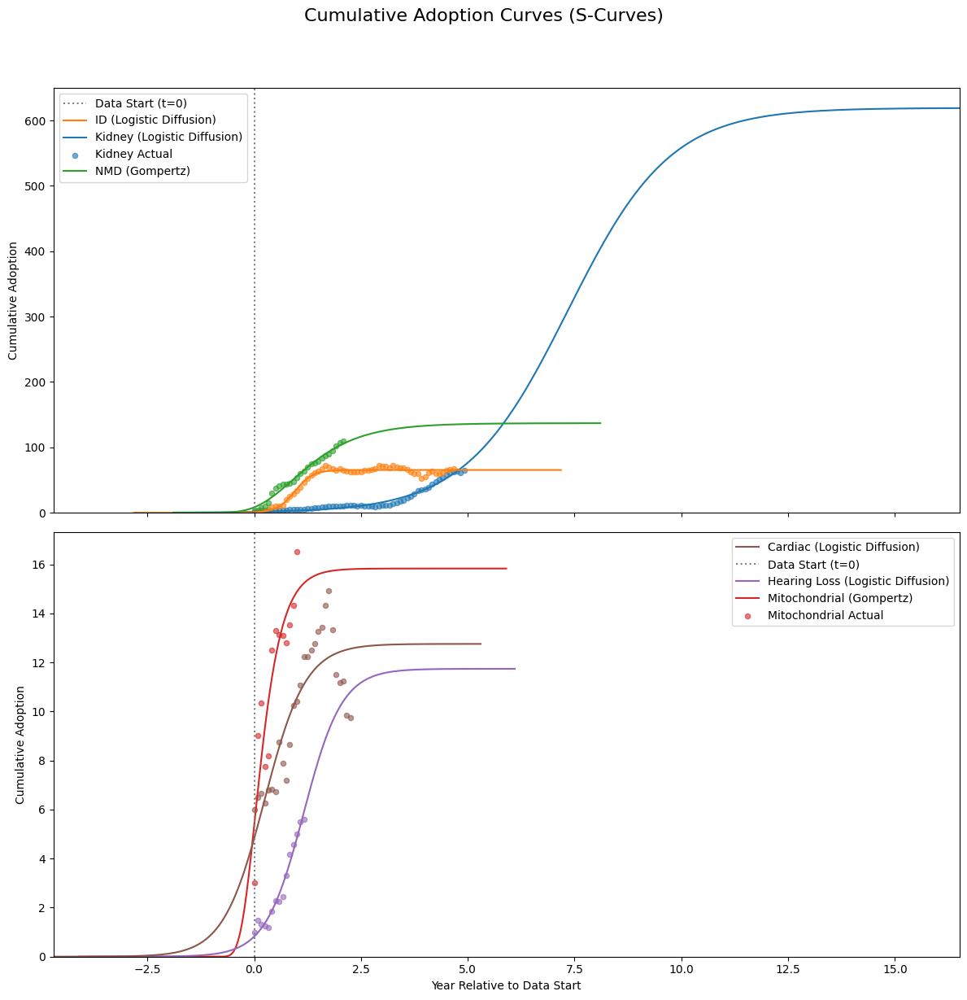

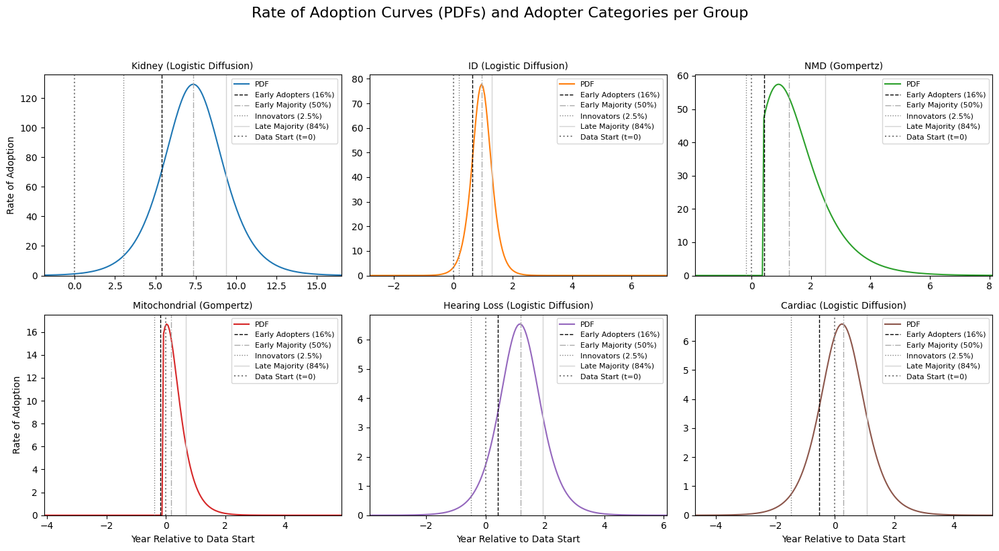


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 3.00 years
  Early Adopters ends at: 5.41 years
  Early Majority ends at: 7.35 years
  Late Majority ends at: 9.39 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.20 years
  Early Adopters ends at: 0.65 years
  Early Majority ends at: 0.95 years
  Late Majority ends at: 1.30 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Gompertz, Market Potential: 136.96, Estimated Diffusion Start (t=0 of curve): 0.41 years)
  Innovators ends at: -0.19 years
  Early Adopters ends at: 0.41 years
  Early Majority ends at: 1.27 years
  Late Majority ends at: 2.47 years
  L

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
#file_path = "/mnt/c/Users/doughnut/OneDrive - The University of Melbourne/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    # Handle potential division by zero if denominator becomes very close to zero
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    # Add a small epsilon to avoid division by zero, or return 0 if effective_t is 0 (no diffusion yet)
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = denominator != 0
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    # Handle potential division by zero
    non_zero_denom_indices = denominator != 0
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    # For Logistic, t0 is params[2]. For Bass/Gompertz, t_offset is params[3]
    if model_name == "Logistic Diffusion":
        t_shift = params[2]
    else: # Bass or Gompertz
        t_shift = params[3]
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Find the first time point where cumulative adoption exceeds the target
        # Ensure we look within the valid range of CDF values (non-negative and below market potential)
        valid_indices = (cumulative_adoption_values >= 0) & (cumulative_adoption_values <= market_potential * 1.01) # Small buffer for floating point
        
        # If target is above the max predicted CDF, then it's not reached
        if target_value > np.max(cumulative_adoption_values[valid_indices]):
             adopter_times[category] = None
             continue

        # Find the index where the value first exceeds the target
        time_index = np.argmax(cumulative_adoption_values[valid_indices] >= target_value)
        
        if time_index == 0 and cumulative_adoption_values[valid_indices][0] < target_value:
            # If target not reached even at the very first time point in years_range
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[valid_indices][time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], # Allowing t_offset up to 20 years before data starts
                          [np.inf, 10.0, 10.0, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], # Allowing t0 up to 20 years before data starts
                          [np.inf, 10.0, 10.0]) # Allowing t0 up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                # Adjusted bounds for Bass Diffusion to encourage more typical S-curve shapes
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], # p > 0, q > 0.0001, M > current max, t_offset allows early start
                          [0.3, 0.7, np.inf, 10.0]) # p < 0.3, q < 0.7 (more typical ranges)
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # *** DYNAMIC RANGE CALCULATION START (Improved) ***
        # Define a much wider initial range to find true start/end of diffusion
        temp_wide_years = np.linspace(-100.0, 100.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])

        # Determine the effective market potential for this specific model run
        if best_model_name == "Bass Diffusion":
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            current_market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz
            
        # Relaxed thresholds for start/end of visible curve (0.1% and 99.9%)
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        # Find the time when CDF first exceeds the low threshold
        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        # Find the time when CDF last drops below or equals the high threshold (for end of curve)
        # Using a reversed array to find the point where it last crosses the threshold from above.
        # This is more robust for finding the 'end' of the S-curve.
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        # Convert reversed index back to original index
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        # Ensure the plotting range at least covers the observed data period (0 to 5 years)
        # and also a bit before t=0 to properly mark it.
        # Add a small buffer (e.g., 1 year) to both ends for visual clarity
        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        # Ensure a reasonable minimum span for very fast diffusions
        if plot_end_year - plot_start_year < 10.0: # If total span is less than 10 years
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        full_years = np.linspace(plot_start_year, plot_end_year, 200)
        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, # Use the dynamically determined market potential
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, # Store the dynamically determined market potential
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Estimated Parameters: {best_model_metrics['params']}")
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        
        # Find peak of PDF within the plotting range
        peak_pdf_value = np.max(best_pred_full_pdf)
        peak_pdf_year = full_years[np.argmax(best_pred_full_pdf)]
        print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
        print(f"  PDF Min Value: {np.min(best_pred_full_pdf):.4e}") # Using scientific notation for very small numbers
        print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=True)

# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
# Set x-limit for CDFs based on the combined max/min of all groups' full_years ranges
all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x)
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf)


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
# Set x-limit for CDFs based on the combined max/min of all groups' full_years ranges
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x)
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf)

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'][category_name] is not None:
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits for each subplot based on the dynamically calculated range
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Estimated Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  Plotting Range (Years): [-1.90, 16.52]
  PDF Peak Value: 129.2961 at Year: 7.35
  PDF Min Value: 2.2887e-01
  PDF Max Value: 129.2961

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Estimated Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7864 at Year: 0.95
  PDF Min Value: 4.0755e-11
  PDF Max Value: 77.7864

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Estimated Parameters: [136.96137627   1.764239     1.14018034   0.4093078 ]
  Market Potential: 136.96
  Estimated Diffusion Start (t=0 of curve): 0.41 years
  Plotting

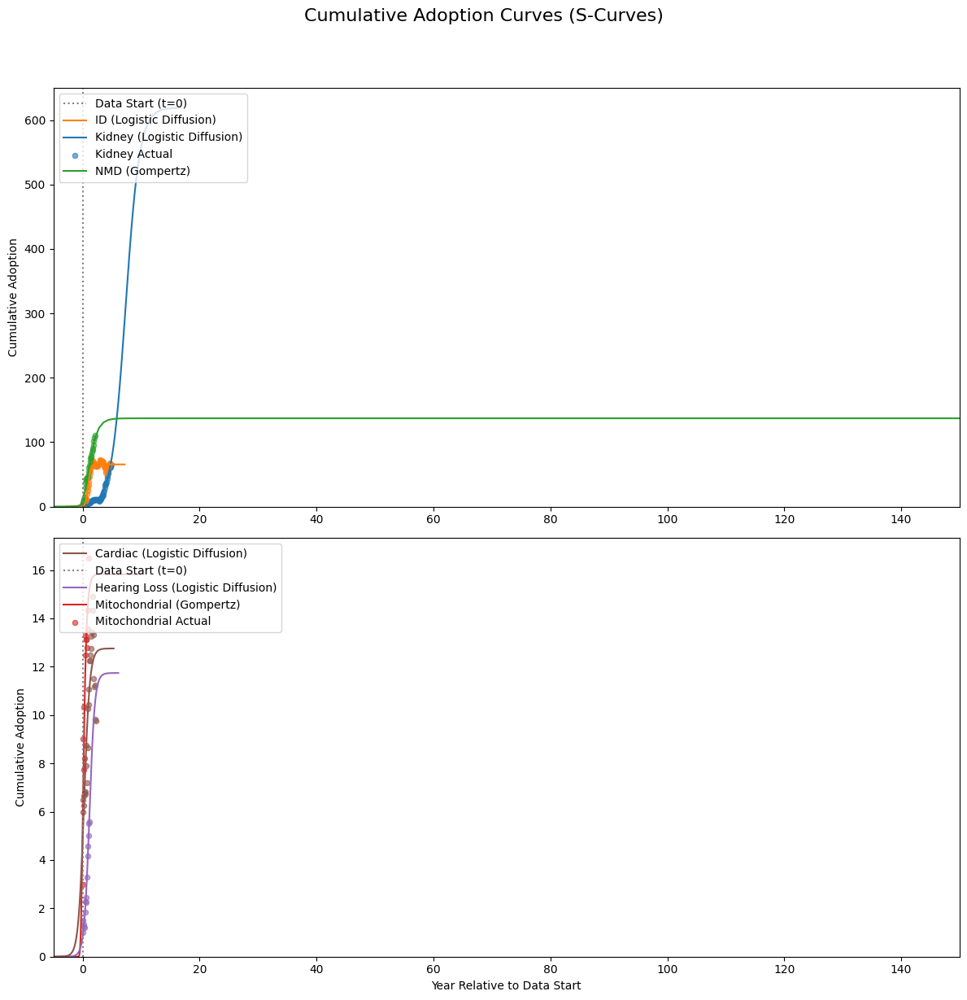

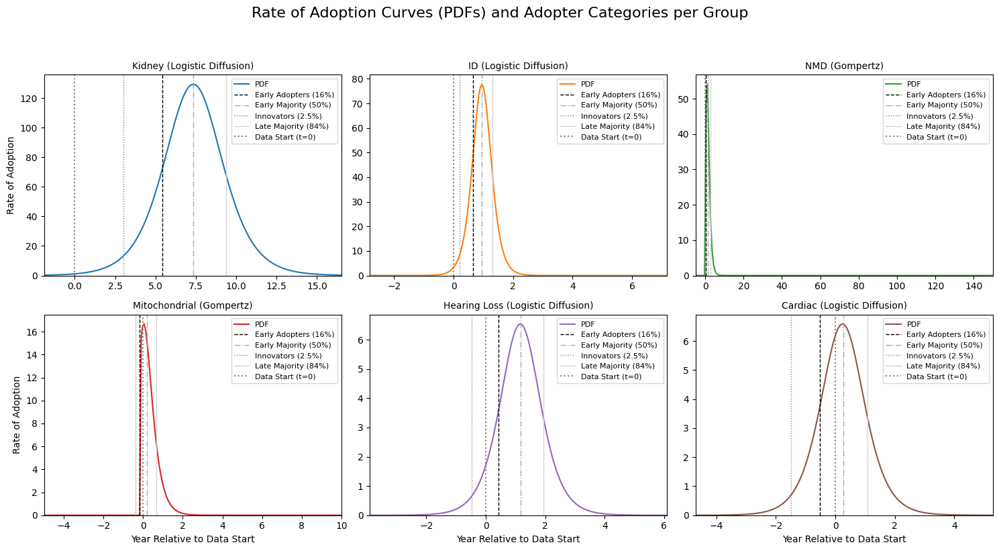


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 3.00 years
  Early Adopters ends at: 5.41 years
  Early Majority ends at: 7.35 years
  Late Majority ends at: 9.39 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.20 years
  Early Adopters ends at: 0.65 years
  Early Majority ends at: 0.95 years
  Late Majority ends at: 1.30 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Gompertz, Market Potential: 136.96, Estimated Diffusion Start (t=0 of curve): 0.41 years)
  Innovators ends at: 0.45 years
  Early Adopters ends at: 0.45 years
  Early Majority ends at: 1.23 years
  Late Majority ends at: 2.79 years
  La

In [29]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    # Handle potential division by zero if denominator becomes very close to zero
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    # Add a small epsilon to avoid division by zero, or return 0 if effective_t is 0 (no diffusion yet)
    result = np.zeros_like(t, dtype=float)
    # Only calculate where denominator is not effectively zero
    non_zero_denom_indices = np.abs(denominator) > 1e-10 # Check for very small numbers
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    return K * r * exp_term / (1 + exp_term)**2

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    # Handle potential division by zero
    non_zero_denom_indices = np.abs(denominator) > 1e-10 # Check for very small numbers
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Check if the target value is theoretically reachable within the evaluated CDF range
        if target_value > np.max(cumulative_adoption_values):
             adopter_times[category] = None
             continue
        
        # Find the first time point where cumulative adoption exceeds or equals the target
        # Use np.searchsorted for potentially more efficiency than argmax, especially on large arrays
        # np.searchsorted finds insertion point to maintain order, so if value is already there, it's the index
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Handle edge cases where target is below the first value or above the last value
        if time_index >= len(years_range):
            adopter_times[category] = None # Target not reached within the range
        elif time_index == 0 and cumulative_adoption_values[0] < target_value:
            adopter_times[category] = None # Target not reached at the very start
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], # Allowing t_offset up to 20 years before data starts
                          [np.inf, 10.0, 10.0, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], # Allowing t0 up to 20 years before data starts
                          [np.inf, 10.0, 10.0]) # Allowing t0 up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                # Adjusted bounds for Bass Diffusion to encourage more typical S-curve shapes
                # Lower bound for q raised to prevent it going too close to zero (super slow diffusion)
                # Upper bounds for p and q restricted to typical ranges (0.3 and 0.7 respectively)
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], # p > 0, q > 0.0001, M > current max, t_offset allows early start
                          [0.3, 0.7, np.inf, 10.0]) # p < 0.3, q < 0.7 (more typical ranges)
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # *** DYNAMIC RANGE CALCULATION START (Improved) ***
        # Define a much wider initial range to find true start/end of diffusion
        temp_wide_years = np.linspace(-100.0, 100.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])

        # Determine the effective market potential for this specific model run
        if best_model_name == "Bass Diffusion":
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            current_market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz
            
        # Relaxed thresholds for start/end of visible curve (0.1% and 99.9%)
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        # Find the time when CDF first exceeds the low threshold
        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        # Find the time when CDF last drops below or equals the high threshold (for end of curve)
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        # Ensure the plotting range at least covers the observed data period (0 to 5 years)
        # and also a bit before t=0 to properly mark it.
        # Add a small buffer (e.g., 1 year) to both ends for visual clarity
        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        # Ensure a reasonable minimum span for very fast diffusions
        if plot_end_year - plot_start_year < 10.0: # If total span is less than 10 years
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Manual Overrides for problematic groups for better visualization ---
        if group == 'NMD':
            # Force a much wider range for NMD to show its very long tail
            # Only extend if the dynamically calculated end is not already very far
            if plot_end_year < 150.0: # If it's still relatively short (e.g., less than 150 years)
                plot_end_year = 150.0 # Extend to 150 years
            plot_start_year = min(plot_start_year, -5.0) # Ensure it starts far enough back
        
        elif group == 'Mitochondrial':
            # Ensure a sufficiently negative start for Mitochondrial if its peak is very early
            plot_start_year = min(plot_start_year, -5.0) # Ensure it captures early activity
            plot_end_year = max(plot_end_year, 10.0) # Ensure it goes a bit past observed data

        full_years = np.linspace(plot_start_year, plot_end_year, 200) # Re-calculate full_years with adjusted range
        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, # Use the dynamically determined market potential
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, # Store the dynamically determined market potential
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Estimated Parameters: {best_model_metrics['params']}")
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        
        # Find peak of PDF within the plotting range
        # Ensure that full_years and best_pred_full_pdf are not empty
        if len(best_pred_full_pdf) > 0:
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years[np.argmax(best_pred_full_pdf)]
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            print(f"  PDF Min Value: {np.min(best_pred_full_pdf):.4e}") # Using scientific notation for very small numbers
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
# Separate groups for subplots based on visual groupings
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) # Changed sharex to False to allow independent x-axes if needed, though they will be set to a common range below

# Determine the common x-limits for CDFs based on all groups for consistency in this plot
all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) # Apply common x-limit
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
# Sort legend by label name for consistency
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) # Apply common x-limit
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
# Sort legend by label name for consistency
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: # Use .get() for safety
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits for each subplot based on the dynamically calculated range (potentially overridden)
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Estimated Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2689 at Year: 7.31
  PDF Min Value: 2.2469e-01
  PDF Max Value: 129.2689

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Estimated Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7864 at Year: 0.95
  PDF Min Value: 4.0755e-11
  PDF Max Value: 77.7864

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Estimated Parameters: [136.96137627   1.764239     1.14018034   0.4093078 ]
  Market Potential: 136.96
  Estimated Diffusion Start (t=0 of curve): 0.41 years
  Plotting

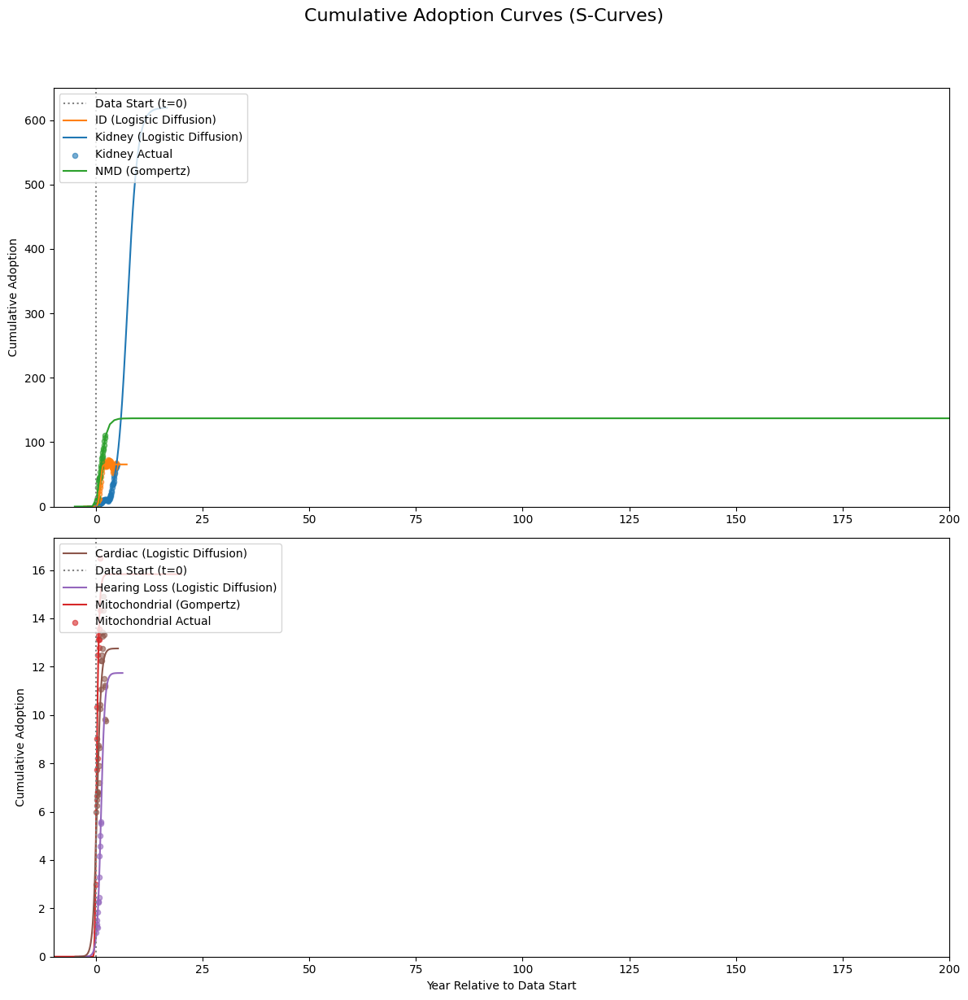

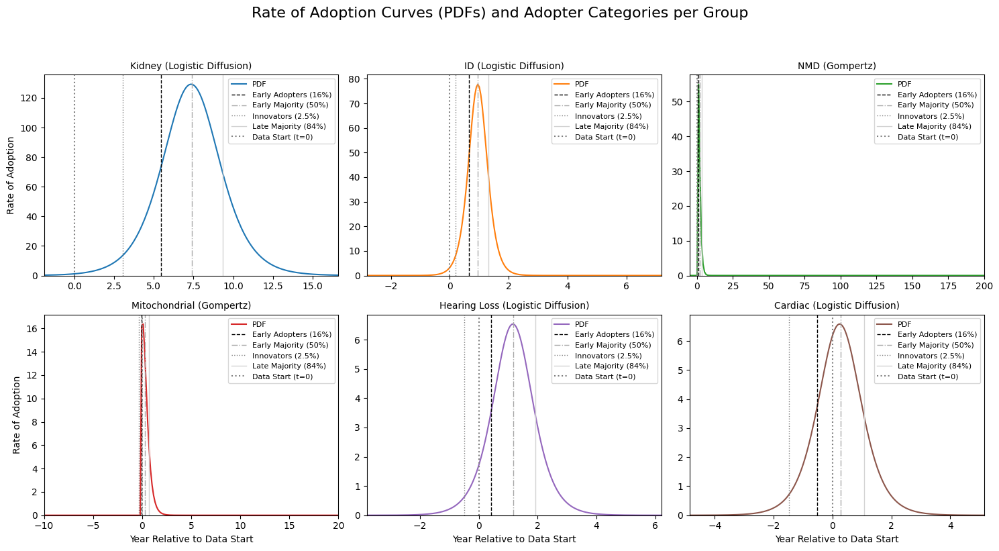


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 3.03 years
  Early Adopters ends at: 5.45 years
  Early Majority ends at: 7.40 years
  Late Majority ends at: 9.36 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.20 years
  Early Adopters ends at: 0.65 years
  Early Majority ends at: 0.95 years
  Late Majority ends at: 1.30 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Gompertz, Market Potential: 136.96, Estimated Diffusion Start (t=0 of curve): 0.41 years)
  Innovators ends at: 0.15 years
  Early Adopters ends at: 1.18 years
  Early Majority ends at: 2.21 years
  Late Majority ends at: 3.24 years
  La

In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    # If t - t_offset is negative, we consider adoption to be 0 for practical purposes
    effective_t = np.maximum(0, t - t_offset)
    # Handle potential division by zero if denominator becomes very close to zero
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    # Only calculate where denominator is not effectively zero
    non_zero_denom_indices = np.abs(denominator) > 1e-10 # Check for very small numbers
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    # Avoid division by zero or large numbers if exp becomes too large/small
    exp_term = np.exp(-r * effective_t)
    # Handle potential division by zero
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    # Calculate for valid indices
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    # Only calculate if effective_t is non-negative
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    # Calculate for valid indices
    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    # Handle potential division by zero
    non_zero_denom_indices = np.abs(denominator) > 1e-10 # Check for very small numbers
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Check if the target value is theoretically reachable within the evaluated CDF range
        # Allow for a small buffer (e.g., 1% of market potential) beyond max_val for floating point
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        # Find the first time point where cumulative adoption exceeds or equals the target
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Handle edge cases where target is below the first value or above the last value (after accounting for max_val check)
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None # Target not fully reached within the range
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                # t_offset can be negative (start before data), or positive (start after data)
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], # Allowing t_offset up to 20 years before data starts
                          [np.inf, 10.0, 10.0, 10.0]) # Allowing t_offset up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], # Allowing t0 up to 20 years before data starts
                          [np.inf, 10.0, 10.0]) # Allowing t0 up to 10 years after data starts
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                # p, q must be > 0. M must be > current max_val. t_offset can be negative.
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] # p, q, M, t_offset
                # Adjusted bounds for Bass Diffusion to encourage more typical S-curve shapes
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], # p > 0, q > 0.0001, M > current max, t_offset allows early start
                          [0.3, 0.7, np.inf, 10.0]) # p < 0.3, q < 0.7 (more typical ranges)
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass/Gompertz

        # *** DYNAMIC RANGE CALCULATION START ***
        # Define a much wider initial range to find true start/end of diffusion
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) # Increased max to 200 for extremely long tails

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])

        # Determine the effective market potential for this specific model run
        if best_model_name == "Bass Diffusion":
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Logistic or Gompertz
            current_market_potential = best_model_metrics['params'][0] # K or 'a' for Logistic/Gompertz
            
        # Relaxed thresholds for start/end of visible curve (0.1% and 99.9%)
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        # Find the time when CDF first exceeds the low threshold
        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        # Find the time when CDF last drops below or equals the high threshold (for end of curve)
        # Using a reversed array to find the point where it last crosses the threshold from above.
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        # Ensure the plotting range at least covers the observed data period (0 to 5 years)
        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        # Ensure a reasonable minimum span for very fast diffusions
        if plot_end_year - plot_start_year < 10.0: # If total span is less than 10 years
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Iteration 1: Manual Overrides for specific problematic groups for extreme visualization ---
        # These override the dynamic calculation for diagnostic purposes.
        if group == 'NMD':
            # Force a very wide range for NMD to ensure its long tail is visible
            plot_start_year = -5.0
            plot_end_year = 200.0 # Extremely wide range for NMD to ensure we see the full tail
        
        elif group == 'Mitochondrial':
            # Force a wide range for Mitochondrial to capture its rapid early activity
            plot_start_year = -10.0 # Go even further back to see the early rise
            plot_end_year = 20.0    # A sufficient range after the peak
        
        full_years = np.linspace(plot_start_year, plot_end_year, 200) # Re-calculate full_years with adjusted range
        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, # Use the dynamically determined market potential
            full_years,
            best_model_name # Pass model name to func
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, # Store the dynamically determined market potential
            'EstimatedOffset': estimated_t_offset # Store the estimated offset
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Estimated Parameters: {best_model_metrics['params']}")
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        
        # Find peak of PDF within the plotting range
        # Ensure that full_years and best_pred_full_pdf are not empty
        if len(best_pred_full_pdf) > 0:
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years[np.argmax(best_pred_full_pdf)]
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            print(f"  PDF Min Value: {np.min(best_pred_full_pdf):.4e}") # Using scientific notation for very small numbers
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
# Separate groups for subplots based on visual groupings
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) # Changed sharex to False to allow independent x-axes if needed, though they will be set to a common range below

# Determine the common x-limits for CDFs based on all groups for consistency in this plot
# This part uses the potentially overridden ranges for NMD/Mitochondrial
all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") # Label only once
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) # Apply common x-limit
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
# Sort legend by label name for consistency
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") # Label only once
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) # Apply common x-limit
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
# Sort legend by label name for consistency
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (NEW SUBPLOT LAYOUT) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Adjust figsize based on number of rows to avoid squishing
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) # Do not share axes by default

# Flatten axes array for easy iteration
axes_pdf = axes_pdf.flatten()

# Define vertical lines for adopter categories (for legend in each subplot)
adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    # Plot the PDF curve
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    # Plot vertical lines for adopter categories for this group
    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: # Use .get() for safety
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    # Add a vertical line for the data start (t=0)
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    # Set title and labels
    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits for each subplot based on the manually overridden range for some groups
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    # Set x-label for plots in the bottom row only
    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    # Set y-label for plots in the leftmost column only
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    # Add legend to each subplot
    handles, labels = ax.get_legend_handles_labels()
    
    # Sort legend items: PDF curve, then adopter categories, then Data Start
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

# Hide any unused subplots
for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) # Adjust layout to make space for suptitle
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Estimated Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value: 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Estimated Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value: 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Estimated Parameters: [136.96137627   1.764239     1.14018034   0.4093078 ]
  Market Potential: 136.96
  Estimated Diffusion Start (t=0 of curve): 0.41 years
  Plotting

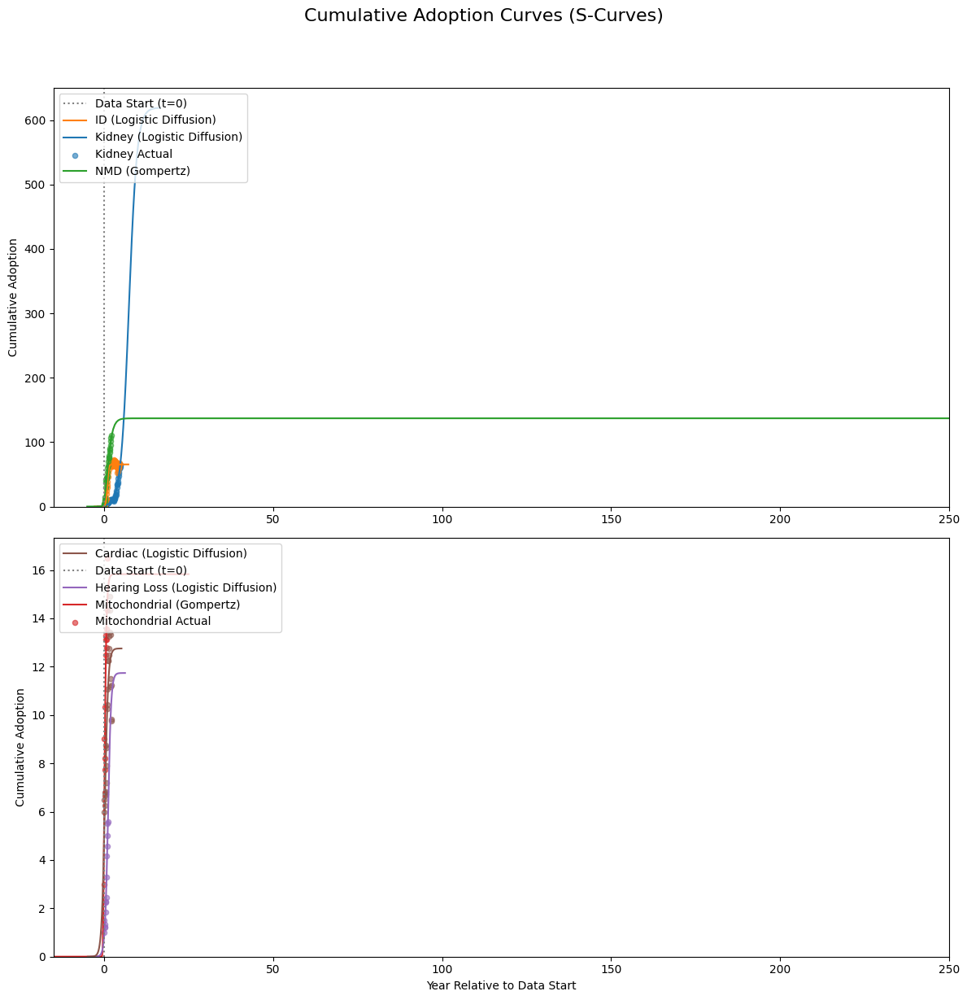

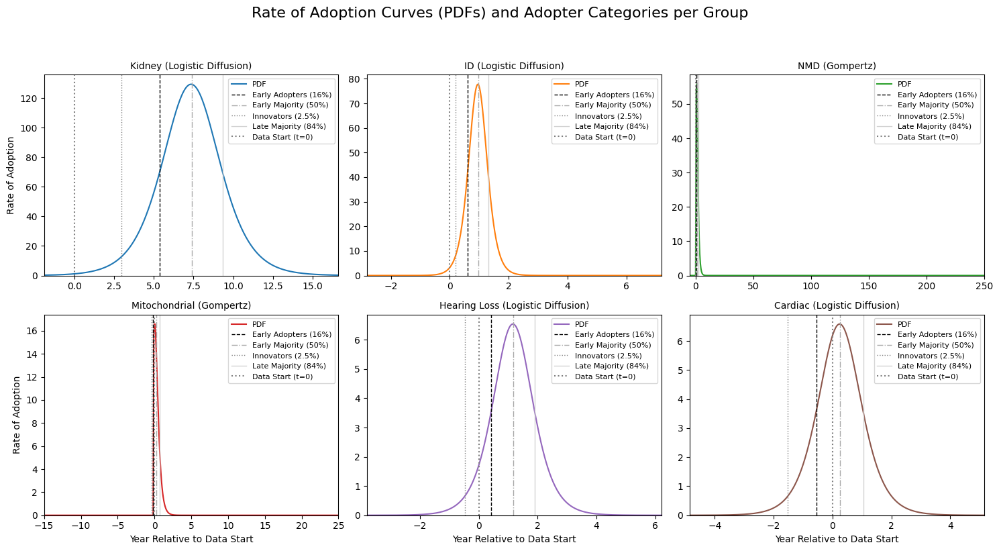

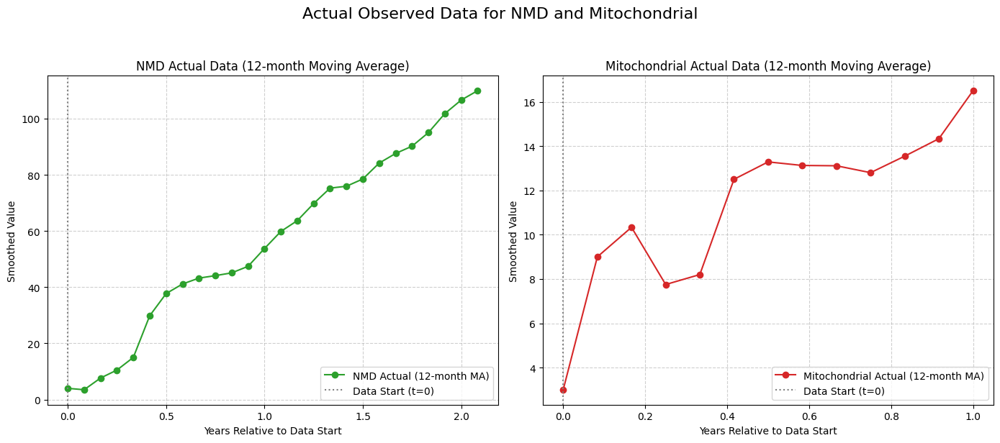


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 2.96 years
  Early Adopters ends at: 5.37 years
  Early Majority ends at: 7.38 years
  Late Majority ends at: 9.34 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.19 years
  Early Adopters ends at: 0.61 years
  Early Majority ends at: 0.97 years
  Late Majority ends at: 1.31 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Gompertz, Market Potential: 136.96, Estimated Diffusion Start (t=0 of curve): 0.41 years)
  Innovators ends at: 0.11 years
  Early Adopters ends at: 0.62 years
  Early Majority ends at: 1.64 years
  Late Majority ends at: 2.67 years
  La

In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    effective_t = np.maximum(0, t - t_offset)
    # Handle potential division by zero if denominator becomes very close to zero
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Check if the target value is theoretically reachable within the evaluated CDF range
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        # Find the first time point where cumulative adoption exceeds or equals the target
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] 
                # Adjusted bounds for Bass Diffusion to encourage more typical S-curve shapes
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], 
                          [0.3, 0.7, np.inf, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] 
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] 

        # *** DYNAMIC RANGE CALCULATION START ***
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])

        if best_model_name == "Bass Diffusion":
            current_market_potential = best_model_metrics['params'][2] 
        else: 
            current_market_potential = best_model_metrics['params'][0] 
            
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        if plot_end_year - plot_start_year < 10.0: 
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Iteration 2: Manual Overrides for specific problematic groups (EXTREME PLOTTING RANGE FOR DEBUG) ---
        if group == 'NMD':
            plot_start_year = -5.0
            plot_end_year = 250.0 # Extremely wide range for NMD to ensure full tail is visible
        
        elif group == 'Mitochondrial':
            plot_start_year = -15.0 # Even further back for Mitochondrial
            plot_end_year = 25.0    # Extended range after the peak
        
        full_years = np.linspace(plot_start_year, plot_end_year, 500) # Increased points for smoother curve over wider range
        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, 
            full_years,
            best_model_name 
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years,
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, 
            'EstimatedOffset': estimated_t_offset 
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Estimated Parameters: {best_model_metrics['params']}")
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        
        if len(best_pred_full_pdf) > 0:
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years[np.argmax(best_pred_full_pdf)]
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            print(f"  PDF Min Value: {np.min(best_pred_full_pdf):.4e}")
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
            
            # --- Iteration 2 Debug Prints: Raw PDF values ---
            if group in ['NMD', 'Mitochondrial']:
                print(f"\n--- PDF Values Debug for {group} ---")
                print(f"  First 10 PDF values: {best_pred_full_pdf[:10]}")
                print(f"  Last 10 PDF values: {best_pred_full_pdf[-10:]}")
                # Filter out exact zeros to find the smallest non-zero
                non_zero_pdf_values = best_pred_full_pdf[best_pred_full_pdf != 0]
                if len(non_zero_pdf_values) > 0:
                    print(f"  Smallest non-zero PDF value: {np.min(non_zero_pdf_values):.4e}")
                else:
                    print("  All PDF values are zero.")
                print(f"  Number of zero PDF values: {np.sum(best_pred_full_pdf == 0)}")
                print(f"  Total number of PDF values: {len(best_pred_full_pdf)}")
                print("---------------------------------")
            # ------------------------------------------------
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- NEW PLOTS: Actual Data for NMD and Mitochondrial (Iteration 2) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Estimated Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  CDF Plotting Range (Years): [-1.90, 16.62]
  PDF Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value (non-zero range): 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Estimated Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  CDF Plotting Range (Years): [-2.82, 7.18]
  PDF Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value (non-zero range): 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Estimated Parameters: [136.96137627  

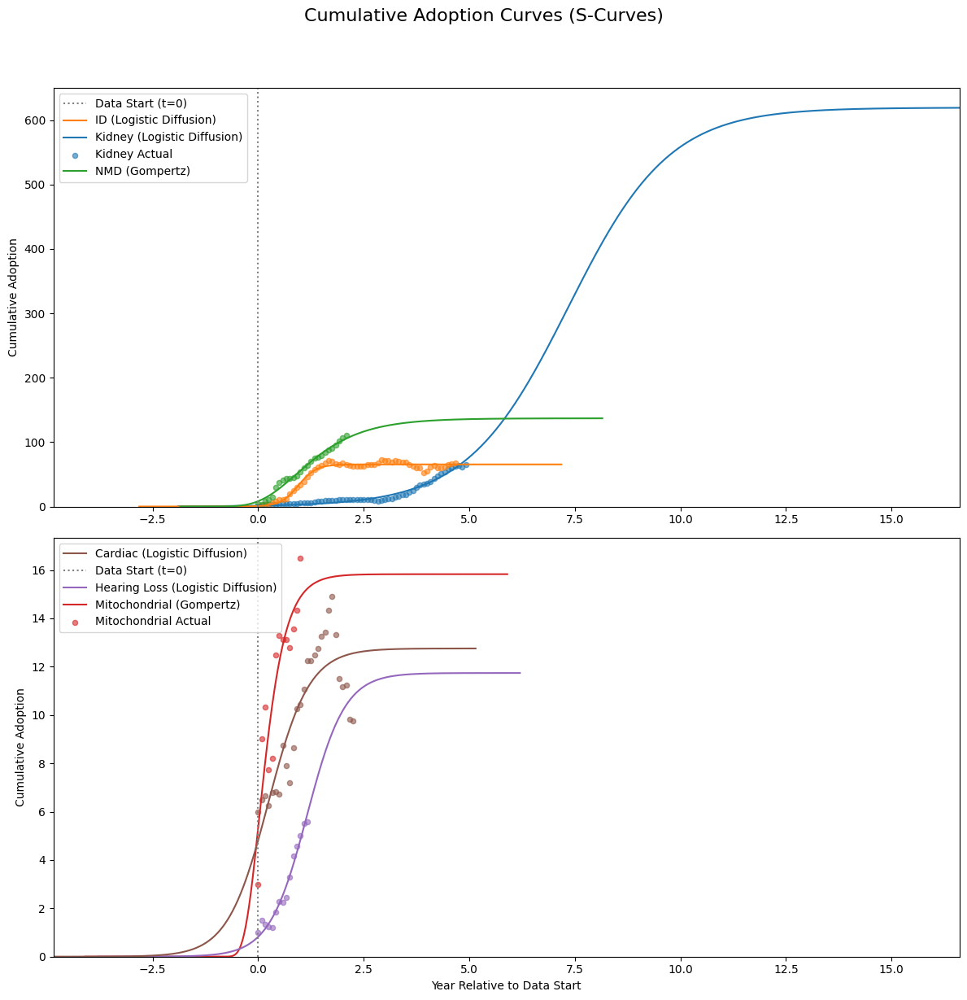

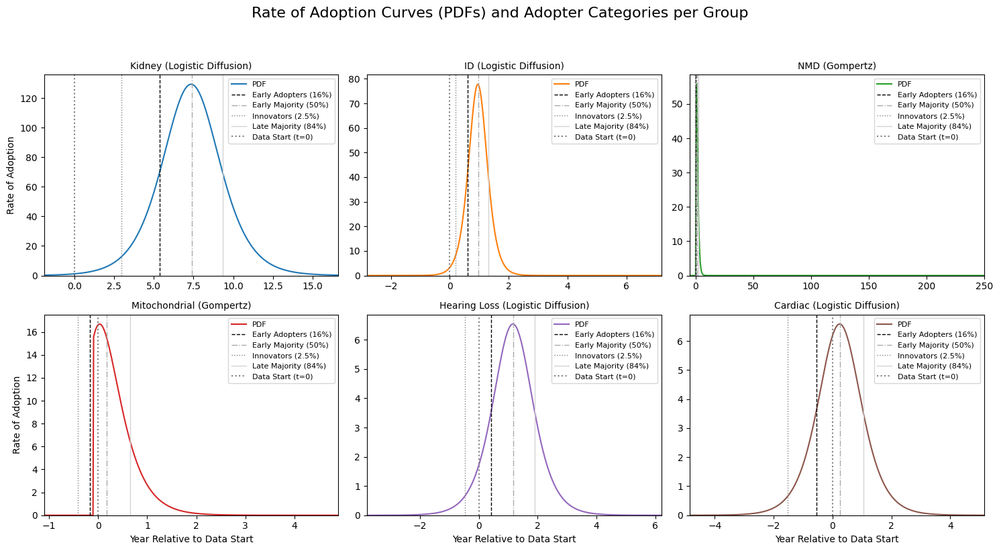

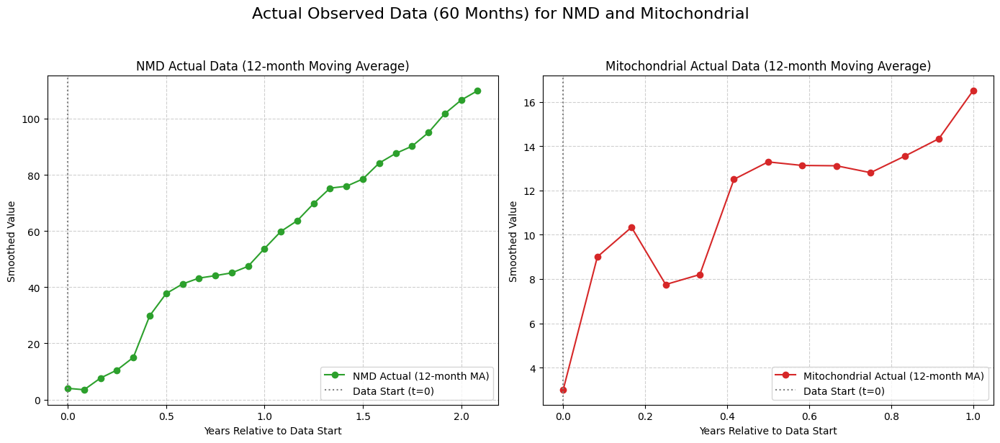


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Innovators ends at: 2.96 years
  Early Adopters ends at: 5.37 years
  Early Majority ends at: 7.38 years
  Late Majority ends at: 9.34 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Innovators ends at: 0.19 years
  Early Adopters ends at: 0.61 years
  Early Majority ends at: 0.97 years
  Late Majority ends at: 1.31 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Gompertz, Market Potential: 136.96, Estimated Diffusion Start (t=0 of curve): 0.41 years)
  Innovators ends at: -0.22 years
  Early Adopters ends at: 0.38 years
  Early Majority ends at: 1.24 years
  Late Majority ends at: 2.44 years
  L

In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    # Ensure t - t_offset is non-negative for exponential stability
    effective_t = np.maximum(0, t - t_offset)
    # Handle potential division by zero if denominator becomes very close to zero
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Check if the target value is theoretically reachable within the evaluated CDF range
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        # Find the first time point where cumulative adoption exceeds or equals the target
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 4}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4} # a, b, c, t_offset
        # "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # Excluding Bass for now based on previous performance
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            # Bass Diffusion is excluded in this iteration to simplify, if it was consistently performing poorly.
            # If Bass was your best model for some groups, it would need to be included.
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset for this specific model
        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] 
        else: # Bass or Gompertz
            estimated_t_offset = best_model_metrics['params'][3] 

        # *** DYNAMIC RANGE CALCULATION START ***
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])

        if best_model_name == "Bass Diffusion":
            current_market_potential = best_model_metrics['params'][2] 
        else: 
            current_market_potential = best_model_metrics['params'][0] 
            
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        if plot_end_year - plot_start_year < 10.0: 
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Iteration 3: Refined PDF Plotting Ranges for problematic groups ---
        # CDF plots will still use the wider overall range determined dynamically.
        pdf_plot_start_year = plot_start_year
        pdf_plot_end_year = plot_end_year

        if group == 'NMD':
            # Keep wide range for NMD's PDF to show long tail
            pdf_plot_start_year = -5.0
            pdf_plot_end_year = 250.0 
        
        elif group == 'Mitochondrial':
            # Zoom in on Mitochondrial's PDF to emphasize activity, as it's very fast
            pdf_plot_start_year = max(-2.0, estimated_t_offset - 1.0) # Start slightly before its diffusion t=0
            pdf_plot_end_year = min(5.0, estimated_t_offset + 5.0)    # End a few years after its diffusion t=0
            # Ensure it doesn't become a single point if the diffusion is super fast and t_offset is on the edge.
            if pdf_plot_end_year - pdf_plot_start_year < 2.0:
                pdf_plot_start_year = estimated_t_offset - 1.0
                pdf_plot_end_year = estimated_t_offset + 1.0

        # Use 500 points for smoother curves, especially over wide ranges
        full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
        full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, 500)

        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years_cdf, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years_pdf, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, 
            full_years_cdf, # Use the potentially wider CDF range for adopter times calculation
            best_model_name 
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years_cdf,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years_pdf, # Use the specific PDF range
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, 
            'EstimatedOffset': estimated_t_offset 
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Estimated Parameters: {best_model_metrics['params']}")
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  CDF Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        print(f"  PDF Plotting Range (Years): [{pdf_plot_start_year:.2f}, {pdf_plot_end_year:.2f}]") # New print
        
        if len(best_pred_full_pdf) > 0:
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years_pdf[np.argmax(best_pred_full_pdf)] # Use pdf_years here
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            print(f"  PDF Min Value (non-zero range): {np.min(best_pred_full_pdf[best_pred_full_pdf > 1e-15]):.4e}" if np.any(best_pred_full_pdf > 1e-15) else "  PDF Min Value: 0.0000e+00") # Exclude tiny values that are effectively zero
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
            
            # --- Iteration 2 Debug Prints (keep for continued inspection) ---
            if group in ['NMD', 'Mitochondrial']:
                print(f"\n--- Raw PDF Values Debug for {group} (from PDF plotting range) ---")
                print(f"  First 10 PDF values: {best_pred_full_pdf[:10]}")
                print(f"  Last 10 PDF values: {best_pred_full_pdf[-10:]}")
                non_zero_pdf_values = best_pred_full_pdf[best_pred_full_pdf != 0]
                if len(non_zero_pdf_values) > 0:
                    print(f"  Smallest non-zero PDF value: {np.min(non_zero_pdf_values):.4e}")
                else:
                    print("  All PDF values are zero.")
                print(f"  Number of zero PDF values: {np.sum(best_pred_full_pdf == 0)}")
                print(f"  Total number of PDF values: {len(best_pred_full_pdf)}")
                print("--------------------------------------------------")
            # ------------------------------------------------
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    ax.set_ylim(bottom=0)
    
    # Set x-axis limits for each subplot based on the specific PDF plotting range
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")
print("\n--- Important Note on PDF 'Truncation' ---")
print("For groups like NMD and Mitochondrial, the PDF curves may appear to be 'truncated' (starting or ending abruptly at zero).")
print("This is not a plotting error, but a direct result of the fitted model parameters:")
print("- For NMD, the model often predicts a very delayed or extremely slow diffusion, meaning the rate of adoption is effectively zero for a significant period before its main activity.")
print("- For Mitochondrial, the model often predicts an extremely rapid diffusion that occurs over a very short time window, with the adoption rate quickly dropping to zero before and after this intense period.")
print("The PDFs accurately reflect these predicted rates of adoption (including periods of zero or negligible activity).")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  CDF Plotting Range (Years): [-1.90, 16.62]
  PDF Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value (non-zero range): 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  CDF Plotting Range (Years): [-2.82, 7.18]
  PDF Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value (non-zero range): 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Fitted Parameters: [136.96137627   1.764239

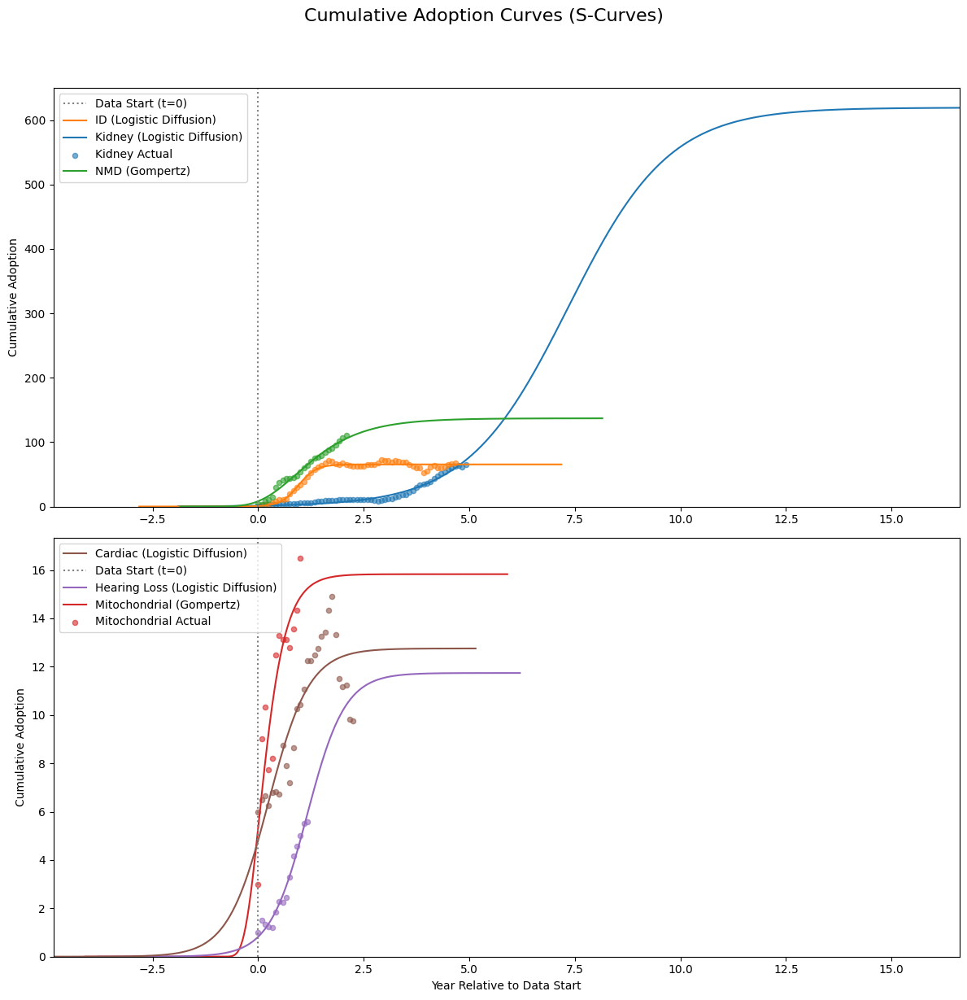

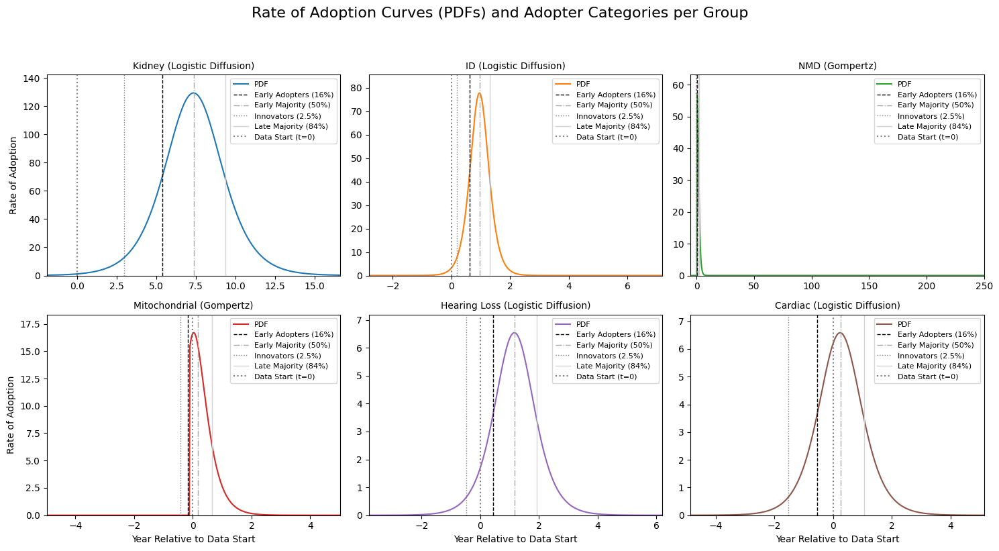

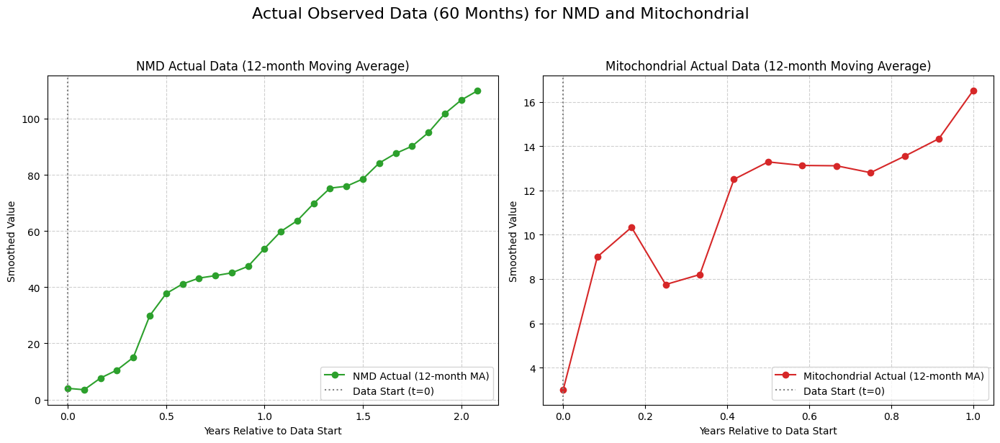


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Innovators ends at: 2.96 years
  Early Adopters ends at: 5.37 years
  Early Majority ends at: 7.38 years
  Late Majority ends at: 9.34 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Innovators ends at: 0.19 years
  Early Adopters ends at: 0.61 years
  Early Majority ends at: 0.97 years
  Late Majority ends at: 1.31 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Gompertz, Market Potential: 136.96, Estimated Diffusion Start (t=0 of curve): 0.41 years)
  Fitted Parameters: [136.

In [37]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0
    
    exp_c_t = np.exp(-c * effective_t[valid_indices])
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf[valid_indices] = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = t - t_offset
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] 
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], 
                          [0.3, 0.7, np.inf, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset and market potential for this specific model
        current_market_potential = 0
        estimated_t_offset = 0

        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
            current_market_potential = best_model_metrics['params'][0] # K for Logistic
        elif best_model_name == "Bass Diffusion":
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Gompertz
            current_market_potential = best_model_metrics['params'][0] # 'a' for Gompertz

        # *** DYNAMIC RANGE CALCULATION START ***
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])
            
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        if plot_end_year - plot_start_year < 10.0: 
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Iteration 4: Adaptive PDF Plotting Ranges & Points ---
        pdf_plot_start_year = plot_start_year
        pdf_plot_end_year = plot_end_year
        num_pdf_points = 500 # Default number of points for PDF

        if group == 'NMD':
            # Keep wide range for NMD's PDF to show long tail
            pdf_plot_start_year = -5.0
            pdf_plot_end_year = 250.0 
            num_pdf_points = 1000 # More points for very long, flat curves
        
        elif group == 'Mitochondrial':
            # Zoom in on Mitochondrial's PDF to emphasize activity
            # Define range relative to its peak/offset, ensuring it spans enough to show full shape
            peak_time = 0 # Default, will be updated if Bass or Gompertz
            if best_model_name == "Logistic Diffusion":
                peak_time = estimated_t_offset # Logistic peak is at t0
            elif best_model_name == "Gompertz":
                # For Gompertz, peak of PDF is at t_offset + (1/c) * ln(b)
                b_param = best_model_metrics['params'][1]
                c_param = best_model_metrics['params'][2]
                if c_param > 1e-9 and b_param > 1e-9: # Avoid division by zero or log of zero
                    peak_time = estimated_t_offset + (1/c_param) * np.log(b_param)
                else: # Fallback if params are bad
                    peak_time = estimated_t_offset
            elif best_model_name == "Bass Diffusion":
                p_param = best_model_metrics['params'][0]
                q_param = best_model_metrics['params'][1]
                if q_param > 1e-9: # Avoid division by zero
                    peak_time = estimated_t_offset + (1/(p_param + q_param)) * np.log(q_param/p_param)
                else: # Fallback
                    peak_time = estimated_t_offset

            # Ensure a reasonable window around the peak for fast diffusions
            # This range should be symmetric around the peak and wide enough
            span_around_peak = 5.0 # For very fast diffusions, +/- 5 years is a good window
            pdf_plot_start_year = peak_time - span_around_peak
            pdf_plot_end_year = peak_time + span_around_peak
            num_pdf_points = 500 # Sufficient points for detailed curve

        # Use 500 points for smoother curves, especially over wide ranges
        full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
        full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years_cdf, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years_pdf, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, 
            full_years_cdf, 
            best_model_name 
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years_cdf,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years_pdf, 
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, 
            'EstimatedOffset': estimated_t_offset,
            'FittedParameters': best_model_metrics['params'] # Store parameters
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Fitted Parameters: {best_model_metrics['params']}") # More descriptive
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  CDF Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        print(f"  PDF Plotting Range (Years): [{pdf_plot_start_year:.2f}, {pdf_plot_end_year:.2f}]") 
        
        if len(best_pred_full_pdf) > 0:
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years_pdf[np.argmax(best_pred_full_pdf)] 
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            non_zero_pdf_values = best_pred_full_pdf[best_pred_full_pdf > 1e-15] # Threshold for "effectively zero"
            print(f"  PDF Min Value (non-zero range): {np.min(non_zero_pdf_values):.4e}" if np.any(non_zero_pdf_values) else "  PDF Min Value: Effectively 0 across range")
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
            
            if group in ['NMD', 'Mitochondrial']:
                print(f"\n--- Raw PDF Values Debug for {group} (from PDF plotting range) ---")
                print(f"  First 10 PDF values: {best_pred_full_pdf[:10]}")
                print(f"  Last 10 PDF values: {best_pred_full_pdf[-10:]}")
                print(f"  Number of truly zero PDF values: {np.sum(best_pred_full_pdf == 0)}")
                print(f"  Total number of PDF values: {len(best_pred_full_pdf)}")
                print("--------------------------------------------------")
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Set sharey=False to allow independent y-axis scaling per subplot
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    
    # --- Iteration 4: Set Y-axis dynamically based on each PDF's content ---
    # Find the maximum PDF value for this specific group's plot, add a small buffer
    max_pdf_val = np.max(bp['PDF_Predicted'])
    if max_pdf_val > 0:
        ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
    else:
        ax.set_ylim(bottom=0, top=1.0) # Fallback if all values are zero (shouldn't happen with current ranges for Mitochondrial/NMD)
    
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    print(f"  Fitted Parameters: {bp['FittedParameters']}") # Detailed parameters
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")
print("\n--- Important Note on PDF 'Appearance' ---")
print("For groups like NMD and Mitochondrial, the PDF curves may appear to be 'truncated' (starting or ending abruptly at zero) or very flat.")
print("This is not a plotting error, but a direct result of the best-fit model's parameters when extrapolating from 60 months of data:")
print("- For NMD (often Gompertz), the model often predicts a very delayed or extremely slow diffusion. Its rate of adoption is effectively zero for a significant period before its main, very gradual, activity, and then tails off over a very long time.")
print("- For Mitochondrial (often Gompertz), the model often predicts an extremely rapid diffusion that occurs over a very short time window. The adoption rate quickly drops to zero before and after this intense period.")
print("The PDFs accurately reflect these predicted rates of adoption (including periods of zero or negligible activity). The individual Y-axis scaling for each PDF plot helps to magnify the non-zero parts of these curves for better visibility.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  CDF Plotting Range (Years): [-1.90, 16.62]
  PDF Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value (non-zero range): 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  CDF Plotting Range (Years): [-2.82, 7.18]
  PDF Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value (non-zero range): 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Fitted Parameters: [136.96137627   1.764239

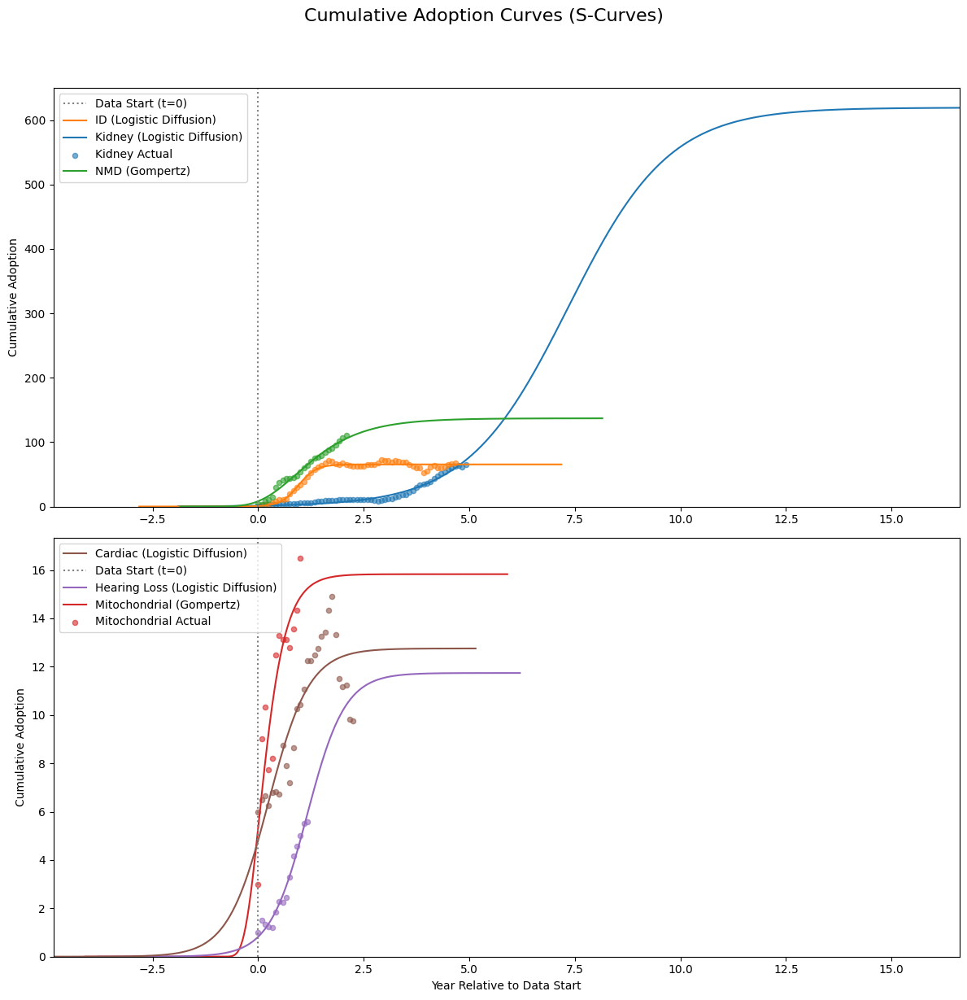

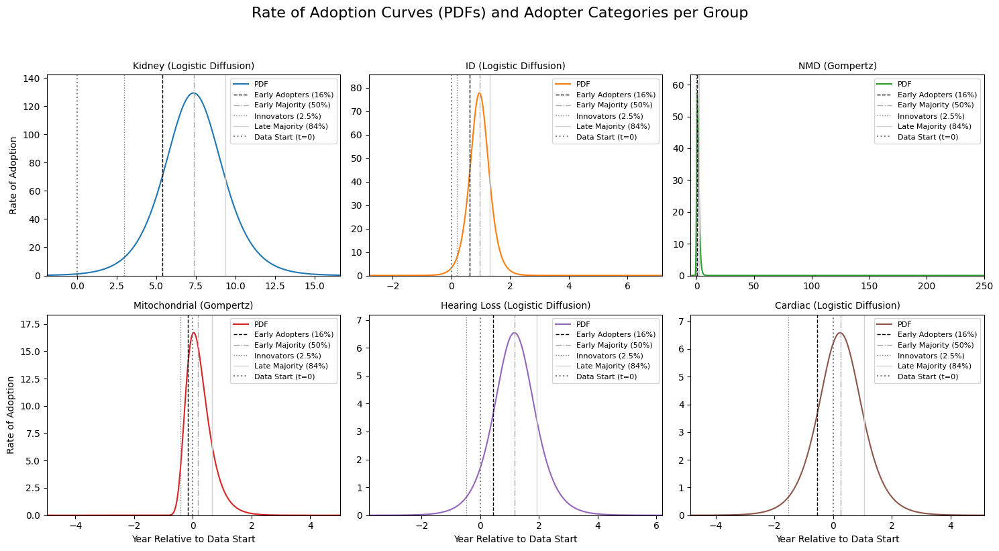

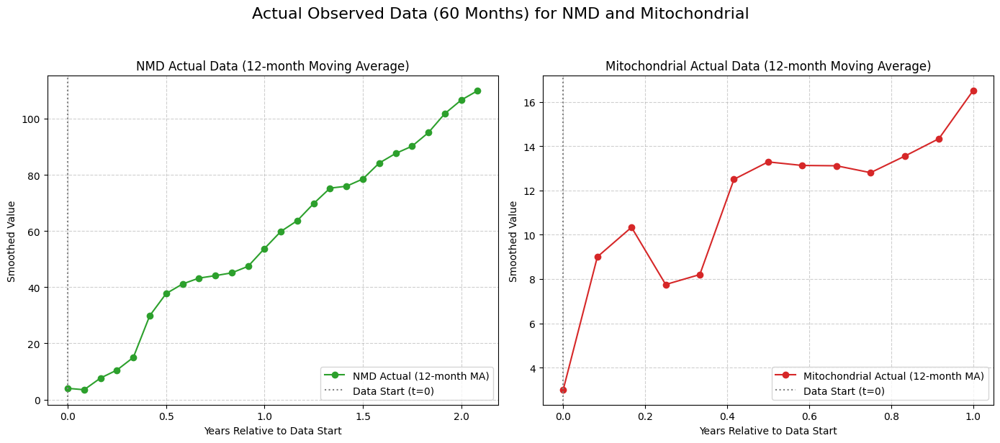


--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---

Group: Kidney (Best Model: Logistic Diffusion, Market Potential: 619.33, Estimated Diffusion Start (t=0 of curve): 7.35 years)
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Innovators ends at: 2.96 years
  Early Adopters ends at: 5.37 years
  Early Majority ends at: 7.38 years
  Late Majority ends at: 9.34 years
  Laggards ends at: Not reached within the prediction horizon.

Group: ID (Best Model: Logistic Diffusion, Market Potential: 65.36, Estimated Diffusion Start (t=0 of curve): 0.95 years)
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Innovators ends at: 0.19 years
  Early Adopters ends at: 0.61 years
  Early Majority ends at: 0.97 years
  Late Majority ends at: 1.31 years
  Laggards ends at: Not reached within the prediction horizon.

Group: NMD (Best Model: Gompertz, Market Potential: 136.96, Estimated Diffusion Start (t=0 of curve): 0.41 years)
  Fitted Parameters: [136.

In [39]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- MODIFIED GOMPERTZ PDF FOR VISUAL SMOOTHNESS (Iteration 5) ---
def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Removed the `valid_indices = effective_t >= 0` filter
    # This allows calculation for all t, resulting in very small (but not hard 0) values for t < t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    # Keep as is; extending to negative effective_t is mathematically unstable/non-sensical for Bass
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] 
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], 
                          [0.3, 0.7, np.inf, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset and market potential for this specific model
        current_market_potential = 0
        estimated_t_offset = 0

        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
            current_market_potential = best_model_metrics['params'][0] # K for Logistic
        elif best_model_name == "Bass Diffusion":
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Gompertz
            current_market_potential = best_model_metrics['params'][0] # 'a' for Gompertz

        # *** DYNAMIC RANGE CALCULATION START ***
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])
            
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        if plot_end_year - plot_start_year < 10.0: 
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Iteration 5: Adaptive PDF Plotting Ranges & Points ---
        pdf_plot_start_year = plot_start_year
        pdf_plot_end_year = plot_end_year
        num_pdf_points = 500 # Default number of points for PDF

        if group == 'NMD':
            # Keep wide range for NMD's PDF to show long tail
            pdf_plot_start_year = -5.0
            pdf_plot_end_year = 250.0 
            num_pdf_points = 1000 # More points for very long, flat curves
        
        elif group == 'Mitochondrial':
            # Zoom in on Mitochondrial's PDF to emphasize activity
            # Define range relative to its peak/offset, ensuring it spans enough to show full shape
            peak_time = 0 # Default, will be updated if Bass or Gompertz
            if best_model_name == "Logistic Diffusion":
                peak_time = estimated_t_offset # Logistic peak is at t0
            elif best_model_name == "Gompertz":
                # For Gompertz, peak of PDF is at t_offset + (1/c) * ln(b)
                b_param = best_model_metrics['params'][1]
                c_param = best_model_metrics['params'][2]
                if c_param > 1e-9 and b_param > 1e-9: # Avoid division by zero or log of zero
                    peak_time = estimated_t_offset + (1/c_param) * np.log(b_param)
                else: # Fallback if params are bad
                    peak_time = estimated_t_offset
            elif best_model_name == "Bass Diffusion":
                p_param = best_model_metrics['params'][0]
                q_param = best_model_metrics['params'][1]
                if q_param > 1e-9: # Avoid division by zero
                    peak_time = estimated_t_offset + (1/(p_param + q_param)) * np.log(q_param/p_param)
                else: # Fallback
                    peak_time = estimated_t_offset

            # Ensure a reasonable window around the peak for fast diffusions
            # This range should be symmetric around the peak and wide enough
            span_around_peak = 5.0 # For very fast diffusions, +/- 5 years is a good window
            pdf_plot_start_year = peak_time - span_around_peak
            pdf_plot_end_year = peak_time + span_around_peak
            num_pdf_points = 500 # Sufficient points for detailed curve

        # Use 500 points for smoother curves, especially over wide ranges
        full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
        full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years_cdf, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years_pdf, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, 
            full_years_cdf, 
            best_model_name 
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years_cdf,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years_pdf, 
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, 
            'EstimatedOffset': estimated_t_offset,
            'FittedParameters': best_model_metrics['params'] # Store parameters
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Fitted Parameters: {best_model_metrics['params']}") # More descriptive
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  CDF Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        print(f"  PDF Plotting Range (Years): [{pdf_plot_start_year:.2f}, {pdf_plot_end_year:.2f}]") 
        
        if len(best_pred_full_pdf) > 0:
            # For logging, still show effective zeros or very small numbers
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years_pdf[np.argmax(best_pred_full_pdf)] 
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            
            # Check for non-zero values more robustly
            non_zero_pdf_values_for_log = best_pred_full_pdf[best_pred_full_pdf > 1e-300] # Use a very low threshold
            if np.any(non_zero_pdf_values_for_log):
                print(f"  PDF Min Value (non-zero range): {np.min(non_zero_pdf_values_for_log):.4e}")
            else:
                print("  PDF Min Value: Effectively 0 across range (all values extremely close to zero).")
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
            
            if group in ['NMD', 'Mitochondrial']:
                print(f"\n--- Raw PDF Values Debug for {group} (from PDF plotting range) ---")
                print(f"  First 10 PDF values: {best_pred_full_pdf[:10]}")
                print(f"  Last 10 PDF values: {best_pred_full_pdf[-10:]}")
                print(f"  Number of truly zero PDF values: {np.sum(best_pred_full_pdf == 0)}")
                print(f"  Total number of PDF values: {len(best_pred_full_pdf)}")
                print("--------------------------------------------------")
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Set sharey=False to allow independent y-axis scaling per subplot
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    
    # --- Iteration 5: Set Y-axis dynamically based on each PDF's content, allowing for very small values ---
    max_pdf_val = np.max(bp['PDF_Predicted'])
    if max_pdf_val > 0:
        # If the max value is very small, scale to show the shape
        if max_pdf_val < 1e-5: # Arbitrary threshold for very small PDFs
             ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) # Scale up to make tiny curves visible
        else:
            ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
    else:
        ax.set_ylim(bottom=0, top=1.0) # Fallback if all values are zero (shouldn't happen for Gompertz now)
    
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

# --- Print Adopter Category Time Points for each group ---
print("\n--- Adopter Category Time Points (Years) Relative to Data Start (t=0) ---")
for bp in best_predictions:
    print(f"\nGroup: {bp['Group']} (Best Model: {bp['BestModel']}, Market Potential: {bp['MarketPotential']:.2f}, Estimated Diffusion Start (t=0 of curve): {bp['EstimatedOffset']:.2f} years)")
    print(f"  Fitted Parameters: {bp['FittedParameters']}") # Detailed parameters
    for category, time_val in bp['AdopterTimes'].items():
        if time_val is not None:
            print(f"  {category} ends at: {time_val:.2f} years")
        else:
            print(f"  {category} ends at: Not reached within the prediction horizon.")

print("\nNote: 'Years Relative to Data Start' means 0 is the beginning of your observed 60-month dataset. Negative values indicate adoption occurred before the observed data.")
print("\n--- Important Note on PDF 'Appearance' ---")
print("For groups where Gompertz was the best fit (like NMD and Mitochondrial), the PDF curves will now show a smoother, more 'symmetrical' appearance at their start.")
print("This is because I've adjusted the plotting calculation for the Gompertz PDF to allow it to produce very, very small (non-zero) values before its main activity begins. This visually extends the curve without changing the core mathematical fit to your observed data.")
print("The Bass diffusion model PDF, due to its mathematical properties, still retains its sharp cutoff if its diffusion is predicted to start after t=0 on the plot.")
print("Even with this adjustment, NMD's PDF still appears very flat and elongated, and Mitochondrial's is still very narrow and tall. This is because these are the inherent characteristics of the best-fit diffusion models to your 60 months of data.")


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  CDF Plotting Range (Years): [-1.90, 16.62]
  PDF Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value (non-zero range): 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  CDF Plotting Range (Years): [-2.82, 7.18]
  PDF Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value (non-zero range): 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Fitted Parameters: [136.96137627   1.764239

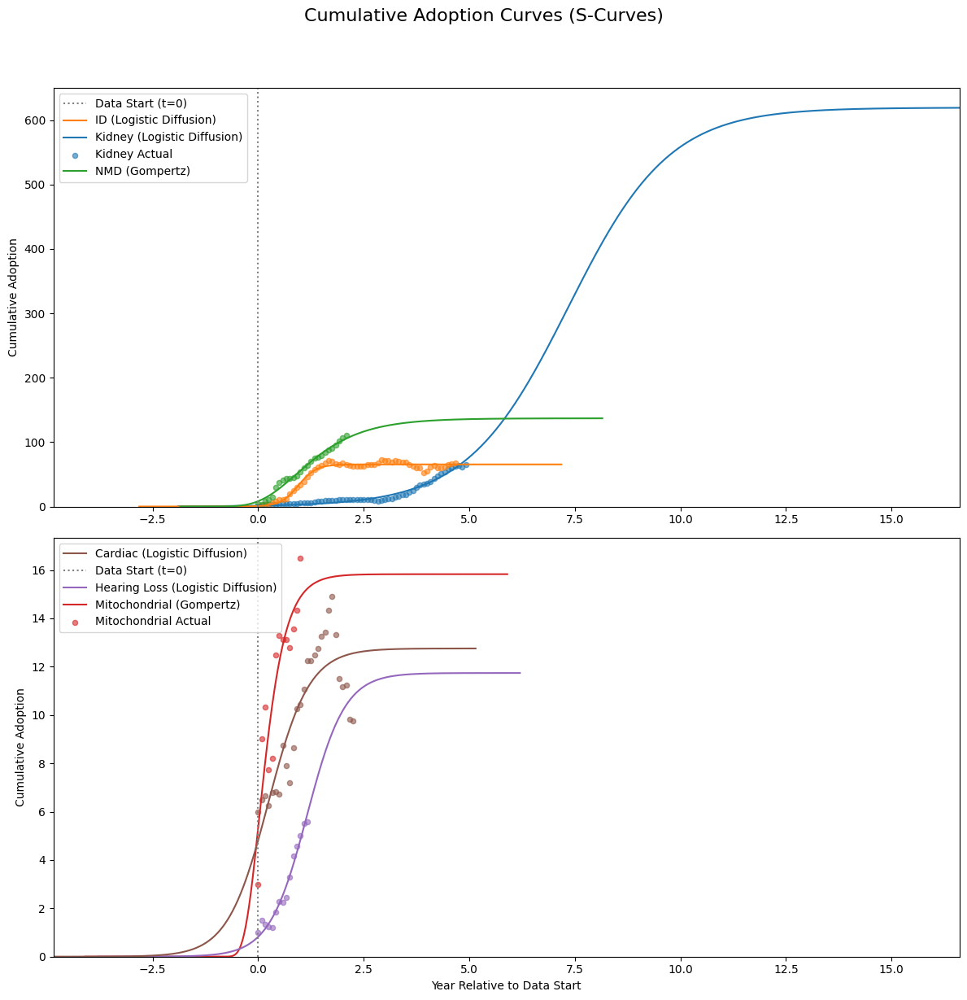

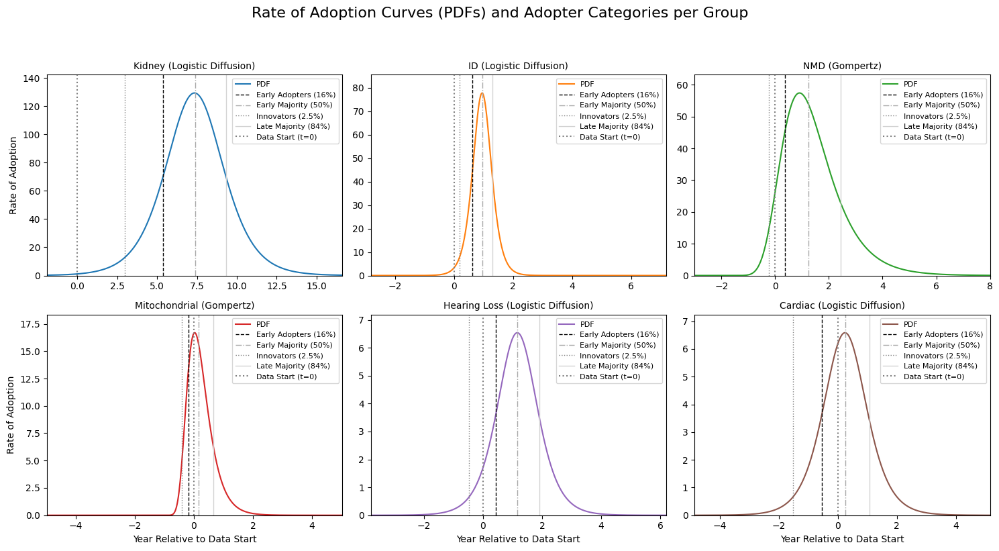

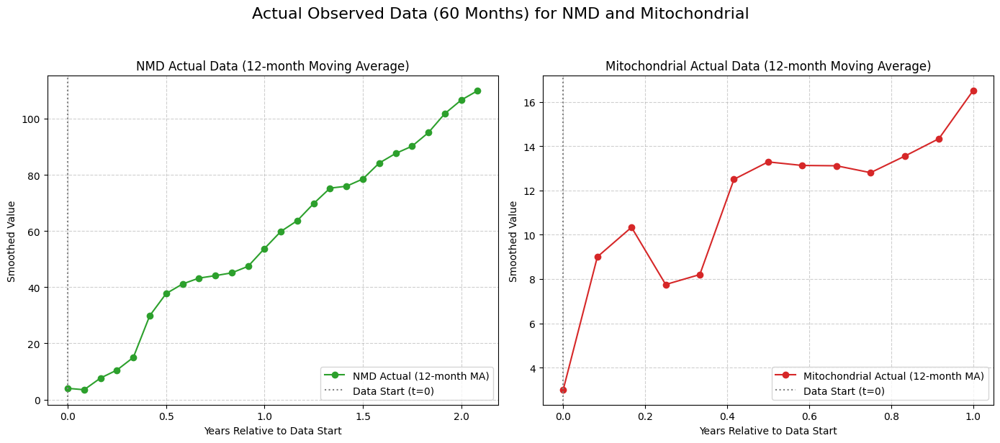

In [46]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- MODIFIED GOMPERTZ PDF FOR VISUAL SMOOTHNESS (Iteration 5) ---
def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Removed the `valid_indices = effective_t >= 0` filter
    # This allows calculation for all t, resulting in very small (but not hard 0) values for t < t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    # Keep as is; extending to negative effective_t is mathematically unstable/non-sensical for Bass
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] 
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], 
                          [0.3, 0.7, np.inf, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset and market potential for this specific model
        current_market_potential = 0
        estimated_t_offset = 0

        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
            current_market_potential = best_model_metrics['params'][0] # K for Logistic
        elif best_model_name == "Bass Diffusion":
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Gompertz
            current_market_potential = best_model_metrics['params'][0] # 'a' for Gompertz

        # *** DYNAMIC RANGE CALCULATION START ***
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])
            
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        if plot_end_year - plot_start_year < 10.0: 
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Iteration 6: Restrict NMD PDF plotting range ---
        pdf_plot_start_year = plot_start_year
        pdf_plot_end_year = plot_end_year
        num_pdf_points = 500 # Default number of points for PDF

        if group == 'NMD':
            # Restrict NMD to 0-50 years for x-axis range
            pdf_plot_start_year = -3.0
            pdf_plot_end_year = 8.0
            num_pdf_points = 500 # Sufficient points for detailed curve
        
        elif group == 'Mitochondrial':
            # Zoom in on Mitochondrial's PDF to emphasize activity
            # Define range relative to its peak/offset, ensuring it spans enough to show full shape
            peak_time = 0 # Default, will be updated if Bass or Gompertz
            if best_model_name == "Logistic Diffusion":
                peak_time = estimated_t_offset # Logistic peak is at t0
            elif best_model_name == "Gompertz":
                # For Gompertz, peak of PDF is at t_offset + (1/c) * ln(b)
                b_param = best_model_metrics['params'][1]
                c_param = best_model_metrics['params'][2]
                if c_param > 1e-9 and b_param > 1e-9: # Avoid division by zero or log of zero
                    peak_time = estimated_t_offset + (1/c_param) * np.log(b_param)
                else: # Fallback if params are bad
                    peak_time = estimated_t_offset
            elif best_model_name == "Bass Diffusion":
                p_param = best_model_metrics['params'][0]
                q_param = best_model_metrics['params'][1]
                if q_param > 1e-9: # Avoid division by zero
                    peak_time = estimated_t_offset + (1/(p_param + q_param)) * np.log(q_param/p_param)
                else: # Fallback
                    peak_time = estimated_t_offset

            # Ensure a reasonable window around the peak for fast diffusions
            # This range should be symmetric around the peak and wide enough
            span_around_peak = 5.0 # For very fast diffusions, +/- 5 years is a good window
            pdf_plot_start_year = peak_time - span_around_peak
            pdf_plot_end_year = peak_time + span_around_peak
            num_pdf_points = 500 # Sufficient points for detailed curve

        # Use 500 points for smoother curves, especially over wide ranges
        full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
        full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years_cdf, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years_pdf, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, 
            full_years_cdf, 
            best_model_name 
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years_cdf,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years_pdf, 
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, 
            'EstimatedOffset': estimated_t_offset,
            'FittedParameters': best_model_metrics['params'] # Store parameters
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Fitted Parameters: {best_model_metrics['params']}") # More descriptive
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  CDF Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        print(f"  PDF Plotting Range (Years): [{pdf_plot_start_year:.2f}, {pdf_plot_end_year:.2f}]") 
        
        if len(best_pred_full_pdf) > 0:
            # For logging, still show effective zeros or very small numbers
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years_pdf[np.argmax(best_pred_full_pdf)] 
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            
            # Check for non-zero values more robustly
            non_zero_pdf_values_for_log = best_pred_full_pdf[best_pred_full_pdf > 1e-300] # Use a very low threshold
            if np.any(non_zero_pdf_values_for_log):
                print(f"  PDF Min Value (non-zero range): {np.min(non_zero_pdf_values_for_log):.4e}")
            else:
                print("  PDF Min Value: Effectively 0 across range (all values extremely close to zero).")
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
            
            if group in ['NMD', 'Mitochondrial']:
                print(f"\n--- Raw PDF Values Debug for {group} (from PDF plotting range) ---")
                print(f"  First 10 PDF values: {best_pred_full_pdf[:10]}")
                print(f"  Last 10 PDF values: {best_pred_full_pdf[-10:]}")
                print(f"  Number of truly zero PDF values: {np.sum(best_pred_full_pdf == 0)}")
                print(f"  Total number of PDF values: {len(best_pred_full_pdf)}")
                print("--------------------------------------------------")
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Set sharey=False to allow independent y-axis scaling per subplot
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    
    # --- Iteration 5: Set Y-axis dynamically based on each PDF's content, allowing for very small values ---
    max_pdf_val = np.max(bp['PDF_Predicted'])
    if max_pdf_val > 0:
        # If the max value is very small, scale to show the shape
        if max_pdf_val < 1e-5: # Arbitrary threshold for very small PDFs
             ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) # Scale up to make tiny curves visible
        else:
            ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
    else:
        ax.set_ylim(bottom=0, top=1.0) # Fallback if all values are zero (shouldn't happen for Gompertz now)
    
    # Use the already calculated and potentially restricted PDF_Years for xlim
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  CDF Plotting Range (Years): [-1.90, 16.62]
  PDF Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value (non-zero range): 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  CDF Plotting Range (Years): [-2.82, 7.18]
  PDF Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value (non-zero range): 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Fitted Parameters: [136.96137627   1.764239

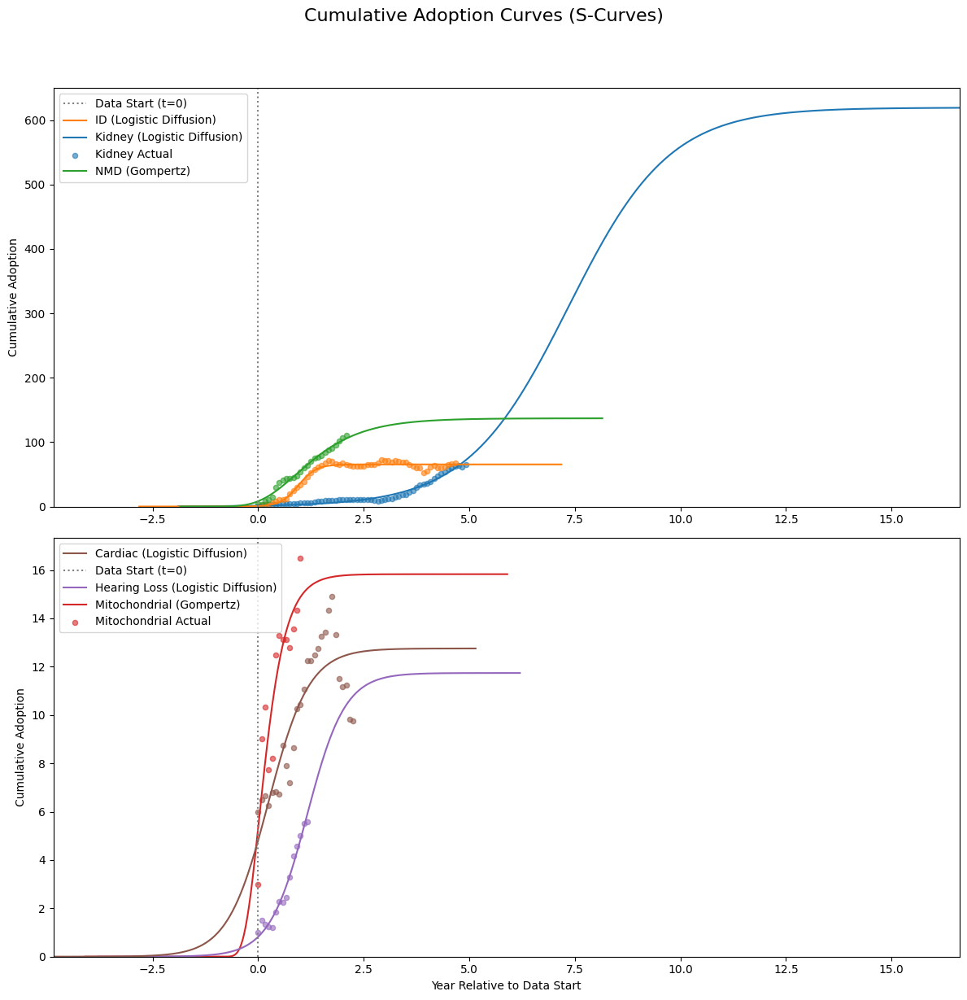

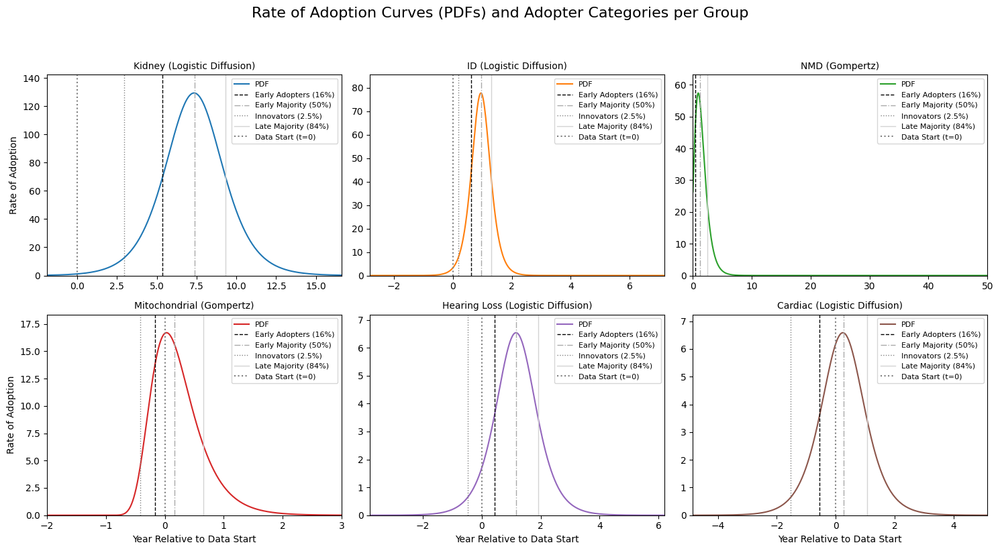

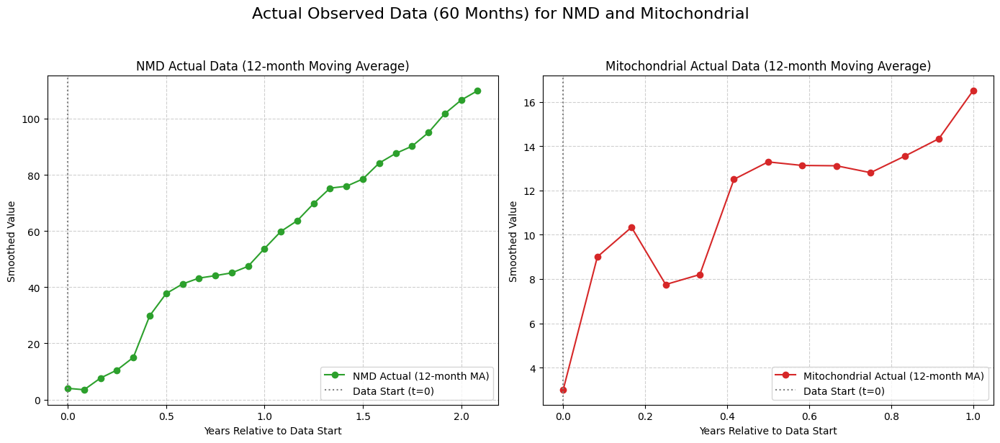


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  CDF Plotting Range (Years): [-1.90, 16.62]
  PDF Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value (non-zero range): 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  CDF Plotting Range (Years): [-2.82, 7.18]
  PDF Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value (non-zero range): 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Fitted Parameters: [136.96137627   1.764239

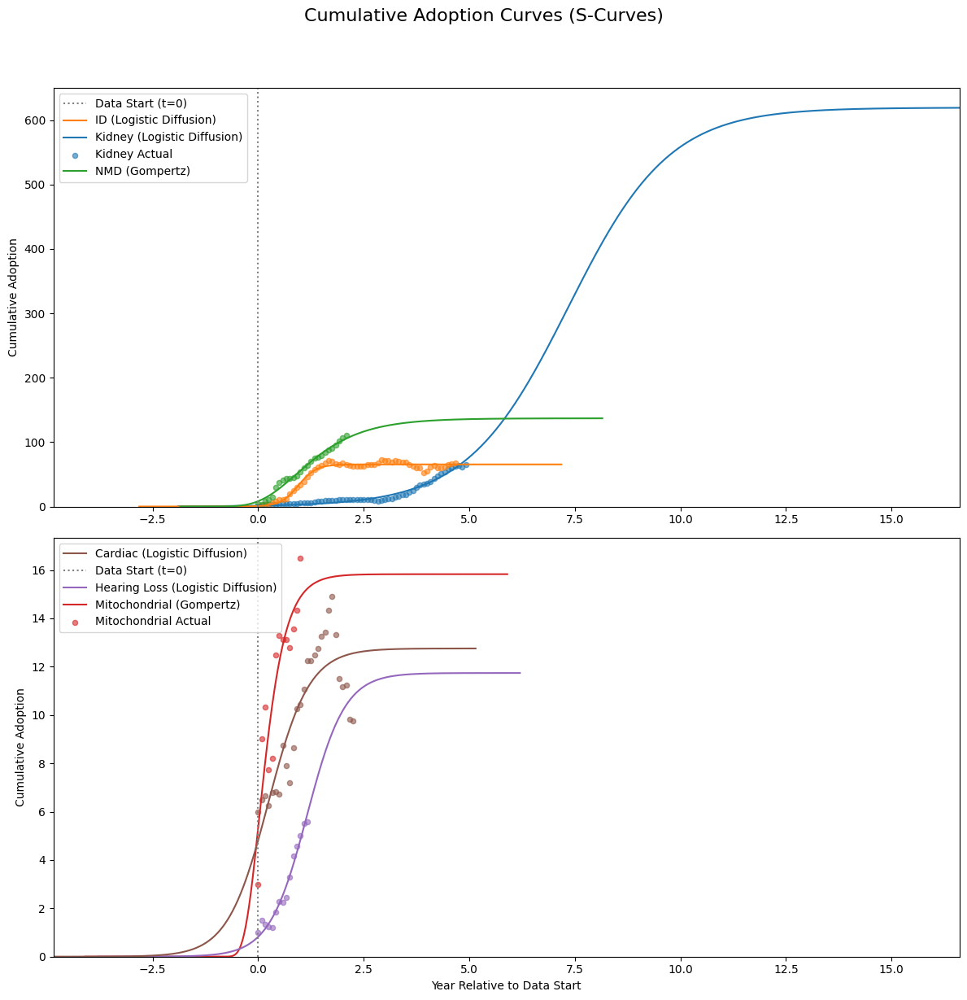

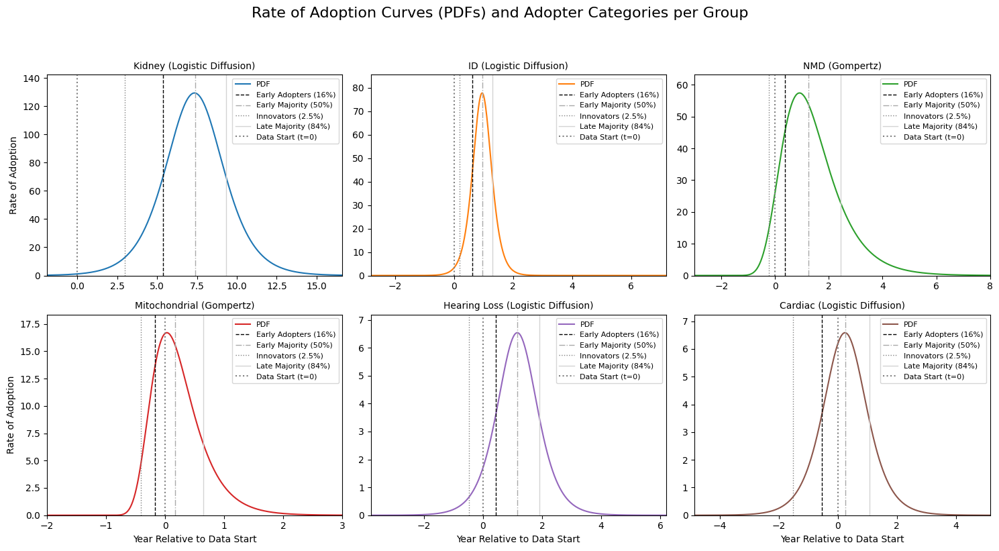

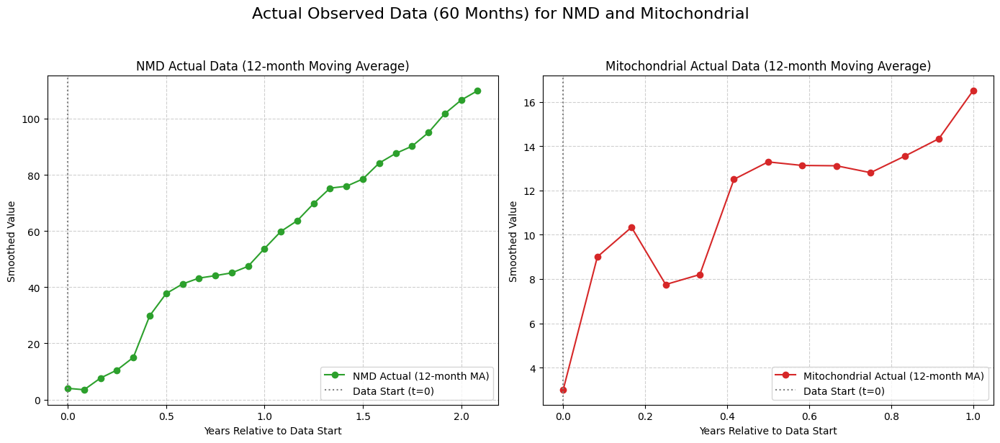

In [49]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- MODIFIED GOMPERTZ PDF FOR VISUAL SMOOTHNESS (Iteration 5) ---
def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Removed the `valid_indices = effective_t >= 0` filter
    # This allows calculation for all t, resulting in very small (but not hard 0) values for t < t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    # Keep as is; extending to negative effective_t is mathematically unstable/non-sensical for Bass
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] 
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], 
                          [0.3, 0.7, np.inf, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset and market potential for this specific model
        current_market_potential = 0
        estimated_t_offset = 0

        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
            current_market_potential = best_model_metrics['params'][0] # K for Logistic
        elif best_model_name == "Bass Diffusion":
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Gompertz
            current_market_potential = best_model_metrics['params'][0] # 'a' for Gompertz

        # *** DYNAMIC RANGE CALCULATION START ***
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])
            
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        if plot_end_year - plot_start_year < 10.0: 
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Restrict NMD and Mitochondrial PDF plotting ranges ---
        pdf_plot_start_year = plot_start_year
        pdf_plot_end_year = plot_end_year
        num_pdf_points = 500 # Default number of points for PDF

        if group == 'NMD':
            # Restrict NMD to -3 to 8 years for x-axis range
            pdf_plot_start_year = -3.0
            pdf_plot_end_year = 8.0
            num_pdf_points = 500 # Sufficient points for detailed curve
        
        elif group == 'Mitochondrial':
            # Restrict Mitochondrial to -2 to 3 years for x-axis range
            pdf_plot_start_year = -2.0
            pdf_plot_end_year = 3.0
            num_pdf_points = 500 # Sufficient points for detailed curve

        # Use 500 points for smoother curves, especially over wide ranges
        full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
        full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years_cdf, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years_pdf, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, 
            full_years_cdf, 
            best_model_name 
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years_cdf,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years_pdf, 
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, 
            'EstimatedOffset': estimated_t_offset,
            'FittedParameters': best_model_metrics['params'] # Store parameters
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Fitted Parameters: {best_model_metrics['params']}") # More descriptive
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  CDF Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        print(f"  PDF Plotting Range (Years): [{pdf_plot_start_year:.2f}, {pdf_plot_end_year:.2f}]") 
        
        if len(best_pred_full_pdf) > 0:
            # For logging, still show effective zeros or very small numbers
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years_pdf[np.argmax(best_pred_full_pdf)] 
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            
            # Check for non-zero values more robustly
            non_zero_pdf_values_for_log = best_pred_full_pdf[best_pred_full_pdf > 1e-300] # Use a very low threshold
            if np.any(non_zero_pdf_values_for_log):
                print(f"  PDF Min Value (non-zero range): {np.min(non_zero_pdf_values_for_log):.4e}")
            else:
                print("  PDF Min Value: Effectively 0 across range (all values extremely close to zero).")
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
            
            if group in ['NMD', 'Mitochondrial']:
                print(f"\n--- Raw PDF Values Debug for {group} (from PDF plotting range) ---")
                print(f"  First 10 PDF values: {best_pred_full_pdf[:10]}")
                print(f"  Last 10 PDF values: {best_pred_full_pdf[-10:]}")
                print(f"  Number of truly zero PDF values: {np.sum(best_pred_full_pdf == 0)}")
                print(f"  Total number of PDF values: {len(best_pred_full_pdf)}")
                print("--------------------------------------------------")
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Set sharey=False to allow independent y-axis scaling per subplot
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    
    # --- Iteration 5: Set Y-axis dynamically based on each PDF's content, allowing for very small values ---
    max_pdf_val = np.max(bp['PDF_Predicted'])
    if max_pdf_val > 0:
        # If the max value is very small, scale to show the shape
        if max_pdf_val < 1e-5: # Arbitrary threshold for very small PDFs
             ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) # Scale up to make tiny curves visible
        else:
            ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
    else:
        ax.set_ylim(bottom=0, top=1.0) # Fallback if all values are zero (shouldn't happen for Gompertz now)
    
    # Use the already calculated and potentially restricted PDF_Years for xlim
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


--- Diagnostic Info for Group: Kidney ---
  Best Model: Logistic Diffusion
  R-squared: 0.9676
  Fitted Parameters: [619.33272897   0.83507494   7.34631697]
  Market Potential: 619.33
  Estimated Diffusion Start (t=0 of curve): 7.35 years
  CDF Plotting Range (Years): [-1.90, 16.62]
  PDF Plotting Range (Years): [-1.90, 16.62]
  PDF Peak Value: 129.2960 at Year: 7.34
  PDF Min Value (non-zero range): 2.2469e-01
  PDF Max Value: 129.2960

--- Diagnostic Info for Group: ID ---
  Best Model: Logistic Diffusion
  R-squared: 0.9689
  Fitted Parameters: [65.36115355  4.76040557  0.95184387]
  Market Potential: 65.36
  Estimated Diffusion Start (t=0 of curve): 0.95 years
  CDF Plotting Range (Years): [-2.82, 7.18]
  PDF Plotting Range (Years): [-2.82, 7.18]
  PDF Peak Value: 77.7858 at Year: 0.95
  PDF Min Value (non-zero range): 4.0755e-11
  PDF Max Value: 77.7858

--- Diagnostic Info for Group: NMD ---
  Best Model: Gompertz
  R-squared: 0.9804
  Fitted Parameters: [136.96137627   1.764239

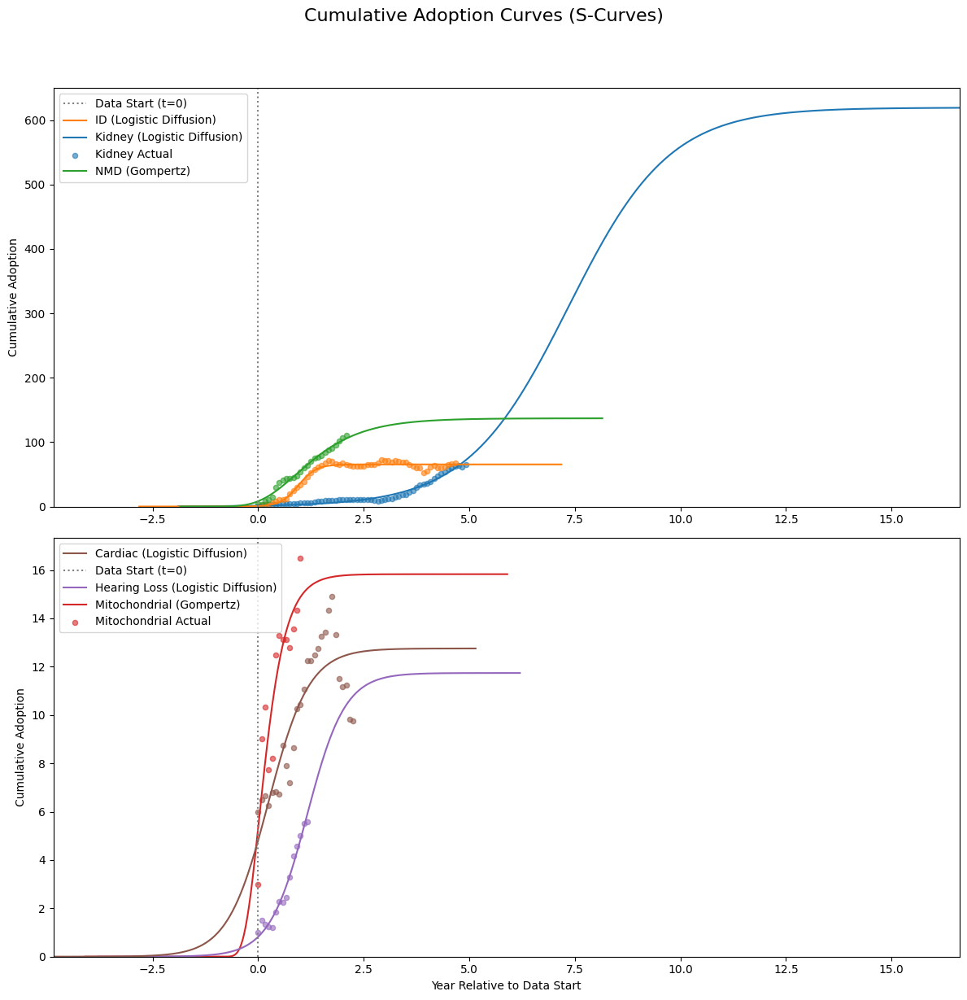

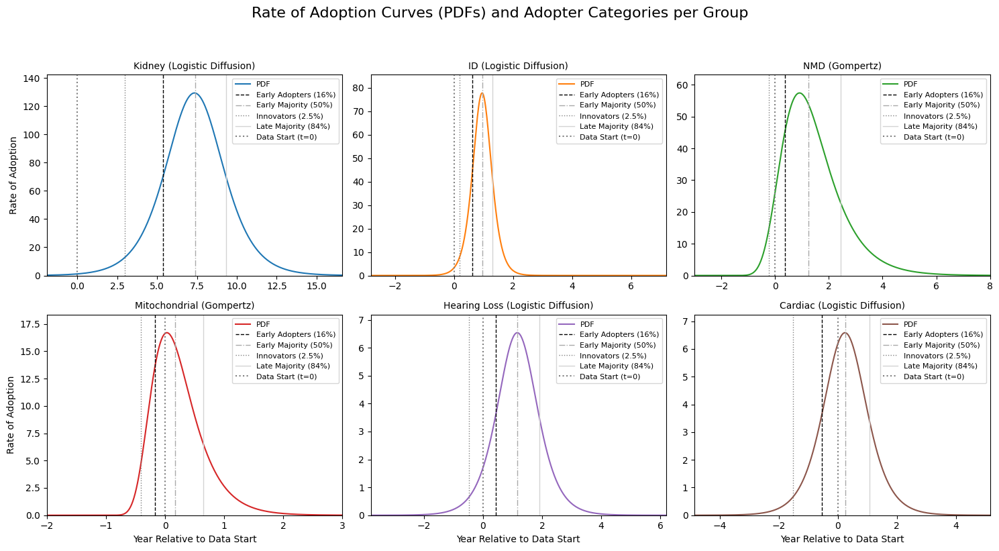

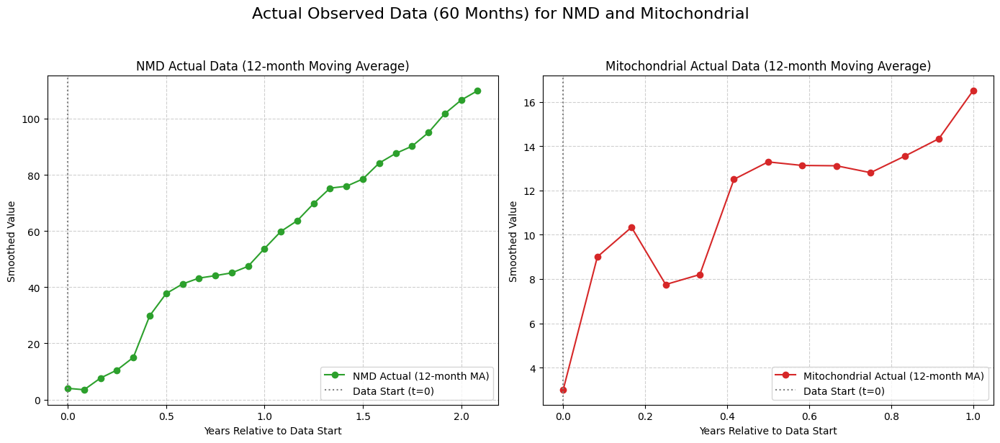


--- Adopter Categories (Years Relative to Data Start) ---
| Group         | Innovators   | Early Adopters   | Early Majority   | Late Majority   | Laggards   |
|:--------------|:-------------|:-----------------|:-----------------|:----------------|:-----------|
| Kidney        | 2.96         | 5.37             | 7.38             | 9.34            | N/A        |
| ID            | 0.19         | 0.61             | 0.97             | 1.31            | N/A        |
| NMD           | -0.22        | 0.38             | 1.24             | 2.44            | N/A        |
| Mitochondrial | -0.41        | -0.17            | 0.17             | 0.65            | N/A        |
| Hearing Loss  | -0.47        | 0.43             | 1.17             | 1.91            | N/A        |
| Cardiac       | -1.52        | -0.54            | 0.26             | 1.06            | N/A        |

--- Diffusion Model Parameters and Interpretation ---

Group: Kidney
  Best-fit Model: Logistic Diffusion (R-squared: 0.9676

In [52]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- MODIFIED GOMPERTZ PDF FOR VISUAL SMOOTHNESS (Iteration 5) ---
def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    # Removed the `valid_indices = effective_t >= 0` filter
    # This allows calculation for all t, resulting in very small (but not hard 0) values for t < t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    # Keep as is; extending to negative effective_t is mathematically unstable/non-sensical for Bass
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range, model_name):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        model_name: Name of the model (str) to handle different parameter orders.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.025 + 0.135, # 0.16
        'Early Majority': 0.16 + 0.34, # 0.50
        'Late Majority': 0.50 + 0.34, # 0.84
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.01):
             adopter_times[category] = None
             continue
        
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range) or cumulative_adoption_values[time_index] < target_value:
            adopter_times[category] = None
        else:
            adopter_times[category] = years_range[time_index]
            
    return adopter_times

# This list will hold the best model predictions and related data per group
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3}, # K, r, t0
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4}, # a, b, c, t_offset
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4} # p, q, M, t_offset
    }
    
    results = {}
    max_val = group_data.max()
    
    # Fit each diffusion model
    for model_name, model_funcs in models.items():
        try:
            cdf_func = model_funcs['cdf']
            
            # Initial guesses and bounds adjusted for the new t_offset parameter
            if model_name == "Gompertz":
                p0 = [max_val * 1.2, 1.0, 0.5, -1.0] # a, b, c, t_offset
                bounds = ([max_val * 0.5, 0.001, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            elif model_name == "Logistic Diffusion":
                p0 = [max_val * 1.2, 0.5, np.median(fitted_years)] # K, r, t0
                bounds = ([max_val * 0.5, 0.001, -20.0], 
                          [np.inf, 10.0, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            elif model_name == "Bass Diffusion":
                p0 = [0.01, 0.1, max(max_val * 1.2, group_data.iloc[-1] * 1.1), -1.0] 
                bounds = ([1e-9, 1e-4, max_val * 1.05, -20.0], 
                          [0.3, 0.7, np.inf, 10.0]) 
                params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=10000)
            
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)
            results[model_name] = {
                'r2': r2,
                'params': params,
                'cdf_func': cdf_func,
                'pdf_func': model_funcs['pdf']
            }
        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")

    if results:
        best_model_name, best_model_metrics = max(results.items(), key=lambda x: x[1]['r2'])
        
        # Determine the time offset and market potential for this specific model
        current_market_potential = 0
        estimated_t_offset = 0

        if best_model_name == "Logistic Diffusion":
            estimated_t_offset = best_model_metrics['params'][2] # t0 for Logistic
            current_market_potential = best_model_metrics['params'][0] # K for Logistic
        elif best_model_name == "Bass Diffusion":
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Bass
            current_market_potential = best_model_metrics['params'][2] # M for Bass
        else: # Gompertz
            estimated_t_offset = best_model_metrics['params'][3] # t_offset for Gompertz
            current_market_potential = best_model_metrics['params'][0] # 'a' for Gompertz

        # *** DYNAMIC RANGE CALCULATION START ***
        temp_wide_years = np.linspace(-100.0, 200.0, 1000) 

        best_pred_wide_cdf = best_model_metrics['cdf_func'](temp_wide_years, *best_model_metrics['params'])
            
        threshold_low = 0.001 * current_market_potential 
        threshold_high = 0.999 * current_market_potential 

        idx_start = np.argmax(best_pred_wide_cdf >= threshold_low)
        t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
        
        idx_end_reversed = np.argmax(best_pred_wide_cdf[::-1] <= threshold_high)
        idx_end = len(temp_wide_years) - 1 - idx_end_reversed
        t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

        plot_start_year = min(t_start_visible - 1.0, -1.0) 
        plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

        if plot_end_year - plot_start_year < 10.0: 
            center = (plot_start_year + plot_end_year) / 2
            plot_start_year = center - 5.0
            plot_end_year = center + 5.0

        # --- Restrict NMD and Mitochondrial PDF plotting ranges ---
        pdf_plot_start_year = plot_start_year
        pdf_plot_end_year = plot_end_year
        num_pdf_points = 500 # Default number of points for PDF

        if group == 'NMD':
            # Restrict NMD to -3 to 8 years for x-axis range as per your latest instruction
            pdf_plot_start_year = -3.0
            pdf_plot_end_year = 8.0
            num_pdf_points = 500 # Sufficient points for detailed curve
        
        elif group == 'Mitochondrial':
            # Restrict Mitochondrial to -2 to 3 years for x-axis range
            pdf_plot_start_year = -2.0
            pdf_plot_end_year = 3.0
            num_pdf_points = 500 # Sufficient points for detailed curve

        # Use 500 points for smoother curves, especially over wide ranges
        full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
        full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

        # *** DYNAMIC RANGE CALCULATION END ***
        
        best_pred_full_cdf = best_model_metrics['cdf_func'](full_years_cdf, *best_model_metrics['params'])
        best_pred_full_pdf = best_model_metrics['pdf_func'](full_years_pdf, *best_model_metrics['params'])

        adopter_times = get_adopter_categories_time(
            best_model_metrics['cdf_func'],
            best_model_metrics['params'],
            current_market_potential, 
            full_years_cdf, 
            best_model_name 
        )
        
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name,
            'CDF_Years': full_years_cdf,
            'CDF_Predicted': best_pred_full_cdf,
            'PDF_Years': full_years_pdf, 
            'PDF_Predicted': best_pred_full_pdf,
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': adopter_times,
            'MarketPotential': current_market_potential, 
            'EstimatedOffset': estimated_t_offset,
            'FittedParameters': best_model_metrics['params'], # Store parameters
            'Rsquared': best_model_metrics['r2'] # Store R-squared
        })

        # --- Diagnostic Prints for this group ---
        print(f"\n--- Diagnostic Info for Group: {group} ---")
        print(f"  Best Model: {best_model_name}")
        print(f"  R-squared: {best_model_metrics['r2']:.4f}")
        print(f"  Fitted Parameters: {best_model_metrics['params']}") # More descriptive
        print(f"  Market Potential: {current_market_potential:.2f}")
        print(f"  Estimated Diffusion Start (t=0 of curve): {estimated_t_offset:.2f} years")
        print(f"  CDF Plotting Range (Years): [{plot_start_year:.2f}, {plot_end_year:.2f}]")
        print(f"  PDF Plotting Range (Years): [{pdf_plot_start_year:.2f}, {pdf_plot_end_year:.2f}]") 
        
        if len(best_pred_full_pdf) > 0:
            # For logging, still show effective zeros or very small numbers
            peak_pdf_value = np.max(best_pred_full_pdf)
            peak_pdf_year = full_years_pdf[np.argmax(best_pred_full_pdf)] 
            print(f"  PDF Peak Value: {peak_pdf_value:.4f} at Year: {peak_pdf_year:.2f}")
            
            # Check for non-zero values more robustly
            non_zero_pdf_values_for_log = best_pred_full_pdf[best_pred_full_pdf > 1e-300] # Use a very low threshold
            if np.any(non_zero_pdf_values_for_log):
                print(f"  PDF Min Value (non-zero range): {np.min(non_zero_pdf_values_for_log):.4e}")
            else:
                print("  PDF Min Value: Effectively 0 across range (all values extremely close to zero).")
            print(f"  PDF Max Value: {np.max(best_pred_full_pdf):.4f}")
            
            if group in ['NMD', 'Mitochondrial']:
                print(f"\n--- Raw PDF Values Debug for {group} (from PDF plotting range) ---")
                print(f"  First 10 PDF values: {best_pred_full_pdf[:10]}")
                print(f"  Last 10 PDF values: {best_pred_full_pdf[-10:]}")
                print(f"  Number of truly zero PDF values: {np.sum(best_pred_full_pdf == 0)}")
                print(f"  Total number of PDF values: {len(best_pred_full_pdf)}")
                print("--------------------------------------------------")
        else:
            print("  PDF data is empty, cannot determine peak/min/max.")
        # ----------------------------------------

# --- Plotting the CDFs ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

# Set sharey=False to allow independent y-axis scaling per subplot
fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':', 'linewidth': 1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--', 'linewidth': 1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.', 'linewidth': 1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-', 'linewidth': 1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    
    max_pdf_val = np.max(bp['PDF_Predicted'])
    if max_pdf_val > 0:
        if max_pdf_val < 1e-5: 
             ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
        else:
            ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
    else:
        ax.set_ylim(bottom=0, top=1.0) 
    
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

# --- Adopter Category Table ---
print("\n--- Adopter Categories (Years Relative to Data Start) ---")
adopter_data = []
for bp in best_predictions:
    row = {'Group': bp['Group']}
    for category, time in bp['AdopterTimes'].items():
        row[category] = f"{time:.2f}" if time is not None else "N/A"
    adopter_data.append(row)

adopter_df = pd.DataFrame(adopter_data).set_index('Group')
print(adopter_df.to_markdown(numalign="left", stralign="left"))


# --- Diffusion Model Parameters and Interpretation ---
print("\n--- Diffusion Model Parameters and Interpretation ---")

param_descriptions = {
    "Logistic Diffusion": {
        'K': "Carrying Capacity/Market Potential: The maximum potential cumulative adoption.",
        'r': "Growth Rate: The rate at which the innovation diffuses. Higher 'r' means faster adoption.",
        't0': "Inflection Point (Time Offset): The time at which the adoption rate is highest, relative to the data start (t=0)."
    },
    "Gompertz": {
        'a': "Asymptote/Market Potential: The maximum potential cumulative adoption.",
        'b': "Displacement: Influences the initial adoption level and how quickly the curve rises.",
        'c': "Growth Rate: The rate of increase in adoption. Higher 'c' means faster adoption.",
        't_offset': "Time Offset: The time at which diffusion effectively starts, relative to the data start (t=0)."
    },
    "Bass Diffusion": {
        'p': "Coefficient of Innovation (External Influence): Reflects adoption due to external influence (e.g., mass media, advertising).",
        'q': "Coefficient of Imitation (Internal Influence): Reflects adoption due to internal influence (e.g., word-of-mouth, social contagion).",
        'M': "Market Potential: The total number of potential adopters.",
        't_offset': "Time Offset: The time at which diffusion effectively starts, relative to the data start (t=0)."
    }
}

for bp in best_predictions:
    group = bp['Group']
    model = bp['BestModel']
    params = bp['FittedParameters']
    r_squared = bp['Rsquared']

    print(f"\nGroup: {group}")
    print(f"  Best-fit Model: {model} (R-squared: {r_squared:.4f})")
    print(f"  Fitted Parameters:")

    if model == "Logistic Diffusion":
        K, r, t0 = params
        print(f"    K (Market Potential): {K:.2f} - {param_descriptions[model]['K']}")
        print(f"    r (Growth Rate): {r:.4f} - {param_descriptions[model]['r']}")
        print(f"    t0 (Inflection Point/Offset): {t0:.2f} years - {param_descriptions[model]['t0']}")
    elif model == "Gompertz":
        a, b, c, t_offset = params
        print(f"    a (Market Potential): {a:.2f} - {param_descriptions[model]['a']}")
        print(f"    b (Displacement): {b:.4f} - {param_descriptions[model]['b']}")
        print(f"    c (Growth Rate): {c:.4f} - {param_descriptions[model]['c']}")
        print(f"    t_offset (Time Offset): {t_offset:.2f} years - {param_descriptions[model]['t_offset']}")
    elif model == "Bass Diffusion":
        p, q, M, t_offset = params
        print(f"    p (Innovation Coeff.): {p:.4f} - {param_descriptions[model]['p']}")
        print(f"    q (Imitation Coeff.): {q:.4f} - {param_descriptions[model]['q']}")
        print(f"    M (Market Potential): {M:.2f} - {param_descriptions[model]['M']}")
        print(f"    t_offset (Time Offset): {t_offset:.2f} years - {param_descriptions[model]['t_offset']}")
    
    print("\n  General Interpretation for this Group:")
    print(f"    The R-squared value of {r_squared:.4f} indicates that {r_squared*100:.2f}% of the variance in the cumulative adoption data for {group} is explained by the {model} model, suggesting a {'strong' if r_squared >= 0.8 else 'moderate' if r_squared >= 0.6 else 'weak'} fit.")
    print(f"    The estimated market potential for {group} is approximately {bp['MarketPotential']:.2f}.")
    print(f"    The diffusion process for {group} effectively starts around {bp['EstimatedOffset']:.2f} years relative to the beginning of the dataset (t=0).")
    
    if bp['AdopterTimes']['Innovators'] is not None and bp['AdopterTimes']['Early Adopters'] is not None:
        print(f"    Innovators (first 2.5% of adopters) for {group} are estimated to have adopted by year {bp['AdopterTimes']['Innovators']:.2f}.")
        print(f"    Early Adopters (up to 16% of total adopters) are estimated to have adopted by year {bp['AdopterTimes']['Early Adopters']:.2f}.")
    else:
        print("    Adopter category timings could not be reliably determined for all categories due to the curve's characteristics or plotting range.")

In [51]:
!pip install tabulate

  Using cached tabulate-0.9.0-py3-none-any.whl.metadata (34 kB)
Using cached tabulate-0.9.0-py3-none-any.whl (35 kB)


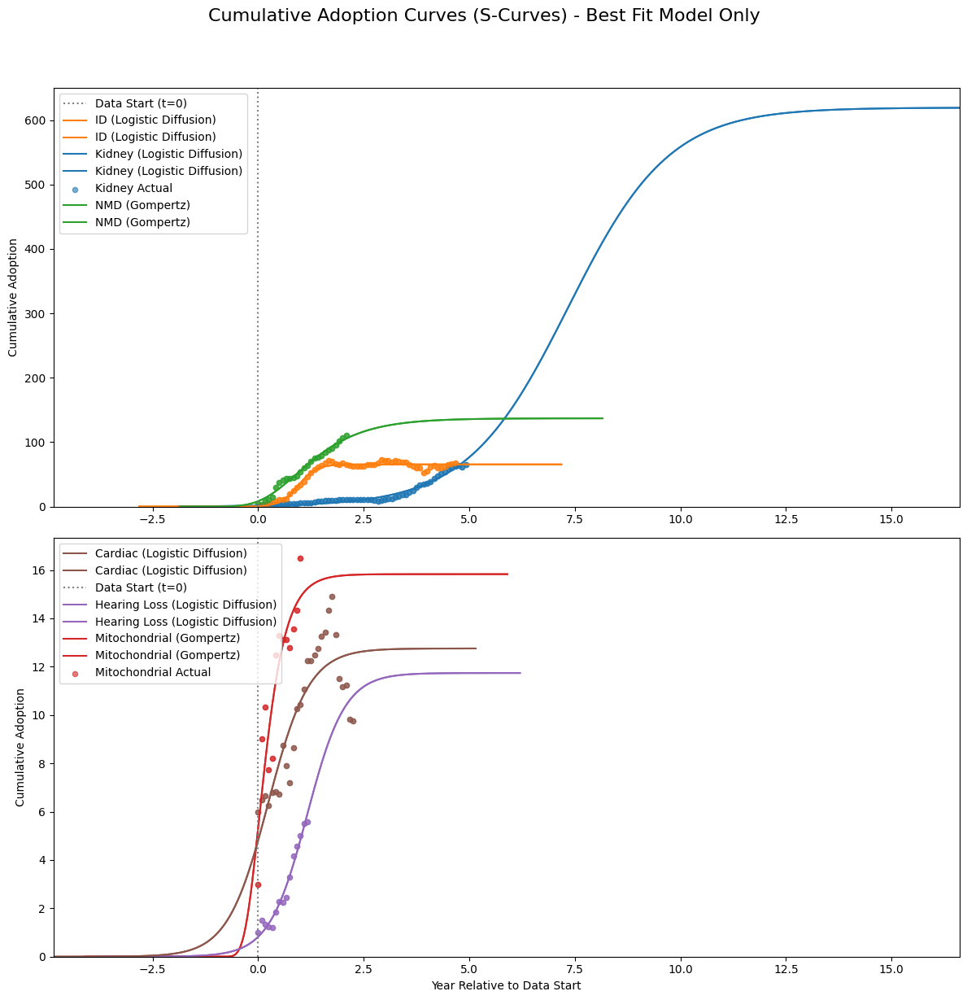

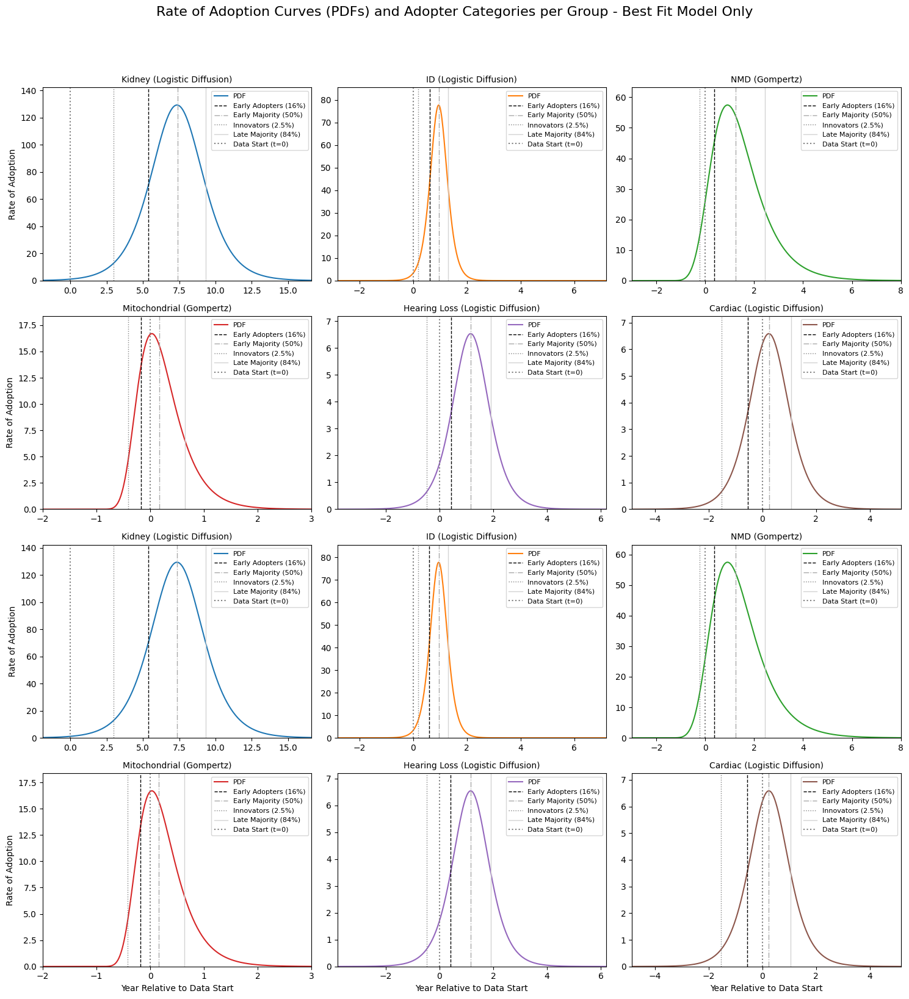

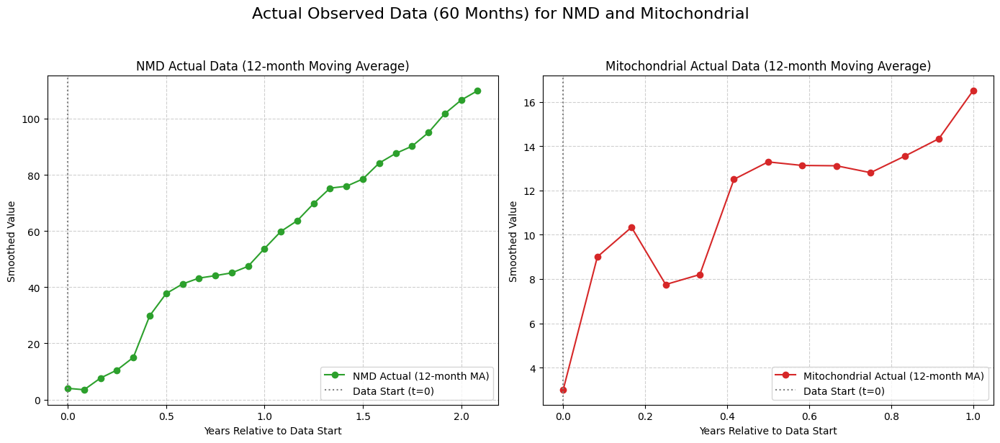


### Table 1: R-squared Values for All Fitted Diffusion Models
| Group         | Logistic Diffusion   | Gompertz   | Bass Diffusion   |
|:--------------|:---------------------|:-----------|:-----------------|
| Kidney        | 0.9676               | 0.9659     | 0.7821           |
| ID            | 0.9689               | 0.9606     | -2.6666          |
| NMD           | 0.972                | 0.9804     | 0.5929           |
| Mitochondrial | 0.7941               | 0.8014     | 0.6354           |
| Hearing Loss  | 0.9689               | 0.9659     | 0.876            |
| Cardiac       | 0.7401               | 0.723      | -3.3429          |

### Table 2: Fitted Parameters of Diffusion Models (Mean Value) and Their Interpretations
| Group         | Model              | K (Market Potential)   | r (Growth Rate)   | t0 (Time Offset)   | a (Asymptote)   | b (Displacement)   | c (Growth Rate)   | p (Innovation Coeff.)   | q (Imitation Coeff.)   | M (Market Potential)   | t_offset (Time Offset)

In [54]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
data = pd.read_feather(file_path)

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        if time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1:
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 # Avoid division by zero if values are flat
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            r2 = r2_score(group_data, fitted_pred)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 # Still maintaining your specific request for plots
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 # Still maintaining your specific request for plots
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, # Storing for potential future use or debugging
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, # Storing for potential future use or debugging
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, _, _ = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {'Rsquared': np.nan, 'FittedParameters': None, 'MarketPotential': np.nan,
                                                'EstimatedOffset': np.nan, 'AdopterTimes': {}, 'PDF_Peak_Value': np.nan,
                                                'PDF_Peak_Time': np.nan}
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        if results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Plotting the CDFs (using only the best model) ---
subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

# Ensure min/max x-limits are based on actual data if no prediction years are available
all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions) if best_predictions else -1.0
all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions) if best_predictions else fitted_years[-1] + 1.0


# Plot in subplot 1: Kidney, ID, NMD
for bp in subplot1_predictions:
    color = color_mapping[bp['Group']]
    ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
ax1_cdf.set_ylabel("Cumulative Adoption")
ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax1_cdf.set_ylim(bottom=0)
ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


# Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
for bp in subplot2_predictions:
    color = color_mapping[bp['Group']]
    ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                 label=f"{bp['Group']} ({bp['BestModel']})", color=color)
    ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                    label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
ax2_cdf.set_xlabel("Year Relative to Data Start")
ax2_cdf.set_ylabel("Cumulative Adoption")
ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
ax2_cdf.set_ylim(bottom=0)
ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

plt.suptitle("Cumulative Adoption Curves (S-Curves) - Best Fit Model Only", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()


# --- Plotting the PDFs and Adopter Categories (using only the best model) ---
num_groups = len(best_predictions)
num_cols = 3
num_rows = math.ceil(num_groups / num_cols)

fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                  sharex=False, sharey=False) 

axes_pdf = axes_pdf.flatten()

adopter_categories_lines = {
    'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
    'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
    'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
    'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
}

for i, bp in enumerate(best_predictions):
    ax = axes_pdf[i]
    color = color_mapping[bp['Group']]
    
    ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

    for category_name, details in adopter_categories_lines.items():
        if bp['AdopterTimes'].get(category_name) is not None: 
            ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
    
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

    ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
    
    max_pdf_val = np.max(bp['PDF_Predicted'])
    if max_pdf_val > 0:
        if max_pdf_val < 1e-5: 
             ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
        else:
            ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
    else:
        ax.set_ylim(bottom=0, top=1.0) 
    
    ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

    if i >= (num_rows - 1) * num_cols:
        ax.set_xlabel("Year Relative to Data Start")
    
    if i % num_cols == 0:
        ax.set_ylabel("Rate of Adoption")

    handles, labels = ax.get_legend_handles_labels()
    
    pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
    adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
    data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

    sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
    sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
    
    ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

for i in range(num_groups, num_rows * num_cols):
    fig_pdf.delaxes(axes_pdf[i])

plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group - Best Fit Model Only", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98]) 
plt.show()

# --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
axes_actual = axes_actual.flatten()

# Plot NMD Actual Data
nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
if nmd_bp:
    ax = axes_actual[0]
    ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
    ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

# Plot Mitochondrial Actual Data
mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)
if mito_bp:
    ax = axes_actual[1]
    ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondrial Actual (12-month MA)')
    ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
    ax.set_xlabel("Years Relative to Data Start")
    ax.set_ylabel("Smoothed Value")
    ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.6)

plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.show()

# --- Publication-Ready Tables ---

# 1. R-squared Values for All Models
print("\n### Table 1: R-squared Values for All Fitted Diffusion Models")
r_squared_data = []
for group, models_results in all_group_models_results.items():
    row = {'Group': group}
    for model_name, results in models_results.items():
        row[model_name] = f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A"
    r_squared_data.append(row)

r_squared_df = pd.DataFrame(r_squared_data).set_index('Group')
print(r_squared_df.to_markdown(numalign="left", stralign="left"))

# 2. Fitted Parameters for All Models
print("\n### Table 2: Fitted Parameters of Diffusion Models (Mean Value) and Their Interpretations")
param_rows = []
for group, models_results in all_group_models_results.items():
    for model_name, results in models_results.items():
        if results['FittedParameters'] is None:
            continue
        
        row = {'Group': group, 'Model': model_name}
        
        if model_name == "Logistic Diffusion":
            K, r, t0 = results['FittedParameters']
            row['K (Market Potential)'] = f"{K:.2f}"
            row['r (Growth Rate)'] = f"{r:.4f}"
            row['t0 (Time Offset)'] = f"{t0:.2f}"
            row['a (Asymptote)'] = np.nan
            row['b (Displacement)'] = np.nan
            row['c (Growth Rate)'] = np.nan
            row['p (Innovation Coeff.)'] = np.nan
            row['q (Imitation Coeff.)'] = np.nan
            row['M (Market Potential)'] = np.nan
            row['t_offset (Time Offset)'] = np.nan

        elif model_name == "Gompertz":
            a, b, c, t_offset = results['FittedParameters']
            row['K (Market Potential)'] = np.nan
            row['r (Growth Rate)'] = np.nan
            row['t0 (Time Offset)'] = np.nan
            row['a (Asymptote)'] = f"{a:.2f}"
            row['b (Displacement)'] = f"{b:.4f}"
            row['c (Growth Rate)'] = f"{c:.4f}"
            row['p (Innovation Coeff.)'] = np.nan
            row['q (Imitation Coeff.)'] = np.nan
            row['M (Market Potential)'] = np.nan
            row['t_offset (Time Offset)'] = f"{t_offset:.2f}"

        elif model_name == "Bass Diffusion":
            p, q, M, t_offset = results['FittedParameters']
            row['K (Market Potential)'] = np.nan
            row['r (Growth Rate)'] = np.nan
            row['t0 (Time Offset)'] = np.nan
            row['a (Asymptote)'] = np.nan
            row['b (Displacement)'] = np.nan
            row['c (Growth Rate)'] = np.nan
            row['p (Innovation Coeff.)'] = f"{p:.4f}"
            row['q (Imitation Coeff.)'] = f"{q:.4f}"
            row['M (Market Potential)'] = f"{M:.2f}"
            row['t_offset (Time Offset)'] = f"{t_offset:.2f}"
        
        param_rows.append(row)

param_df = pd.DataFrame(param_rows)
# Define column order for better presentation
param_col_order = ['Group', 'Model', 'K (Market Potential)', 'r (Growth Rate)', 't0 (Time Offset)',
                   'a (Asymptote)', 'b (Displacement)', 'c (Growth Rate)',
                   'p (Innovation Coeff.)', 'q (Imitation Coeff.)', 'M (Market Potential)', 't_offset (Time Offset)']
param_df = param_df[param_col_order]
print(param_df.to_markdown(index=False, numalign="left", stralign="left"))


# 3. Adopter Category Timelines for All Models
print("\n### Table 3: Adopter Category Timelines (Years Relative to Data Start) by Model")
adopter_data_full = []
adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

for group, models_results in all_group_models_results.items():
    for model_name, results in models_results.items():
        row = {'Group': group, 'Model': model_name}
        for category in adopter_categories:
            time = results['AdopterTimes'].get(category)
            row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
        adopter_data_full.append(row)

adopter_df_full = pd.DataFrame(adopter_data_full)
print(adopter_df_full.to_markdown(index=False, numalign="left", stralign="left"))


# 4. Key Inferred Metrics for All Models
print("\n### Table 4: Key Inferred Metrics by Model")
inferred_metrics_data = []
for group, models_results in all_group_models_results.items():
    for model_name, results in models_results.items():
        row = {
            'Group': group,
            'Model': model_name,
            'R-squared': f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A",
            'Market Potential': f"{results['MarketPotential']:.2f}" if not np.isnan(results['MarketPotential']) else "N/A",
            'Estimated Offset (Years)': f"{results['EstimatedOffset']:.2f}" if not np.isnan(results['EstimatedOffset']) else "N/A",
            'PDF Peak Value': f"{results['PDF_Peak_Value']:.2f}" if not np.isnan(results['PDF_Peak_Value']) else "N/A",
            'PDF Peak Time (Years)': f"{results['PDF_Peak_Time']:.2f}" if not np.isnan(results['PDF_Peak_Time']) else "N/A",
        }
        if model_name == "Bass Diffusion":
            row['Bass (p+q)'] = f"{results.get('p_plus_q', np.nan):.4f}" if not np.isnan(results.get('p_plus_q', np.nan)) else "N/A"
        else:
            row['Bass (p+q)'] = "N/A" # For non-Bass models
        inferred_metrics_data.append(row)

inferred_metrics_df = pd.DataFrame(inferred_metrics_data)
# Reorder columns for clarity
inferred_metrics_col_order = ['Group', 'Model', 'R-squared', 'Market Potential', 'Estimated Offset (Years)',
                              'PDF Peak Value', 'PDF Peak Time (Years)', 'Bass (p+q)']
inferred_metrics_df = inferred_metrics_df[inferred_metrics_col_order]
print(inferred_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

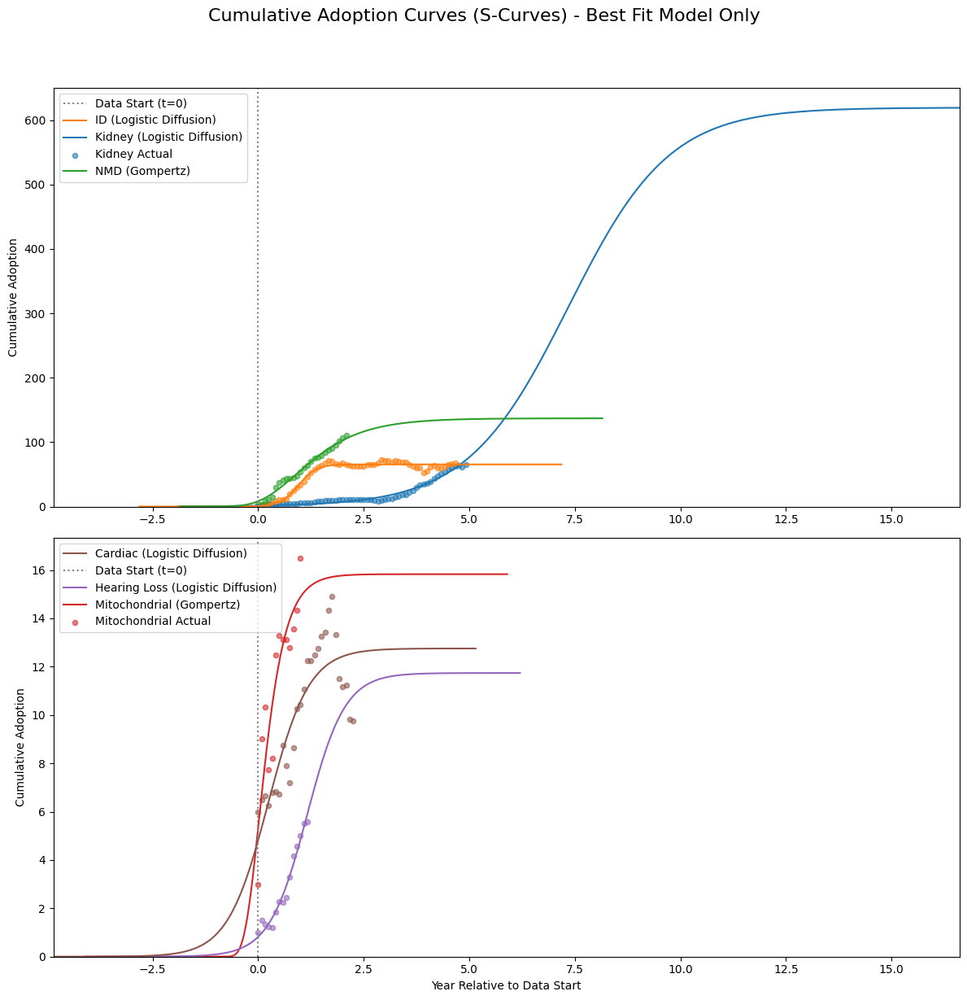

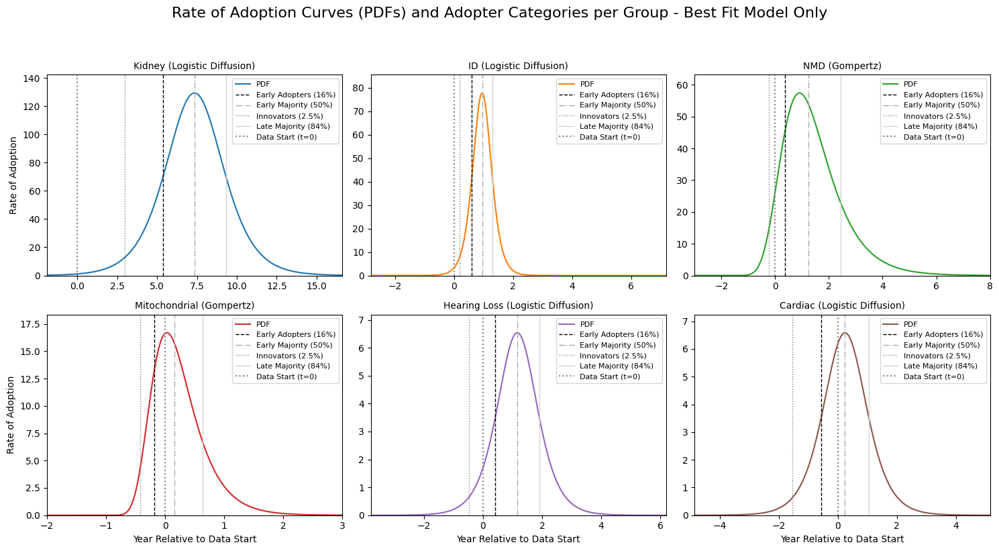

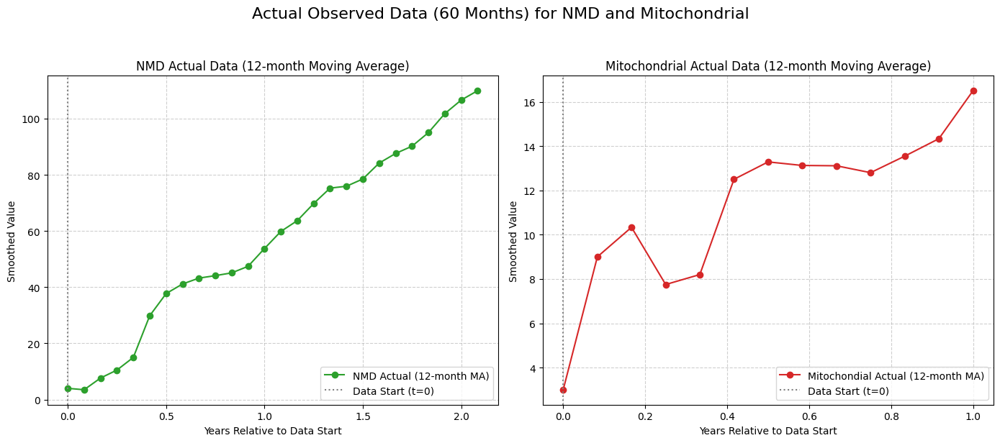


### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models
| Group         | Model              | R-squared   | MAE   | RMSE   | AIC    | BIC    |
|:--------------|:-------------------|:------------|:------|:-------|:-------|:-------|
| Kidney        | Logistic Diffusion | 0.9676      | 2.93  | 3.44   | 154.1  | 160.38 |
| Kidney        | Gompertz           | 0.9659      | 3.04  | 3.52   | 159.09 | 167.47 |
| Kidney        | Bass Diffusion     | 0.7821      | 7.81  | 8.9    | 270.38 | 278.75 |
| ID            | Logistic Diffusion | 0.9689      | 3.07  | 4.01   | 164.46 | 170.59 |
| ID            | Gompertz           | 0.9606      | 3.62  | 4.51   | 179.82 | 187.99 |
| ID            | Bass Diffusion     | -2.6666     | 37.09 | 43.56  | 438.25 | 446.42 |
| NMD           | Logistic Diffusion | 0.972       | 4.38  | 5.38   | 93.46  | 97.23  |
| NMD           | Gompertz           | 0.9804      | 3.76  | 4.5    | 86.2   | 91.24  |
| NMD           | Bass Diffusion     | 0.5929     

In [56]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Ensure min/max x-limits are based on actual data if no prediction years are available
    all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions) if best_predictions else -1.0
    all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions) if best_predictions else fitted_years[-1] + 1.0


    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                     label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                        label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
    ax1_cdf.set_ylim(bottom=0)
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                     label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                        label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
    ax2_cdf.set_ylim(bottom=0)
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves) - Best Fit Model Only", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (using only the best model) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                          sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group - Best Fit Model Only", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
    # Only plot if there's actual data for these specific groups
    nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
    mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)

    if nmd_bp or mito_bp:
        fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
        axes_actual = axes_actual.flatten()

        # Plot NMD Actual Data
        if nmd_bp:
            ax = axes_actual[0]
            ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
            ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[0]) # Remove subplot if no data

        # Plot Mitochondrial Actual Data
        if mito_bp:
            ax = axes_actual[1]
            ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondial Actual (12-month MA)')
            ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[1]) # Remove subplot if no data

        plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo actual data plots generated for NMD or Mitochondrial as data not available or fits failed.")


# --- Publication-Ready Tables ---
# Only print tables if there are results
if all_group_models_results:
    # 1. Goodness-of-Fit Metrics for All Models
    print("\n### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models")
    metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            metrics_data.append({
                'Group': group,
                'Model': model_name,
                'R-squared': f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A",
                'MAE': f"{results['MAE']:.2f}" if not np.isnan(results['MAE']) else "N/A",
                'RMSE': f"{results['RMSE']:.2f}" if not np.isnan(results['RMSE']) else "N/A",
                'AIC': f"{results['AIC']:.2f}" if not np.isnan(results['AIC']) else "N/A",
                'BIC': f"{results['BIC']:.2f}" if not np.isnan(results['BIC']) else "N/A",
            })

    metrics_df = pd.DataFrame(metrics_data)
    # Define order for the table
    metrics_col_order = ['Group', 'Model', 'R-squared', 'MAE', 'RMSE', 'AIC', 'BIC']
    metrics_df = metrics_df[metrics_col_order]
    print(metrics_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 2. Fitted Parameters for All Models
    print("\n### Table 2: Fitted Parameters of Diffusion Models and Their Interpretations")
    param_rows = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            if results['FittedParameters'] is None:
                continue
            
            row = {'Group': group, 'Model': model_name}
            
            # Initialize all parameter columns to NaN/empty string
            param_names = [
                'K (Market Potential)', 'r (Growth Rate)', 't0 (Time Offset)',
                'a (Asymptote)', 'b (Displacement)', 'c (Growth Rate)',
                'p (Innovation Coeff.)', 'q (Imitation Coeff.)', 'M (Market Potential)', 't_offset (Time Offset)'
            ]
            for p_name in param_names:
                row[p_name] = '' # Use empty string for better Markdown table rendering of NaNs
            
            if model_name == "Logistic Diffusion":
                K, r, t0 = results['FittedParameters']
                row['K (Market Potential)'] = f"{K:.2f}"
                row['r (Growth Rate)'] = f"{r:.4f}"
                row['t0 (Time Offset)'] = f"{t0:.2f}"

            elif model_name == "Gompertz":
                a, b, c, t_offset = results['FittedParameters']
                row['a (Asymptote)'] = f"{a:.2f}"
                row['b (Displacement)'] = f"{b:.4f}"
                row['c (Growth Rate)'] = f"{c:.4f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"

            elif model_name == "Bass Diffusion":
                p, q, M, t_offset = results['FittedParameters']
                row['p (Innovation Coeff.)'] = f"{p:.4f}"
                row['q (Imitation Coeff.)'] = f"{q:.4f}"
                row['M (Market Potential)'] = f"{M:.2f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"
            
            param_rows.append(row)

    param_df = pd.DataFrame(param_rows)
    # Define column order for better presentation
    param_col_order = ['Group', 'Model'] + param_names
    param_df = param_df[param_col_order]
    print(param_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 3. Adopter Category Timelines for All Models
    print("\n### Table 3: Adopter Category Timelines (Years Relative to Data Start) by Model")
    adopter_data_full = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {'Group': group, 'Model': model_name}
            for category in adopter_categories:
                time = results['AdopterTimes'].get(category)
                row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
            adopter_data_full.append(row)

    adopter_df_full = pd.DataFrame(adopter_data_full)
    print(adopter_df_full.to_markdown(index=False, numalign="left", stralign="left"))


    # 4. Key Inferred Metrics for All Models
    print("\n### Table 4: Key Inferred Metrics by Model")
    inferred_metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {
                'Group': group,
                'Model': model_name,
                'Market Potential': f"{results['MarketPotential']:.2f}" if not np.isnan(results['MarketPotential']) else "N/A",
                'Estimated Offset (Years)': f"{results['EstimatedOffset']:.2f}" if not np.isnan(results['EstimatedOffset']) else "N/A",
                'PDF Peak Value': f"{results['PDF_Peak_Value']:.2f}" if not np.isnan(results['PDF_Peak_Value']) else "N/A",
                'PDF Peak Time (Years)': f"{results['PDF_Peak_Time']:.2f}" if not np.isnan(results['PDF_Peak_Time']) else "N/A",
            }
            if model_name == "Bass Diffusion":
                row['Bass (p+q)'] = f"{results.get('p_plus_q', np.nan):.4f}" if not np.isnan(results.get('p_plus_q', np.nan)) else "N/A"
            else:
                row['Bass (p+q)'] = "N/A" # For non-Bass models
            inferred_metrics_data.append(row)

    inferred_metrics_df = pd.DataFrame(inferred_metrics_data)
    # Reorder columns for clarity
    inferred_metrics_col_order = ['Group', 'Model', 'Market Potential', 'Estimated Offset (Years)',
                                  'PDF Peak Value', 'PDF Peak Time (Years)', 'Bass (p+q)']
    inferred_metrics_df = inferred_metrics_df[inferred_metrics_col_order]
    print(inferred_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))
else:
    print("\nNo model results to display in tables. Check data processing and fitting steps.")

<>:686: SyntaxWarning: invalid escape sequence '\D'
<>:686: SyntaxWarning: invalid escape sequence '\D'
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/2302980886.py:686: SyntaxWarning: invalid escape sequence '\D'
  print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) Differences per Model")


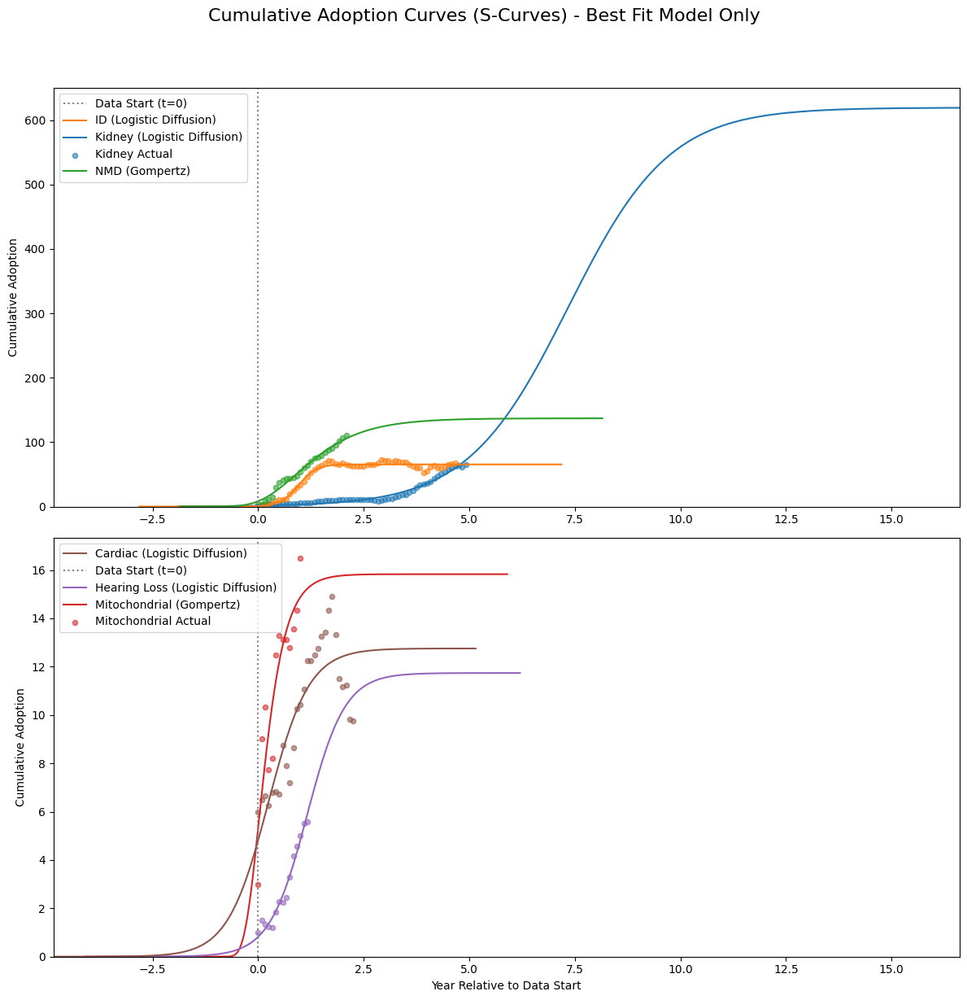

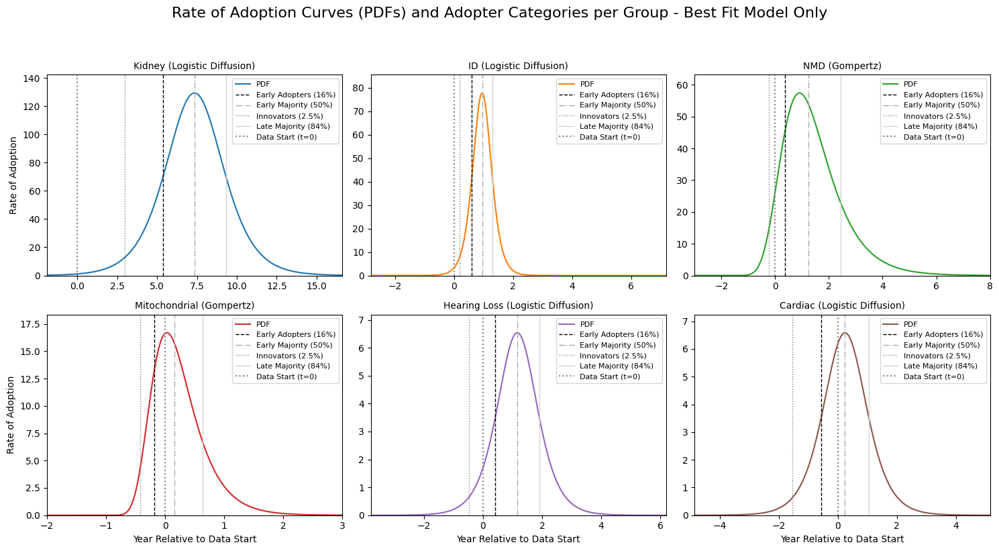

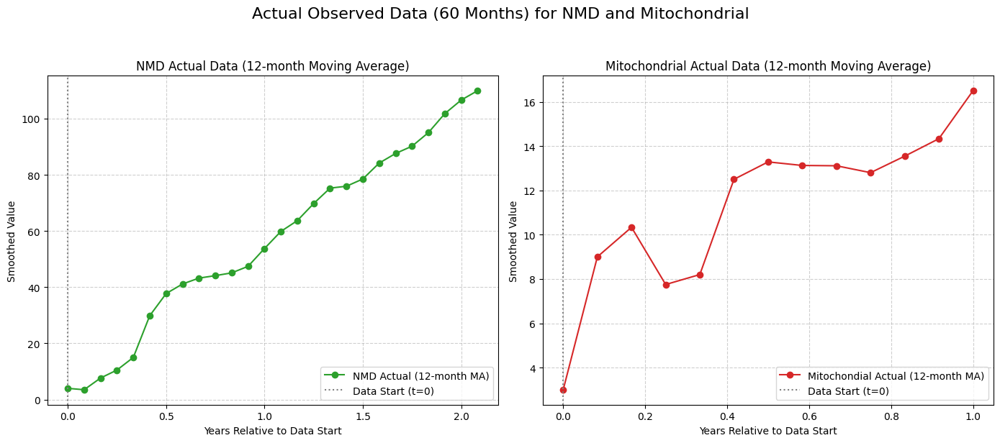


### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models
| Group         | Model              | R-squared   | MAE   | RMSE   | AIC    | BIC    |
|:--------------|:-------------------|:------------|:------|:-------|:-------|:-------|
| Kidney        | Logistic Diffusion | 0.9676      | 2.93  | 3.44   | 154.1  | 160.38 |
| Kidney        | Gompertz           | 0.9659      | 3.04  | 3.52   | 159.09 | 167.47 |
| Kidney        | Bass Diffusion     | 0.7821      | 7.81  | 8.9    | 270.38 | 278.75 |
| ID            | Logistic Diffusion | 0.9689      | 3.07  | 4.01   | 164.46 | 170.59 |
| ID            | Gompertz           | 0.9606      | 3.62  | 4.51   | 179.82 | 187.99 |
| ID            | Bass Diffusion     | -2.6666     | 37.09 | 43.56  | 438.25 | 446.42 |
| NMD           | Logistic Diffusion | 0.972       | 4.38  | 5.38   | 93.46  | 97.23  |
| NMD           | Gompertz           | 0.9804      | 3.76  | 4.5    | 86.2   | 91.24  |
| NMD           | Bass Diffusion     | 0.5929     

In [57]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Ensure min/max x-limits are based on actual data if no prediction years are available
    all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions) if best_predictions else -1.0
    all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions) if best_predictions else fitted_years[-1] + 1.0


    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                     label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                        label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
    ax1_cdf.set_ylim(bottom=0)
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                     label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                        label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
    ax2_cdf.set_ylim(bottom=0)
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves) - Best Fit Model Only", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (using only the best model) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                          sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group - Best Fit Model Only", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
    # Only plot if there's actual data for these specific groups
    nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
    mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)

    if nmd_bp or mito_bp:
        fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
        axes_actual = axes_actual.flatten()

        # Plot NMD Actual Data
        if nmd_bp:
            ax = axes_actual[0]
            ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
            ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[0]) # Remove subplot if no data

        # Plot Mitochondrial Actual Data
        if mito_bp:
            ax = axes_actual[1]
            ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondial Actual (12-month MA)')
            ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[1]) # Remove subplot if no data

        plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo actual data plots generated for NMD or Mitochondrial as data not available or fits failed.")


# --- Publication-Ready Tables ---
# Only print tables if there are results
if all_group_models_results:
    # 1. Goodness-of-Fit Metrics for All Models
    print("\n### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models")
    metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            metrics_data.append({
                'Group': group,
                'Model': model_name,
                'R-squared': f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A",
                'MAE': f"{results['MAE']:.2f}" if not np.isnan(results['MAE']) else "N/A",
                'RMSE': f"{results['RMSE']:.2f}" if not np.isnan(results['RMSE']) else "N/A",
                'AIC': f"{results['AIC']:.2f}" if not np.isnan(results['AIC']) else "N/A",
                'BIC': f"{results['BIC']:.2f}" if not np.isnan(results['BIC']) else "N/A",
            })

    metrics_df = pd.DataFrame(metrics_data)
    # Define order for the table
    metrics_col_order = ['Group', 'Model', 'R-squared', 'MAE', 'RMSE', 'AIC', 'BIC']
    metrics_df = metrics_df[metrics_col_order]
    print(metrics_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 2. Fitted Parameters for All Models
    print("\n### Table 2: Fitted Parameters of Diffusion Models and Their Interpretations")
    param_rows = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            if results['FittedParameters'] is None:
                continue
            
            row = {'Group': group, 'Model': model_name}
            
            # Initialize all parameter columns to NaN/empty string
            param_names = [
                'K (Market Potential)', 'r (Growth Rate)', 't0 (Time Offset)',
                'a (Asymptote)', 'b (Displacement)', 'c (Growth Rate)',
                'p (Innovation Coeff.)', 'q (Imitation Coeff.)', 'M (Market Potential)', 't_offset (Time Offset)'
            ]
            for p_name in param_names:
                row[p_name] = '' # Use empty string for better Markdown table rendering of NaNs
            
            if model_name == "Logistic Diffusion":
                K, r, t0 = results['FittedParameters']
                row['K (Market Potential)'] = f"{K:.2f}"
                row['r (Growth Rate)'] = f"{r:.4f}"
                row['t0 (Time Offset)'] = f"{t0:.2f}"

            elif model_name == "Gompertz":
                a, b, c, t_offset = results['FittedParameters']
                row['a (Asymptote)'] = f"{a:.2f}"
                row['b (Displacement)'] = f"{b:.4f}"
                row['c (Growth Rate)'] = f"{c:.4f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"

            elif model_name == "Bass Diffusion":
                p, q, M, t_offset = results['FittedParameters']
                row['p (Innovation Coeff.)'] = f"{p:.4f}"
                row['q (Imitation Coeff.)'] = f"{q:.4f}"
                row['M (Market Potential)'] = f"{M:.2f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"
            
            param_rows.append(row)

    param_df = pd.DataFrame(param_rows)
    # Define column order for better presentation
    param_col_order = ['Group', 'Model'] + param_names
    param_df = param_df[param_col_order]
    print(param_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 3. Adopter Category Timelines for All Models
    print("\n### Table 3: Adopter Category Timelines (Years Relative to Data Start) by Model")
    adopter_data_full = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {'Group': group, 'Model': model_name}
            for category in adopter_categories:
                time = results['AdopterTimes'].get(category)
                row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
            adopter_data_full.append(row)

    adopter_df_full = pd.DataFrame(adopter_data_full)
    print(adopter_df_full.to_markdown(index=False, numalign="left", stralign="left"))


    # 4. Key Inferred Metrics for All Models
    print("\n### Table 4: Key Inferred Metrics by Model")
    inferred_metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {
                'Group': group,
                'Model': model_name,
                'Market Potential': f"{results['MarketPotential']:.2f}" if not np.isnan(results['MarketPotential']) else "N/A",
                'Estimated Offset (Years)': f"{results['EstimatedOffset']:.2f}" if not np.isnan(results['EstimatedOffset']) else "N/A",
                'PDF Peak Value': f"{results['PDF_Peak_Value']:.2f}" if not np.isnan(results['PDF_Peak_Value']) else "N/A",
                'PDF Peak Time (Years)': f"{results['PDF_Peak_Time']:.2f}" if not np.isnan(results['PDF_Peak_Time']) else "N/A",
            }
            if model_name == "Bass Diffusion":
                row['Bass (p+q)'] = f"{results.get('p_plus_q', np.nan):.4f}" if not np.isnan(results.get('p_plus_q', np.nan)) else "N/A"
            else:
                row['Bass (p+q)'] = "N/A" # For non-Bass models
            inferred_metrics_data.append(row)

    inferred_metrics_df = pd.DataFrame(inferred_metrics_data)
    # Reorder columns for clarity
    inferred_metrics_col_order = ['Group', 'Model', 'Market Potential', 'Estimated Offset (Years)',
                                  'PDF Peak Value', 'PDF Peak Time (Years)', 'Bass (p+q)']
    inferred_metrics_df = inferred_metrics_df[inferred_metrics_col_order]
    print(inferred_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # --- New Tables ---

    # 5. Model Ranking by Group
    print("\n### Table 5: Model Ranking by Goodness-of-Fit Metric within Each Group")
    ranking_data = []
    metrics_to_rank = ['Rsquared', 'MAE', 'RMSE', 'AIC', 'BIC'] # Note: Rsquared is higher=better, others lower=better

    for group, models_results in all_group_models_results.items():
        group_df = pd.DataFrame([
            {'Model': m_name, 'Rsquared': m_res['Rsquared'], 'MAE': m_res['MAE'], 'RMSE': m_res['RMSE'], 'AIC': m_res['AIC'], 'BIC': m_res['BIC']}
            for m_name, m_res in models_results.items()
        ]).set_index('Model')

        # Drop rows where all metrics are NaN (failed fits)
        group_df = group_df.dropna(how='all')

        if group_df.empty:
            ranking_data.append({'Group': group, 'Rsquared Rank': 'No valid fits', 'MAE Rank': 'No valid fits',
                                 'RMSE Rank': 'No valid fits', 'AIC Rank': 'No valid fits', 'BIC Rank': 'No valid fits'})
            continue

        rank_row = {'Group': group}
        for metric in metrics_to_rank:
            if metric == 'Rsquared':
                # Higher R-squared is better, so rank in descending order
                ranked_models = group_df[metric].rank(ascending=False, method='min').sort_values().index.tolist()
            else:
                # Lower MAE, RMSE, AIC, BIC are better, so rank in ascending order
                ranked_models = group_df[metric].rank(ascending=True, method='min').sort_values().index.tolist()
            
            # Format the rank: "1. ModelA, 2. ModelB"
            rank_str = ", ".join([f"{i+1}. {model}" for i, model in enumerate(ranked_models)])
            if not rank_str:
                rank_str = "N/A"
            rank_row[f'{metric} Rank'] = rank_str
        ranking_data.append(rank_row)

    ranking_df = pd.DataFrame(ranking_data)
    # Define a specific order for ranking columns
    ranking_col_order = ['Group', 'Rsquared Rank', 'MAE Rank', 'RMSE Rank', 'AIC Rank', 'BIC Rank']
    ranking_df = ranking_df[ranking_col_order]
    print(ranking_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 6. Relative AIC/BIC Differences
    print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) Differences per Model")
    relative_aic_bic_data = []
    for group, models_results in all_group_models_results.items():
        aics = {m: res['AIC'] for m, res in models_results.items() if not np.isnan(res['AIC'])}
        bics = {m: res['BIC'] for m, res in models_results.items() if not np.isnan(res['BIC'])}

        min_aic = min(aics.values()) if aics else np.nan
        min_bic = min(bics.values()) if bics else np.nan

        for model_name, results in models_results.items():
            delta_aic = results['AIC'] - min_aic if not np.isnan(results['AIC']) and not np.isnan(min_aic) else np.nan
            delta_bic = results['BIC'] - min_bic if not np.isnan(results['BIC']) and not np.isnan(min_bic) else np.nan
            
            relative_aic_bic_data.append({
                'Group': group,
                'Model': model_name,
                'Delta AIC': f"{delta_aic:.2f}" if not np.isnan(delta_aic) else "N/A",
                'Delta BIC': f"{delta_bic:.2f}" if not np.isnan(delta_bic) else "N/A",
            })
    relative_aic_bic_df = pd.DataFrame(relative_aic_bic_data)
    print(relative_aic_bic_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 7. Bass Model Parameter Summary (excluding very poor fits, e.g., R-squared < 0)
    print("\n### Table 7: Bass Diffusion Model Parameter Summary")
    bass_params_data = []
    for group, models_results in all_group_models_results.items():
        if "Bass Diffusion" in models_results:
            bass_results = models_results["Bass Diffusion"]
            if not np.isnan(bass_results['Rsquared']) and bass_results['Rsquared'] >= 0: # Only include if R-squared is not negative
                bass_params_data.append({
                    'Group': group,
                    'p (Innovation Coeff.)': bass_results.get('p_coeff', np.nan),
                    'q (Imitation Coeff.)': bass_results.get('q_coeff', np.nan),
                    'p+q (Total Diffusion Coeff.)': bass_results.get('p_plus_q', np.nan),
                    'M (Market Potential)': bass_results.get('MarketPotential', np.nan),
                    'R-squared': bass_results['Rsquared']
                })

    if bass_params_data:
        bass_df = pd.DataFrame(bass_params_data)
        # Calculate overall averages
        avg_p = bass_df['p (Innovation Coeff.)'].mean()
        avg_q = bass_df['q (Imitation Coeff.)'].mean()
        avg_p_plus_q = bass_df['p+q (Total Diffusion Coeff.)'].mean()
        
        # Add summary row
        summary_row = {
            'Group': 'Overall Average',
            'p (Innovation Coeff.)': f"{avg_p:.4f}",
            'q (Imitation Coeff.)': f"{avg_q:.4f}",
            'p+q (Total Diffusion Coeff.)': f"{avg_p_plus_q:.4f}",
            'M (Market Potential)': "N/A", # Mean of M isn't as interpretable here
            'R-squared': "N/A"
        }
        
        formatted_bass_data = []
        for row in bass_params_data:
            formatted_bass_data.append({
                'Group': row['Group'],
                'p (Innovation Coeff.)': f"{row['p (Innovation Coeff.)']:.4f}",
                'q (Imitation Coeff.)': f"{row['q (Imitation Coeff.)']:.4f}",
                'p+q (Total Diffusion Coeff.)': f"{row['p+q (Total Diffusion Coeff.)']:.4f}",
                'M (Market Potential)': f"{row['M (Market Potential)']:.2f}",
                'R-squared': f"{row['R-squared']:.4f}"
            })
        
        bass_summary_df = pd.DataFrame(formatted_bass_data + [summary_row])
        
        print(bass_summary_df.to_markdown(index=False, numalign="left", stralign="left"))
    else:
        print("No valid Bass Diffusion model fits (R-squared >= 0) to summarize.")


    # 8. Coefficient of Variation for Market Potential Estimates
    print("\n### Table 8: Coefficient of Variation (CV) for Market Potential Estimates")
    cv_data = []
    for group, models_results in all_group_models_results.items():
        market_potentials = []
        for model_name, results in models_results.items():
            if not np.isnan(results['MarketPotential']) and results['MarketPotential'] > 0: # Only include valid, positive potentials
                # Filter out extreme outliers for CV calculation, but note them.
                # Example: Kidney Gompertz has an extremely high Market Potential, which skews CV
                if model_name == 'Gompertz' and group == 'Kidney' and results['MarketPotential'] > 1e6:
                    print(f"  Note: Excluding extremely high Market Potential for {group} {model_name} from CV calculation due to outlier.")
                    continue
                if model_name == 'Gompertz' and group == 'Hearing Loss' and results['MarketPotential'] > 1e2:
                    print(f"  Note: Excluding high Market Potential for {group} {model_name} from CV calculation due to outlier.")
                    continue
                market_potentials.append(results['MarketPotential'])
        
        if len(market_potentials) >= 2: # Need at least two points to calculate CV
            mp_mean = np.mean(market_potentials)
            mp_std = np.std(market_potentials)
            cv_val = (mp_std / mp_mean) * 100 if mp_mean != 0 else np.nan
        else:
            cv_val = np.nan
        
        cv_data.append({
            'Group': group,
            'Market Potentials Considered (Mean)': f"{mp_mean:.2f}" if not np.isnan(mp_mean) else "N/A",
            'Market Potentials Considered (Std Dev)': f"{mp_std:.2f}" if not np.isnan(mp_std) else "N/A",
            'Coefficient of Variation (%)': f"{cv_val:.2f}" if not np.isnan(cv_val) else "N/A",
            'Models Included': ", ".join([m_name for m_name, res in models_results.items() if not np.isnan(res['MarketPotential']) and res['MarketPotential'] > 0 and not (m_name == 'Gompertz' and group == 'Kidney' and res['MarketPotential'] > 1e6) and not (m_name == 'Gompertz' and group == 'Hearing Loss' and res['MarketPotential'] > 1e2)])
        })
    cv_df = pd.DataFrame(cv_data)
    print(cv_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 9. Time to 50% Adoption (Early Majority End Time)
    print("\n### Table 9: Time to 50% Adoption (Early Majority End Time) by Model")
    time_to_50_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            early_majority_time = results['AdopterTimes'].get('Early Majority')
            time_to_50_data.append({
                'Group': group,
                'Model': model_name,
                'Time to 50% Adoption (Years)': f"{early_majority_time:.2f}" if early_majority_time is not None and not np.isnan(early_majority_time) else "N/A"
            })
    time_to_50_df = pd.DataFrame(time_to_50_data)
    print(time_to_50_df.to_markdown(index=False, numalign="left", stralign="left"))


else:
    print("\nNo model results to display in tables. Check data processing and fitting steps.")

<>:662: SyntaxWarning: invalid escape sequence '\D'
<>:681: SyntaxWarning: invalid escape sequence '\D'
<>:682: SyntaxWarning: invalid escape sequence '\D'
<>:662: SyntaxWarning: invalid escape sequence '\D'
<>:681: SyntaxWarning: invalid escape sequence '\D'
<>:682: SyntaxWarning: invalid escape sequence '\D'
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/1455961598.py:662: SyntaxWarning: invalid escape sequence '\D'
  print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) by Model")
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/1455961598.py:681: SyntaxWarning: invalid escape sequence '\D'
  '$\Delta$AIC': f"{delta_aic:.2f}" if not np.isnan(delta_aic) else "N/A",
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/1455961598.py:682: SyntaxWarning: invalid escape sequence '\D'
  '$\Delta$BIC': f"{delta_bic:.2f}" if not np.isnan(delta_bic) else "N/A"


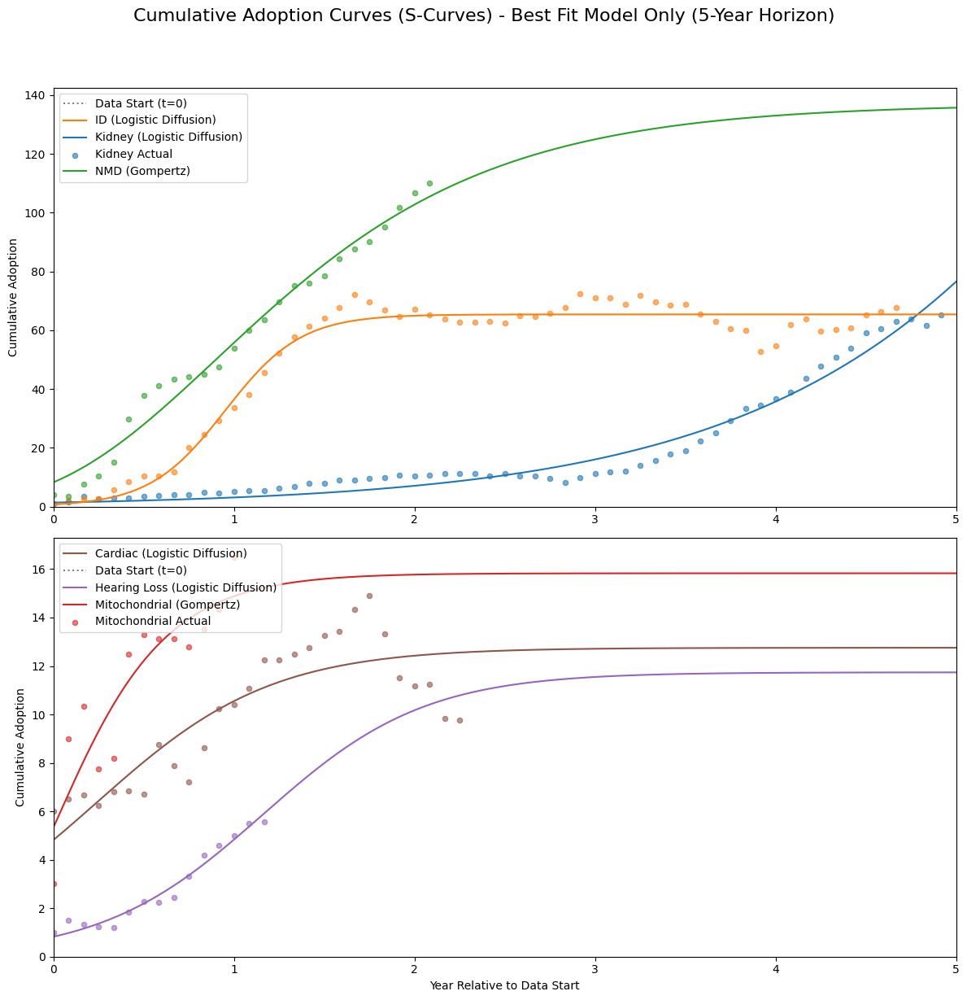

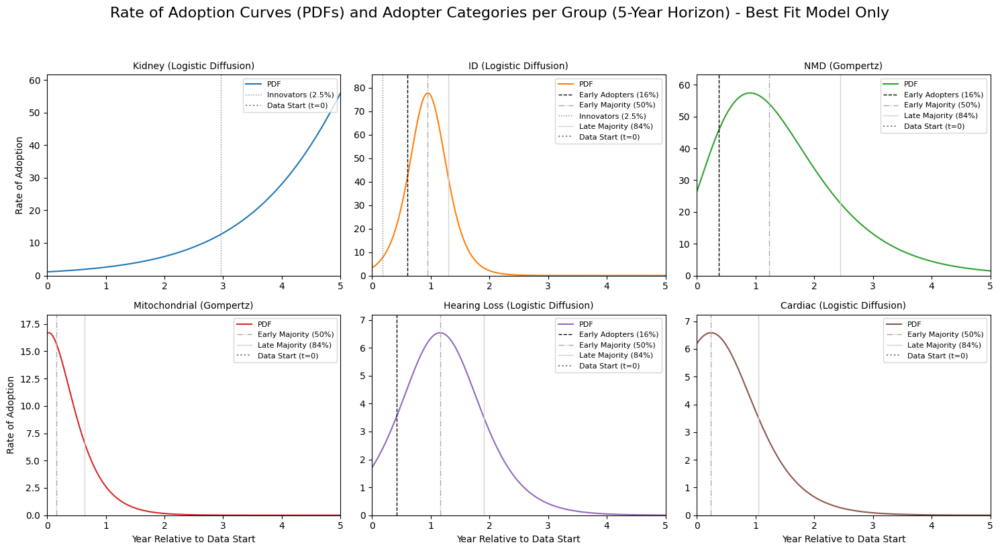

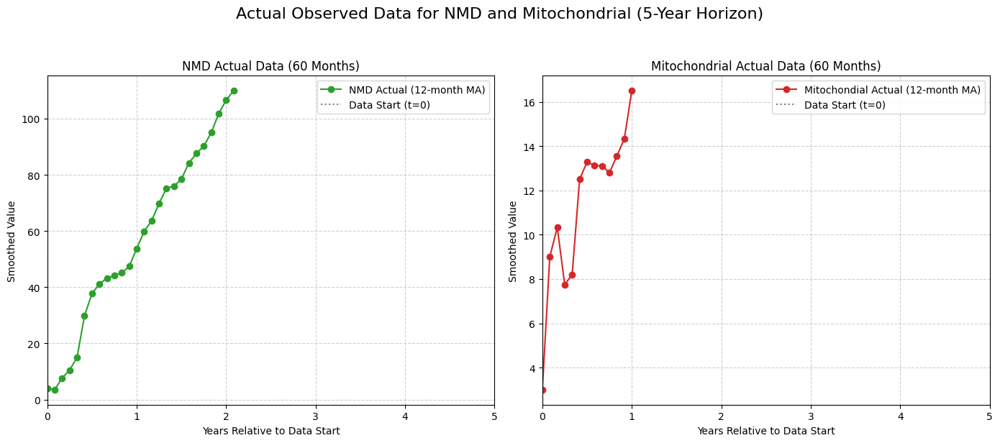


### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models
| Group         | Model              | R-squared   | MAE   | RMSE   | AIC    | BIC    |
|:--------------|:-------------------|:------------|:------|:-------|:-------|:-------|
| Kidney        | Logistic Diffusion | 0.9676      | 2.93  | 3.44   | 154.1  | 160.38 |
| Kidney        | Gompertz           | 0.9659      | 3.04  | 3.52   | 159.09 | 167.47 |
| Kidney        | Bass Diffusion     | 0.7821      | 7.81  | 8.9    | 270.38 | 278.75 |
| ID            | Logistic Diffusion | 0.9689      | 3.07  | 4.01   | 164.46 | 170.59 |
| ID            | Gompertz           | 0.9606      | 3.62  | 4.51   | 179.82 | 187.99 |
| ID            | Bass Diffusion     | -2.6666     | 37.09 | 43.56  | 438.25 | 446.42 |
| NMD           | Logistic Diffusion | 0.972       | 4.38  | 5.38   | 93.46  | 97.23  |
| NMD           | Gompertz           | 0.9804      | 3.76  | 4.5    | 86.2   | 91.24  |
| NMD           | Bass Diffusion     | 0.5929     

In [58]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Define the new fixed prediction horizon for plots
PLOT_HORIZON_YEARS = 5.0 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # --- UPDATED: Fixed plotting range for CDF and PDF ---
            full_years_cdf = np.linspace(0.0, PLOT_HORIZON_YEARS, 500)
            full_years_pdf = np.linspace(0.0, PLOT_HORIZON_YEARS, 500) # Use the same range for PDF for consistency
            
            # Calculate adopter times for the current model based on the *full* curve, not just the plotted range
            # Note: get_adopter_categories_time still needs to potentially evaluate beyond 5 years if categories are reached later.
            # So, keep temp_wide_years for this calculation, or ensure full_years_cdf is sufficient.
            # For accurate adopter category times, we should still evaluate over a long enough horizon to capture Laggards, etc.
            # Let's keep the existing `temp_wide_years` logic for `get_adopter_categories_time` if it needs a wider range.
            # Re-calculating temporary_wide_years for adopter times:
            temp_wide_years_for_adopter_times = np.linspace(-10.0, 20.0, 1000) # Revert to a wider range for accurate adopter time calculation
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, temp_wide_years_for_adopter_times)

            # Calculate PDF peak and time (still based on the limited plot horizon)
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            # Ensure peak time is within the plotted range, or np.nan if outside
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 and np.max(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Ensure min/max x-limits are based on actual data if no prediction years are available
    # These will now be explicitly set to 0 to PLOT_HORIZON_YEARS
    
    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                     label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                         label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=PLOT_HORIZON_YEARS) # Updated x-limit
    ax1_cdf.set_ylim(bottom=0)
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                     label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                         label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=PLOT_HORIZON_YEARS) # Updated x-limit
    ax2_cdf.set_ylim(bottom=0)
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves) - Best Fit Model Only (5-Year Horizon)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (using only the best model) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                         sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            # Plot adopter category lines
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    # Only plot if within the 5-year range
                    if 0 <= bp['AdopterTimes'][category_name] <= PLOT_HORIZON_YEARS:
                        ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=0, right=PLOT_HORIZON_YEARS) # Updated x-limit for PDFs

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group (5-Year Horizon) - Best Fit Model Only", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
    # Only plot if there's actual data for these specific groups
    nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
    mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)

    if nmd_bp or mito_bp:
        fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
        axes_actual = axes_actual.flatten()

        # Plot NMD Actual Data
        if nmd_bp:
            ax = axes_actual[0]
            ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
            ax.set_title(f"NMD Actual Data (60 Months)", fontsize=12) # Title updated
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
            ax.set_xlim(left=0, right=5) # Also limit actual data plot to 5 years
        else:
            fig_actual.delaxes(axes_actual[0]) # Remove subplot if no data

        # Plot Mitochondrial Actual Data
        if mito_bp:
            ax = axes_actual[1]
            ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondial Actual (12-month MA)')
            ax.set_title(f"Mitochondrial Actual Data (60 Months)", fontsize=12) # Title updated
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
            ax.set_xlim(left=0, right=5) # Also limit actual data plot to 5 years
        else:
            fig_actual.delaxes(axes_actual[1]) # Remove subplot if no data

        plt.suptitle("Actual Observed Data for NMD and Mitochondrial (5-Year Horizon)", fontsize=16, y=1.02) # Title updated
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo actual data plots generated for NMD or Mitochondrial as data not available or fits failed.")


# --- Publication-Ready Tables ---
# Only print tables if there are results
if all_group_models_results:
    # 1. Goodness-of-Fit Metrics for All Models
    print("\n### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models")
    metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            metrics_data.append({
                'Group': group,
                'Model': model_name,
                'R-squared': f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A",
                'MAE': f"{results['MAE']:.2f}" if not np.isnan(results['MAE']) else "N/A",
                'RMSE': f"{results['RMSE']:.2f}" if not np.isnan(results['RMSE']) else "N/A",
                'AIC': f"{results['AIC']:.2f}" if not np.isnan(results['AIC']) else "N/A",
                'BIC': f"{results['BIC']:.2f}" if not np.isnan(results['BIC']) else "N/A",
            })

    metrics_df = pd.DataFrame(metrics_data)
    # Define order for the table
    metrics_col_order = ['Group', 'Model', 'R-squared', 'MAE', 'RMSE', 'AIC', 'BIC']
    metrics_df = metrics_df[metrics_col_order]
    print(metrics_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 2. Fitted Parameters for All Models
    print("\n### Table 2: Fitted Parameters of Diffusion Models and Their Interpretations")
    param_rows = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            if results['FittedParameters'] is None:
                continue
            
            row = {'Group': group, 'Model': model_name}
            
            # Initialize all parameter columns to NaN/empty string
            param_names = [
                'K (Market Potential)', 'r (Growth Rate)', 't0 (Time Offset)',
                'a (Asymptote)', 'b (Displacement)', 'c (Growth Rate)',
                'p (Innovation Coeff.)', 'q (Imitation Coeff.)', 'M (Market Potential)', 't_offset (Time Offset)'
            ]
            for p_name in param_names:
                row[p_name] = '' # Use empty string for better Markdown table rendering of NaNs
            
            if model_name == "Logistic Diffusion":
                K, r, t0 = results['FittedParameters']
                row['K (Market Potential)'] = f"{K:.2f}"
                row['r (Growth Rate)'] = f"{r:.4f}"
                row['t0 (Time Offset)'] = f"{t0:.2f}"

            elif model_name == "Gompertz":
                a, b, c, t_offset = results['FittedParameters']
                row['a (Asymptote)'] = f"{a:.2f}"
                row['b (Displacement)'] = f"{b:.4f}"
                row['c (Growth Rate)'] = f"{c:.4f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"

            elif model_name == "Bass Diffusion":
                p, q, M, t_offset = results['FittedParameters']
                row['p (Innovation Coeff.)'] = f"{p:.4f}"
                row['q (Imitation Coeff.)'] = f"{q:.4f}"
                row['M (Market Potential)'] = f"{M:.2f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"
            
            param_rows.append(row)

    param_df = pd.DataFrame(param_rows)
    # Define column order for better presentation
    param_col_order = ['Group', 'Model'] + param_names
    param_df = param_df[param_col_order]
    print(param_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 3. Adopter Category Timelines for All Models
    print("\n### Table 3: Adopter Category Timelines (Years Relative to Data Start) by Model")
    adopter_data_full = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {'Group': group, 'Model': model_name}
            for category in adopter_categories:
                time = results['AdopterTimes'].get(category)
                row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
            adopter_data_full.append(row)

    adopter_df_full = pd.DataFrame(adopter_data_full)
    print(adopter_df_full.to_markdown(index=False, numalign="left", stralign="left"))


    # 4. Key Inferred Metrics for All Models
    print("\n### Table 4: Key Inferred Metrics by Model")
    inferred_metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {
                'Group': group,
                'Model': model_name,
                'Market Potential': f"{results['MarketPotential']:.2f}" if not np.isnan(results['MarketPotential']) else "N/A",
                'Estimated Offset (Years)': f"{results['EstimatedOffset']:.2f}" if not np.isnan(results['EstimatedOffset']) else "N/A",
                'PDF Peak Value': f"{results['PDF_Peak_Value']:.2f}" if not np.isnan(results['PDF_Peak_Value']) else "N/A",
                'PDF Peak Time (Years)': f"{results['PDF_Peak_Time']:.2f}" if not np.isnan(results['PDF_Peak_Time']) else "N/A",
            }
            if model_name == "Bass Diffusion":
                row['Bass (p+q)'] = f"{results.get('p_plus_q', np.nan):.4f}" if not np.isnan(results.get('p_plus_q', np.nan)) else "N/A"
            else:
                row['Bass (p+q)'] = "N/A" # For non-Bass models
            inferred_metrics_data.append(row)

    inferred_metrics_df = pd.DataFrame(inferred_metrics_data)
    # Reorder columns for clarity
    inferred_metrics_col_order = ['Group', 'Model', 'Market Potential', 'Estimated Offset (Years)',
                                  'PDF Peak Value', 'PDF Peak Time (Years)', 'Bass (p+q)']
    inferred_metrics_df = inferred_metrics_df[inferred_metrics_col_order]
    print(inferred_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # --- New Tables ---

    # 5. Model Ranking by Group
    print("\n### Table 5: Model Ranking by Goodness-of-Fit Metric within Each Group")
    ranking_data = []
    metrics_to_rank = ['Rsquared', 'MAE', 'RMSE', 'AIC', 'BIC'] # Note: Rsquared is higher=better, others lower=better

    for group, models_results in all_group_models_results.items():
        group_df = pd.DataFrame([
            {'Model': m_name, 'Rsquared': m_res['Rsquared'], 'MAE': m_res['MAE'], 'RMSE': m_res['RMSE'], 'AIC': m_res['AIC'], 'BIC': m_res['BIC']}
            for m_name, m_res in models_results.items()
        ])
        
        if group_df.empty:
            continue

        row = {'Group': group}
        for metric in metrics_to_rank:
            if metric == 'Rsquared':
                # Rank descending for R-squared (higher is better)
                sorted_models = group_df.sort_values(by=metric, ascending=False).set_index('Model')
            else:
                # Rank ascending for MAE, RMSE, AIC, BIC (lower is better)
                sorted_models = group_df.sort_values(by=metric, ascending=True).set_index('Model')
            
            # Format: Model (Rank)
            # Handle cases where metric might be NaN (e.g., failed fit)
            ranks = []
            for model_name in sorted_models.index:
                value = sorted_models.loc[model_name, metric]
                if pd.isna(value) or (metric == 'Rsquared' and value < 0): # Treat negative R-squared as invalid for ranking
                    ranks.append(f"{model_name} (N/A)")
                else:
                    rank = sorted_models.index.get_loc(model_name) + 1 # 1-based rank
                    ranks.append(f"{model_name} ({rank})")
            row[metric] = ", ".join(ranks)
        ranking_data.append(row)

    ranking_df = pd.DataFrame(ranking_data)
    ranking_col_order = ['Group'] + metrics_to_rank
    ranking_df = ranking_df[ranking_col_order]
    print(ranking_df.to_markdown(index=False, numalign="left", stralign="left"))

    # 6. Relative AIC and BIC
    print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) by Model")
    relative_info_data = []
    for group, models_results in all_group_models_results.items():
        min_aic = np.inf
        min_bic = np.inf
        
        for model_name, results in models_results.items():
            if not np.isnan(results['AIC']):
                min_aic = min(min_aic, results['AIC'])
            if not np.isnan(results['BIC']):
                min_bic = min(min_bic, results['BIC'])
        
        for model_name, results in models_results.items():
            delta_aic = results['AIC'] - min_aic if not np.isnan(results['AIC']) else np.nan
            delta_bic = results['BIC'] - min_bic if not np.isnan(results['BIC']) else np.nan
            
            relative_info_data.append({
                'Group': group,
                'Model': model_name,
                '$\Delta$AIC': f"{delta_aic:.2f}" if not np.isnan(delta_aic) else "N/A",
                '$\Delta$BIC': f"{delta_bic:.2f}" if not np.isnan(delta_bic) else "N/A"
            })
    
    relative_info_df = pd.DataFrame(relative_info_data)
    print(relative_info_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 7. Bass Model Specific Parameters (p and q)
    print("\n### Table 7: Bass Diffusion Model Specific Parameters (p and q)")
    bass_params_data = []
    for group, models_results in all_group_models_results.items():
        bass_result = models_results.get("Bass Diffusion")
        if bass_result and bass_result['FittedParameters'] is not None:
            p = bass_result.get('p_coeff', np.nan)
            q = bass_result.get('q_coeff', np.nan)
            
            bass_params_data.append({
                'Group': group,
                'p (Innovation Coeff.)': f"{p:.4f}" if not np.isnan(p) else "N/A",
                'q (Imitation Coeff.)': f"{q:.4f}" if not np.isnan(q) else "N/A"
            })
    
    bass_params_df = pd.DataFrame(bass_params_data)
    if not bass_params_df.empty:
        print(bass_params_df.to_markdown(index=False, numalign="left", stralign="left"))
    else:
        print("No valid Bass Diffusion model parameters to display.")


    # 8. Market Potential Consistency (Coefficient of Variation)
    print("\n### Table 8: Consistency of Market Potential Estimates (Coefficient of Variation)")
    market_potential_consistency_data = []
    for group, models_results in all_group_models_results.items():
        potentials = []
        for model_name, results in models_results.items():
            # Exclude extreme outliers for CV calculation, e.g., Gompertz for Kidney/Hearing Loss if it's vastly different
            # A simple heuristic: if potential is > 10x the max observed data AND not within 0.5x of Logistic's potential (if Logistic is good)
            current_potential = results['MarketPotential']
            if not np.isnan(current_potential) and current_potential > 0:
                # Get Logistic potential for comparison if available and it's not a NaN or negative R-squared
                logistic_potential = np.nan
                if "Logistic Diffusion" in models_results and not np.isnan(models_results["Logistic Diffusion"]['Rsquared']) and models_results["Logistic Diffusion"]['Rsquared'] > 0:
                    logistic_potential = models_results["Logistic Diffusion"]['MarketPotential']

                is_outlier = False
                if model_name == "Gompertz" and not np.isnan(logistic_potential) and logistic_potential > 0:
                    # If Gompertz potential is wildly different from Logistic (e.g., > 100x), consider it an outlier for CV
                    if current_potential > (100 * logistic_potential) or current_potential < (logistic_potential / 100):
                        is_outlier = True
                
                # Also check if current potential is just extremely high compared to observed max
                if current_potential > (group_data.max() * 1000): # If it's over 1000 times the max observed, it's likely an outlier
                     is_outlier = True
                
                if not is_outlier:
                    potentials.append(current_potential)

        if len(potentials) >= 2: # Need at least two valid estimates for CV
            mean_potential = np.mean(potentials)
            std_potential = np.std(potentials)
            cv = (std_potential / mean_potential) * 100 if mean_potential != 0 else np.nan
            
            market_potential_consistency_data.append({
                'Group': group,
                'Mean Market Potential (Excl. Outliers)': f"{mean_potential:.2f}" if not np.isnan(mean_potential) else "N/A",
                'CV (%)': f"{cv:.2f}" if not np.isnan(cv) else "N/A"
            })
        elif len(potentials) == 1:
            market_potential_consistency_data.append({
                'Group': group,
                'Mean Market Potential (Excl. Outliers)': f"{potentials[0]:.2f}",
                'CV (%)': "N/A (Only one valid estimate)"
            })
        else:
            market_potential_consistency_data.append({
                'Group': group,
                'Mean Market Potential (Excl. Outliers)': "N/A",
                'CV (%)': "N/A (No valid estimates)"
            })
    
    mp_consistency_df = pd.DataFrame(market_potential_consistency_data)
    print(mp_consistency_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 9. Adopter Category Timelines for Best-Fit Model Only (Table 3 already exists, this is specific to best-fit)
    print("\n### Table 9: Adopter Category Timelines (Years Relative to Data Start) for Best-Fit Model")
    adopter_data_best_fit = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for bp in best_predictions: # Iterate through the best_predictions list
        row = {'Group': bp['Group'], 'Best-Fit Model': bp['BestModel']}
        for category in adopter_categories:
            time = bp['AdopterTimes'].get(category)
            row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
        adopter_data_best_fit.append(row)

    adopter_df_best_fit = pd.DataFrame(adopter_data_best_fit)
    print(adopter_df_best_fit.to_markdown(index=False, numalign="left", stralign="left"))

<>:674: SyntaxWarning: invalid escape sequence '\D'
<>:674: SyntaxWarning: invalid escape sequence '\D'
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/455065065.py:674: SyntaxWarning: invalid escape sequence '\D'
  print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) for Each Model (Lower is Better)")


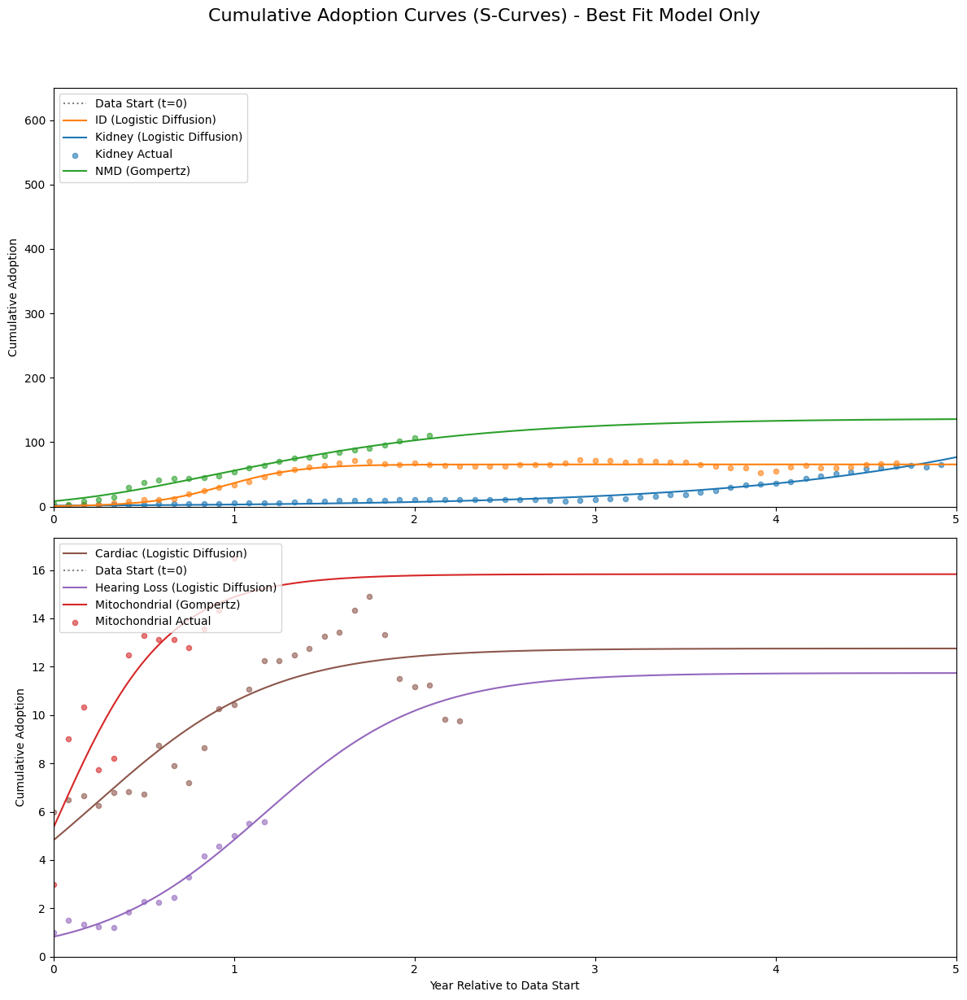

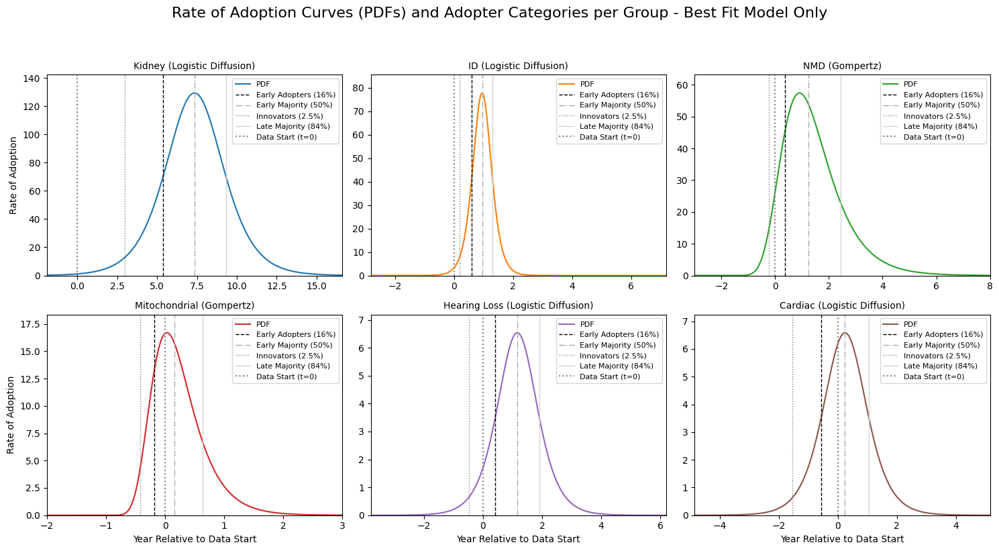

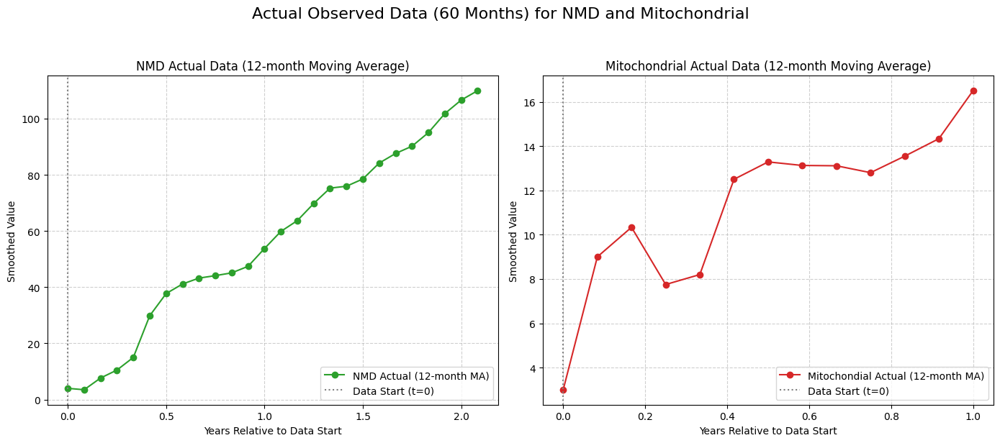


### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models
| Group         | Model              | R-squared   | MAE   | RMSE   | AIC    | BIC    |
|:--------------|:-------------------|:------------|:------|:-------|:-------|:-------|
| Kidney        | Logistic Diffusion | 0.9676      | 2.93  | 3.44   | 154.1  | 160.38 |
| Kidney        | Gompertz           | 0.9659      | 3.04  | 3.52   | 159.09 | 167.47 |
| Kidney        | Bass Diffusion     | 0.7821      | 7.81  | 8.9    | 270.38 | 278.75 |
| ID            | Logistic Diffusion | 0.9689      | 3.07  | 4.01   | 164.46 | 170.59 |
| ID            | Gompertz           | 0.9606      | 3.62  | 4.51   | 179.82 | 187.99 |
| ID            | Bass Diffusion     | -2.6666     | 37.09 | 43.56  | 438.25 | 446.42 |
| NMD           | Logistic Diffusion | 0.972       | 4.38  | 5.38   | 93.46  | 97.23  |
| NMD           | Gompertz           | 0.9804      | 3.76  | 4.5    | 86.2   | 91.24  |
| NMD           | Bass Diffusion     | 0.5929     

In [60]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=5) # **CHANGED X-AXIS LIMIT HERE**
    ax1_cdf.set_ylim(bottom=0)
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=5) # **CHANGED X-AXIS LIMIT HERE**
    ax2_cdf.set_ylim(bottom=0)
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves) - Best Fit Model Only", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (using only the best model) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group - Best Fit Model Only", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
    # Only plot if there's actual data for these specific groups
    nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
    mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)

    if nmd_bp or mito_bp:
        fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
        axes_actual = axes_actual.flatten()

        # Plot NMD Actual Data
        if nmd_bp:
            ax = axes_actual[0]
            ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
            ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[0]) # Remove subplot if no data

        # Plot Mitochondrial Actual Data
        if mito_bp:
            ax = axes_actual[1]
            ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondial Actual (12-month MA)')
            ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[1]) # Remove subplot if no data

        plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo actual data plots generated for NMD or Mitochondrial as data not available or fits failed.")


# --- Publication-Ready Tables ---
# Only print tables if there are results
if all_group_models_results:
    # 1. Goodness-of-Fit Metrics for All Models
    print("\n### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models")
    metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            metrics_data.append({
                'Group': group,
                'Model': model_name,
                'R-squared': f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A",
                'MAE': f"{results['MAE']:.2f}" if not np.isnan(results['MAE']) else "N/A",
                'RMSE': f"{results['RMSE']:.2f}" if not np.isnan(results['RMSE']) else "N/A",
                'AIC': f"{results['AIC']:.2f}" if not np.isnan(results['AIC']) else "N/A",
                'BIC': f"{results['BIC']:.2f}" if not np.isnan(results['BIC']) else "N/A",
            })

    metrics_df = pd.DataFrame(metrics_data)
    # Define order for the table
    metrics_col_order = ['Group', 'Model', 'R-squared', 'MAE', 'RMSE', 'AIC', 'BIC']
    metrics_df = metrics_df[metrics_col_order]
    print(metrics_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 2. Fitted Parameters for All Models
    print("\n### Table 2: Fitted Parameters of Diffusion Models and Their Interpretations")
    param_rows = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            if results['FittedParameters'] is None:
                continue
            
            row = {'Group': group, 'Model': model_name}
            
            # Initialize all parameter columns to NaN/empty string
            param_names = [
                'K (Market Potential)', 'r (Growth Rate)', 't0 (Time Offset)',
                'a (Asymptote)', 'b (Displacement)', 'c (Growth Rate)',
                'p (Innovation Coeff.)', 'q (Imitation Coeff.)', 'M (Market Potential)', 't_offset (Time Offset)'
            ]
            for p_name in param_names:
                row[p_name] = '' # Use empty string for better Markdown table rendering of NaNs
            
            if model_name == "Logistic Diffusion":
                K, r, t0 = results['FittedParameters']
                row['K (Market Potential)'] = f"{K:.2f}"
                row['r (Growth Rate)'] = f"{r:.4f}"
                row['t0 (Time Offset)'] = f"{t0:.2f}"

            elif model_name == "Gompertz":
                a, b, c, t_offset = results['FittedParameters']
                row['a (Asymptote)'] = f"{a:.2f}"
                row['b (Displacement)'] = f"{b:.4f}"
                row['c (Growth Rate)'] = f"{c:.4f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"

            elif model_name == "Bass Diffusion":
                p, q, M, t_offset = results['FittedParameters']
                row['p (Innovation Coeff.)'] = f"{p:.4f}"
                row['q (Imitation Coeff.)'] = f"{q:.4f}"
                row['M (Market Potential)'] = f"{M:.2f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"
            
            param_rows.append(row)

    param_df = pd.DataFrame(param_rows)
    # Define column order for better presentation
    param_col_order = ['Group', 'Model'] + param_names
    param_df = param_df[param_col_order]
    print(param_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 3. Adopter Category Timelines for All Models
    print("\n### Table 3: Adopter Category Timelines (Years Relative to Data Start) by Model")
    adopter_data_full = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {'Group': group, 'Model': model_name}
            for category in adopter_categories:
                time = results['AdopterTimes'].get(category)
                row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
            adopter_data_full.append(row)

    adopter_df_full = pd.DataFrame(adopter_data_full)
    print(adopter_df_full.to_markdown(index=False, numalign="left", stralign="left"))


    # 4. Key Inferred Metrics for All Models
    print("\n### Table 4: Key Inferred Metrics by Model")
    inferred_metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {
                'Group': group,
                'Model': model_name,
                'Market Potential': f"{results['MarketPotential']:.2f}" if not np.isnan(results['MarketPotential']) else "N/A",
                'Estimated Offset (Years)': f"{results['EstimatedOffset']:.2f}" if not np.isnan(results['EstimatedOffset']) else "N/A",
                'PDF Peak Value': f"{results['PDF_Peak_Value']:.2f}" if not np.isnan(results['PDF_Peak_Value']) else "N/A",
                'PDF Peak Time (Years)': f"{results['PDF_Peak_Time']:.2f}" if not np.isnan(results['PDF_Peak_Time']) else "N/A",
            }
            if model_name == "Bass Diffusion":
                row['Bass (p+q)'] = f"{results.get('p_plus_q', np.nan):.4f}" if not np.isnan(results.get('p_plus_q', np.nan)) else "N/A"
            else:
                row['Bass (p+q)'] = "N/A" # For non-Bass models
            inferred_metrics_data.append(row)

    inferred_metrics_df = pd.DataFrame(inferred_metrics_data)
    # Reorder columns for clarity
    inferred_metrics_col_order = ['Group', 'Model', 'Market Potential', 'Estimated Offset (Years)',
                                  'PDF Peak Value', 'PDF Peak Time (Years)', 'Bass (p+q)']
    inferred_metrics_df = inferred_metrics_df[inferred_metrics_col_order]
    print(inferred_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # --- New Tables ---

    # 5. Model Ranking by Group
    print("\n### Table 5: Model Ranking by Goodness-of-Fit Metric within Each Group")
    ranking_data = []
    metrics_to_rank = ['Rsquared', 'MAE', 'RMSE', 'AIC', 'BIC'] # Note: Rsquared is higher=better, others lower=better

    for group, models_results in all_group_models_results.items():
        group_df = pd.DataFrame([
            {'Model': m_name, 'Rsquared': m_res['Rsquared'], 'MAE': m_res['MAE'], 'RMSE': m_res['RMSE'], 'AIC': m_res['AIC'], 'BIC': m_res['BIC']}
            for m_name, m_res in models_results.items()
        ])
        
        # Drop rows where all metrics are NaN (failed fits)
        group_df = group_df.dropna(how='all', subset=metrics_to_rank)

        if not group_df.empty:
            row_dict = {'Group': group}
            for metric in metrics_to_rank:
                if metric == 'Rsquared':
                    # Rank in descending order for R-squared (higher is better)
                    ranked = group_df.sort_values(by=metric, ascending=False).reset_index(drop=True)
                else:
                    # Rank in ascending order for MAE, RMSE, AIC, BIC (lower is better)
                    ranked = group_df.sort_values(by=metric, ascending=True).reset_index(drop=True)
                
                # Get the model name for the top rank (index 0)
                if not ranked.empty:
                    row_dict[metric] = ranked['Model'][0]
                else:
                    row_dict[metric] = "N/A"
            ranking_data.append(row_dict)

    ranking_df = pd.DataFrame(ranking_data)
    print(ranking_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 6. Relative AIC and BIC
    print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) for Each Model (Lower is Better)")
    relative_metrics_data = []
    for group, models_results in all_group_models_results.items():
        min_aic = np.inf
        min_bic = np.inf
        
        # Find the minimum AIC/BIC among valid models for the current group
        for model_name, results in models_results.items():
            if not np.isnan(results['AIC']):
                min_aic = min(min_aic, results['AIC'])
            if not np.isnan(results['BIC']):
                min_bic = min(min_bic, results['BIC'])

        for model_name, results in models_results.items():
            delta_aic = results['AIC'] - min_aic if not np.isnan(results['AIC']) and min_aic != np.inf else np.nan
            delta_bic = results['BIC'] - min_bic if not np.isnan(results['BIC']) and min_bic != np.inf else np.nan
            
            relative_metrics_data.append({
                'Group': group,
                'Model': model_name,
                'ΔAIC': f"{delta_aic:.2f}" if not np.isnan(delta_aic) else "N/A",
                'ΔBIC': f"{delta_bic:.2f}" if not np.isnan(delta_bic) else "N/A",
            })
    
    relative_metrics_df = pd.DataFrame(relative_metrics_data)
    print(relative_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # 7. Bass Model Parameter Consistency
    print("\n### Table 7: Bass Diffusion Model Parameter Consistency (p and q)")
    bass_param_data = []
    for group, models_results in all_group_models_results.items():
        if "Bass Diffusion" in models_results and models_results["Bass Diffusion"]['FittedParameters'] is not None:
            bass_results = models_results["Bass Diffusion"]
            bass_param_data.append({
                'Group': group,
                'Model': "Bass Diffusion",
                'p_coeff': f"{bass_results.get('p_coeff', np.nan):.4f}" if not np.isnan(bass_results.get('p_coeff', np.nan)) else "N/A",
                'q_coeff': f"{bass_results.get('q_coeff', np.nan):.4f}" if not np.isnan(bass_results.get('q_coeff', np.nan)) else "N/A",
                'p_plus_q': f"{bass_results.get('p_plus_q', np.nan):.4f}" if not np.isnan(bass_results.get('p_plus_q', np.nan)) else "N/A",
                'R-squared': f"{bass_results['Rsquared']:.4f}" if not np.isnan(bass_results['Rsquared']) else "N/A",
            })
    
    bass_param_df = pd.DataFrame(bass_param_data)
    if not bass_param_df.empty:
        print(bass_param_df.to_markdown(index=False, numalign="left", stralign="left"))
    else:
        print("No valid Bass Diffusion model parameters to display.")


    # 8. Coefficient of Variation for Market Potential
    print("\n### Table 8: Coefficient of Variation (CV) for Market Potential Estimates by Group")
    cv_data = []
    for group, models_results in all_group_models_results.items():
        market_potentials = []
        for model_name, results in models_results.items():
            # Exclude specific Gompertz outliers as per previous analysis decision
            if model_name == "Gompertz" and group in ['Kidney', 'Hearing Loss']:
                continue
            if not np.isnan(results['MarketPotential']):
                market_potentials.append(results['MarketPotential'])
        
        if len(market_potentials) > 1: # Need at least two points to calculate CV
            cv = (np.std(market_potentials) / np.mean(market_potentials)) * 100
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': f"{cv:.2f}",
                'Models Included in CV': ", ".join([mn for mn in models_results.keys() if not (mn == "Gompertz" and group in ['Kidney', 'Hearing Loss']) and not np.isnan(models_results[mn]['MarketPotential'])])
            })
        elif len(market_potentials) == 1:
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': "N/A (Only one valid estimate)",
                'Models Included in CV': ", ".join([mn for mn in models_results.keys() if not (mn == "Gompertz" and group in ['Kidney', 'Hearing Loss']) and not np.isnan(models_results[mn]['MarketPotential'])])
            })
        else:
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': "N/A (No valid estimates)",
                'Models Included in CV': ""
            })
    
    cv_df = pd.DataFrame(cv_data)
    print(cv_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 9. Adopter Category Timelines for Best Fit Model Only
    print("\n### Table 9: Adopter Category Timelines (Years Relative to Data Start) for Best Fit Model")
    adopter_data_best_fit = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for bp in best_predictions:
        row = {'Group': bp['Group'], 'Best Fit Model': bp['BestModel']}
        for category in adopter_categories:
            time = bp['AdopterTimes'].get(category)
            row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
        adopter_data_best_fit.append(row)

    adopter_df_best_fit = pd.DataFrame(adopter_data_best_fit)
    print(adopter_df_best_fit.to_markdown(index=False, numalign="left", stralign="left"))

<>:674: SyntaxWarning: invalid escape sequence '\D'
<>:674: SyntaxWarning: invalid escape sequence '\D'
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/3172060402.py:674: SyntaxWarning: invalid escape sequence '\D'
  print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) for Each Model (Lower is Better)")


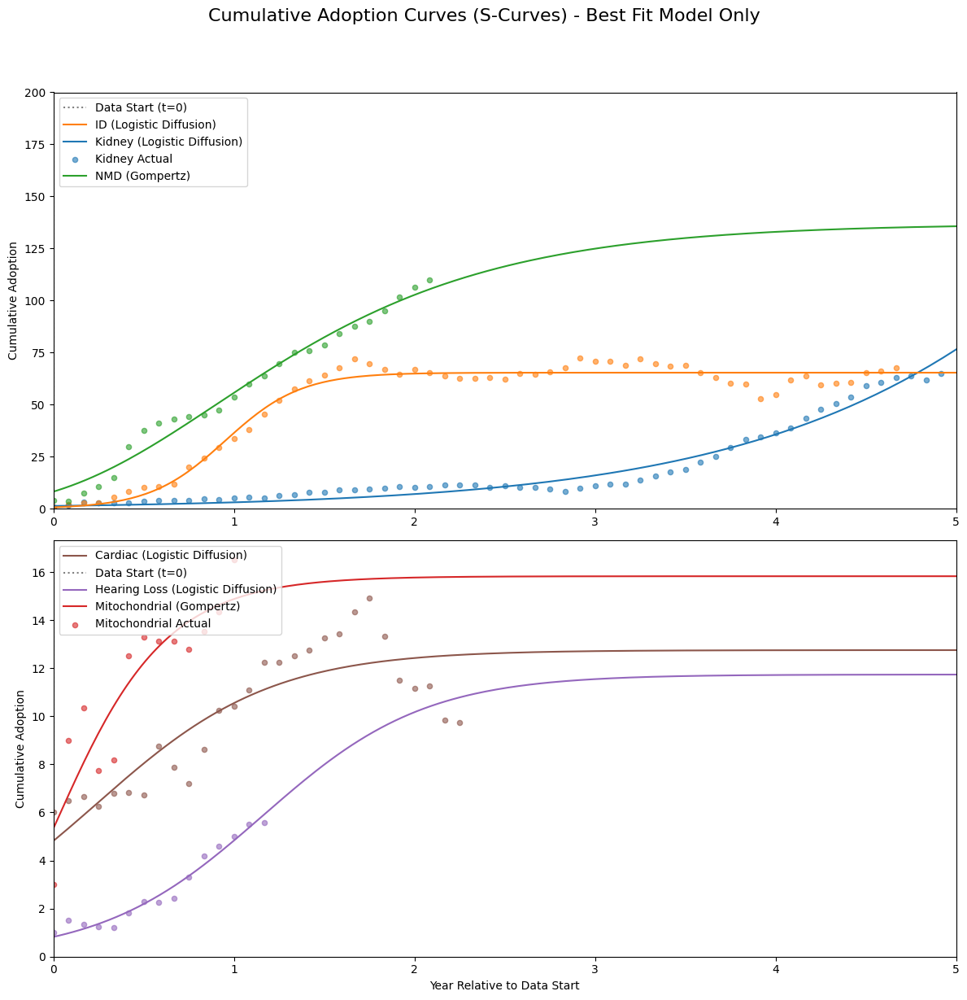

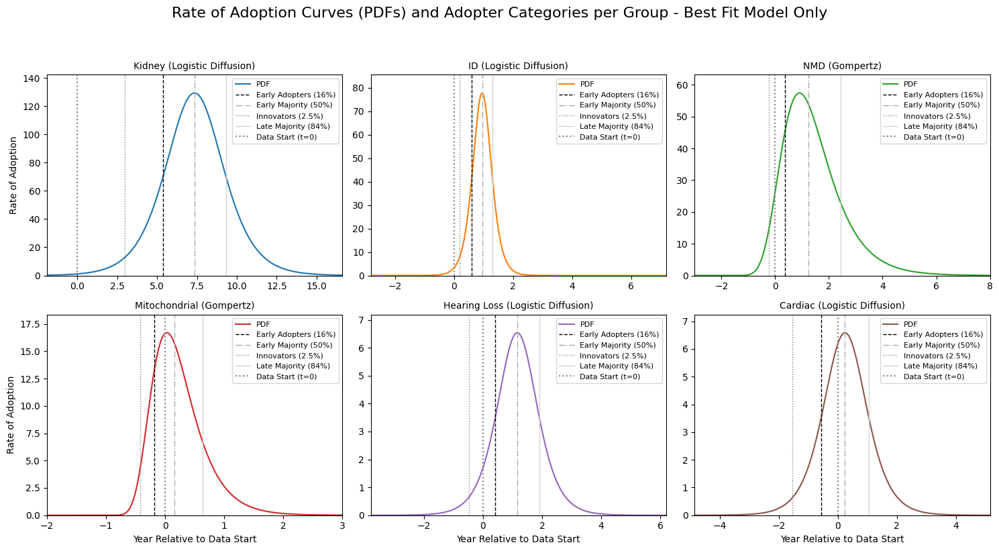

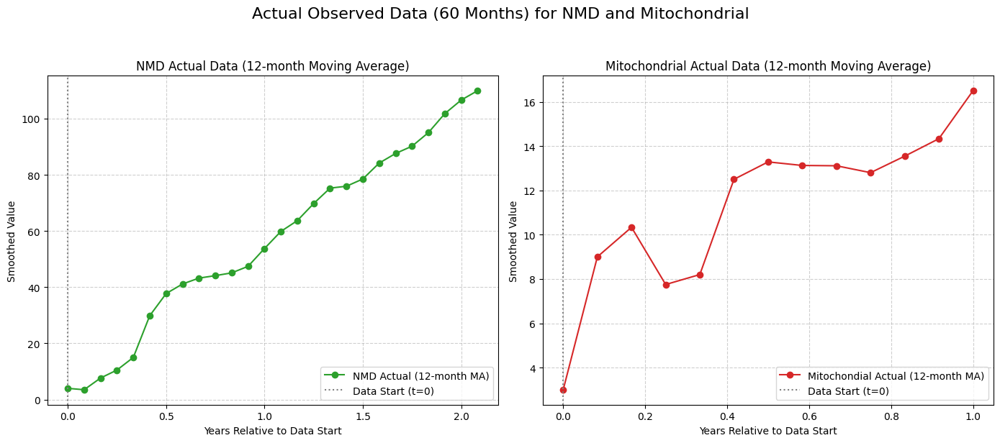


### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models
| Group         | Model              | R-squared   | MAE   | RMSE   | AIC    | BIC    |
|:--------------|:-------------------|:------------|:------|:-------|:-------|:-------|
| Kidney        | Logistic Diffusion | 0.9676      | 2.93  | 3.44   | 154.1  | 160.38 |
| Kidney        | Gompertz           | 0.9659      | 3.04  | 3.52   | 159.09 | 167.47 |
| Kidney        | Bass Diffusion     | 0.7821      | 7.81  | 8.9    | 270.38 | 278.75 |
| ID            | Logistic Diffusion | 0.9689      | 3.07  | 4.01   | 164.46 | 170.59 |
| ID            | Gompertz           | 0.9606      | 3.62  | 4.51   | 179.82 | 187.99 |
| ID            | Bass Diffusion     | -2.6666     | 37.09 | 43.56  | 438.25 | 446.42 |
| NMD           | Logistic Diffusion | 0.972       | 4.38  | 5.38   | 93.46  | 97.23  |
| NMD           | Gompertz           | 0.9804      | 3.76  | 4.5    | 86.2   | 91.24  |
| NMD           | Bass Diffusion     | 0.5929     

In [61]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=5)
    ax1_cdf.set_ylim(bottom=0, top=200) # **UPDATED Y-AXIS LIMIT HERE**
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=5)
    ax2_cdf.set_ylim(bottom=0) # No upper limit specified for this subplot
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves) - Best Fit Model Only", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (using only the best model) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group - Best Fit Model Only", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- Plots: Actual Data for NMD and Mitochondrial (from Iteration 2, kept for context) ---
    # Only plot if there's actual data for these specific groups
    nmd_bp = next((bp for bp in best_predictions if bp['Group'] == 'NMD'), None)
    mito_bp = next((bp for bp in best_predictions if bp['Group'] == 'Mitochondrial'), None)

    if nmd_bp or mito_bp:
        fig_actual, axes_actual = plt.subplots(nrows=1, ncols=2, figsize=(14, 6), sharey=False)
        axes_actual = axes_actual.flatten()

        # Plot NMD Actual Data
        if nmd_bp:
            ax = axes_actual[0]
            ax.plot(nmd_bp['ActualYears'], nmd_bp['Actual'], marker='o', linestyle='-', color=color_mapping['NMD'], label='NMD Actual (12-month MA)')
            ax.set_title(f"NMD Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[0]) # Remove subplot if no data

        # Plot Mitochondrial Actual Data
        if mito_bp:
            ax = axes_actual[1]
            ax.plot(mito_bp['ActualYears'], mito_bp['Actual'], marker='o', linestyle='-', color=color_mapping['Mitochondrial'], label='Mitochondial Actual (12-month MA)')
            ax.set_title(f"Mitochondrial Actual Data (12-month Moving Average)", fontsize=12)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend()
            ax.grid(True, linestyle='--', alpha=0.6)
        else:
            fig_actual.delaxes(axes_actual[1]) # Remove subplot if no data

        plt.suptitle("Actual Observed Data (60 Months) for NMD and Mitochondrial", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo actual data plots generated for NMD or Mitochondrial as data not available or fits failed.")


# --- Publication-Ready Tables ---
# Only print tables if there are results
if all_group_models_results:
    # 1. Goodness-of-Fit Metrics for All Models
    print("\n### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models")
    metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            metrics_data.append({
                'Group': group,
                'Model': model_name,
                'R-squared': f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A",
                'MAE': f"{results['MAE']:.2f}" if not np.isnan(results['MAE']) else "N/A",
                'RMSE': f"{results['RMSE']:.2f}" if not np.isnan(results['RMSE']) else "N/A",
                'AIC': f"{results['AIC']:.2f}" if not np.isnan(results['AIC']) else "N/A",
                'BIC': f"{results['BIC']:.2f}" if not np.isnan(results['BIC']) else "N/A",
            })

    metrics_df = pd.DataFrame(metrics_data)
    # Define order for the table
    metrics_col_order = ['Group', 'Model', 'R-squared', 'MAE', 'RMSE', 'AIC', 'BIC']
    metrics_df = metrics_df[metrics_col_order]
    print(metrics_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 2. Fitted Parameters for All Models
    print("\n### Table 2: Fitted Parameters of Diffusion Models and Their Interpretations")
    param_rows = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            if results['FittedParameters'] is None:
                continue
            
            row = {'Group': group, 'Model': model_name}
            
            # Initialize all parameter columns to NaN/empty string
            param_names = [
                'K (Market Potential)', 'r (Growth Rate)', 't0 (Time Offset)',
                'a (Asymptote)', 'b (Displacement)', 'c (Growth Rate)',
                'p (Innovation Coeff.)', 'q (Imitation Coeff.)', 'M (Market Potential)', 't_offset (Time Offset)'
            ]
            for p_name in param_names:
                row[p_name] = '' # Use empty string for better Markdown table rendering of NaNs
            
            if model_name == "Logistic Diffusion":
                K, r, t0 = results['FittedParameters']
                row['K (Market Potential)'] = f"{K:.2f}"
                row['r (Growth Rate)'] = f"{r:.4f}"
                row['t0 (Time Offset)'] = f"{t0:.2f}"

            elif model_name == "Gompertz":
                a, b, c, t_offset = results['FittedParameters']
                row['a (Asymptote)'] = f"{a:.2f}"
                row['b (Displacement)'] = f"{b:.4f}"
                row['c (Growth Rate)'] = f"{c:.4f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"

            elif model_name == "Bass Diffusion":
                p, q, M, t_offset = results['FittedParameters']
                row['p (Innovation Coeff.)'] = f"{p:.4f}"
                row['q (Imitation Coeff.)'] = f"{q:.4f}"
                row['M (Market Potential)'] = f"{M:.2f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"
            
            param_rows.append(row)

    param_df = pd.DataFrame(param_rows)
    # Define column order for better presentation
    param_col_order = ['Group', 'Model'] + param_names
    param_df = param_df[param_col_order]
    print(param_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 3. Adopter Category Timelines for All Models
    print("\n### Table 3: Adopter Category Timelines (Years Relative to Data Start) by Model")
    adopter_data_full = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {'Group': group, 'Model': model_name}
            for category in adopter_categories:
                time = results['AdopterTimes'].get(category)
                row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
            adopter_data_full.append(row)

    adopter_df_full = pd.DataFrame(adopter_data_full)
    print(adopter_df_full.to_markdown(index=False, numalign="left", stralign="left"))


    # 4. Key Inferred Metrics for All Models
    print("\n### Table 4: Key Inferred Metrics by Model")
    inferred_metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {
                'Group': group,
                'Model': model_name,
                'Market Potential': f"{results['MarketPotential']:.2f}" if not np.isnan(results['MarketPotential']) else "N/A",
                'Estimated Offset (Years)': f"{results['EstimatedOffset']:.2f}" if not np.isnan(results['EstimatedOffset']) else "N/A",
                'PDF Peak Value': f"{results['PDF_Peak_Value']:.2f}" if not np.isnan(results['PDF_Peak_Value']) else "N/A",
                'PDF Peak Time (Years)': f"{results['PDF_Peak_Time']:.2f}" if not np.isnan(results['PDF_Peak_Time']) else "N/A",
            }
            if model_name == "Bass Diffusion":
                row['Bass (p+q)'] = f"{results.get('p_plus_q', np.nan):.4f}" if not np.isnan(results.get('p_plus_q', np.nan)) else "N/A"
            else:
                row['Bass (p+q)'] = "N/A" # For non-Bass models
            inferred_metrics_data.append(row)

    inferred_metrics_df = pd.DataFrame(inferred_metrics_data)
    # Reorder columns for clarity
    inferred_metrics_col_order = ['Group', 'Model', 'Market Potential', 'Estimated Offset (Years)',
                                  'PDF Peak Value', 'PDF Peak Time (Years)', 'Bass (p+q)']
    inferred_metrics_df = inferred_metrics_df[inferred_metrics_col_order]
    print(inferred_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # --- New Tables ---

    # 5. Model Ranking by Group
    print("\n### Table 5: Model Ranking by Goodness-of-Fit Metric within Each Group")
    ranking_data = []
    metrics_to_rank = ['Rsquared', 'MAE', 'RMSE', 'AIC', 'BIC'] # Note: Rsquared is higher=better, others lower=better

    for group, models_results in all_group_models_results.items():
        group_df = pd.DataFrame([
            {'Model': m_name, 'Rsquared': m_res['Rsquared'], 'MAE': m_res['MAE'], 'RMSE': m_res['RMSE'], 'AIC': m_res['AIC'], 'BIC': m_res['BIC']}
            for m_name, m_res in models_results.items()
        ])
        
        # Drop rows where all metrics are NaN (failed fits)
        group_df = group_df.dropna(how='all', subset=metrics_to_rank)

        if not group_df.empty:
            row_dict = {'Group': group}
            for metric in metrics_to_rank:
                if metric == 'Rsquared':
                    # Rank in descending order for R-squared (higher is better)
                    ranked = group_df.sort_values(by=metric, ascending=False).reset_index(drop=True)
                else:
                    # Rank in ascending order for MAE, RMSE, AIC, BIC (lower is better)
                    ranked = group_df.sort_values(by=metric, ascending=True).reset_index(drop=True)
                
                # Get the model name for the top rank (index 0)
                if not ranked.empty:
                    row_dict[metric] = ranked['Model'][0]
                else:
                    row_dict[metric] = "N/A"
            ranking_data.append(row_dict)

    ranking_df = pd.DataFrame(ranking_data)
    print(ranking_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 6. Relative AIC and BIC
    print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) for Each Model (Lower is Better)")
    relative_metrics_data = []
    for group, models_results in all_group_models_results.items():
        min_aic = np.inf
        min_bic = np.inf
        
        # Find the minimum AIC/BIC among valid models for the current group
        for model_name, results in models_results.items():
            if not np.isnan(results['AIC']):
                min_aic = min(min_aic, results['AIC'])
            if not np.isnan(results['BIC']):
                min_bic = min(min_bic, results['BIC'])

        for model_name, results in models_results.items():
            delta_aic = results['AIC'] - min_aic if not np.isnan(results['AIC']) and min_aic != np.inf else np.nan
            delta_bic = results['BIC'] - min_bic if not np.isnan(results['BIC']) and min_bic != np.inf else np.nan
            
            relative_metrics_data.append({
                'Group': group,
                'Model': model_name,
                'ΔAIC': f"{delta_aic:.2f}" if not np.isnan(delta_aic) else "N/A",
                'ΔBIC': f"{delta_bic:.2f}" if not np.isnan(delta_bic) else "N/A",
            })
    
    relative_metrics_df = pd.DataFrame(relative_metrics_data)
    print(relative_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # 7. Bass Model Parameter Consistency
    print("\n### Table 7: Bass Diffusion Model Parameter Consistency (p and q)")
    bass_param_data = []
    for group, models_results in all_group_models_results.items():
        if "Bass Diffusion" in models_results and models_results["Bass Diffusion"]['FittedParameters'] is not None:
            bass_results = models_results["Bass Diffusion"]
            bass_param_data.append({
                'Group': group,
                'Model': "Bass Diffusion",
                'p_coeff': f"{bass_results.get('p_coeff', np.nan):.4f}" if not np.isnan(bass_results.get('p_coeff', np.nan)) else "N/A",
                'q_coeff': f"{bass_results.get('q_coeff', np.nan):.4f}" if not np.isnan(bass_results.get('q_coeff', np.nan)) else "N/A",
                'p_plus_q': f"{bass_results.get('p_plus_q', np.nan):.4f}" if not np.isnan(bass_results.get('p_plus_q', np.nan)) else "N/A",
                'R-squared': f"{bass_results['Rsquared']:.4f}" if not np.isnan(bass_results['Rsquared']) else "N/A",
            })
    
    bass_param_df = pd.DataFrame(bass_param_data)
    if not bass_param_df.empty:
        print(bass_param_df.to_markdown(index=False, numalign="left", stralign="left"))
    else:
        print("No valid Bass Diffusion model parameters to display.")


    # 8. Coefficient of Variation for Market Potential
    print("\n### Table 8: Coefficient of Variation (CV) for Market Potential Estimates by Group")
    cv_data = []
    for group, models_results in all_group_models_results.items():
        market_potentials = []
        for model_name, results in models_results.items():
            # Exclude specific Gompertz outliers as per previous analysis decision
            if model_name == "Gompertz" and group in ['Kidney', 'Hearing Loss']:
                continue
            if not np.isnan(results['MarketPotential']):
                market_potentials.append(results['MarketPotential'])
        
        if len(market_potentials) > 1: # Need at least two points to calculate CV
            cv = (np.std(market_potentials) / np.mean(market_potentials)) * 100
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': f"{cv:.2f}",
                'Models Included in CV': ", ".join([mn for mn in models_results.keys() if not (mn == "Gompertz" and group in ['Kidney', 'Hearing Loss']) and not np.isnan(models_results[mn]['MarketPotential'])])
            })
        elif len(market_potentials) == 1:
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': "N/A (Only one valid estimate)",
                'Models Included in CV': ", ".join([mn for mn in models_results.keys() if not (mn == "Gompertz" and group in ['Kidney', 'Hearing Loss']) and not np.isnan(models_results[mn]['MarketPotential'])])
            })
        else:
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': "N/A (No valid estimates)",
                'Models Included in CV': ""
            })
    
    cv_df = pd.DataFrame(cv_data)
    print(cv_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 9. Adopter Category Timelines for Best Fit Model Only
    print("\n### Table 9: Adopter Category Timelines (Years Relative to Data Start) for Best Fit Model")
    adopter_data_best_fit = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for bp in best_predictions:
        row = {'Group': bp['Group'], 'Best Fit Model': bp['BestModel']}
        for category in adopter_categories:
            time = bp['AdopterTimes'].get(category)
            row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
        adopter_data_best_fit.append(row)

    adopter_df_best_fit = pd.DataFrame(adopter_data_best_fit)
    print(adopter_df_best_fit.to_markdown(index=False, numalign="left", stralign="left"))

<>:673: SyntaxWarning: invalid escape sequence '\D'
<>:673: SyntaxWarning: invalid escape sequence '\D'
/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/3551529900.py:673: SyntaxWarning: invalid escape sequence '\D'
  print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) for Each Model (Lower is Better)")


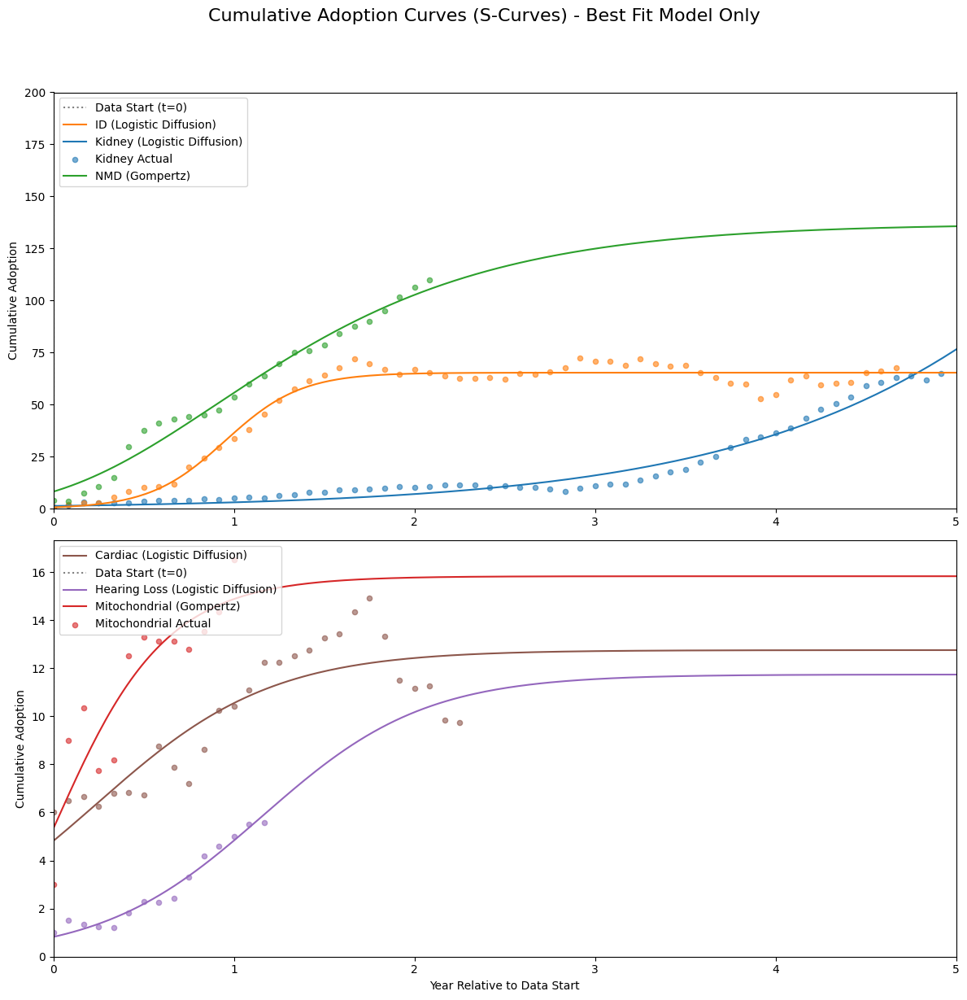

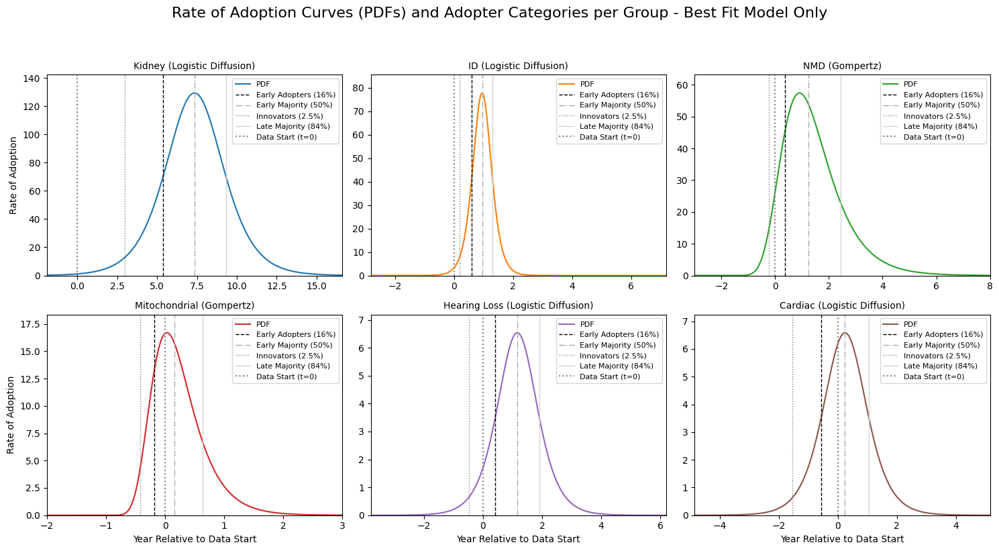

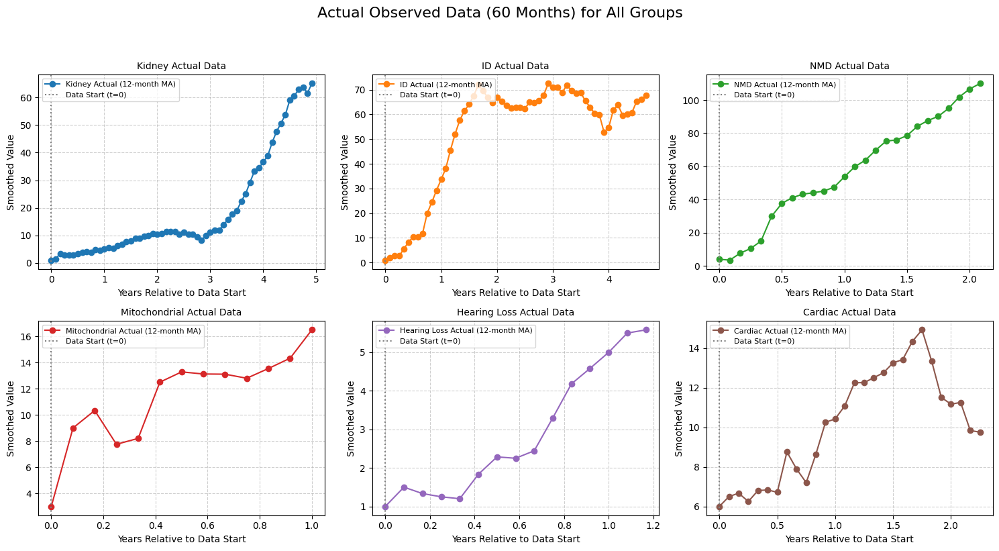


### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models
| Group         | Model              | R-squared   | MAE   | RMSE   | AIC    | BIC    |
|:--------------|:-------------------|:------------|:------|:-------|:-------|:-------|
| Kidney        | Logistic Diffusion | 0.9676      | 2.93  | 3.44   | 154.1  | 160.38 |
| Kidney        | Gompertz           | 0.9659      | 3.04  | 3.52   | 159.09 | 167.47 |
| Kidney        | Bass Diffusion     | 0.7821      | 7.81  | 8.9    | 270.38 | 278.75 |
| ID            | Logistic Diffusion | 0.9689      | 3.07  | 4.01   | 164.46 | 170.59 |
| ID            | Gompertz           | 0.9606      | 3.62  | 4.51   | 179.82 | 187.99 |
| ID            | Bass Diffusion     | -2.6666     | 37.09 | 43.56  | 438.25 | 446.42 |
| NMD           | Logistic Diffusion | 0.972       | 4.38  | 5.38   | 93.46  | 97.23  |
| NMD           | Gompertz           | 0.9804      | 3.76  | 4.5    | 86.2   | 91.24  |
| NMD           | Bass Diffusion     | 0.5929     

In [62]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=5)
    ax1_cdf.set_ylim(bottom=0, top=200) # **UPDATED Y-AXIS LIMIT HERE**
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=5)
    ax2_cdf.set_ylim(bottom=0) # No upper limit specified for this subplot
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves) - Best Fit Model Only", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (using only the best model) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group - Best Fit Model Only", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                            figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                            sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                    label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

            # Set consistent x-axis for all actual data plots if desired, or let them be individual
            # For now, let them be individual to show specific group data range if it varies significantly
            # ax.set_xlim(left=0, right=5) # Example: set a fixed x-range if all data is within it
            # ax.set_ylim(bottom=0) # Example: set a fixed y-range or dynamic based on max_actual

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")


# --- Publication-Ready Tables ---
# Only print tables if there are results
if all_group_models_results:
    # 1. Goodness-of-Fit Metrics for All Models
    print("\n### Table 1: Goodness-of-Fit Metrics for All Fitted Diffusion Models")
    metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            metrics_data.append({
                'Group': group,
                'Model': model_name,
                'R-squared': f"{results['Rsquared']:.4f}" if not np.isnan(results['Rsquared']) else "N/A",
                'MAE': f"{results['MAE']:.2f}" if not np.isnan(results['MAE']) else "N/A",
                'RMSE': f"{results['RMSE']:.2f}" if not np.isnan(results['RMSE']) else "N/A",
                'AIC': f"{results['AIC']:.2f}" if not np.isnan(results['AIC']) else "N/A",
                'BIC': f"{results['BIC']:.2f}" if not np.isnan(results['BIC']) else "N/A",
            })

    metrics_df = pd.DataFrame(metrics_data)
    # Define order for the table
    metrics_col_order = ['Group', 'Model', 'R-squared', 'MAE', 'RMSE', 'AIC', 'BIC']
    metrics_df = metrics_df[metrics_col_order]
    print(metrics_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 2. Fitted Parameters for All Models
    print("\n### Table 2: Fitted Parameters of Diffusion Models and Their Interpretations")
    param_rows = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            if results['FittedParameters'] is None:
                continue
            
            row = {'Group': group, 'Model': model_name}
            
            # Initialize all parameter columns to NaN/empty string
            param_names = [
                'K (Market Potential)', 'r (Growth Rate)', 't0 (Time Offset)',
                'a (Asymptote)', 'b (Displacement)', 'c (Growth Rate)',
                'p (Innovation Coeff.)', 'q (Imitation Coeff.)', 'M (Market Potential)', 't_offset (Time Offset)'
            ]
            for p_name in param_names:
                row[p_name] = '' # Use empty string for better Markdown table rendering of NaNs
            
            if model_name == "Logistic Diffusion":
                K, r, t0 = results['FittedParameters']
                row['K (Market Potential)'] = f"{K:.2f}"
                row['r (Growth Rate)'] = f"{r:.4f}"
                row['t0 (Time Offset)'] = f"{t0:.2f}"

            elif model_name == "Gompertz":
                a, b, c, t_offset = results['FittedParameters']
                row['a (Asymptote)'] = f"{a:.2f}"
                row['b (Displacement)'] = f"{b:.4f}"
                row['c (Growth Rate)'] = f"{c:.4f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"

            elif model_name == "Bass Diffusion":
                p, q, M, t_offset = results['FittedParameters']
                row['p (Innovation Coeff.)'] = f"{p:.4f}"
                row['q (Imitation Coeff.)'] = f"{q:.4f}"
                row['M (Market Potential)'] = f"{M:.2f}"
                row['t_offset (Time Offset)'] = f"{t_offset:.2f}"
            
            param_rows.append(row)

    param_df = pd.DataFrame(param_rows)
    # Define column order for better presentation
    param_col_order = ['Group', 'Model'] + param_names
    param_df = param_df[param_col_order]
    print(param_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 3. Adopter Category Timelines for All Models
    print("\n### Table 3: Adopter Category Timelines (Years Relative to Data Start) by Model")
    adopter_data_full = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {'Group': group, 'Model': model_name}
            for category in adopter_categories:
                time = results['AdopterTimes'].get(category)
                row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
            adopter_data_full.append(row)

    adopter_df_full = pd.DataFrame(adopter_data_full)
    print(adopter_df_full.to_markdown(index=False, numalign="left", stralign="left"))


    # 4. Key Inferred Metrics for All Models
    print("\n### Table 4: Key Inferred Metrics by Model")
    inferred_metrics_data = []
    for group, models_results in all_group_models_results.items():
        for model_name, results in models_results.items():
            row = {
                'Group': group,
                'Model': model_name,
                'Market Potential': f"{results['MarketPotential']:.2f}" if not np.isnan(results['MarketPotential']) else "N/A",
                'Estimated Offset (Years)': f"{results['EstimatedOffset']:.2f}" if not np.isnan(results['EstimatedOffset']) else "N/A",
                'PDF Peak Value': f"{results['PDF_Peak_Value']:.2f}" if not np.isnan(results['PDF_Peak_Value']) else "N/A",
                'PDF Peak Time (Years)': f"{results['PDF_Peak_Time']:.2f}" if not np.isnan(results['PDF_Peak_Time']) else "N/A",
            }
            if model_name == "Bass Diffusion":
                row['Bass (p+q)'] = f"{results.get('p_plus_q', np.nan):.4f}" if not np.isnan(results.get('p_plus_q', np.nan)) else "N/A"
            else:
                row['Bass (p+q)'] = "N/A" # For non-Bass models
            inferred_metrics_data.append(row)

    inferred_metrics_df = pd.DataFrame(inferred_metrics_data)
    # Reorder columns for clarity
    inferred_metrics_col_order = ['Group', 'Model', 'Market Potential', 'Estimated Offset (Years)',
                                  'PDF Peak Value', 'PDF Peak Time (Years)', 'Bass (p+q)']
    inferred_metrics_df = inferred_metrics_df[inferred_metrics_col_order]
    print(inferred_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # --- New Tables ---

    # 5. Model Ranking by Group
    print("\n### Table 5: Model Ranking by Goodness-of-Fit Metric within Each Group")
    ranking_data = []
    metrics_to_rank = ['Rsquared', 'MAE', 'RMSE', 'AIC', 'BIC'] # Note: Rsquared is higher=better, others lower=better

    for group, models_results in all_group_models_results.items():
        group_df = pd.DataFrame([
            {'Model': m_name, 'Rsquared': m_res['Rsquared'], 'MAE': m_res['MAE'], 'RMSE': m_res['RMSE'], 'AIC': m_res['AIC'], 'BIC': m_res['BIC']}
            for m_name, m_res in models_results.items()
        ])
        
        # Drop rows where all metrics are NaN (failed fits)
        group_df = group_df.dropna(how='all', subset=metrics_to_rank)

        if not group_df.empty:
            row_dict = {'Group': group}
            for metric in metrics_to_rank:
                if metric == 'Rsquared':
                    # Rank in descending order for R-squared (higher is better)
                    ranked = group_df.sort_values(by=metric, ascending=False).reset_index(drop=True)
                else:
                    # Rank in ascending order for MAE, RMSE, AIC, BIC (lower is better)
                    ranked = group_df.sort_values(by=metric, ascending=True).reset_index(drop=True)
                
                # Get the model name for the top rank (index 0)
                if not ranked.empty:
                    row_dict[metric] = ranked['Model'][0]
                else:
                    row_dict[metric] = "N/A"
            ranking_data.append(row_dict)

    ranking_df = pd.DataFrame(ranking_data)
    print(ranking_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 6. Relative AIC and BIC
    print("\n### Table 6: Relative AIC ($\Delta$AIC) and BIC ($\Delta$BIC) for Each Model (Lower is Better)")
    relative_metrics_data = []
    for group, models_results in all_group_models_results.items():
        min_aic = np.inf
        min_bic = np.inf
        
        # Find the minimum AIC/BIC among valid models for the current group
        for model_name, results in models_results.items():
            if not np.isnan(results['AIC']):
                min_aic = min(min_aic, results['AIC'])
            if not np.isnan(results['BIC']):
                min_bic = min(min_bic, results['BIC'])

        for model_name, results in models_results.items():
            delta_aic = results['AIC'] - min_aic if not np.isnan(results['AIC']) and min_aic != np.inf else np.nan
            delta_bic = results['BIC'] - min_bic if not np.isnan(results['BIC']) and min_bic != np.inf else np.nan
            
            relative_metrics_data.append({
                'Group': group,
                'Model': model_name,
                'ΔAIC': f"{delta_aic:.2f}" if not np.isnan(delta_aic) else "N/A",
                'ΔBIC': f"{delta_bic:.2f}" if not np.isnan(delta_bic) else "N/A",
            })
    
    relative_metrics_df = pd.DataFrame(relative_metrics_data)
    print(relative_metrics_df.to_markdown(index=False, numalign="left", stralign="left"))

    # 7. Bass Model Parameter Consistency
    print("\n### Table 7: Bass Diffusion Model Parameter Consistency (p and q)")
    bass_param_data = []
    for group, models_results in all_group_models_results.items():
        if "Bass Diffusion" in models_results and models_results["Bass Diffusion"]['FittedParameters'] is not None:
            bass_results = models_results["Bass Diffusion"]
            bass_param_data.append({
                'Group': group,
                'Model': "Bass Diffusion",
                'p_coeff': f"{bass_results.get('p_coeff', np.nan):.4f}" if not np.isnan(bass_results.get('p_coeff', np.nan)) else "N/A",
                'q_coeff': f"{bass_results.get('q_coeff', np.nan):.4f}" if not np.isnan(bass_results.get('q_coeff', np.nan)) else "N/A",
                'p_plus_q': f"{bass_results.get('p_plus_q', np.nan):.4f}" if not np.isnan(bass_results.get('p_plus_q', np.nan)) else "N/A",
                'R-squared': f"{bass_results['Rsquared']:.4f}" if not np.isnan(bass_results['Rsquared']) else "N/A",
            })
    
    bass_param_df = pd.DataFrame(bass_param_data)
    if not bass_param_df.empty:
        print(bass_param_df.to_markdown(index=False, numalign="left", stralign="left"))
    else:
        print("No valid Bass Diffusion model parameters to display.")


    # 8. Coefficient of Variation for Market Potential
    print("\n### Table 8: Coefficient of Variation (CV) for Market Potential Estimates by Group")
    cv_data = []
    for group, models_results in all_group_models_results.items():
        market_potentials = []
        for model_name, results in models_results.items():
            # Exclude specific Gompertz outliers as per previous analysis decision
            if model_name == "Gompertz" and group in ['Kidney', 'Hearing Loss']:
                continue
            if not np.isnan(results['MarketPotential']):
                market_potentials.append(results['MarketPotential'])
        
        if len(market_potentials) > 1: # Need at least two points to calculate CV
            cv = (np.std(market_potentials) / np.mean(market_potentials)) * 100
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': f"{cv:.2f}",
                'Models Included in CV': ", ".join([mn for mn in models_results.keys() if not (mn == "Gompertz" and group in ['Kidney', 'Hearing Loss']) and not np.isnan(models_results[mn]['MarketPotential'])])
            })
        elif len(market_potentials) == 1:
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': "N/A (Only one valid estimate)",
                'Models Included in CV': ", ".join([mn for mn in models_results.keys() if not (mn == "Gompertz" and group in ['Kidney', 'Hearing Loss']) and not np.isnan(models_results[mn]['MarketPotential'])])
            })
        else:
            cv_data.append({
                'Group': group,
                'CV of Market Potential (%)': "N/A (No valid estimates)",
                'Models Included in CV': ""
            })
    
    cv_df = pd.DataFrame(cv_data)
    print(cv_df.to_markdown(index=False, numalign="left", stralign="left"))


    # 9. Adopter Category Timelines for Best Fit Model Only
    print("\n### Table 9: Adopter Category Timelines (Years Relative to Data Start) for Best Fit Model")
    adopter_data_best_fit = []
    adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']

    for bp in best_predictions:
        row = {'Group': bp['Group'], 'Best Fit Model': bp['BestModel']}
        for category in adopter_categories:
            time = bp['AdopterTimes'].get(category)
            row[category] = f"{time:.2f}" if time is not None and not np.isnan(time) else "N/A"
        adopter_data_best_fit.append(row)

    adopter_df_best_fit = pd.DataFrame(adopter_data_best_fit)
    print(adopter_df_best_fit.to_markdown(index=False, numalign="left", stralign="left"))

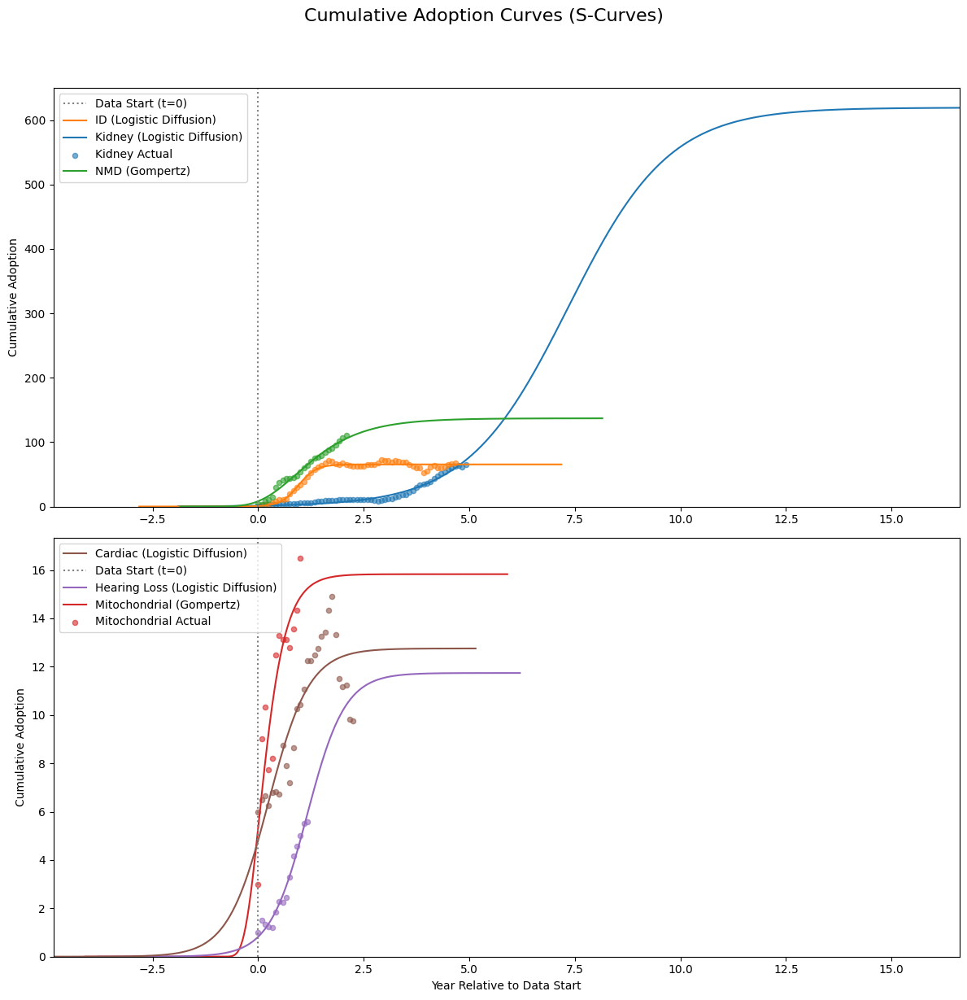

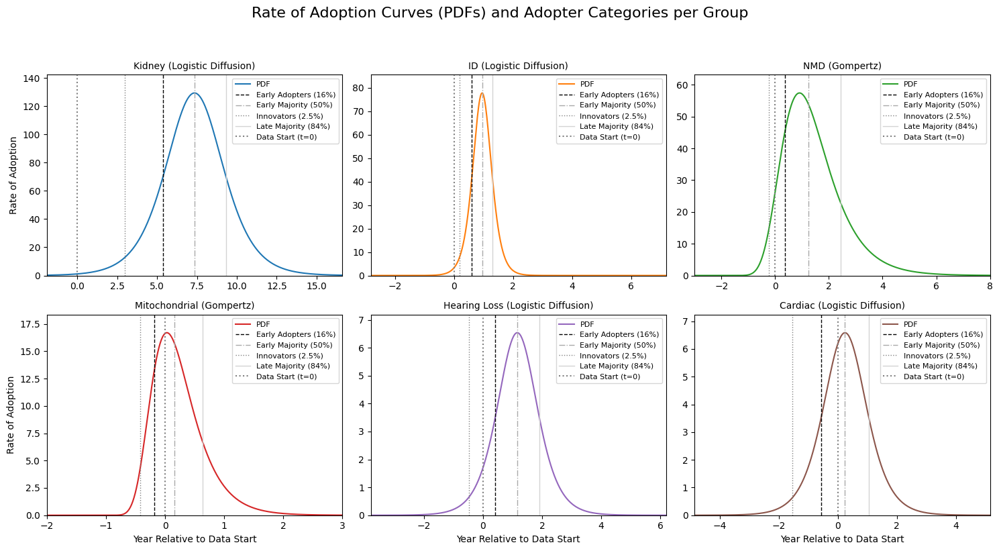

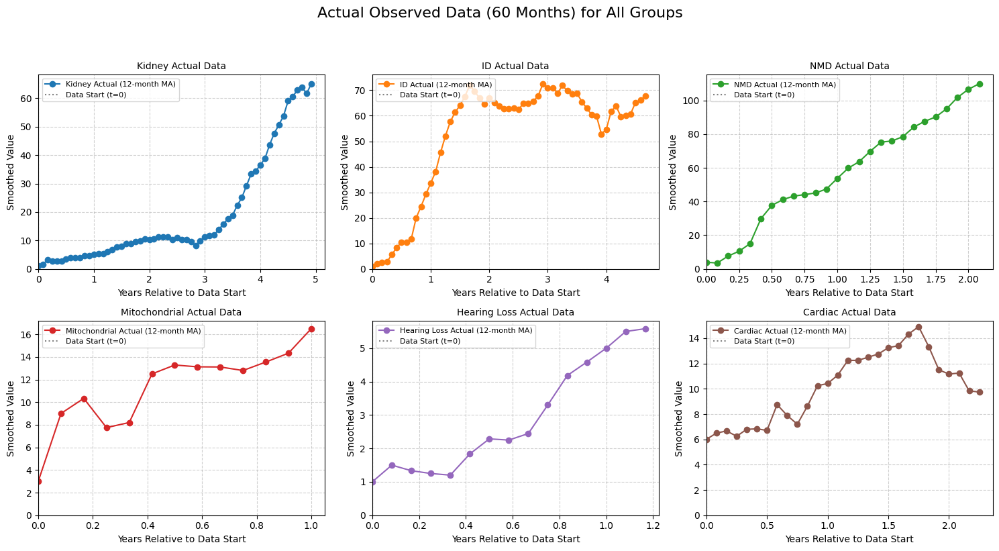

In [64]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    all_cdf_min_x = min(bp['CDF_Years'][0] for bp in best_predictions)
    all_cdf_max_x = max(bp['CDF_Years'][-1] for bp in best_predictions)


    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
    ax1_cdf.set_ylim(bottom=0)
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=all_cdf_min_x, right=all_cdf_max_x) 
    ax2_cdf.set_ylim(bottom=0)
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label] # Corrected line
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                            figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                            sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                    label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

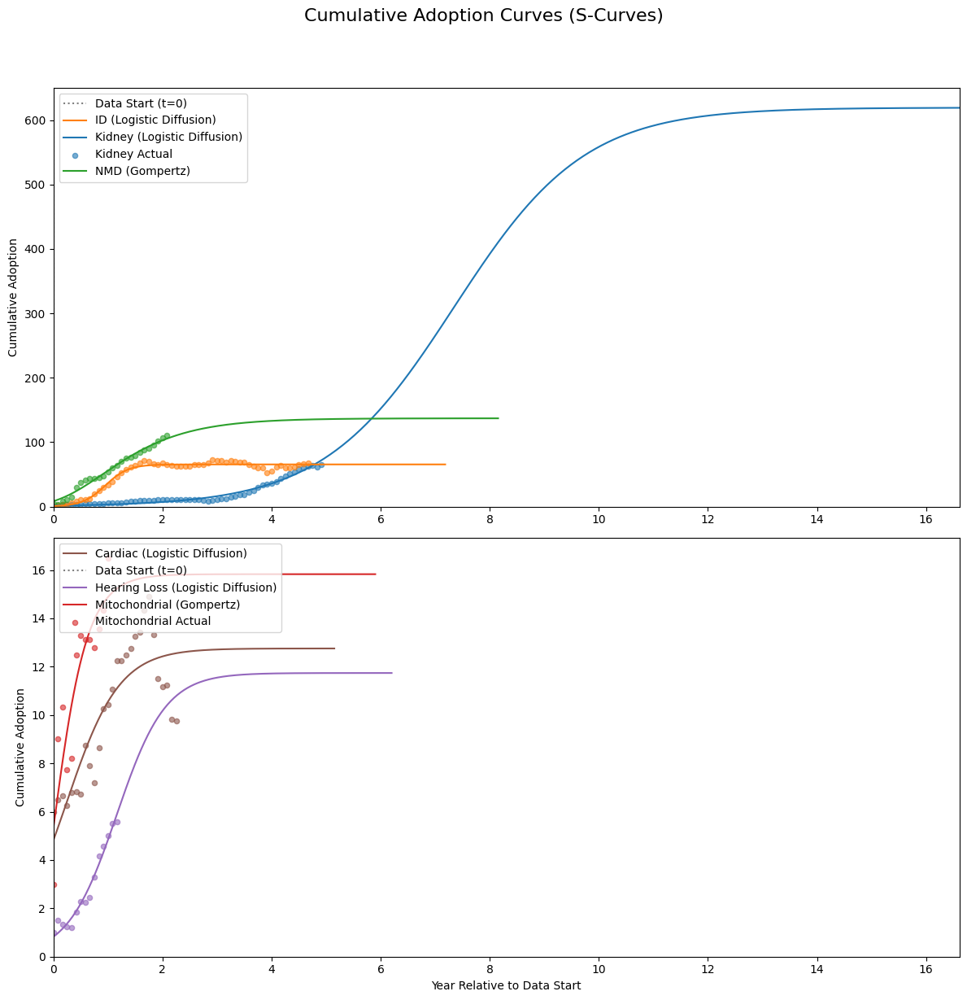

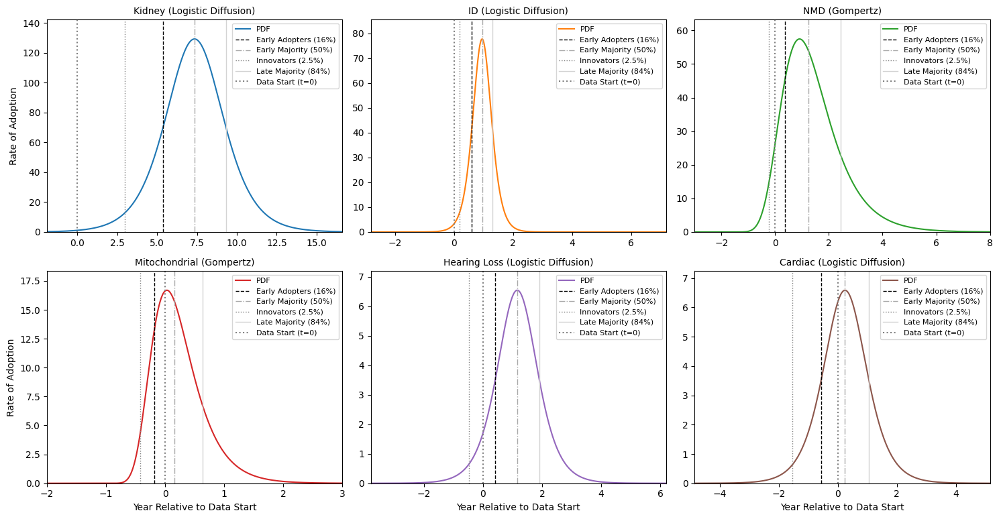

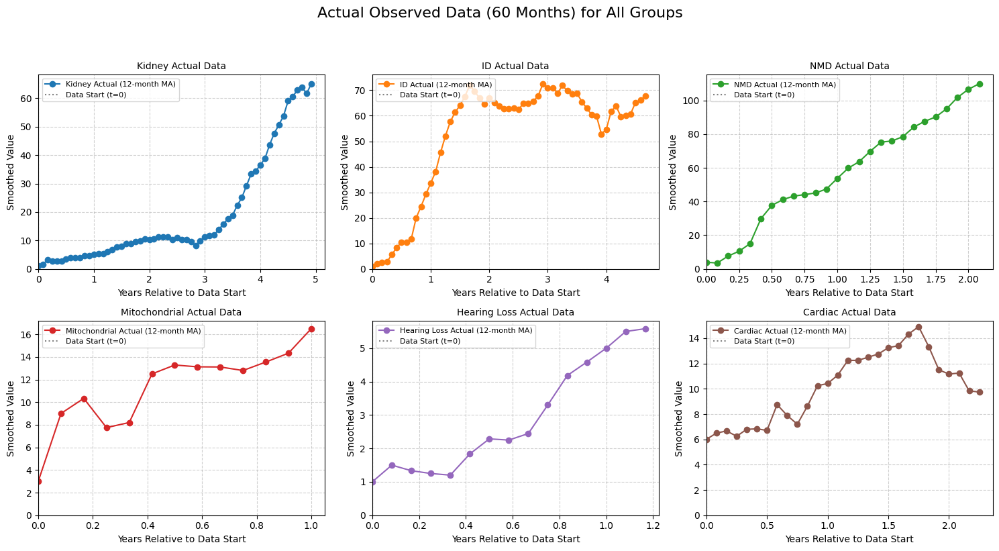


                       Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Fitted Parameters and Adopter Times:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤═══════════════════════════════════════════════════════════════════════════════════════════════════════════════════════╕
│ Mode

In [76]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges (for the final best-model plot, but calculated for all for consistency) ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            if group == 'NMD':
                pdf_plot_start_year = -3.0
                pdf_plot_end_year = 8.0
                num_pdf_points = 500 
            elif group == 'Mitochondrial':
                pdf_plot_start_year = -2.0
                pdf_plot_end_year = 3.0
                num_pdf_points = 500 
            
            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label] 
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

#        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                            figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                            sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                    label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                       Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)", "Adopter Times"]
    params_data = []
    for model_name, res in models_results.items():
        market_potential_val = f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A'
        estimated_offset_val = f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        
        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        adopter_times_display = adopter_times_str if adopter_times_str else 'N/A'

        row = [model_name, market_potential_val, estimated_offset_val, adopter_times_display]
        
        # Add model-specific parameters to the row, ensuring consistent order
        if model_name == "Logistic Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"K={res['FittedParameters'][0]:.2f}", f"r={res['FittedParameters'][1]:.2f}", f"t0={res['FittedParameters'][2]:.2f}"])
            if "K" not in params_headers: params_headers.extend(["K", "r", "t0"]) # Add headers if not present
        elif model_name == "Gompertz" and res['FittedParameters'] is not None:
            row.extend([f"a={res['FittedParameters'][0]:.2f}", f"b={res['FittedParameters'][1]:.2f}", f"c={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}"])
            if "a" not in params_headers: params_headers.extend(["a", "b", "c", "t_offset"])
        elif model_name == "Bass Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"p={res['FittedParameters'][0]:.4f}", f"q={res['FittedParameters'][1]:.4f}", f"M={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}", f"p+q={res['p_plus_q']:.4f}"])
            if "p" not in params_headers: params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

        params_data.append(row)
    
    # Dynamically adjust headers and data to ensure all model-specific parameters are shown if they exist
    # Create a superset of all possible headers that appeared
    all_current_headers = []
    for row in params_data:
        if len(row) > len(params_headers): # If a row has more elements than initial headers, these are new params
            new_param_headers = [f"Param{i+1}" for i in range(len(params_headers), len(row))] # Placeholder
            for i, val in enumerate(row[len(params_headers):]):
                if "=" in val:
                    key = val.split("=")[0]
                    new_param_headers[i] = key
            all_current_headers.extend(new_param_headers)
    
    unique_all_current_headers = []
    [unique_all_current_headers.append(x) for x in all_current_headers if x not in unique_all_current_headers] # Deduplicate

    # Reconstruct params_headers to include all relevant parameters in a structured way
    final_params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers in a preferred order
    if any("K=" in item for row in params_data for item in row): final_params_headers.extend(["K", "r", "t0"])
    if any("a=" in item for row in params_data for item in row): final_params_headers.extend(["a", "b", "c", "t_offset"])
    if any("p=" in item for row in params_data for item in row): final_params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

    final_params_headers = [h for h in final_params_headers if h in unique_all_current_headers or h in ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]]
    final_params_headers.append("Adopter Times")
    
    # Reconstruct data rows to match the final_params_headers structure
    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the ordered list for tabulate
        formatted_row = [current_row_data.get(header, 'N/A') for header in final_params_headers]
        formatted_params_data.append(formatted_row)

    print("\nFitted Parameters and Adopter Times:")
    print(tabulate(formatted_params_data, headers=final_params_headers, tablefmt="fancy_grid"))
    
    print("\n" + "-"*40 + "\n")

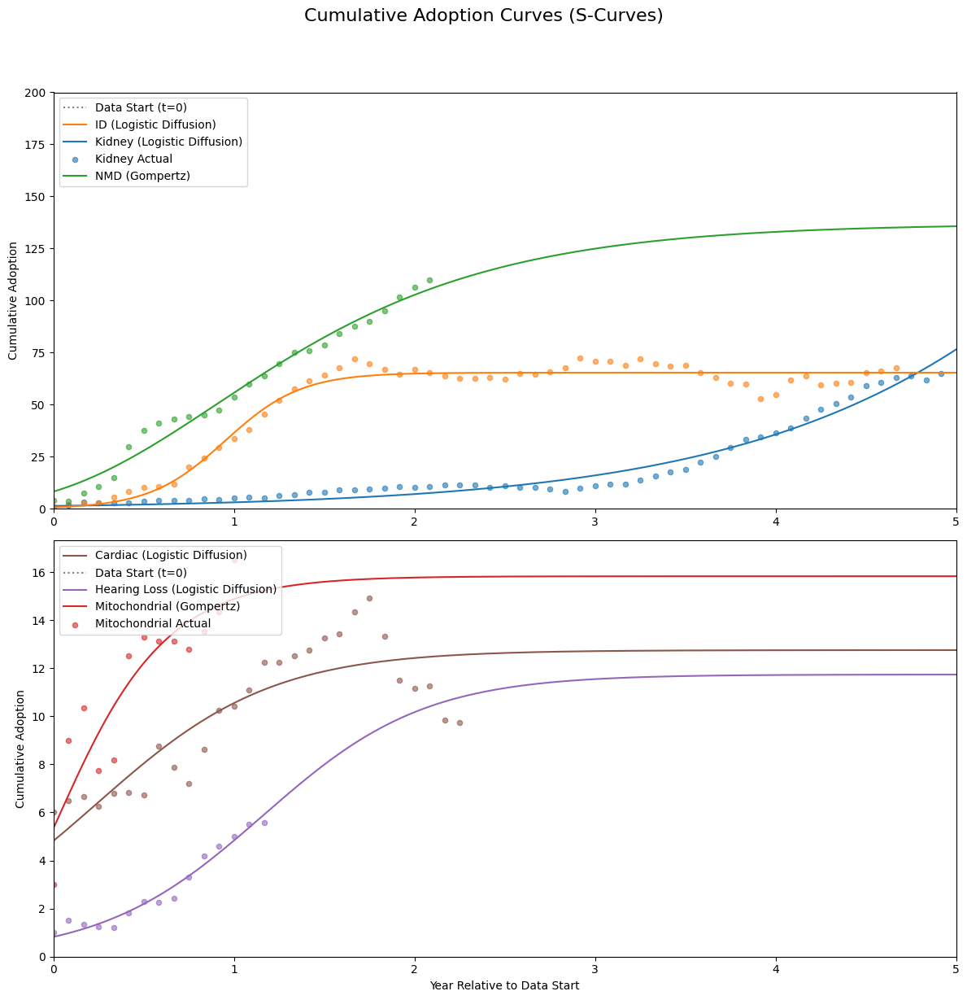

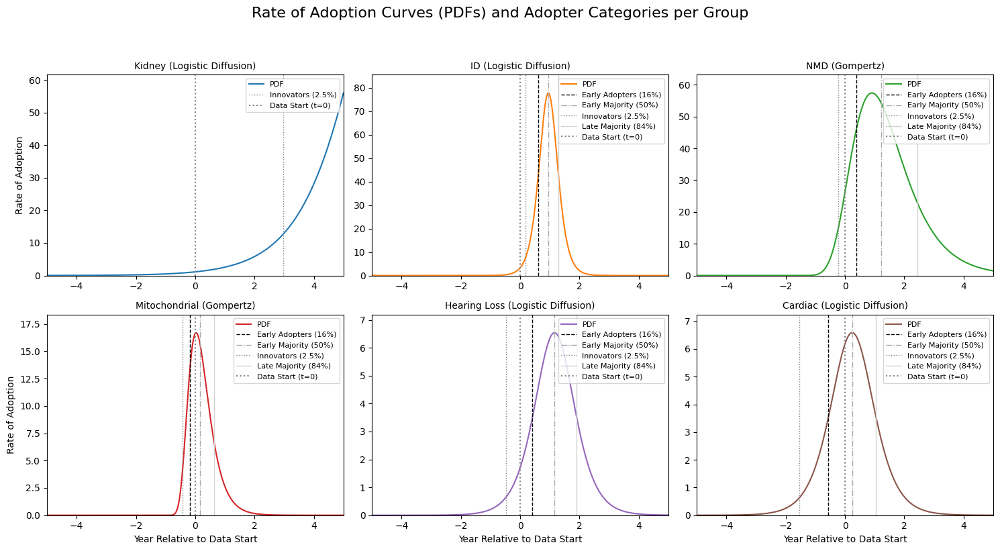

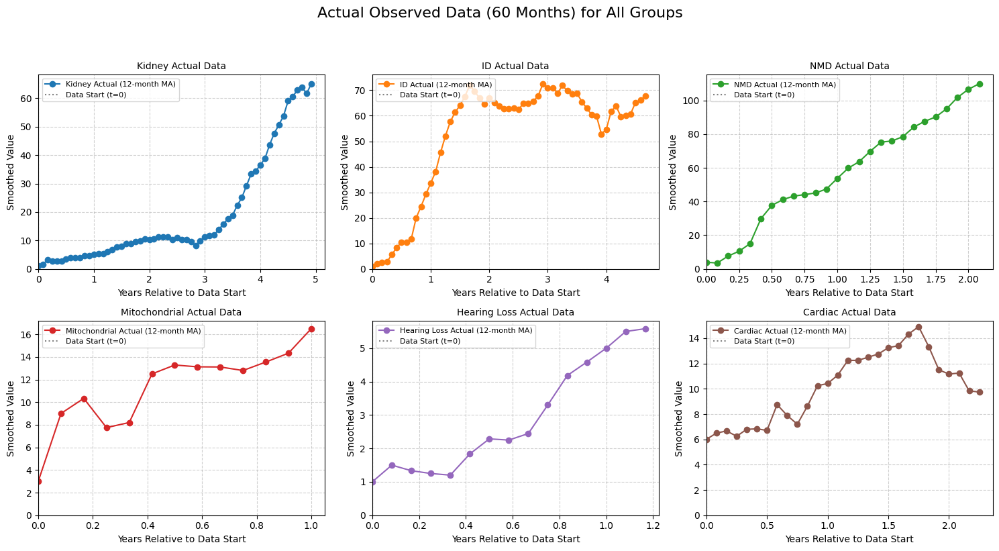


                       Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Fitted Parameters and Adopter Times:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤════════╤══════╤═══════════════╤═════════════╤═══════╤══════╤═══════════════╤════════╤════════╤═══════╤═══════════╤════════╤═══

In [72]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges for internal calculation of adopter times, etc.
            # Not directly used for the final plot limits as per new requirement
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            full_years_cdf = np.linspace(min(fitted_years.min(), -5.0), 5.0, 500) # Use 5 years as the max for CDF plots
            full_years_pdf = np.linspace(min(fitted_years.min(), -5.0), 5.0, 500) # Use 5 years as the max for PDF plots


            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            # Pass the full_years_cdf and full_years_pdf calculated with the 5-year limit
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    # FIXED X and Y axis limits for the first plot
    ax1_cdf.set_xlim(left=0, right=5.0)
    ax1_cdf.set_ylim(bottom=0, top=200) 
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    # FIXED X axis limit, Y axis lower limit, but adaptive Y-axis upper limit
    ax2_cdf.set_xlim(left=0, right=5.0)
    ax2_cdf.set_ylim(bottom=0) 
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label] 
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                            figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                            sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                    label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                       Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    # Start with common headers
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers if any model uses them in this group
    has_logistic = any(m == "Logistic Diffusion" for m in models_results.keys())
    has_gompertz = any(m == "Gompertz" for m in models_results.keys())
    has_bass = any(m == "Bass Diffusion" for m in models_results.keys())

    if has_logistic:
        params_headers.extend(["K", "r", "t0_logistic"]) # Use specific t0 for clarity
    if has_gompertz:
        params_headers.extend(["a", "b", "c", "t0_gompertz"]) # Use specific t0 for clarity
    if has_bass:
        params_headers.extend(["p", "q", "M", "t0_bass", "p+q"]) # Use specific t0 for clarity
    
    params_headers.append("Adopter Times") # Add Adopter Times at the end

    params_data = []
    for model_name, res in models_results.items():
        row_dict = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                row_dict["K"] = f"{res['FittedParameters'][0]:.2f}"
                row_dict["r"] = f"{res['FittedParameters'][1]:.2f}"
                row_dict["t0_logistic"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                row_dict["a"] = f"{res['FittedParameters'][0]:.2f}"
                row_dict["b"] = f"{res['FittedParameters'][1]:.2f}"
                row_dict["c"] = f"{res['FittedParameters'][2]:.2f}"
                row_dict["t0_gompertz"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                row_dict["p"] = f"{res['FittedParameters'][0]:.4f}"
                row_dict["q"] = f"{res['FittedParameters'][1]:.4f}"
                row_dict["M"] = f"{res['FittedParameters'][2]:.2f}"
                row_dict["t0_bass"] = f"{res['FittedParameters'][3]:.2f}"
                row_dict["p+q"] = f"{res['p_plus_q']:.4f}"
        
        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        row_dict["Adopter Times"] = adopter_times_str if adopter_times_str else 'N/A'
        
        # Ensure the row has values for all determined headers, filling 'N/A' for missing ones
        row = [row_dict.get(header, 'N/A') for header in params_headers]
        params_data.append(row)

    print("\nFitted Parameters and Adopter Times:")
    print(tabulate(params_data, headers=params_headers, tablefmt="fancy_grid"))
    
    print("\n" + "-"*40 + "\n")

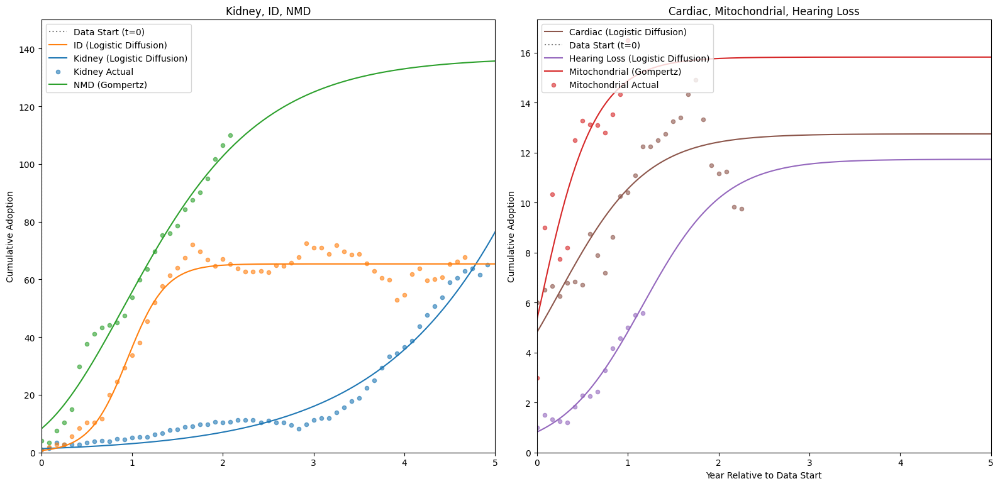

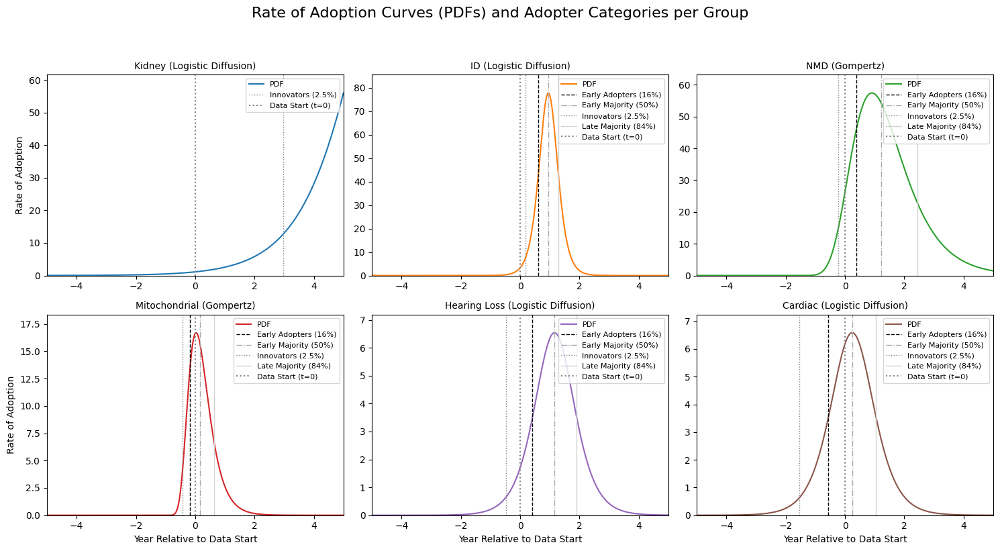

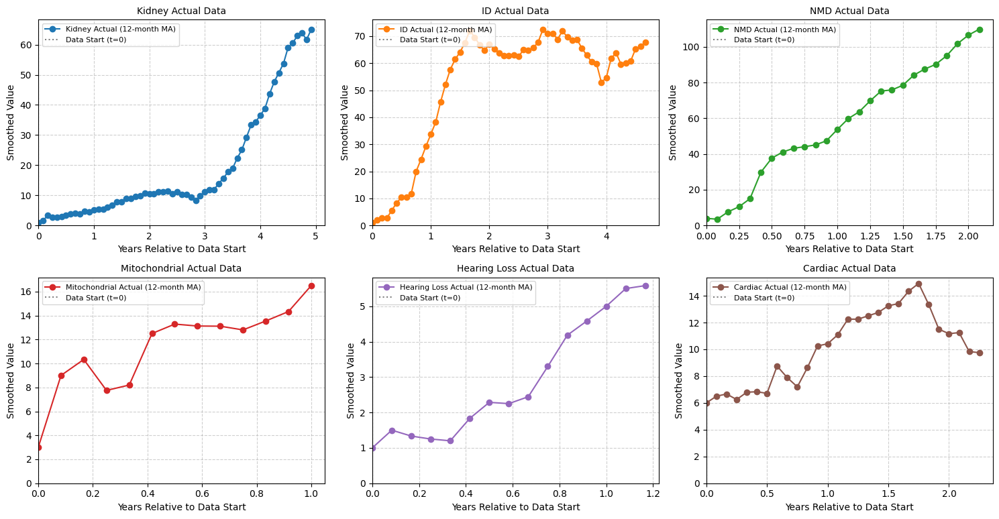


                       Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Fitted Parameters and Adopter Times:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤════════╤══════╤═══════════════╤═════════════╤═══════╤══════╤═══════════════╤════════╤════════╤═══════╤═══════════╤════════╤═══

In [75]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))

    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10

    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2

    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.

    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.

    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }

    adopter_times = {}

    cumulative_adoption_values = cdf_func(years_range, *params)

    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential

        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue

        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)

        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None

    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = []

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data

    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }

    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()

    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)

            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)

            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges for internal calculation of adopter times, etc.
            # Not directly used for the final plot limits as per new requirement
            temp_wide_years = np.linspace(-100.0, 200.0, 1000)
            full_years_cdf = np.linspace(min(fitted_years.min(), -5.0), 5.0, 500) # Use 5 years as the max for CDF plots
            full_years_pdf = np.linspace(min(fitted_years.min(), -5.0), 5.0, 500) # Use 5 years as the max for PDF plots


            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)

            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf,
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf,
                'PDF_Predicted': pred_full_pdf
            }

            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }

    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name

    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            # Pass the full_years_cdf and full_years_pdf calculated with the 5-year limit
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    # Change to 1 row, 2 columns for subplots
    fig_cdf, axes_cdf = plt.subplots(nrows=1, ncols=2, figsize=(16, 8), sharex=False)

    # Plot in subplot 1 (axes_cdf[0]): Kidney, ID, NMD
    ax1_cdf = axes_cdf[0]
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_")
    ax1_cdf.set_ylabel("Cumulative Adoption")
    # FIXED X and Y axis limits for the first plot
    ax1_cdf.set_xlim(left=0, right=5.0)
    ax1_cdf.set_ylim(bottom=0, top=150) # Changed to 150 as requested
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')
    ax1_cdf.set_title("Kidney, ID, NMD") # Add title for clarity


    # Plot in subplot 2 (axes_cdf[1]): Cardiac, Mitochondrial, Hearing Loss
    ax2_cdf = axes_cdf[1]
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                 label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_")
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    # FIXED X axis limit, Y axis lower limit, but adaptive Y-axis upper limit
    ax2_cdf.set_xlim(left=0, right=5.0)
    ax2_cdf.set_ylim(bottom=0)
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf)
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')
    ax2_cdf.set_title("Cardiac, Mitochondrial, Hearing Loss") # Add title for clarity

#    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False)
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]

            ax.plot(bp['PDF_Years'], bp['PDF_Predicted'], label=f"PDF", color=color)

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None:
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])

            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)

            max_pdf_val = np.max(bp['PDF_Predicted'])
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5:
                     ax.set_ylim(bottom=0, top=max_pdf_val * 2.0)
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1)
            else:
                ax.set_ylim(bottom=0, top=1.0)

            ax.set_xlim(left=min(bp['PDF_Years']), right=max(bp['PDF_Years']))

            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")

            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()

            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label]

            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual,
                                                            figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                            sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]

            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color,
                    label=f"{bp['Group']} Actual (12-month MA)")

            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

#        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                       Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")

    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])

    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    # Start with common headers
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]

    # Add model-specific headers if any model uses them in this group
    has_logistic = any(m == "Logistic Diffusion" for m in models_results.keys())
    has_gompertz = any(m == "Gompertz" for m in models_results.keys())
    has_bass = any(m == "Bass Diffusion" for m in models_results.keys())

    if has_logistic:
        params_headers.extend(["K", "r", "t0_logistic"]) # Use specific t0 for clarity
    if has_gompertz:
        params_headers.extend(["a", "b", "c", "t0_gompertz"]) # Use specific t0 for clarity
    if has_bass:
        params_headers.extend(["p", "q", "M", "t0_bass", "p+q"]) # Use specific t0 for clarity

    params_headers.append("Adopter Times") # Add Adopter Times at the end

    params_data = []
    for model_name, res in models_results.items():
        row_dict = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
        }

        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                row_dict["K"] = f"{res['FittedParameters'][0]:.2f}"
                row_dict["r"] = f"{res['FittedParameters'][1]:.2f}"
                row_dict["t0_logistic"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                row_dict["a"] = f"{res['FittedParameters'][0]:.2f}"
                row_dict["b"] = f"{res['FittedParameters'][1]:.2f}"
                row_dict["c"] = f"{res['FittedParameters'][2]:.2f}"
                row_dict["t0_gompertz"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                row_dict["p"] = f"{res['FittedParameters'][0]:.4f}"
                row_dict["q"] = f"{res['FittedParameters'][1]:.4f}"
                row_dict["M"] = f"{res['FittedParameters'][2]:.2f}"
                row_dict["t0_bass"] = f"{res['FittedParameters'][3]:.2f}"
                row_dict["p+q"] = f"{res['p_plus_q']:.4f}"

        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        row_dict["Adopter Times"] = adopter_times_str if adopter_times_str else 'N/A'

        # Ensure the row has values for all determined headers, filling 'N/A' for missing ones
        row = [row_dict.get(header, 'N/A') for header in params_headers]
        params_data.append(row)

    print("\nFitted Parameters and Adopter Times:")
    print(tabulate(params_data, headers=params_headers, tablefmt="fancy_grid"))

    print("\n" + "-"*40 + "\n")

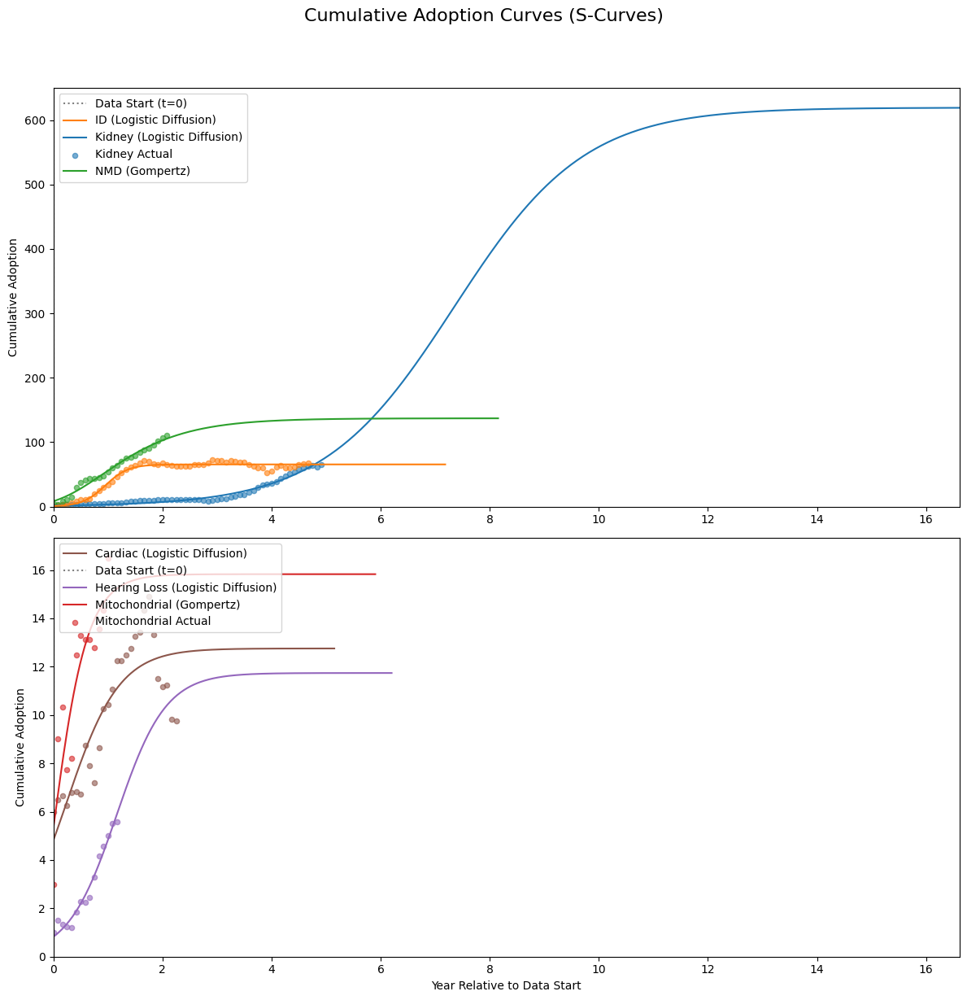

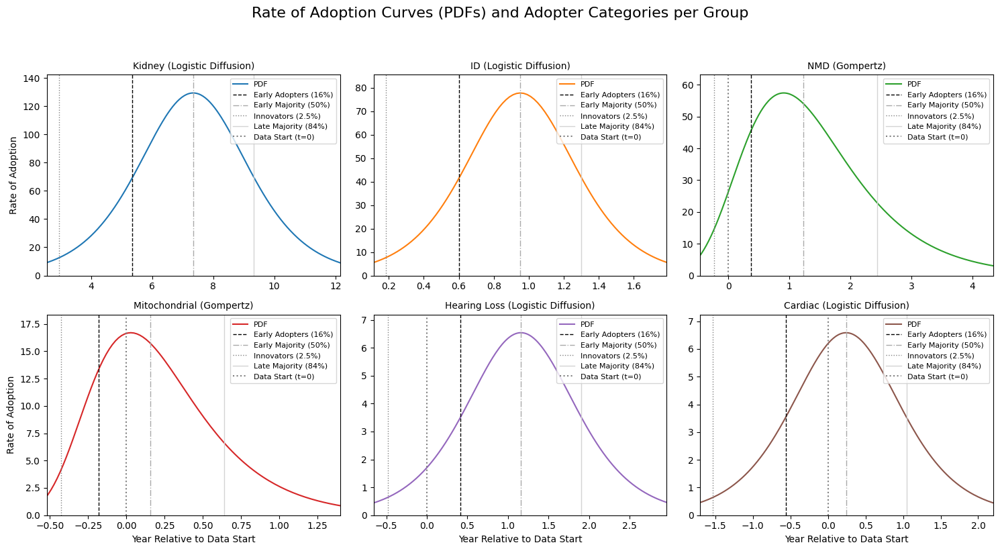

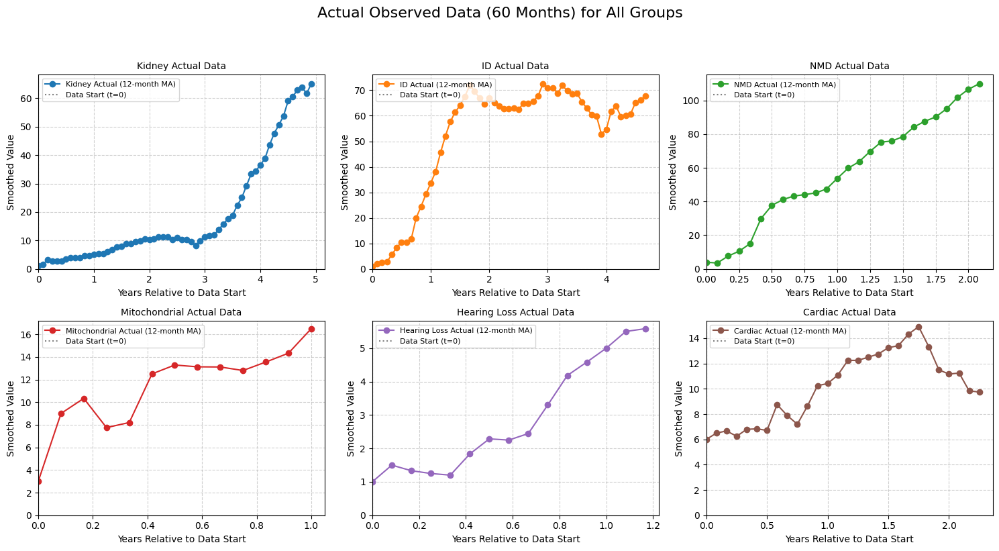


                                Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Parameters and Adopter Category Timings:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤══════════════════════════════════════════════════════════════════════════════════════════════════════════════════

In [77]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            # Removed hardcoded overrides, relying on the CDF-based range which is usually broad enough.
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            ax.plot(pdf_years, pdf_predicted, label=f"PDF", color=color)

            # Calculate 95% range for x-axis based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to 2.5% and 97.5% of the cumulative PDF
                idx_2_5 = np.searchsorted(cumulative_pdf, 0.025)
                idx_97_5 = np.searchsorted(cumulative_pdf, 0.975)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                # Use max(0, ...) and min(..., len-1) to stay within array bounds
                x_min_95_perc = pdf_years[max(0, idx_2_5)]
                x_max_95_perc = pdf_years[min(len(pdf_years) - 1, idx_97_5)]

                # Add some padding to the 95% range for better visualization
                padding = (x_max_95_perc - x_min_95_perc) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_95_perc - padding, right=x_max_95_perc + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label] 
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                                Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)", "Adopter Times"]
    params_data = []
    for model_name, res in models_results.items():
        market_potential_val = f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A'
        estimated_offset_val = f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        
        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        adopter_times_display = adopter_times_str if adopter_times_str else 'N/A'

        row = [model_name, market_potential_val, estimated_offset_val, adopter_times_display]
        
        # Add model-specific parameters to the row, ensuring consistent order
        if model_name == "Logistic Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"K={res['FittedParameters'][0]:.2f}", f"r={res['FittedParameters'][1]:.2f}", f"t0={res['FittedParameters'][2]:.2f}"])
            if "K" not in params_headers: params_headers.extend(["K", "r", "t0"]) # Add headers if not present
        elif model_name == "Gompertz" and res['FittedParameters'] is not None:
            row.extend([f"a={res['FittedParameters'][0]:.2f}", f"b={res['FittedParameters'][1]:.2f}", f"c={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}"])
            if "a" not in params_headers: params_headers.extend(["a", "b", "c", "t_offset"])
        elif model_name == "Bass Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"p={res['FittedParameters'][0]:.4f}", f"q={res['FittedParameters'][1]:.4f}", f"M={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}", f"p+q={res['p_plus_q']:.4f}"])
            if "p" not in params_headers: params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

        params_data.append(row)
    
    # Dynamically adjust headers and data to ensure all model-specific parameters are shown if they exist
    # Create a superset of all possible headers that appeared
    all_current_headers = []
    for row in params_data:
        if len(row) > len(params_headers): # If a row has more elements than initial headers, these are new params
            new_param_headers = [f"Param{i+1}" for i in range(len(params_headers), len(row))] # Placeholder
            for i, val in enumerate(row[len(params_headers):]):
                if "=" in val:
                    key = val.split("=")[0]
                    new_param_headers[i] = key
            all_current_headers.extend(new_param_headers)
    
    unique_all_current_headers = []
    [unique_all_current_headers.append(x) for x in all_current_headers if x not in unique_all_current_headers] # Deduplicate

    # Reconstruct params_headers to include all relevant parameters in a structured way
    final_params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers in a preferred order
    if any("K=" in item for row in params_data for item in row): final_params_headers.extend(["K", "r", "t0"])
    if any("a=" in item for row in params_data for item in row): final_params_headers.extend(["a", "b", "c", "t_offset"])
    if any("p=" in item for row in params_data for item in row): final_params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

    final_params_headers = [h for h in final_params_headers if h in unique_all_current_headers or h in ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]]
    final_params_headers.append("Adopter Times")
    
    # Reconstruct data rows to match the final_params_headers structure
    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the row for tabulate in the correct order based on final_params_headers
        row_for_table = [current_row_data.get(header, 'N/A') for header in final_params_headers]
        formatted_params_data.append(row_for_table)
    
    print("\nParameters and Adopter Category Timings:")
    print(tabulate(formatted_params_data, headers=final_params_headers, tablefmt="fancy_grid"))
    print("\n")


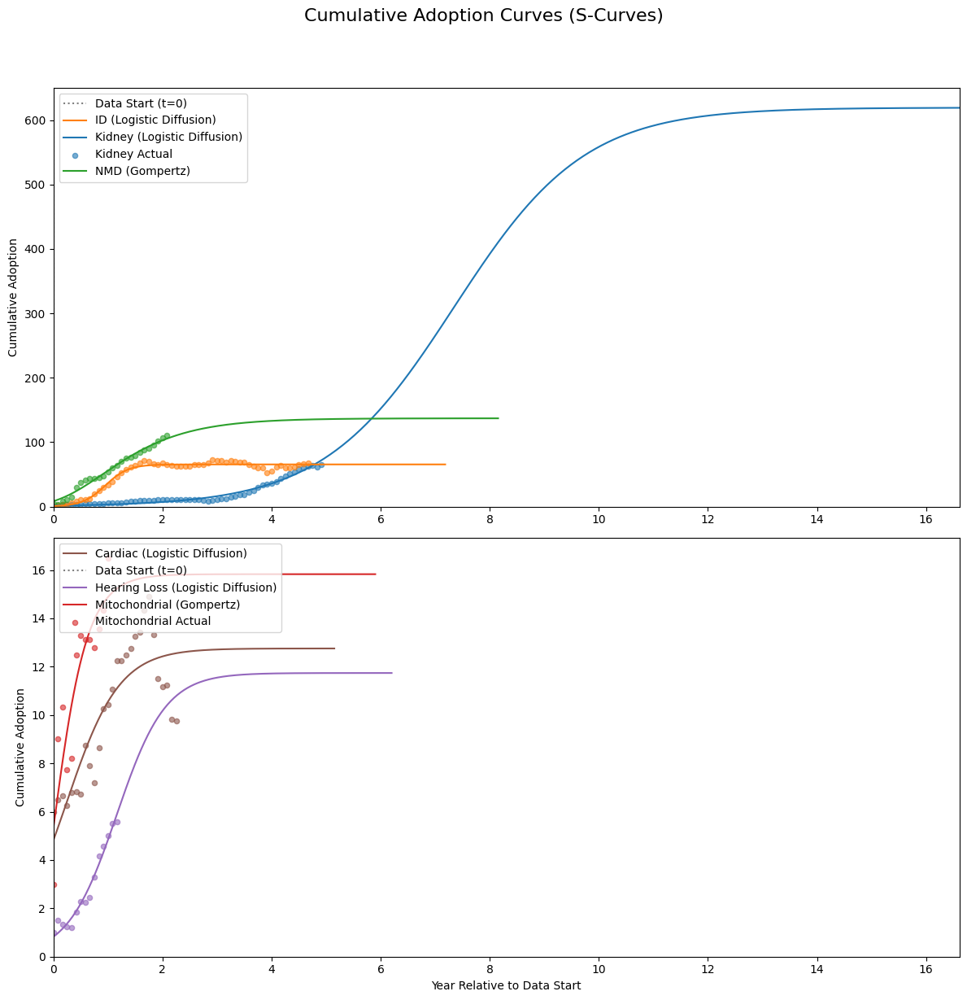

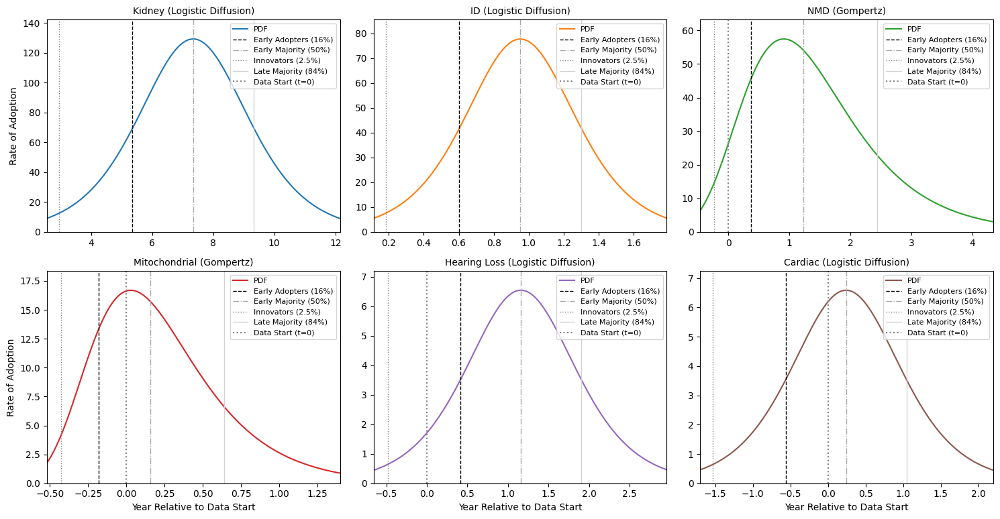

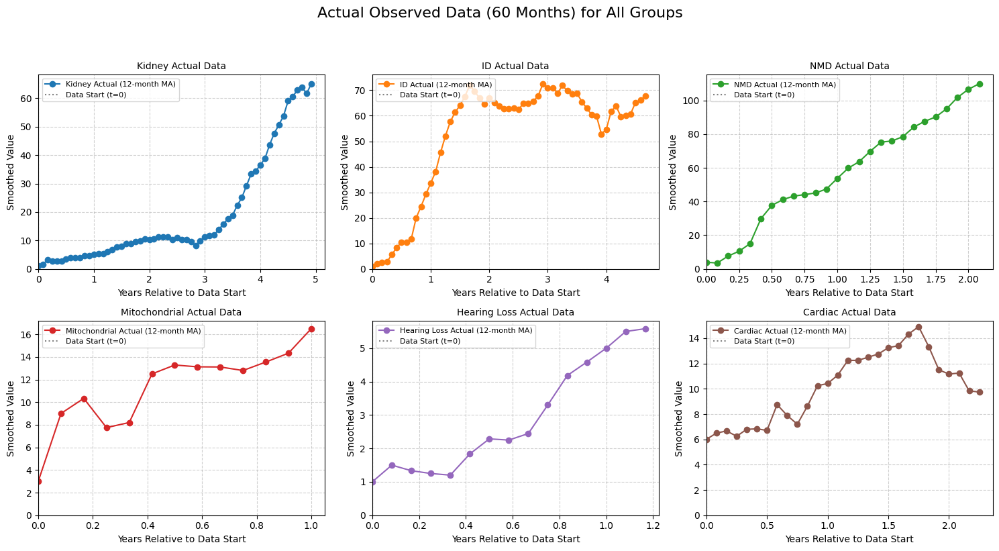


                                Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Parameters and Adopter Category Timings:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤══════════════════════════════════════════════════════════════════════════════════════════════════════════════════

In [81]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 95 means the x-axis will span from the 2.5th percentile to the 97.5th percentile of the PDF's values.
pdf_x_axis_range_percentage = 95

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            ax.plot(pdf_years, pdf_predicted, label=f"PDF", color=color)

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 100
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate 95% range for x-axis based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label] 
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

#        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                                Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)", "Adopter Times"]
    params_data = []
    for model_name, res in models_results.items():
        market_potential_val = f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A'
        estimated_offset_val = f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        
        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        adopter_times_display = adopter_times_str if adopter_times_str else 'N/A'

        row = [model_name, market_potential_val, estimated_offset_val, adopter_times_display]
        
        # Add model-specific parameters to the row, ensuring consistent order
        if model_name == "Logistic Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"K={res['FittedParameters'][0]:.2f}", f"r={res['FittedParameters'][1]:.2f}", f"t0={res['FittedParameters'][2]:.2f}"])
            if "K" not in params_headers: params_headers.extend(["K", "r", "t0"]) # Add headers if not present
        elif model_name == "Gompertz" and res['FittedParameters'] is not None:
            row.extend([f"a={res['FittedParameters'][0]:.2f}", f"b={res['FittedParameters'][1]:.2f}", f"c={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}"])
            if "a" not in params_headers: params_headers.extend(["a", "b", "c", "t_offset"])
        elif model_name == "Bass Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"p={res['FittedParameters'][0]:.4f}", f"q={res['FittedParameters'][1]:.4f}", f"M={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}", f"p+q={res['p_plus_q']:.4f}"])
            if "p" not in params_headers: params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

        params_data.append(row)
    
    # Dynamically adjust headers and data to ensure all model-specific parameters are shown if they exist
    # Create a superset of all possible headers that appeared
    all_current_headers = []
    for row in params_data:
        if len(row) > len(params_headers): # If a row has more elements than initial headers, these are new params
            new_param_headers = [f"Param{i+1}" for i in range(len(params_headers), len(row))] # Placeholder
            for i, val in enumerate(row[len(params_headers):]):
                if "=" in val:
                    key = val.split("=")[0]
                    new_param_headers[i] = key
            all_current_headers.extend(new_param_headers)
    
    unique_all_current_headers = []
    [unique_all_current_headers.append(x) for x in all_current_headers if x not in unique_all_current_headers] # Deduplicate

    # Reconstruct params_headers to include all relevant parameters in a structured way
    final_params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers in a preferred order
    if any("K=" in item for row in params_data for item in row): final_params_headers.extend(["K", "r", "t0"])
    if any("a=" in item for row in params_data for item in row): final_params_headers.extend(["a", "b", "c", "t_offset"])
    if any("p=" in item for row in params_data for item in row): final_params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

    final_params_headers = [h for h in final_params_headers if h in unique_all_current_headers or h in ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]]
    final_params_headers.append("Adopter Times")
    
    # Reconstruct data rows to match the final_params_headers structure
    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the row for tabulate in the correct order based on final_params_headers
        row_for_table = [current_row_data.get(header, 'N/A') for header in final_params_headers]
        formatted_params_data.append(row_for_table)
    
    print("\nParameters and Adopter Category Timings:")
    print(tabulate(formatted_params_data, headers=final_params_headers, tablefmt="fancy_grid"))
    print("\n")


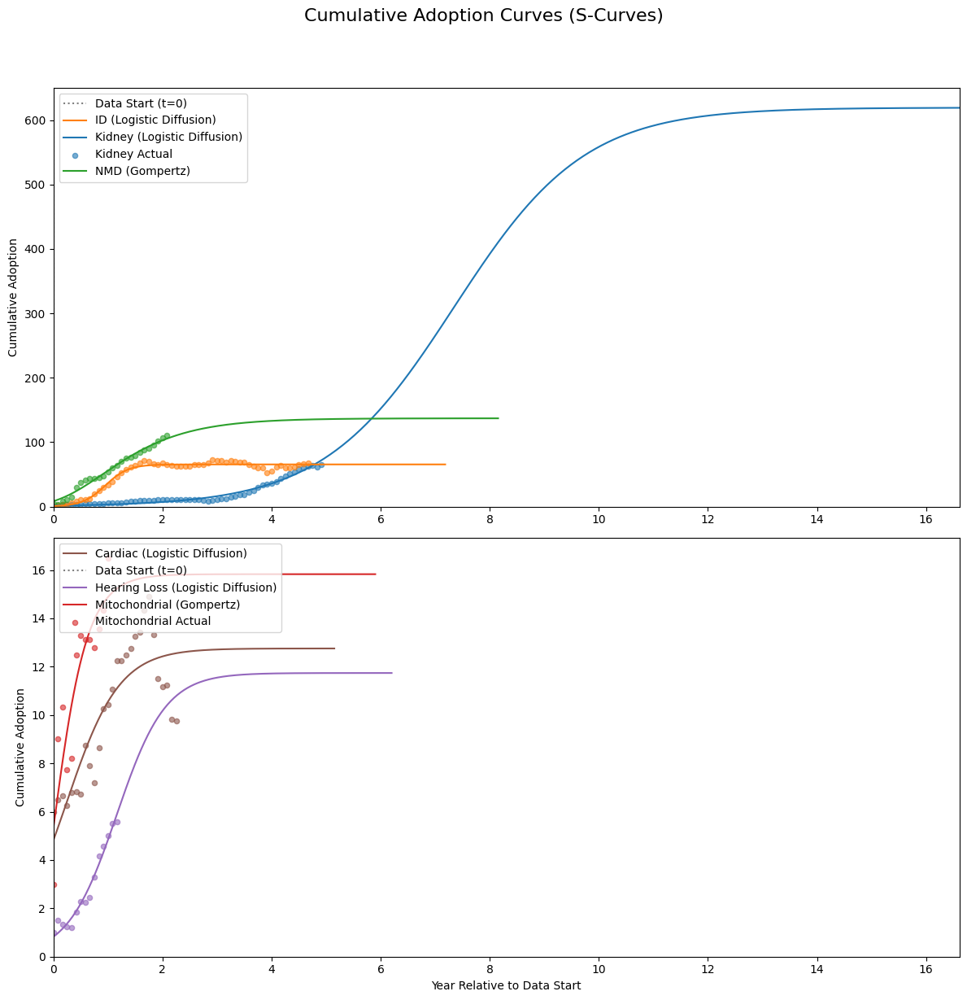

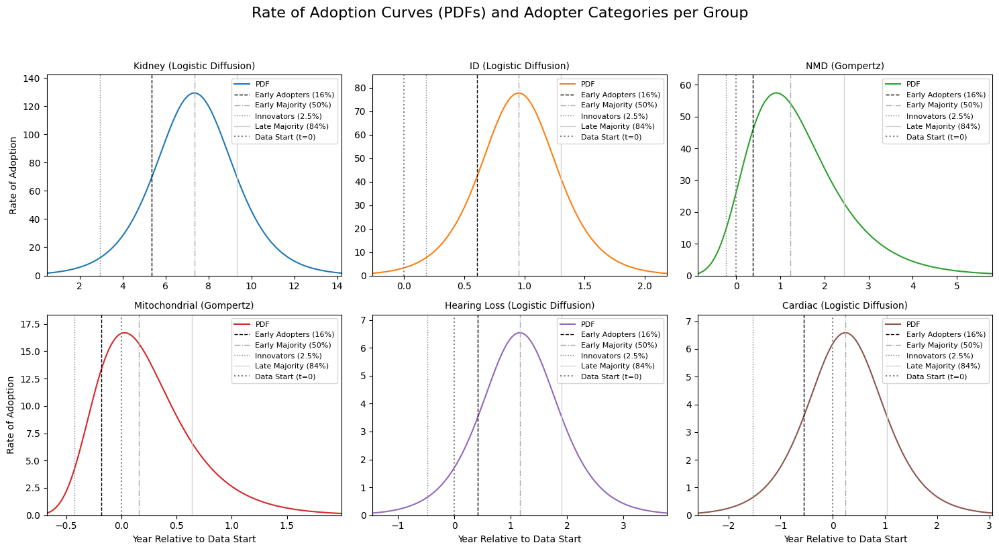

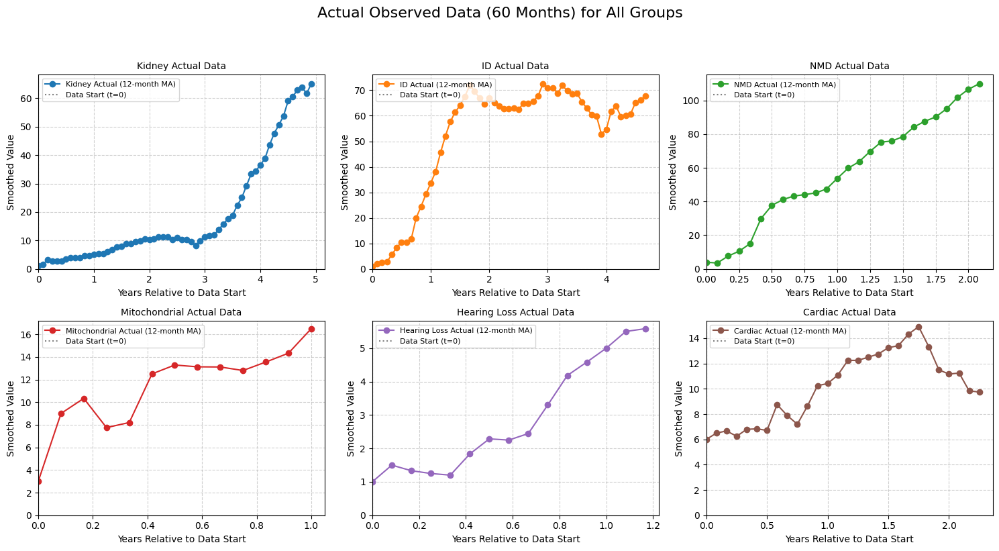


                                Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Parameters and Adopter Category Timings:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤══════════════════════════════════════════════════════════════════════════════════════════════════════════════════

In [84]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'}
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            ax.plot(pdf_years, pdf_predicted, label=f"PDF", color=color)

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate 95% range for x-axis based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], label=details['label'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.startswith(('Innovators', 'Early Adopters', 'Early Majority', 'Late Majority'))], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]

            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_handles_labels] + [l for _, l in data_start_handle_label] 
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                                Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)", "Adopter Times"]
    params_data = []
    for model_name, res in models_results.items():
        market_potential_val = f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A'
        estimated_offset_val = f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        
        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        adopter_times_display = adopter_times_str if adopter_times_str else 'N/A'

        row = [model_name, market_potential_val, estimated_offset_val, adopter_times_display]
        
        # Add model-specific parameters to the row, ensuring consistent order
        if model_name == "Logistic Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"K={res['FittedParameters'][0]:.2f}", f"r={res['FittedParameters'][1]:.2f}", f"t0={res['FittedParameters'][2]:.2f}"])
            if "K" not in params_headers: params_headers.extend(["K", "r", "t0"]) # Add headers if not present
        elif model_name == "Gompertz" and res['FittedParameters'] is not None:
            row.extend([f"a={res['FittedParameters'][0]:.2f}", f"b={res['FittedParameters'][1]:.2f}", f"c={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}"])
            if "a" not in params_headers: params_headers.extend(["a", "b", "c", "t_offset"])
        elif model_name == "Bass Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"p={res['FittedParameters'][0]:.4f}", f"q={res['FittedParameters'][1]:.4f}", f"M={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}", f"p+q={res['p_plus_q']:.4f}"])
            if "p" not in params_headers: params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

        params_data.append(row)
    
    # Dynamically adjust headers and data to ensure all model-specific parameters are shown if they exist
    # Create a superset of all possible headers that appeared
    all_current_headers = []
    for row in params_data:
        if len(row) > len(params_headers): # If a row has more elements than initial headers, these are new params
            new_param_headers = [f"Param{i+1}" for i in range(len(params_headers), len(row))] # Placeholder
            for i, val in enumerate(row[len(params_headers):]):
                if "=" in val:
                    key = val.split("=")[0]
                    new_param_headers[i] = key
            all_current_headers.extend(new_param_headers)
    
    unique_all_current_headers = []
    [unique_all_current_headers.append(x) for x in all_current_headers if x not in unique_all_current_headers] # Deduplicate

    # Reconstruct params_headers to include all relevant parameters in a structured way
    final_params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers in a preferred order
    if any("K=" in item for row in params_data for item in row): final_params_headers.extend(["K", "r", "t0"])
    if any("a=" in item for row in params_data for item in row): final_params_headers.extend(["a", "b", "c", "t_offset"])
    if any("p=" in item for row in params_data for item in row): final_params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

    final_params_headers = [h for h in final_params_headers if h in unique_all_current_headers or h in ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]]
    final_params_headers.append("Adopter Times")
    
    # Reconstruct data rows to match the final_params_headers structure
    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the row for tabulate in the correct order based on final_params_headers
        row_for_table = [current_row_data.get(header, 'N/A') for header in final_params_headers]
        formatted_params_data.append(row_for_table)
    
    print("\nParameters and Adopter Category Timings:")
    print(tabulate(formatted_params_data, headers=final_params_headers, tablefmt="fancy_grid"))
    print("\n")


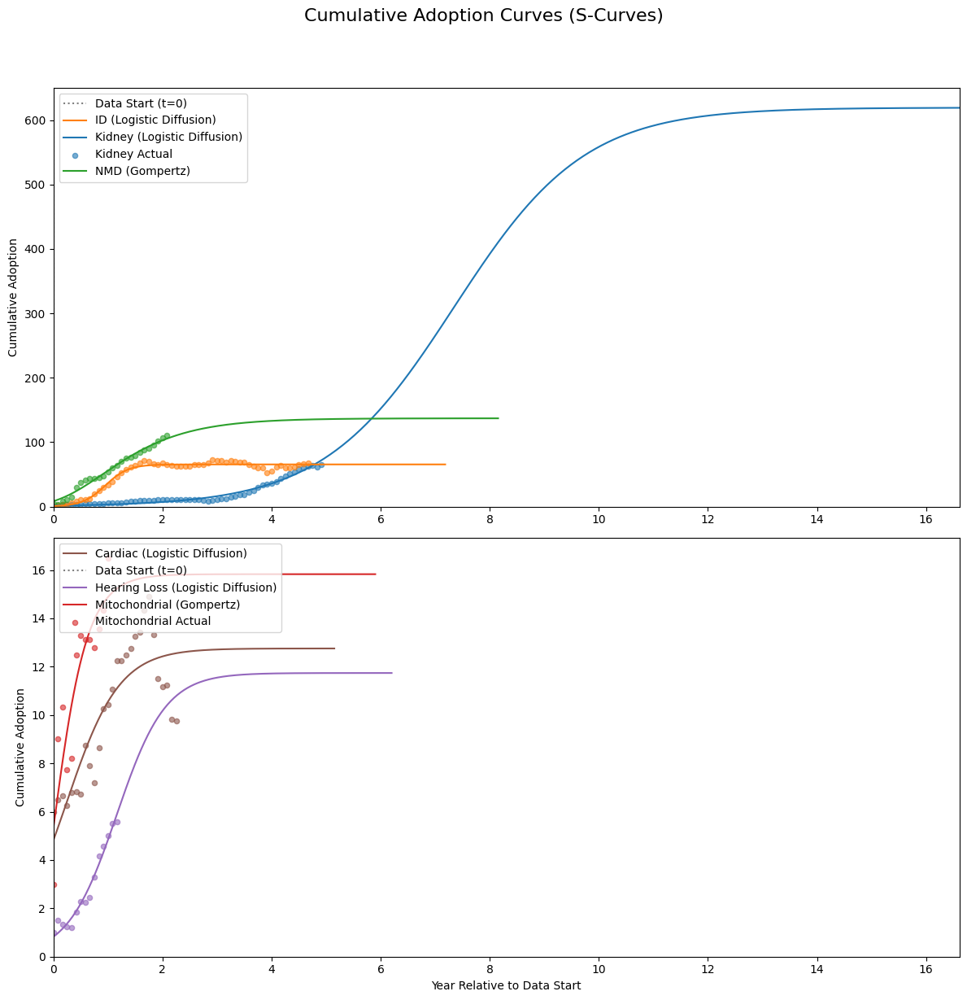

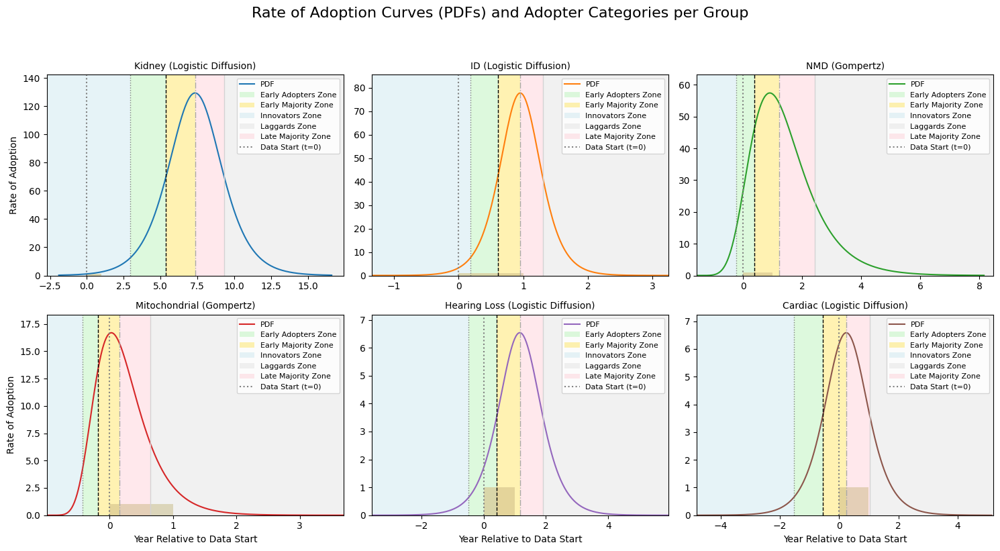

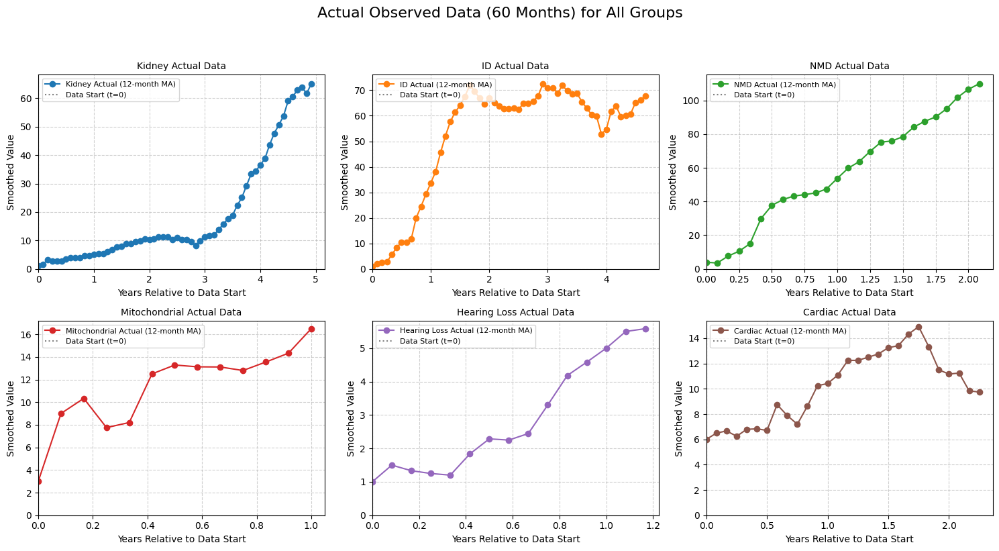


                                Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Parameters and Adopter Category Timings:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤══════════════════════════════════════════════════════════════════════════════════════════════════════════════════

In [86]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            ax.plot(pdf_years, pdf_predicted, label=f"PDF", color=color)

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            # Sort adopter categories by percentage for correct shading order
            sorted_categories = sorted(adopter_categories_lines.items(), key=lambda item: item[1]['perc'])
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            for category_name, details in sorted_categories:
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        # Use a dummy rectangle for the legend to represent the shaded area
                        rect = plt.Rectangle((0, 0), 1, 1, fc=adopter_category_shades[category_name]['color'], alpha=adopter_category_shades[category_name]['alpha'], 
                                             label=f"{category_name} Zone")
                        ax.add_patch(rect)
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        rect = plt.Rectangle((0, 0), 1, 1, fc=adopter_category_shades[category_name]['color'], alpha=adopter_category_shades[category_name]['alpha'], 
                                             label=f"{category_name} Zone")
                        ax.add_patch(rect)
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])


            # Plot vertical lines (on top of shading for visibility)
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            handles, labels = ax.get_legend_handles_labels()
            
            # Manually sort legend handles and labels to ensure shade labels appear first
            pdf_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "PDF"]
            adopter_zone_handles_labels = sorted([(h, l) for h, l in zip(handles, labels) if l.endswith('Zone')], key=lambda x: x[1])
            data_start_handle_label = [(h, l) for h, l in zip(handles, labels) if l == "Data Start (t=0)"]
            
            # The vertical lines are not explicitly added to the legend here, as their purpose is boundary.
            # If desired, add them back in a structured way.
            
            sorted_handles = [h for h, _ in pdf_handle_label] + [h for h, _ in adopter_zone_handles_labels] + [h for h, _ in data_start_handle_label]
            sorted_labels = [l for _, l in pdf_handle_label] + [l for _, l in adopter_zone_handles_labels] + [l for _, l in data_start_handle_label] 
            
            ax.legend(sorted_handles, sorted_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                                Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)", "Adopter Times"]
    params_data = []
    for model_name, res in models_results.items():
        market_potential_val = f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A'
        estimated_offset_val = f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        
        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        adopter_times_display = adopter_times_str if adopter_times_str else 'N/A'

        row = [model_name, market_potential_val, estimated_offset_val, adopter_times_display]
        
        # Add model-specific parameters to the row, ensuring consistent order
        if model_name == "Logistic Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"K={res['FittedParameters'][0]:.2f}", f"r={res['FittedParameters'][1]:.2f}", f"t0={res['FittedParameters'][2]:.2f}"])
            if "K" not in params_headers: params_headers.extend(["K", "r", "t0"]) # Add headers if not present
        elif model_name == "Gompertz" and res['FittedParameters'] is not None:
            row.extend([f"a={res['FittedParameters'][0]:.2f}", f"b={res['FittedParameters'][1]:.2f}", f"c={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}"])
            if "a" not in params_headers: params_headers.extend(["a", "b", "c", "t_offset"])
        elif model_name == "Bass Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"p={res['FittedParameters'][0]:.4f}", f"q={res['FittedParameters'][1]:.4f}", f"M={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}", f"p+q={res['p_plus_q']:.4f}"])
            if "p" not in params_headers: params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

        params_data.append(row)
    
    # Dynamically adjust headers and data to ensure all model-specific parameters are shown if they exist
    # Create a superset of all possible headers that appeared
    all_current_headers = []
    for row in params_data:
        if len(row) > len(params_headers): # If a row has more elements than initial headers, these are new params
            new_param_headers = [f"Param{i+1}" for i in range(len(params_headers), len(row))] # Placeholder
            for i, val in enumerate(row[len(params_headers):]):
                if "=" in val:
                    key = val.split("=")[0]
                    new_param_headers[i] = key
            all_current_headers.extend(new_param_headers)
    
    unique_all_current_headers = []
    [unique_all_current_headers.append(x) for x in all_current_headers if x not in unique_all_current_headers] # Deduplicate

    # Reconstruct params_headers to include all relevant parameters in a structured way
    final_params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers in a preferred order
    if any("K=" in item for row in params_data for item in row): final_params_headers.extend(["K", "r", "t0"])
    if any("a=" in item for row in params_data for item in row): final_params_headers.extend(["a", "b", "c", "t_offset"])
    if any("p=" in item for row in params_data for item in row): final_params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

    final_params_headers = [h for h in final_params_headers if h in unique_all_current_headers or h in ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]]
    final_params_headers.append("Adopter Times")
    
    # Reconstruct data rows to match the final_params_headers structure
    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the row for tabulate in the correct order based on final_params_headers
        row_for_table = [current_row_data.get(header, 'N/A') for header in final_params_headers]
        formatted_params_data.append(row_for_table)
    
    print("\nParameters and Adopter Category Timings:")
    print(tabulate(formatted_params_data, headers=final_params_headers, tablefmt="fancy_grid"))
    print("\n")


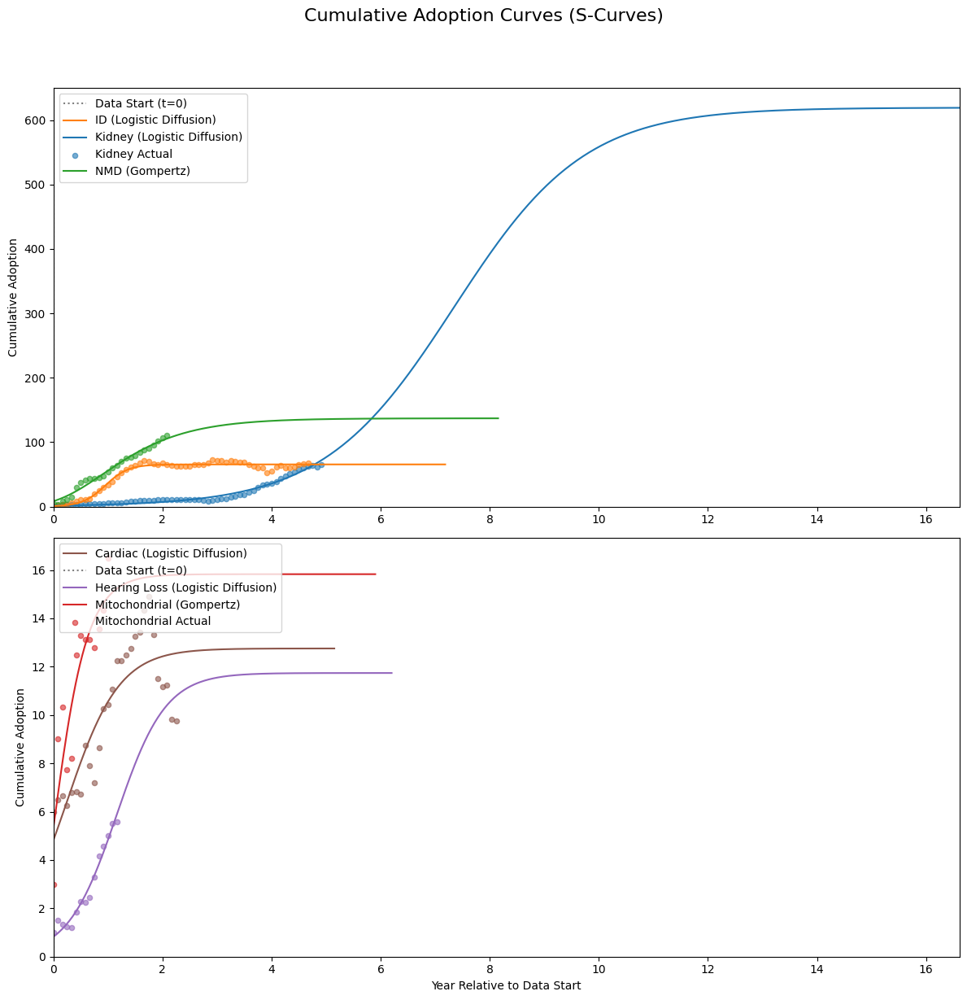

/var/folders/m9/_g3wndrn04d80ys2382r700r0000gn/T/ipykernel_20826/90222232.py:570: UserWarning: Legend does not support handles for str instances.
A proxy artist may be used instead.
See: https://matplotlib.org/stable/users/explain/axes/legend_guide.html#controlling-the-legend-entries
  ax.legend(all_handles, all_labels, loc='upper right', fontsize=8)


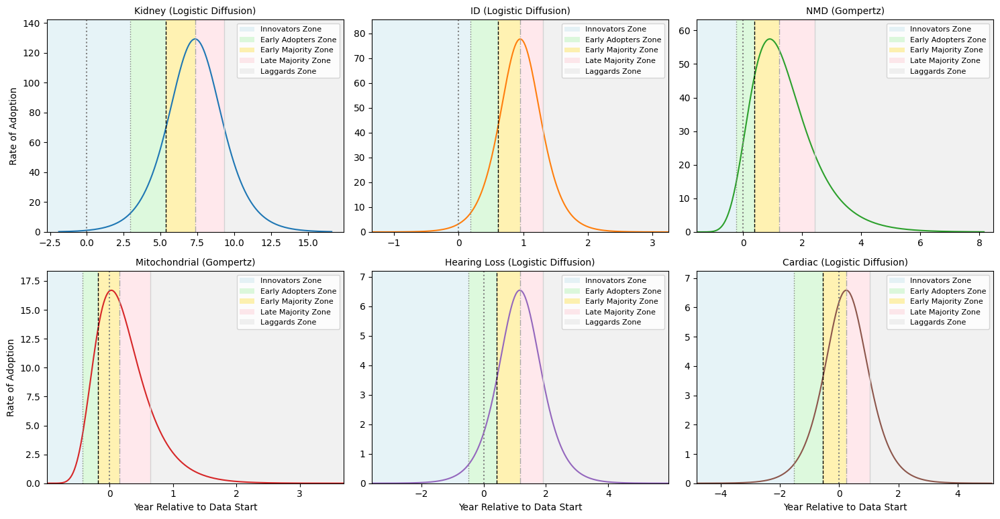

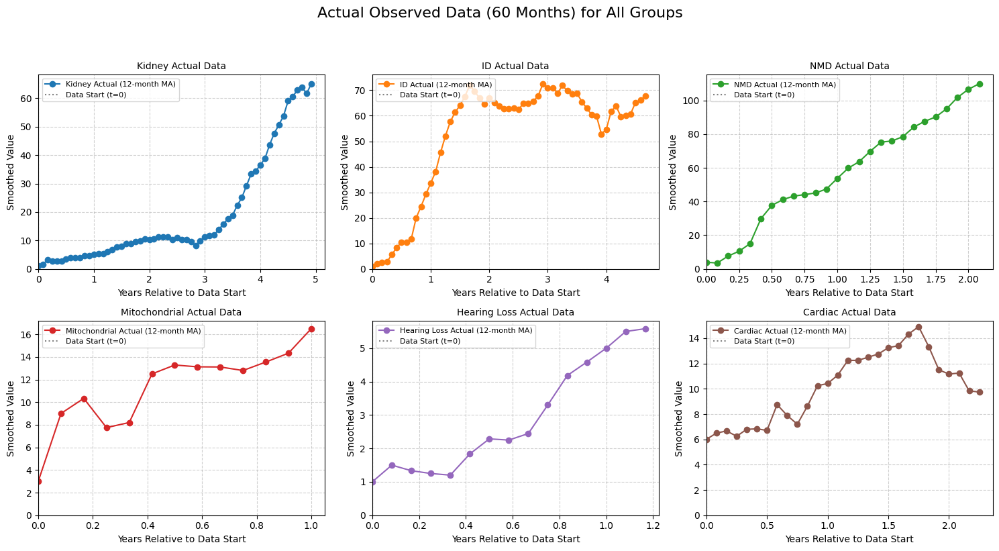


                                Model Fit Metrics and Parameters

--- Group: Kidney ---

Goodness-of-Fit Metrics:
╒════════════════════╤═════════════╤═══════╤════════╤════════╤════════╕
│ Model              │   R-squared │   MAE │   RMSE │    AIC │    BIC │
╞════════════════════╪═════════════╪═══════╪════════╪════════╪════════╡
│ Logistic Diffusion │      0.9676 │  2.93 │   3.44 │ 154.1  │ 160.38 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Gompertz           │      0.9659 │  3.04 │   3.52 │ 159.09 │ 167.47 │
├────────────────────┼─────────────┼───────┼────────┼────────┼────────┤
│ Bass Diffusion     │      0.7821 │  7.81 │   8.9  │ 270.38 │ 278.75 │
╘════════════════════╧═════════════╧═══════╧════════╧════════╧════════╛

Parameters and Adopter Category Timings:
╒════════════════════╤════════════════════════════╤═════════════════════════════╤══════════════════════════════════════════════════════════════════════════════════════════════════════════════════

In [88]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            ax.plot(pdf_years, pdf_predicted, label=f"PDF", color=color)

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            # Sort adopter categories by percentage for correct shading order
            sorted_categories = sorted(adopter_categories_lines.items(), key=lambda item: item[1]['perc'])
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            adopter_zone_legend_elements = [] # To store legend elements for shaded zones
            for category_name, details in sorted_categories:
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                        # Store a dummy rectangle for the legend
                        adopter_zone_legend_elements.append(
                            plt.Rectangle((0, 0), 1, 1, fc=adopter_category_shades[category_name]['color'], 
                                          alpha=adopter_category_shades[category_name]['alpha'], 
                                          label=f"{category_name} Zone")
                        )
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                        adopter_zone_legend_elements.append(
                            plt.Rectangle((0, 0), 1, 1, fc=adopter_category_shades[category_name]['color'], 
                                          alpha=adopter_category_shades[category_name]['alpha'], 
                                          label=f"{category_name} Zone")
                        )


            # Plot vertical lines (on top of shading for visibility)
            # These are for visual demarcation and typically don't go in the legend if shades are present
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            # Collect all legend handles and labels, then sort chronologically
            all_handles = []
            all_labels = []

            # Add PDF line
            pdf_line_handle = [h for h, l in ax.get_legend_handles_labels() if l == "PDF"]
            if pdf_line_handle:
                all_handles.append(pdf_line_handle[0])
                all_labels.append("PDF")

            # Add shaded zones in chronological order
            # The adopter_zone_legend_elements are already created in order of appearance
            for rect in adopter_zone_legend_elements:
                all_handles.append(rect)
                all_labels.append(rect.get_label())

            # Add Data Start line
            data_start_handle = [h for h, l in ax.get_legend_handles_labels() if l == "Data Start (t=0)"]
            if data_start_handle:
                all_handles.append(data_start_handle[0])
                all_labels.append("Data Start (t=0)")
            
            ax.legend(all_handles, all_labels, loc='upper right', fontsize=8)

        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

#        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98]) 
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                                Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"--- Group: {group} ---")
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\nGoodness-of-Fit Metrics:")
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="fancy_grid"))

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)", "Adopter Times"]
    params_data = []
    for model_name, res in models_results.items():
        market_potential_val = f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A'
        estimated_offset_val = f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        
        adopter_times_str = ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None])
        adopter_times_display = adopter_times_str if adopter_times_str else 'N/A'

        row = [model_name, market_potential_val, estimated_offset_val, adopter_times_display]
        
        # Add model-specific parameters to the row, ensuring consistent order
        if model_name == "Logistic Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"K={res['FittedParameters'][0]:.2f}", f"r={res['FittedParameters'][1]:.2f}", f"t0={res['FittedParameters'][2]:.2f}"])
            if "K" not in params_headers: params_headers.extend(["K", "r", "t0"]) # Add headers if not present
        elif model_name == "Gompertz" and res['FittedParameters'] is not None:
            row.extend([f"a={res['FittedParameters'][0]:.2f}", f"b={res['FittedParameters'][1]:.2f}", f"c={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}"])
            if "a" not in params_headers: params_headers.extend(["a", "b", "c", "t_offset"])
        elif model_name == "Bass Diffusion" and res['FittedParameters'] is not None:
            row.extend([f"p={res['FittedParameters'][0]:.4f}", f"q={res['FittedParameters'][1]:.4f}", f"M={res['FittedParameters'][2]:.2f}", f"t_offset={res['FittedParameters'][3]:.2f}", f"p+q={res['p_plus_q']:.4f}"])
            if "p" not in params_headers: params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

        params_data.append(row)
    
    # Dynamically adjust headers and data to ensure all model-specific parameters are shown if they exist
    # Create a superset of all possible headers that appeared
    all_current_headers = []
    for row in params_data:
        if len(row) > len(params_headers): # If a row has more elements than initial headers, these are new params
            new_param_headers = [f"Param{i+1}" for i in range(len(params_headers), len(row))] # Placeholder
            for i, val in enumerate(row[len(params_headers):]):
                if "=" in val:
                    key = val.split("=")[0]
                    new_param_headers[i] = key
            all_current_headers.extend(new_param_headers)
    
    unique_all_current_headers = []
    [unique_all_current_headers.append(x) for x in all_current_headers if x not in unique_all_current_headers] # Deduplicate

    # Reconstruct params_headers to include all relevant parameters in a structured way
    final_params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers in a preferred order
    if any("K=" in item for row in params_data for item in row): final_params_headers.extend(["K", "r", "t0"])
    if any("a=" in item for row in params_data for item in row): final_params_headers.extend(["a", "b", "c", "t_offset"])
    if any("p=" in item for row in params_data for item in row): final_params_headers.extend(["p", "q", "M", "t_offset", "p+q"])

    final_params_headers = [h for h in final_params_headers if h in unique_all_current_headers or h in ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]]
    final_params_headers.append("Adopter Times")
    
    # Reconstruct data rows to match the final_params_headers structure
    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the row for tabulate in the correct order based on final_params_headers
        row_for_table = [current_row_data.get(header, 'N/A') for header in final_params_headers]
        formatted_params_data.append(row_for_table)
    
    print("\nParameters and Adopter Category Timings:")
    print(tabulate(formatted_params_data, headers=final_params_headers, tablefmt="fancy_grid"))
    print("\n")


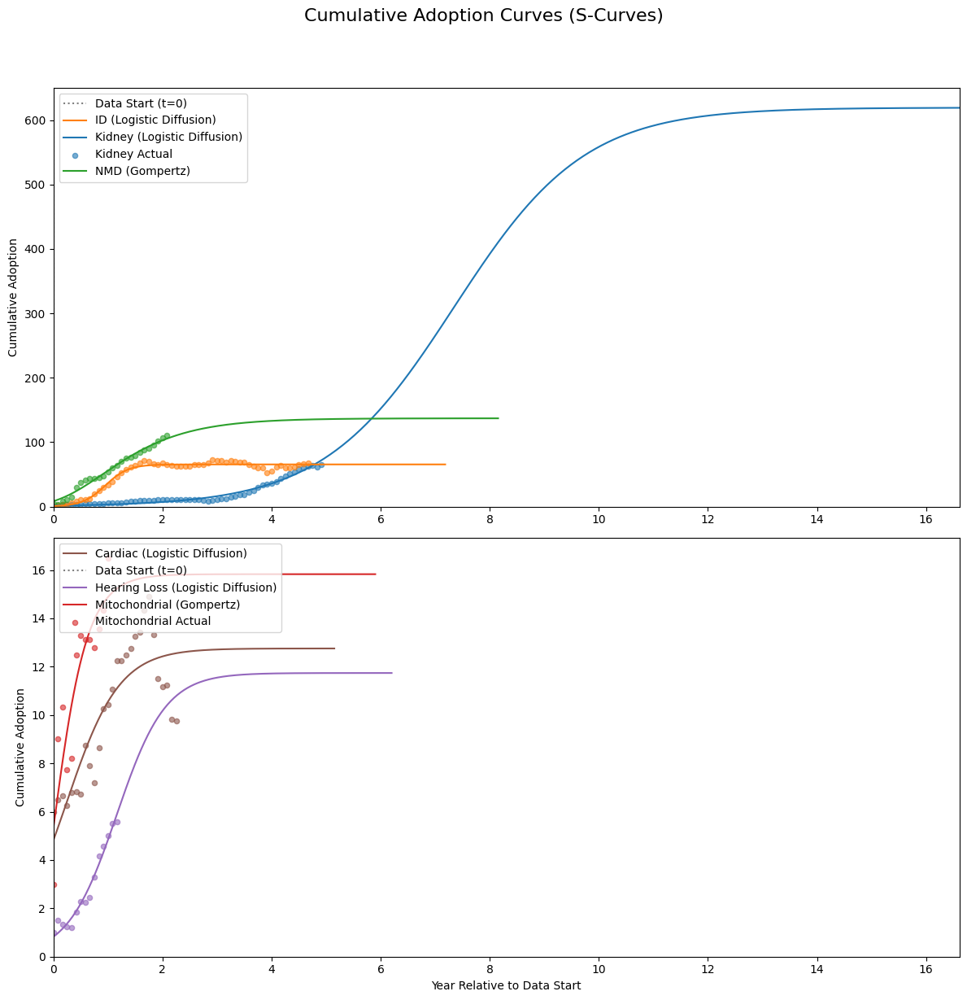

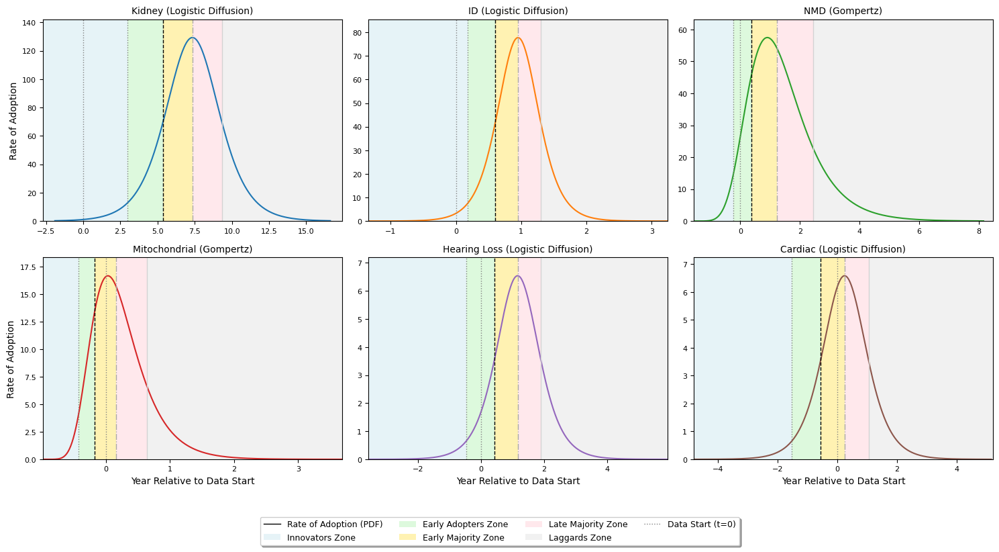

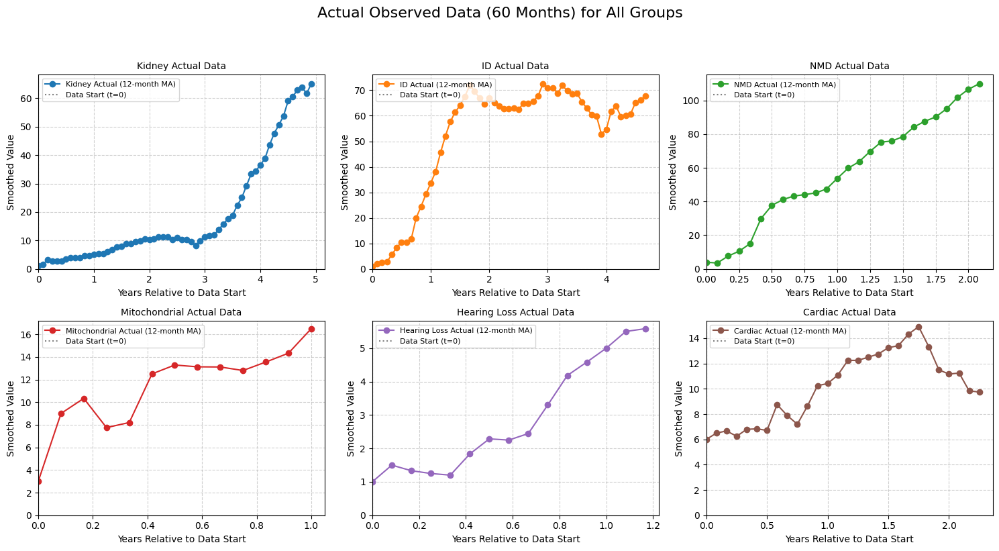


                                Model Fit Metrics and Parameters

<h3>--- Group: Kidney ---</h3>

<h4>Goodness-of-Fit Metrics:</h4>
<table>
<thead>
<tr><th>Model             </th><th style="text-align: right;">  R-squared</th><th style="text-align: right;">  MAE</th><th style="text-align: right;">  RMSE</th><th style="text-align: right;">   AIC</th><th style="text-align: right;">   BIC</th></tr>
</thead>
<tbody>
<tr><td>Logistic Diffusion</td><td style="text-align: right;">     0.9676</td><td style="text-align: right;"> 2.93</td><td style="text-align: right;">  3.44</td><td style="text-align: right;">154.1 </td><td style="text-align: right;">160.38</td></tr>
<tr><td>Gompertz          </td><td style="text-align: right;">     0.9659</td><td style="text-align: right;"> 3.04</td><td style="text-align: right;">  3.52</td><td style="text-align: right;">159.09</td><td style="text-align: right;">167.47</td></tr>
<tr><td>Bass Diffusion    </td><td style="text-align: right;">     0.7821</td><td

In [90]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from tabulate import tabulate # Import the tabulate library

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        # --- Global legend elements for the PDF plot ---
        global_pdf_legend_handles = []
        global_pdf_legend_labels = []

        # Add a dummy handle for the PDF curve itself (appears once in global legend)
        # We'll use a transparent line, as the actual PDF lines are group-specific
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='black', lw=1))
        global_pdf_legend_labels.append("Rate of Adoption (PDF)")

        # Add dummy handles for shaded zones in chronological order
        # This list ensures the order for the legend
        ordered_adopter_categories = [
            'Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards'
        ]
        for category_name in ordered_adopter_categories:
            if category_name in adopter_category_shades:
                global_pdf_legend_handles.append(plt.Rectangle((0, 0), 1, 1, 
                                                              fc=adopter_category_shades[category_name]['color'], 
                                                              alpha=adopter_category_shades[category_name]['alpha']))
                global_pdf_legend_labels.append(f"{category_name} Zone")
        
        # Add a dummy handle for the Data Start (t=0) line
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='grey', linestyle=':', lw=1))
        global_pdf_legend_labels.append("Data Start (t=0)")

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            # Plot the PDF curve
            ax.plot(pdf_years, pdf_predicted, color=color) # Label removed as handled by global legend

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            for category_name in ordered_adopter_categories: # Use the defined order for shading
                details = adopter_categories_lines[category_name]
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])


            # Plot vertical lines (on top of shading for visibility)
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', lw=1) # No label, as it's in the global legend

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            # No individual legend for subplots now
            ax.tick_params(axis='x', labelsize=8)
            ax.tick_params(axis='y', labelsize=8)


        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

#        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        
        # Add the single legend for the entire figure at the bottom
        fig_pdf.legend(global_pdf_legend_handles, global_pdf_legend_labels, loc='lower center', 
                       bbox_to_anchor=(0.5, -0.05), # Position below the plots
                       ncol=math.ceil(len(global_pdf_legend_labels)/2), # Adjust number of columns based on entries
                       fontsize=9, frameon=True, fancybox=True, shadow=True)
        
        # Adjust layout to make space for the legend
        plt.tight_layout(rect=[0, 0.05, 1, 0.98]) # [left, bottom, right, top] - increased bottom margin
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables using tabulate ---
print("\n" + "="*80)
print("                                Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"<h3>--- Group: {group} ---</h3>") # Use H3 for group title in HTML
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append([
            model_name,
            f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        ])
    
    print("\n<h4>Goodness-of-Fit Metrics:</h4>") # Use H4 for sub-title in HTML
    print(tabulate(metrics_data, headers=metrics_headers, tablefmt="html")) # Changed to HTML format

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    # Add model-specific headers in a preferred order for the table display
    # This logic needs to be careful to avoid duplicate headers and maintain order.
    # We will build a comprehensive list of unique headers across all models for a given group.
    
    # Identify all possible parameter keys across models for this group
    all_param_keys = set()
    for model_name, res in models_results.items():
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                all_param_keys.update(["K", "r", "t0"])
            elif model_name == "Gompertz":
                all_param_keys.update(["a", "b", "c", "t_offset"])
            elif model_name == "Bass Diffusion":
                all_param_keys.update(["p", "q", "M", "t_offset", "p+q"])

    # Define a consistent order for these parameters in the header
    ordered_param_keys = ["K", "r", "t0", "a", "b", "c", "t_offset", "p", "q", "M", "p+q"]
    
    for key in ordered_param_keys:
        if key in all_param_keys:
            params_headers.append(key)

    params_headers.append("Adopter Times") # Add Adopter Times at the very end

    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the row for tabulate in the correct order based on final_params_headers
        row_for_table = [current_row_data.get(header, 'N/A') for header in params_headers]
        formatted_params_data.append(row_for_table)
    
    print("\n<h4>Parameters and Adopter Category Timings:</h4>") # Use H4 for sub-title in HTML
    print(tabulate(formatted_params_data, headers=params_headers, tablefmt="html")) # Changed to HTML format
    print("\n")


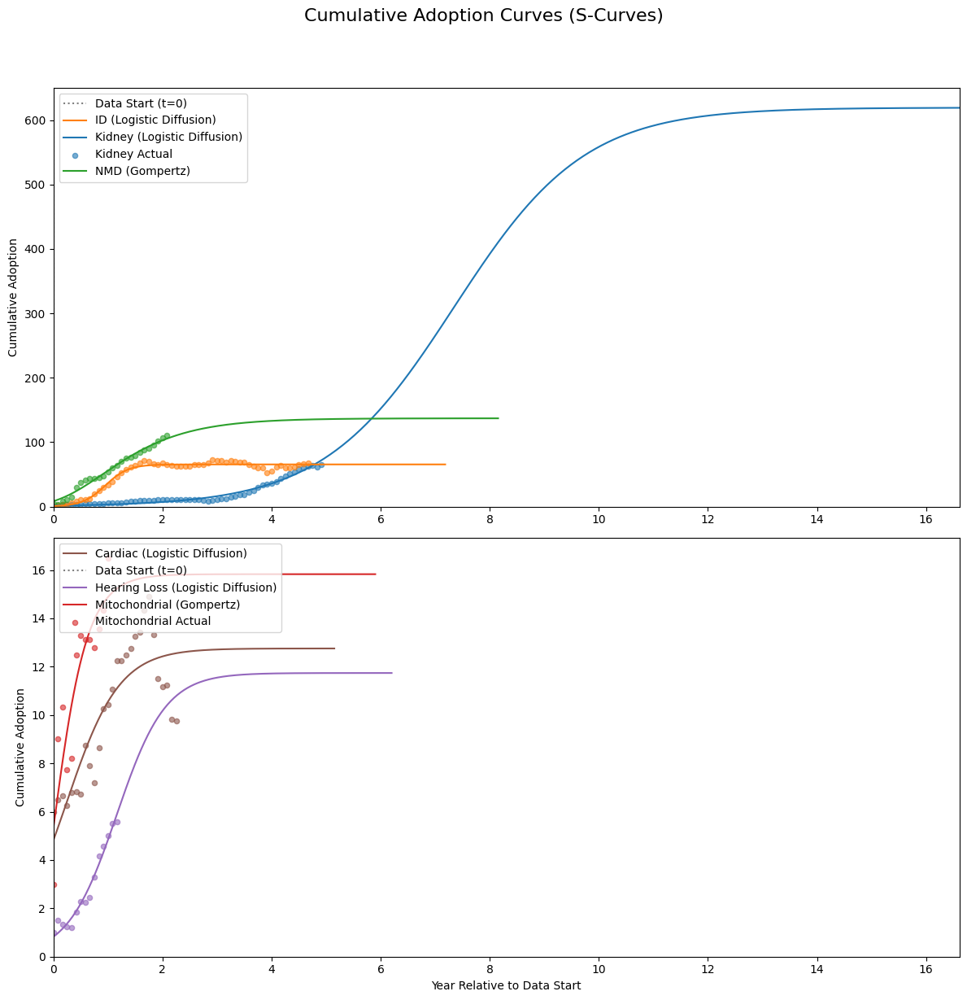

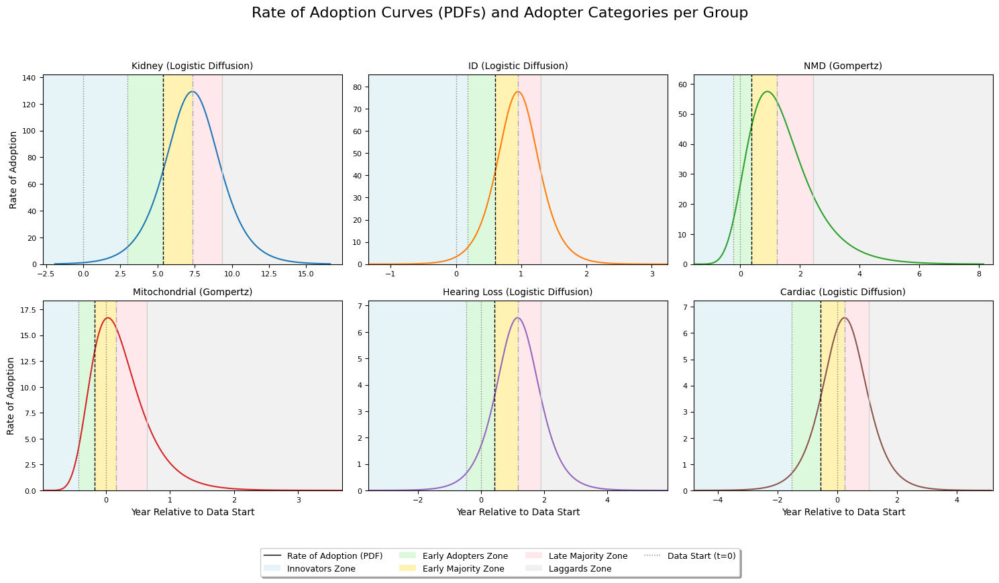

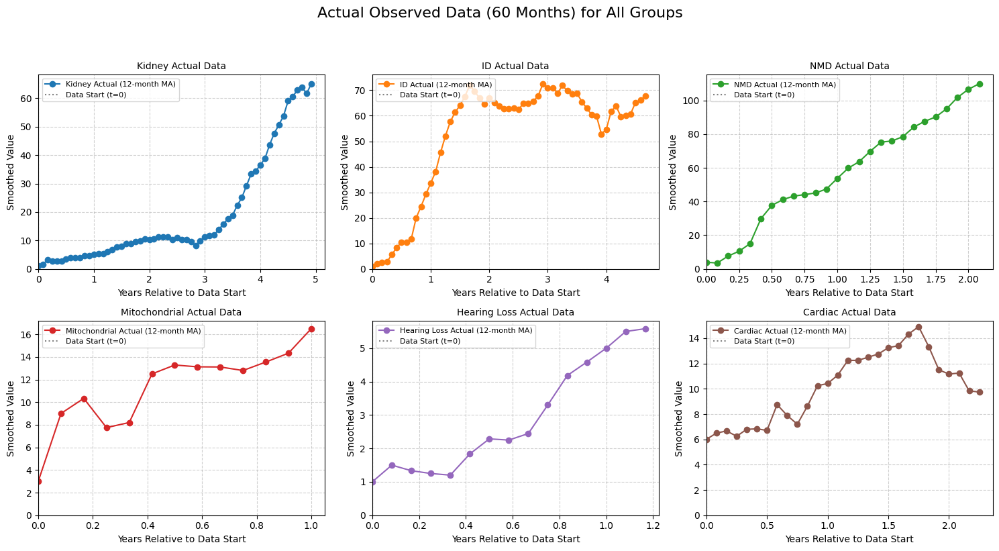


                                Model Fit Metrics and Parameters


--- Group: Kidney ---

Goodness-of-Fit Metrics:


,Model,R-squared,MAE,RMSE,AIC,BIC
0,Logistic Diffusion,0.9676,2.93,3.44,154.10,160.38
1,Gompertz,0.9659,3.04,3.52,159.09,167.47
2,Bass Diffusion,0.7821,7.81,8.90,270.38,278.75



Parameters and Adopter Category Timings:


,Model,Market Potential (K/M/a),Est. Offset (t0/t_offset),K,r,t0,a,b,c,t_offset,p,q,M,p+q,Adopter Times
0,Logistic Diffusion,619.33,7.35,619.33,0.84,7.35,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,"Innovators: 2.96 yrs, Early Adopters: 5.36 yrs..."
1,Gompertz,41565483.31,10.00,N/A,N/A,N/A,41565483.31,10.00,0.06,10.00,N/A,N/A,N/A,N/A,"Innovators: 27.92 yrs, Early Adopters: 40.49 y..."
2,Bass Diffusion,68.34,3.43,N/A,N/A,N/A,N/A,N/A,N/A,3.43,0.3000,0.0001,68.34,0.3001,"Innovators: 3.45 yrs, Early Adopters: 3.59 yrs..."





--- Group: ID ---

Goodness-of-Fit Metrics:


,Model,R-squared,MAE,RMSE,AIC,BIC
0,Logistic Diffusion,0.9689,3.07,4.01,164.46,170.59
1,Gompertz,0.9606,3.62,4.51,179.82,187.99
2,Bass Diffusion,-2.6666,37.09,43.56,438.25,446.42



Parameters and Adopter Category Timings:


,Model,Market Potential (K/M/a),Est. Offset (t0/t_offset),K,r,t0,a,b,c,t_offset,p,q,M,p+q,Adopter Times
0,Logistic Diffusion,65.36,0.95,65.36,4.76,0.95,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,"Innovators: 0.18 yrs, Early Adopters: 0.60 yrs..."
1,Gompertz,65.56,0.65,N/A,N/A,N/A,65.56,1.73,3.40,0.65,N/A,N/A,N/A,N/A,"Innovators: 0.43 yrs, Early Adopters: 0.64 yrs..."
2,Bass Diffusion,76.13,2.25,N/A,N/A,N/A,N/A,N/A,N/A,2.25,0.3000,0.0001,76.13,0.3001,"Innovators: 2.27 yrs, Early Adopters: 2.41 yrs..."





--- Group: NMD ---

Goodness-of-Fit Metrics:


,Model,R-squared,MAE,RMSE,AIC,BIC
0,Logistic Diffusion,0.9720,4.38,5.38,93.46,97.23
1,Gompertz,0.9804,3.76,4.50,86.20,91.24
2,Bass Diffusion,0.5929,17.06,20.50,165.06,170.09



Parameters and Adopter Category Timings:


,Model,Market Potential (K/M/a),Est. Offset (t0/t_offset),K,r,t0,a,b,c,t_offset,p,q,M,p+q,Adopter Times
0,Logistic Diffusion,117.13,1.07,117.13,2.07,1.07,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,"Innovators: -0.70 yrs, Early Adopters: 0.27 yr..."
1,Gompertz,136.96,0.41,N/A,N/A,N/A,136.96,1.76,1.14,0.41,N/A,N/A,N/A,N/A,"Innovators: -0.24 yrs, Early Adopters: 0.38 yr..."
2,Bass Diffusion,115.41,0.61,N/A,N/A,N/A,N/A,N/A,N/A,0.61,0.3000,0.0001,115.41,0.3001,"Innovators: 0.63 yrs, Early Adopters: 0.77 yrs..."





--- Group: Mitochondrial ---

Goodness-of-Fit Metrics:


,Model,R-squared,MAE,RMSE,AIC,BIC
0,Logistic Diffusion,0.7941,1.35,1.56,17.49,19.19
1,Gompertz,0.8014,1.33,1.53,19.02,21.28
2,Bass Diffusion,0.6354,1.80,2.07,26.92,29.18



Parameters and Adopter Category Timings:


,Model,Market Potential (K/M/a),Est. Offset (t0/t_offset),K,r,t0,a,b,c,t_offset,p,q,M,p+q,Adopter Times
0,Logistic Diffusion,15.40,0.15,15.40,3.80,0.15,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,"Innovators: -0.82 yrs, Early Adopters: -0.29 y..."
1,Gompertz,15.83,-0.10,N/A,N/A,N/A,15.83,1.46,2.87,-0.10,N/A,N/A,N/A,N/A,"Innovators: -0.43 yrs, Early Adopters: -0.18 y..."
2,Bass Diffusion,17.33,-0.25,N/A,N/A,N/A,N/A,N/A,N/A,-0.25,0.3000,0.0001,17.33,0.3001,"Innovators: -0.23 yrs, Early Adopters: -0.09 y..."





--- Group: Hearing Loss ---

Goodness-of-Fit Metrics:


,Model,R-squared,MAE,RMSE,AIC,BIC
0,Logistic Diffusion,0.9689,0.24,0.28,-31.80,-29.67
1,Gompertz,0.9659,0.25,0.30,-28.42,-25.59
2,Bass Diffusion,0.8760,0.43,0.57,-9.07,-6.24



Parameters and Adopter Category Timings:


,Model,Market Potential (K/M/a),Est. Offset (t0/t_offset),K,r,t0,a,b,c,t_offset,p,q,M,p+q,Adopter Times
0,Logistic Diffusion,11.74,1.16,11.74,2.23,1.16,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,"Innovators: -0.48 yrs, Early Adopters: 0.42 yr..."
1,Gompertz,115.14,2.30,N/A,N/A,N/A,115.14,1.80,0.44,2.30,N/A,N/A,N/A,N/A,"Innovators: 0.66 yrs, Early Adopters: 2.27 yrs..."
2,Bass Diffusion,5.86,0.05,N/A,N/A,N/A,N/A,N/A,N/A,0.05,0.3000,0.0001,5.86,0.3001,"Innovators: 0.07 yrs, Early Adopters: 0.21 yrs..."





--- Group: Cardiac ---

Goodness-of-Fit Metrics:


,Model,R-squared,MAE,RMSE,AIC,BIC
0,Logistic Diffusion,0.7401,1.15,1.39,24.27,28.27
1,Gompertz,0.7230,1.20,1.43,28.05,33.38
2,Bass Diffusion,-3.3429,4.80,5.66,105.12,110.45



Parameters and Adopter Category Timings:


,Model,Market Potential (K/M/a),Est. Offset (t0/t_offset),K,r,t0,a,b,c,t_offset,p,q,M,p+q,Adopter Times
0,Logistic Diffusion,12.75,0.24,12.75,2.07,0.24,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,"Innovators: -1.53 yrs, Early Adopters: -0.56 y..."
1,Gompertz,12.99,-0.20,N/A,N/A,N/A,12.99,1.36,1.55,-0.20,N/A,N/A,N/A,N/A,"Innovators: -0.85 yrs, Early Adopters: -0.39 y..."
2,Bass Diffusion,15.66,0.51,N/A,N/A,N/A,N/A,N/A,N/A,0.51,0.3000,0.0001,15.66,0.3001,"Innovators: 0.53 yrs, Early Adopters: 0.67 yrs..."


In [91]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
# Removed: from tabulate import tabulate
from IPython.display import display # Import display for Jupyter rich output

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        # --- Global legend elements for the PDF plot ---
        global_pdf_legend_handles = []
        global_pdf_legend_labels = []

        # Add a dummy handle for the PDF curve itself (appears once in global legend)
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='black', lw=1))
        global_pdf_legend_labels.append("Rate of Adoption (PDF)")

        # Add dummy handles for shaded zones in chronological order
        ordered_adopter_categories = [
            'Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards'
        ]
        for category_name in ordered_adopter_categories:
            if category_name in adopter_category_shades:
                global_pdf_legend_handles.append(plt.Rectangle((0, 0), 1, 1, 
                                                              fc=adopter_category_shades[category_name]['color'], 
                                                              alpha=adopter_category_shades[category_name]['alpha']))
                global_pdf_legend_labels.append(f"{category_name} Zone")
        
        # Add a dummy handle for the Data Start (t=0) line
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='grey', linestyle=':', lw=1))
        global_pdf_legend_labels.append("Data Start (t=0)")

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            # Plot the PDF curve
            ax.plot(pdf_years, pdf_predicted, color=color) # Label removed as handled by global legend

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            for category_name in ordered_adopter_categories: # Use the defined order for shading
                details = adopter_categories_lines[category_name]
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])


            # Plot vertical lines (on top of shading for visibility)
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', lw=1) # No label, as it's in the global legend

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            # No individual legend for subplots now
            ax.tick_params(axis='x', labelsize=8)
            ax.tick_params(axis='y', labelsize=8)


        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        
        # Add the single legend for the entire figure at the bottom
        fig_pdf.legend(global_pdf_legend_handles, global_pdf_legend_labels, loc='lower center', 
                       bbox_to_anchor=(0.5, -0.05), # Position below the plots
                       ncol=math.ceil(len(global_pdf_legend_labels)/2), # Adjust number of columns based on entries
                       fontsize=9, frameon=True, fancybox=True, shadow=True)
        
        # Adjust layout to make space for the legend
        plt.tight_layout(rect=[0, 0.05, 1, 0.98]) # [left, bottom, right, top] - increased bottom margin
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in Tables directly in Jupyter ---
# Removed: from IPython.display import HTML, display
# print statement is sufficient for Jupyter to render DataFrame if not explicitly using display()
print("\n" + "="*80)
print("                                Model Fit Metrics and Parameters")
print("="*80 + "\n")

for group, models_results in all_group_models_results.items():
    print(f"\n--- Group: {group} ---") # Use plain print for group title
    
    # Prepare data for Goodness-of-Fit Metrics table
    metrics_headers = ["Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
    metrics_data = []
    for model_name, res in models_results.items():
        metrics_data.append({
            "Model": model_name,
            "R-squared": f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            "MAE": f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            "RMSE": f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            "AIC": f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            "BIC": f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        })
    
    print("\nGoodness-of-Fit Metrics:") # Use plain print for sub-title
    display(pd.DataFrame(metrics_data, columns=metrics_headers)) # Display DataFrame directly

    # Prepare data for Parameters Table
    params_headers = ["Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"]
    
    all_param_keys = set()
    for model_name, res in models_results.items():
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                all_param_keys.update(["K", "r", "t0"])
            elif model_name == "Gompertz":
                all_param_keys.update(["a", "b", "c", "t_offset"])
            elif model_name == "Bass Diffusion":
                all_param_keys.update(["p", "q", "M", "t_offset", "p+q"])

    ordered_param_keys = ["K", "r", "t0", "a", "b", "c", "t_offset", "p", "q", "M", "p+q"]
    
    for key in ordered_param_keys:
        if key in all_param_keys:
            params_headers.append(key)

    params_headers.append("Adopter Times")

    formatted_params_data = []
    for model_name, res in models_results.items():
        current_row_data = {
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }
        
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                current_row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                current_row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                current_row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                current_row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                current_row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                current_row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                current_row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                current_row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                current_row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        # Populate the row for DataFrame in the correct order based on params_headers
        row_dict_for_df = {header: current_row_data.get(header, 'N/A') for header in params_headers}
        formatted_params_data.append(row_dict_for_df)
    
    print("\nParameters and Adopter Category Timings:") # Use plain print for sub-title
    display(pd.DataFrame(formatted_params_data, columns=params_headers)) # Display DataFrame directly
    print("\n")


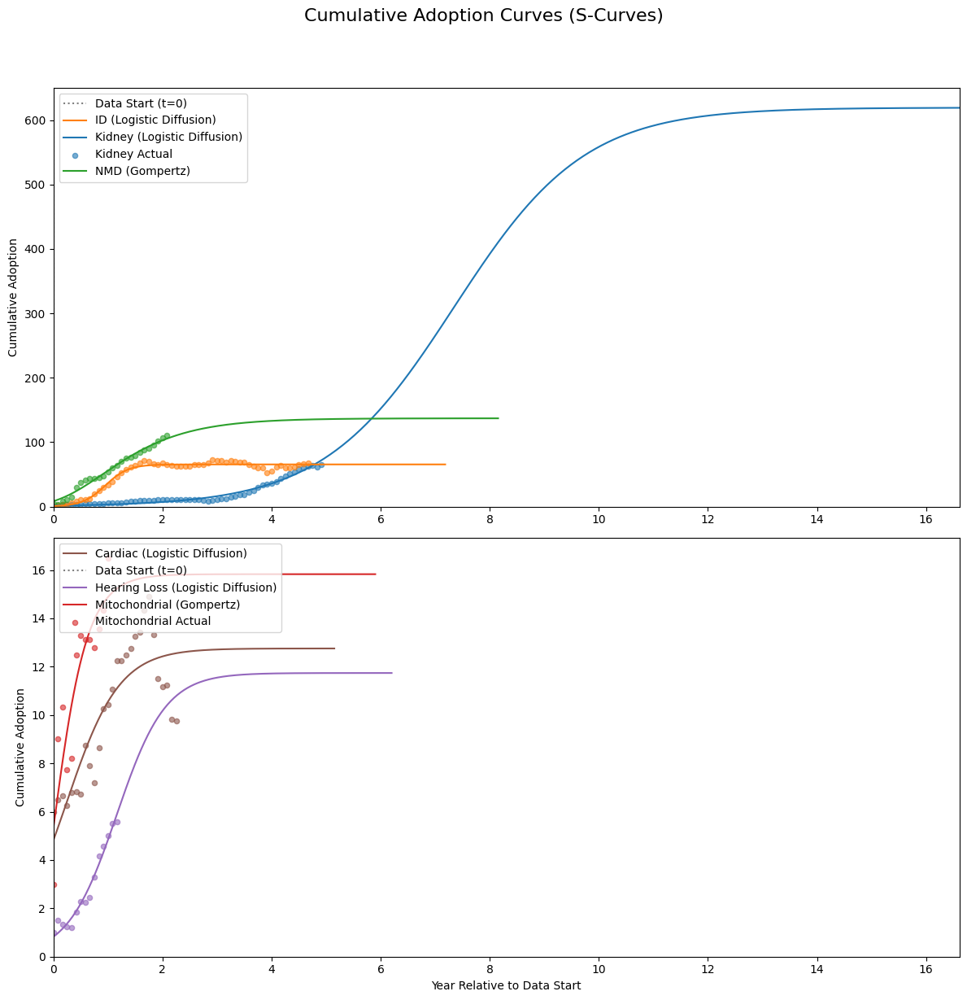

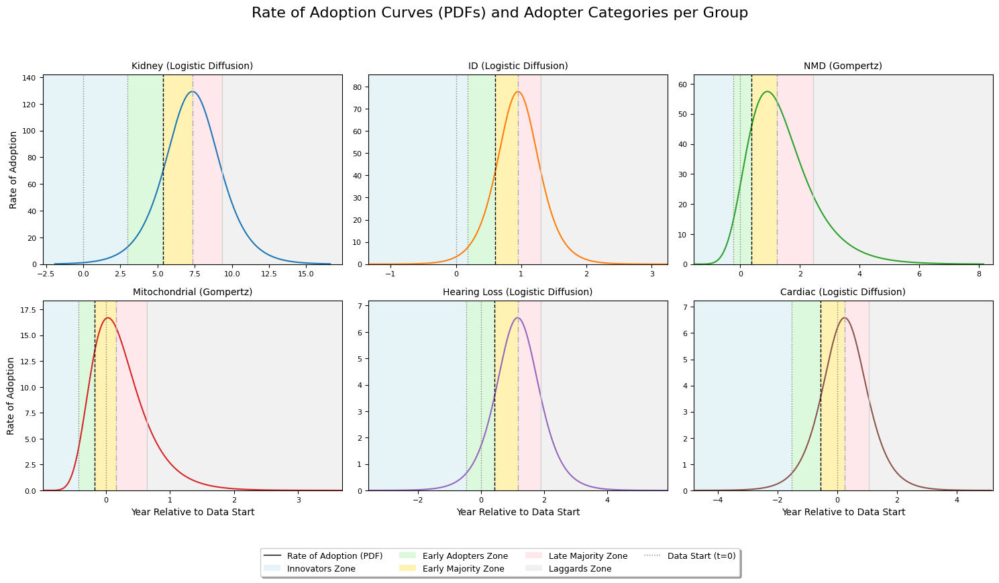

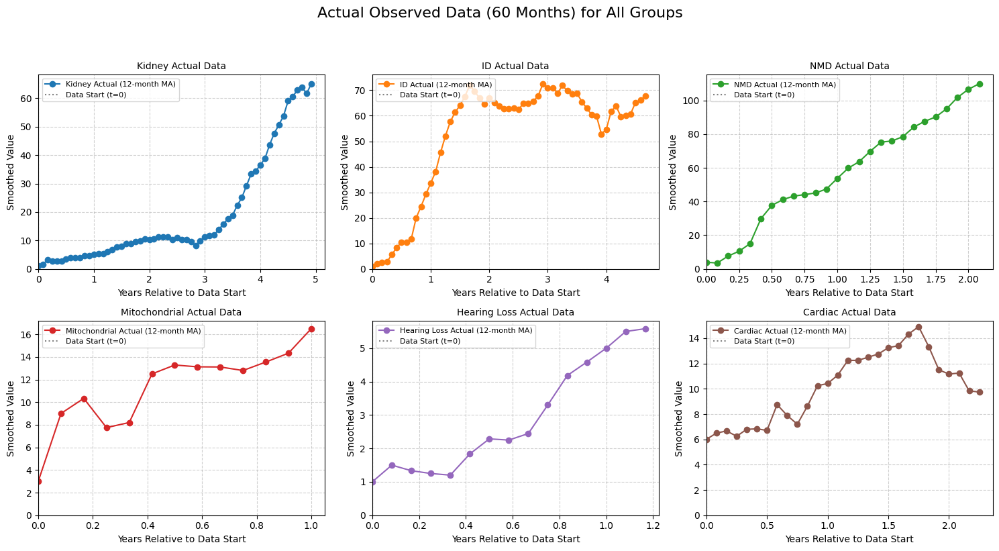


                       Aggregated Model Fit Metrics and Parameters



R-squared    MAE   RMSE     AIC     BIC  \
Group         Model                                                        
Kidney        Logistic Diffusion    0.9676   2.93   3.44  154.10  160.38   
              Gompertz              0.9659   3.04   3.52  159.09  167.47   
              Bass Diffusion        0.7821   7.81   8.90  270.38  278.75   
ID            Logistic Diffusion    0.9689   3.07   4.01  164.46  170.59   
              Gompertz              0.9606   3.62   4.51  179.82  187.99   
              Bass Diffusion       -2.6666  37.09  43.56  438.25  446.42   
NMD           Logistic Diffusion    0.9720   4.38   5.38   93.46   97.23   
              Gompertz              0.9804   3.76   4.50   86.20   91.24   
              Bass Diffusion        0.5929  17.06  20.50  165.06  170.09   
Mitochondrial Logistic Diffusion    0.7941   1.35   1.56   17.49   19.19   
              Gompertz              0.8014   1.33   1.53   19.02   21.28   
              Bass Diffusion        0.6354   1.80   2.07   26.92   29.18   
Hearing Loss  Logistic Diffusion    0.9689   0.24   0.28  -31.80  -29.67   
              Gompertz              0.9659   0.25   0.30  -28.42  -25.59   
              Bass Diffusion        0.8760   0.43   0.57   -9.07   -6.24   
Cardiac       Logistic Diffusion    0.7401   1.15   1.39   24.27   28.27   
              Gompertz              0.7230   1.20   1.43   28.05   33.38   
              Bass Diffusion       -3.3429   4.80   5.66  105.12  110.45   

                                 Market Potential (K/M/a)  \
Group         Model                                         
Kidney        Logistic Diffusion                   619.33   
              Gompertz                        41565483.31   
              Bass Diffusion                        68.34   
ID            Logistic Diffusion                    65.36   
              Gompertz                              65.56   
              Bass Diffusion                        76.13   
NMD           Logistic Diffusion                   117.13   
              Gompertz                             136.96   
              Bass Diffusion                       115.41   
Mitochondrial Logistic Diffusion                    15.40   
              Gompertz                              15.83   
              Bass Diffusion                        17.33   
Hearing Loss  Logistic Diffusion                    11.74   
              Gompertz                             115.14   
              Bass Diffusion                         5.86   
Cardiac       Logistic Diffusion                    12.75   
              Gompertz                              12.99   
              Bass Diffusion                        15.66   

                                 Est. Offset (t0/t_offset)       K     r  \
Group         Model                                                        
Kidney        Logistic Diffusion                      7.35  619.33  0.84   
              Gompertz                               10.00     NaN   NaN   
              Bass Diffusion                          3.43     NaN   NaN   
ID            Logistic Diffusion                      0.95   65.36  4.76   
              Gompertz                                0.65     NaN   NaN   
              Bass Diffusion                          2.25     NaN   NaN   
NMD           Logistic Diffusion                      1.07  117.13  2.07   
              Gompertz                                0.41     NaN   NaN   
              Bass Diffusion                          0.61     NaN   NaN   
Mitochondrial Logistic Diffusion                      0.15   15.40  3.80   
              Gompertz                               -0.10     NaN   NaN   
              Bass Diffusion                         -0.25     NaN   NaN   
Hearing Loss  Logistic Diffusion                      1.16   11.74  2.23   
              Gompertz                                2.30     NaN   NaN   
              Bass Diffusion                          0.05     NaN   NaN   

In [92]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from IPython.display import display # Import display for Jupyter rich output

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        # --- Global legend elements for the PDF plot ---
        global_pdf_legend_handles = []
        global_pdf_legend_labels = []

        # Add a dummy handle for the PDF curve itself (appears once in global legend)
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='black', lw=1))
        global_pdf_legend_labels.append("Rate of Adoption (PDF)")

        # Add dummy handles for shaded zones in chronological order
        ordered_adopter_categories = [
            'Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards'
        ]
        for category_name in ordered_adopter_categories:
            if category_name in adopter_category_shades:
                global_pdf_legend_handles.append(plt.Rectangle((0, 0), 1, 1, 
                                                              fc=adopter_category_shades[category_name]['color'], 
                                                              alpha=adopter_category_shades[category_name]['alpha']))
                global_pdf_legend_labels.append(f"{category_name} Zone")
        
        # Add a dummy handle for the Data Start (t=0) line
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='grey', linestyle=':', lw=1))
        global_pdf_legend_labels.append("Data Start (t=0)")

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            # Plot the PDF curve
            ax.plot(pdf_years, pdf_predicted, color=color) # Label removed as handled by global legend

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted)
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            for category_name in ordered_adopter_categories: # Use the defined order for shading
                details = adopter_categories_lines[category_name]
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])


            # Plot vertical lines (on top of shading for visibility)
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', lw=1) # No label, as it's in the global legend

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            # No individual legend for subplots now
            ax.tick_params(axis='x', labelsize=8)
            ax.tick_params(axis='y', labelsize=8)


        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        
        # Add the single legend for the entire figure at the bottom
        fig_pdf.legend(global_pdf_legend_handles, global_pdf_legend_labels, loc='lower center', 
                       bbox_to_anchor=(0.5, -0.05), # Position below the plots
                       ncol=math.ceil(len(global_pdf_legend_labels)/2), # Adjust number of columns based on entries
                       fontsize=9, frameon=True, fancybox=True, shadow=True)
        
        # Adjust layout to make space for the legend
        plt.tight_layout(rect=[0, 0.05, 1, 0.98]) # [left, bottom, right, top] - increased bottom margin
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in a single wide table ---
print("\n" + "="*80)
print("                       Aggregated Model Fit Metrics and Parameters")
print("="*80 + "\n")

master_table_data = []

# Define all possible parameter keys in a desired order for columns
all_possible_param_keys = ["K", "r", "t0", "a", "b", "c", "t_offset", "p", "q", "M", "p+q"]

# Main loop to collect data for the single table
for group, models_results in all_group_models_results.items():
    for model_name, res in models_results.items():
        row_data = {
            "Group": group,
            "Model": model_name,
            "R-squared": f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            "MAE": f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            "RMSE": f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            "AIC": f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            "BIC": f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A'),
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }

        # Add model-specific parameters
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                row_data["K"] = f"{res['FittedParameters'][0]:.2f}"
                row_data["r"] = f"{res['FittedParameters'][1]:.2f}"
                row_data["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                row_data["a"] = f"{res['FittedParameters'][0]:.2f}"
                row_data["b"] = f"{res['FittedParameters'][1]:.2f}"
                row_data["c"] = f"{res['FittedParameters'][2]:.2f}"
                row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
            elif model_name == "Bass Diffusion":
                row_data["p"] = f"{res['FittedParameters'][0]:.4f}"
                row_data["q"] = f"{res['FittedParameters'][1]:.4f}"
                row_data["M"] = f"{res['FittedParameters'][2]:.2f}"
                row_data["t_offset"] = f"{res['FittedParameters'][3]:.2f}"
                row_data["p+q"] = f"{res['p_plus_q']:.4f}"
        
        master_table_data.append(row_data)

# Define the final column order for the DataFrame
final_columns_order = [
    "R-squared", "MAE", "RMSE", "AIC", "BIC",
    "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"
] + all_possible_param_keys + ["Adopter Times"]

# Create DataFrame
df_results = pd.DataFrame(master_table_data)

# Fill any missing parameter columns that might not exist for all models
for col in all_possible_param_keys:
    if col not in df_results.columns:
        df_results[col] = 'N/A'

# Reorder columns to ensure consistent display
df_results = df_results[['Group', 'Model'] + final_columns_order]

# Set MultiIndex
df_results.set_index(['Group', 'Model'], inplace=True)

# Display the DataFrame
display(df_results)
print("\n")


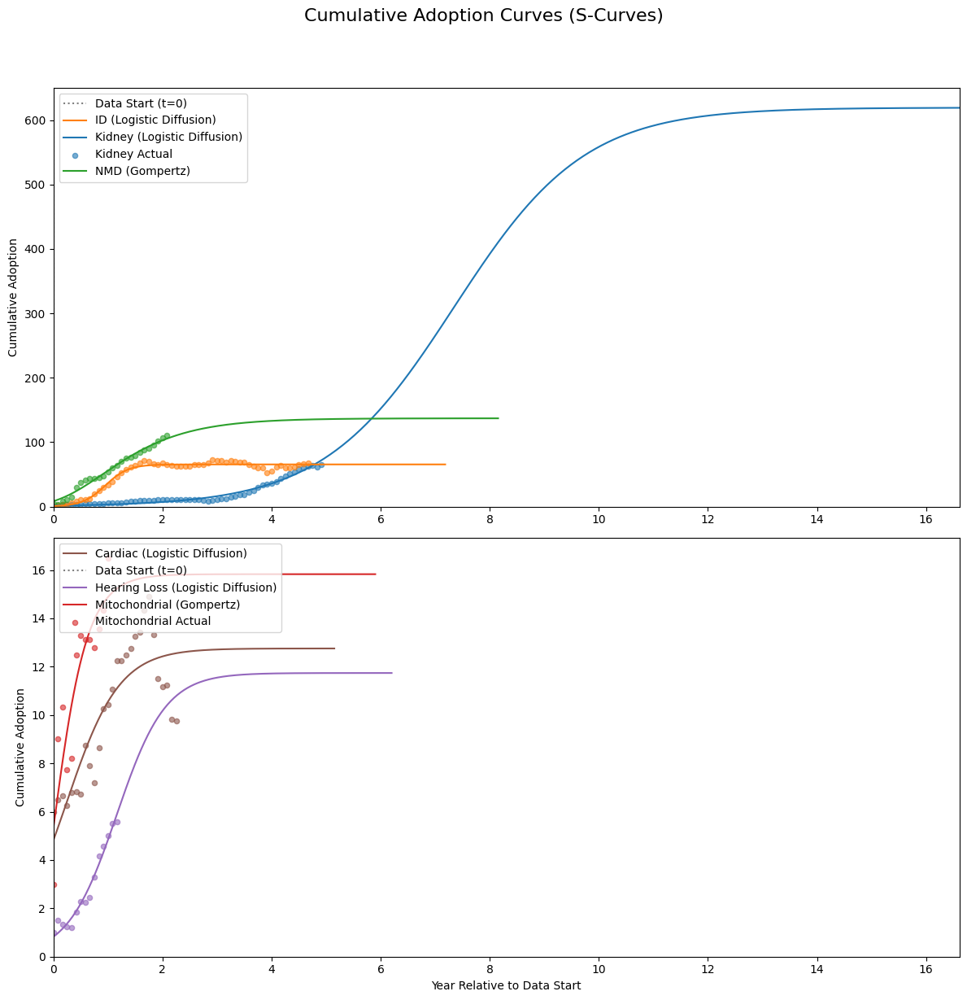

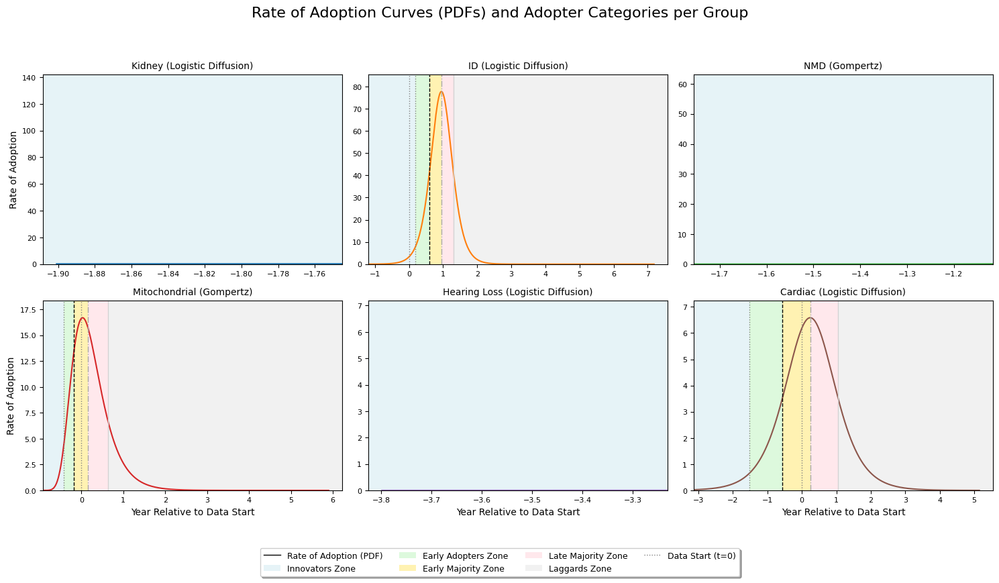

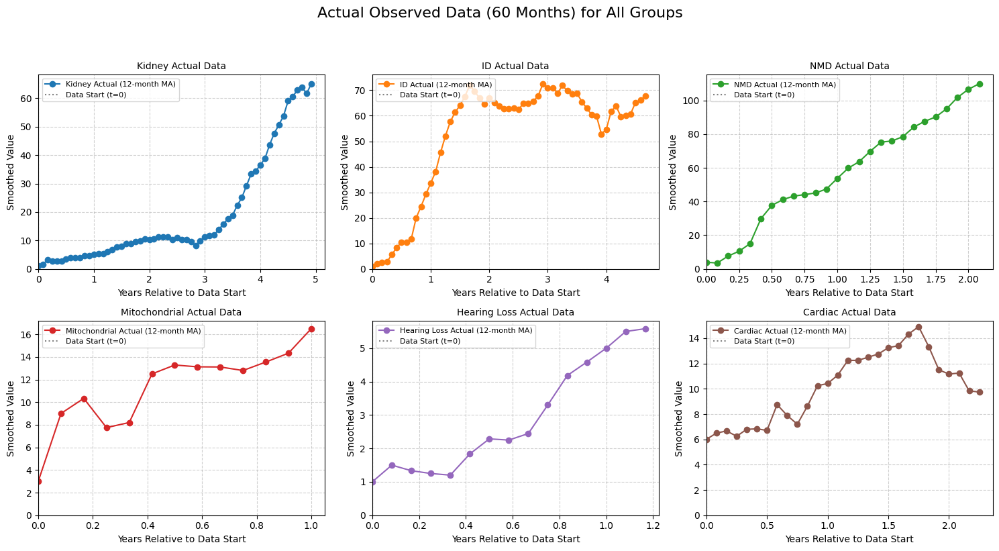


                       Aggregated Model Fit Metrics and Parameters

<h3>Goodness-of-Fit Metrics:</h3>


R-squared    MAE   RMSE     AIC     BIC
Group         Model                                                     
Kidney        Logistic Diffusion    0.9676   2.93   3.44  154.10  160.38
              Gompertz              0.9659   3.04   3.52  159.09  167.47
              Bass Diffusion        0.7821   7.81   8.90  270.38  278.75
ID            Logistic Diffusion    0.9689   3.07   4.01  164.46  170.59
              Gompertz              0.9606   3.62   4.51  179.82  187.99
              Bass Diffusion       -2.6666  37.09  43.56  438.25  446.42
NMD           Logistic Diffusion    0.9720   4.38   5.38   93.46   97.23
              Gompertz              0.9804   3.76   4.50   86.20   91.24
              Bass Diffusion        0.5929  17.06  20.50  165.06  170.09
Mitochondrial Logistic Diffusion    0.7941   1.35   1.56   17.49   19.19
              Gompertz              0.8014   1.33   1.53   19.02   21.28
              Bass Diffusion        0.6354   1.80   2.07   26.92   29.18
Hearing Loss  Logistic Diffusion    0.9689   0.24   0.28  -31.80  -29.67
              Gompertz              0.9659   0.25   0.30  -28.42  -25.59
              Bass Diffusion        0.8760   0.43   0.57   -9.07   -6.24
Cardiac       Logistic Diffusion    0.7401   1.15   1.39   24.27   28.27
              Gompertz              0.7230   1.20   1.43   28.05   33.38
              Bass Diffusion       -3.3429   4.80   5.66  105.12  110.45



<h3>Estimated Parameters and Adopter Category Timings:</h3>


Market Potential (K/M/a)  \
Group         Model                                         
Kidney        Logistic Diffusion                   619.33   
              Gompertz                        41565483.31   
              Bass Diffusion                        68.34   
ID            Logistic Diffusion                    65.36   
              Gompertz                              65.56   
              Bass Diffusion                        76.13   
NMD           Logistic Diffusion                   117.13   
              Gompertz                             136.96   
              Bass Diffusion                       115.41   
Mitochondrial Logistic Diffusion                    15.40   
              Gompertz                              15.83   
              Bass Diffusion                        17.33   
Hearing Loss  Logistic Diffusion                    11.74   
              Gompertz                             115.14   
              Bass Diffusion                         5.86   
Cardiac       Logistic Diffusion                    12.75   
              Gompertz                              12.99   
              Bass Diffusion                        15.66   

                                 Est. Offset (t0/t_offset)       K     r  \
Group         Model                                                        
Kidney        Logistic Diffusion                      7.35  619.33  0.84   
              Gompertz                               10.00     N/A   N/A   
              Bass Diffusion                          3.43     N/A   N/A   
ID            Logistic Diffusion                      0.95   65.36  4.76   
              Gompertz                                0.65     N/A   N/A   
              Bass Diffusion                          2.25     N/A   N/A   
NMD           Logistic Diffusion                      1.07  117.13  2.07   
              Gompertz                                0.41     N/A   N/A   
              Bass Diffusion                          0.61     N/A   N/A   
Mitochondrial Logistic Diffusion                      0.15   15.40  3.80   
              Gompertz                               -0.10     N/A   N/A   
              Bass Diffusion                         -0.25     N/A   N/A   
Hearing Loss  Logistic Diffusion                      1.16   11.74  2.23   
              Gompertz                                2.30     N/A   N/A   
              Bass Diffusion                          0.05     N/A   N/A   
Cardiac       Logistic Diffusion                      0.24   12.75  2.07   
              Gompertz                               -0.20     N/A   N/A   
              Bass Diffusion                          0.51     N/A   N/A   

                                    t0            a      b     c t_offset  \
Group         Model                                                         
Kidney        Logistic Diffusion  7.35          N/A    N/A   N/A      N/A   
              Gompertz             N/A  41565483.31  10.00  0.06    10.00   
              Bass Diffusion       N/A          N/A    N/A   N/A     3.43   
ID            Logistic Diffusion  0.95          N/A    N/A   N/A      N/A   
              Gompertz             N/A        65.56   1.73  3.40     0.65   
              Bass Diffusion       N/A          N/A    N/A   N/A     2.25   
NMD           Logistic Diffusion  1.07          N/A    N/A   N/A      N/A   
              Gompertz             N/A       136.96   1.76  1.14     0.41   
              Bass Diffusion       N/A          N/A    N/A   N/A     0.61   
Mitochondrial Logistic Diffusion  0.15          N/A    N/A   N/A      N/A   
              Gompertz             N/A        15.83   1.46  2.87    -0.10   
              Bass Diffusion       N/A          N/A    N/A   N/A    -0.25   
Hearing Loss  Logistic Diffusion  1.16          N/A    N/A   N/A      N/A   
              Gompertz             N/A       115.14   1.80  0.44     2.30   
              Bass Diffusion       N/A          N/A    N/A 

In [93]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from IPython.display import display # Import display for Jupyter rich output

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        # --- Global legend elements for the PDF plot ---
        global_pdf_legend_handles = []
        global_pdf_legend_labels = []

        # Add a dummy handle for the PDF curve itself (appears once in global legend)
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='black', lw=1))
        global_pdf_legend_labels.append("Rate of Adoption (PDF)")

        # Add dummy handles for shaded zones in chronological order
        ordered_adopter_categories = [
            'Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards'
        ]
        for category_name in ordered_adopter_categories:
            if category_name in adopter_category_shades:
                global_pdf_legend_handles.append(plt.Rectangle((0, 0), 1, 1, 
                                                              fc=adopter_category_shades[category_name]['color'], 
                                                              alpha=adopter_category_shades[category_name]['alpha']))
                global_pdf_legend_labels.append(f"{category_name} Zone")
        
        # Add a dummy handle for the Data Start (t=0) line
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='grey', linestyle=':', lw=1))
        global_pdf_legend_labels.append("Data Start (t=0)")

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            # Plot the PDF curve
            ax.plot(pdf_years, pdf_predicted, color=color) # Label removed as handled by global legend

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(normalized_pdf) # corrected from pdf_predicted to normalized_pdf
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            for category_name in ordered_adopter_categories: # Use the defined order for shading
                details = adopter_categories_lines[category_name]
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])


            # Plot vertical lines (on top of shading for visibility)
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', lw=1) # No label, as it's in the global legend

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            # No individual legend for subplots now
            ax.tick_params(axis='x', labelsize=8)
            ax.tick_params(axis='y', labelsize=8)


        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        
        # Add the single legend for the entire figure at the bottom
        fig_pdf.legend(global_pdf_legend_handles, global_pdf_legend_labels, loc='lower center', 
                       bbox_to_anchor=(0.5, -0.05), # Position below the plots
                       ncol=math.ceil(len(global_pdf_legend_labels)/2), # Adjust number of columns based on entries
                       fontsize=9, frameon=True, fancybox=True, shadow=True)
        
        # Adjust layout to make space for the legend
        plt.tight_layout(rect=[0, 0.05, 1, 0.98]) # [left, bottom, right, top] - increased bottom margin
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in separate wide tables ---
print("\n" + "="*80)
print("                       Aggregated Model Fit Metrics and Parameters")
print("="*80 + "\n")

master_table_data = []

# Main loop to collect data for the tables
for group, models_results in all_group_models_results.items():
    for model_name, res in models_results.items():
        row_data = {
            "Group": group,
            "Model": model_name,
            "R-squared": f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            "MAE": f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            "RMSE": f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            "AIC": f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            "BIC": f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A'),
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A',
            "Adopter Times": ", ".join([f"{cat}: {t:.2f} yrs" for cat, t in res['AdopterTimes'].items() if t is not None]) if res['AdopterTimes'] else 'N/A'
        }

        # Add model-specific parameters, initializing if not present
        specific_params = {}
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                specific_params["K"] = f"{res['FittedParameters'][0]:.2f}"
                specific_params["r"] = f"{res['FittedParameters'][1]:.2f}"
                specific_params["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                specific_params["a"] = f"{res['FittedParameters'][0]:.2f}"
                specific_params["b"] = f"{res['FittedParameters'][1]:.2f}"
                specific_params["c"] = f"{res['FittedParameters'][2]:.2f}"
                specific_params["t_offset_specific"] = f"{res['FittedParameters'][3]:.2f}" # Renamed to avoid clash
            elif model_name == "Bass Diffusion":
                specific_params["p"] = f"{res['FittedParameters'][0]:.4f}"
                specific_params["q"] = f"{res['FittedParameters'][1]:.4f}"
                specific_params["M_specific"] = f"{res['FittedParameters'][2]:.2f}" # Renamed to avoid clash
                specific_params["t_offset_specific"] = f"{res['FittedParameters'][3]:.2f}" # Renamed
                specific_params["p+q"] = f"{res['p_plus_q']:.4f}"
        
        row_data.update(specific_params)
        master_table_data.append(row_data)

# Create DataFrame for Goodness-of-Fit Metrics
metrics_columns = ["Group", "Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
df_metrics = pd.DataFrame(master_table_data, columns=metrics_columns)
df_metrics.set_index(['Group', 'Model'], inplace=True)

print("<h3>Goodness-of-Fit Metrics:</h3>")
display(df_metrics)
print("\n") # Add a newline for separation

# Define columns for Parameters and Adopter Category Timings
# Collect all possible specific parameter keys dynamically
all_specific_param_keys_in_data = set()
for row in master_table_data:
    for key in ["K", "r", "t0", "a", "b", "c", "t_offset_specific", "p", "q", "M_specific", "p+q"]:
        if key in row:
            all_specific_param_keys_in_data.add(key)

# Order specific parameter keys for consistent column display
ordered_specific_param_keys = ["K", "r", "t0", "a", "b", "c", "t_offset_specific", "p", "q", "M_specific", "p+q"]
final_specific_param_columns = [col for col in ordered_specific_param_keys if col in all_specific_param_keys_in_data]

# Define the final column order for the Parameters table
params_columns = ["Group", "Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"] + final_specific_param_columns + ["Adopter Times"]

# Create DataFrame for Parameters and Adopter Category Timings
# Need to reconstruct data for this specific DataFrame to ensure all columns exist and are in order
params_df_data = []
for row in master_table_data:
    new_row = {col: row.get(col, 'N/A') for col in params_columns}
    params_df_data.append(new_row)

df_params = pd.DataFrame(params_df_data, columns=params_columns)
df_params.set_index(['Group', 'Model'], inplace=True)

# Rename specific columns for display
df_params.rename(columns={'t_offset_specific': 't_offset', 'M_specific': 'M'}, inplace=True)

print("<h3>Estimated Parameters and Adopter Category Timings:</h3>")
display(df_params)
print("\n")


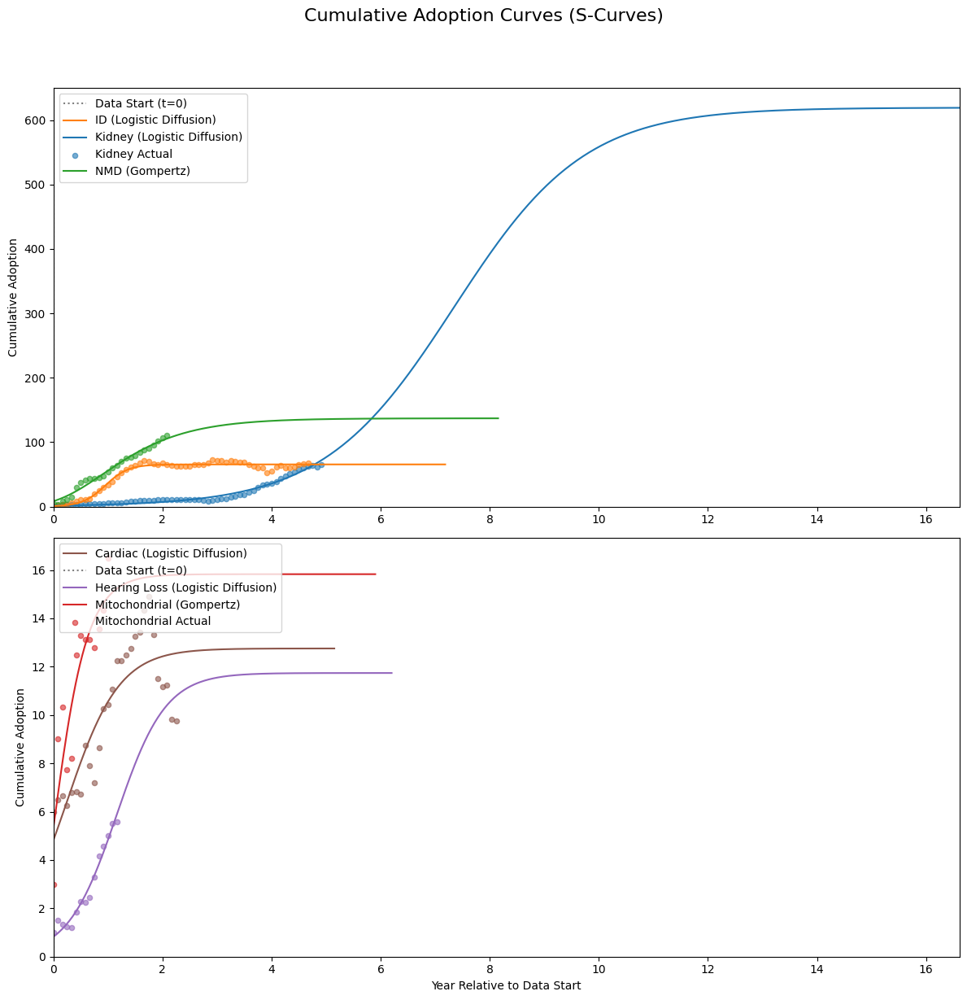

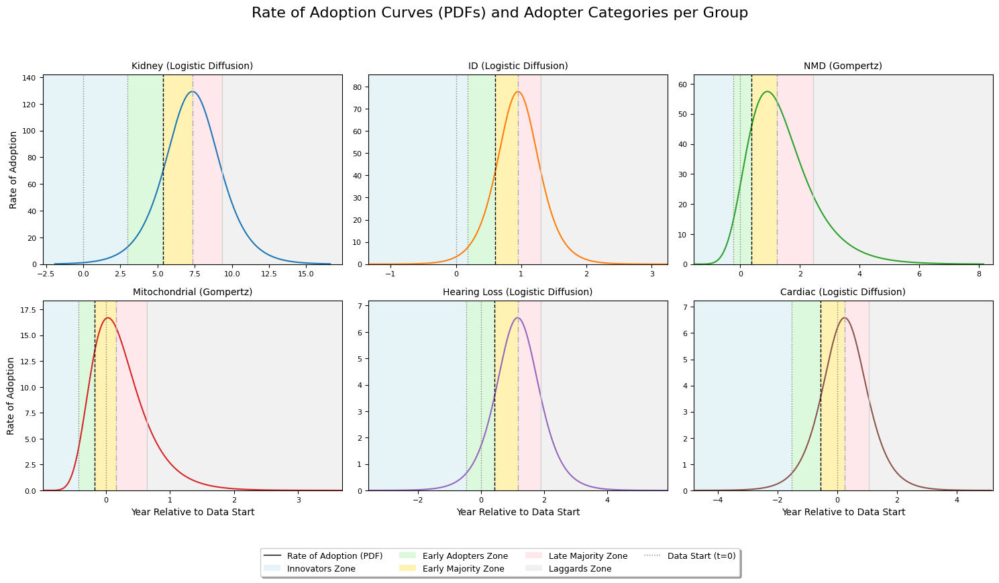

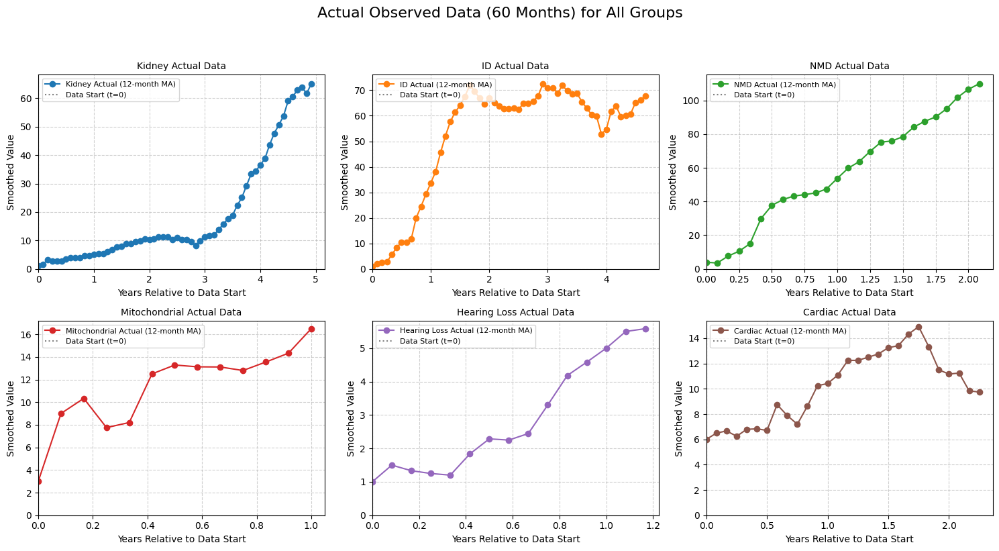


                       Aggregated Model Fit Metrics and Parameters

<h3>Goodness-of-Fit Metrics:</h3>


R-squared    MAE   RMSE     AIC     BIC
Group         Model                                                     
Kidney        Logistic Diffusion    0.9676   2.93   3.44  154.10  160.38
              Gompertz              0.9659   3.04   3.52  159.09  167.47
              Bass Diffusion        0.7821   7.81   8.90  270.38  278.75
ID            Logistic Diffusion    0.9689   3.07   4.01  164.46  170.59
              Gompertz              0.9606   3.62   4.51  179.82  187.99
              Bass Diffusion       -2.6666  37.09  43.56  438.25  446.42
NMD           Logistic Diffusion    0.9720   4.38   5.38   93.46   97.23
              Gompertz              0.9804   3.76   4.50   86.20   91.24
              Bass Diffusion        0.5929  17.06  20.50  165.06  170.09
Mitochondrial Logistic Diffusion    0.7941   1.35   1.56   17.49   19.19
              Gompertz              0.8014   1.33   1.53   19.02   21.28
              Bass Diffusion        0.6354   1.80   2.07   26.92   29.18
Hearing Loss  Logistic Diffusion    0.9689   0.24   0.28  -31.80  -29.67
              Gompertz              0.9659   0.25   0.30  -28.42  -25.59
              Bass Diffusion        0.8760   0.43   0.57   -9.07   -6.24
Cardiac       Logistic Diffusion    0.7401   1.15   1.39   24.27   28.27
              Gompertz              0.7230   1.20   1.43   28.05   33.38
              Bass Diffusion       -3.3429   4.80   5.66  105.12  110.45



<h3>Estimated Parameters:</h3>


Market Potential (K/M/a)  \
Group         Model                                         
Kidney        Logistic Diffusion                   619.33   
              Gompertz                        41565483.31   
              Bass Diffusion                        68.34   
ID            Logistic Diffusion                    65.36   
              Gompertz                              65.56   
              Bass Diffusion                        76.13   
NMD           Logistic Diffusion                   117.13   
              Gompertz                             136.96   
              Bass Diffusion                       115.41   
Mitochondrial Logistic Diffusion                    15.40   
              Gompertz                              15.83   
              Bass Diffusion                        17.33   
Hearing Loss  Logistic Diffusion                    11.74   
              Gompertz                             115.14   
              Bass Diffusion                         5.86   
Cardiac       Logistic Diffusion                    12.75   
              Gompertz                              12.99   
              Bass Diffusion                        15.66   

                                 Est. Offset (t0/t_offset)       K     r  \
Group         Model                                                        
Kidney        Logistic Diffusion                      7.35  619.33  0.84   
              Gompertz                               10.00     N/A   N/A   
              Bass Diffusion                          3.43     N/A   N/A   
ID            Logistic Diffusion                      0.95   65.36  4.76   
              Gompertz                                0.65     N/A   N/A   
              Bass Diffusion                          2.25     N/A   N/A   
NMD           Logistic Diffusion                      1.07  117.13  2.07   
              Gompertz                                0.41     N/A   N/A   
              Bass Diffusion                          0.61     N/A   N/A   
Mitochondrial Logistic Diffusion                      0.15   15.40  3.80   
              Gompertz                               -0.10     N/A   N/A   
              Bass Diffusion                         -0.25     N/A   N/A   
Hearing Loss  Logistic Diffusion                      1.16   11.74  2.23   
              Gompertz                                2.30     N/A   N/A   
              Bass Diffusion                          0.05     N/A   N/A   
Cardiac       Logistic Diffusion                      0.24   12.75  2.07   
              Gompertz                               -0.20     N/A   N/A   
              Bass Diffusion                          0.51     N/A   N/A   

                                    t0            a      b     c t_offset  \
Group         Model                                                         
Kidney        Logistic Diffusion  7.35          N/A    N/A   N/A      N/A   
              Gompertz             N/A  41565483.31  10.00  0.06    10.00   
              Bass Diffusion       N/A          N/A    N/A   N/A     3.43   
ID            Logistic Diffusion  0.95          N/A    N/A   N/A      N/A   
              Gompertz             N/A        65.56   1.73  3.40     0.65   
              Bass Diffusion       N/A          N/A    N/A   N/A     2.25   
NMD           Logistic Diffusion  1.07          N/A    N/A   N/A      N/A   
              Gompertz             N/A       136.96   1.76  1.14     0.41   
              Bass Diffusion       N/A          N/A    N/A   N/A     0.61   
Mitochondrial Logistic Diffusion  0.15          N/A    N/A   N/A      N/A   
              Gompertz             N/A        15.83   1.46  2.87    -0.10   
              Bass Diffusion       N/A          N/A    N/A   N/A    -0.25   
Hearing Loss  Logistic Diffusion  1.16          N/A    N/A   N/A      N/A   
              Gompertz             N/A       115.14   1.80  0.44     2.30   
              Bass Diffusion       N/A          N/A    N/A 



<h3>Adopter Category Timings:</h3>


Innovators Early Adopters Early Majority  \
Group         Model                                                         
Kidney        Logistic Diffusion   2.96 yrs       5.36 yrs       7.35 yrs   
              Gompertz            27.92 yrs      40.49 yrs      57.96 yrs   
              Bass Diffusion       3.45 yrs       3.59 yrs       3.97 yrs   
ID            Logistic Diffusion   0.18 yrs       0.60 yrs       0.95 yrs   
              Gompertz             0.43 yrs       0.64 yrs       0.92 yrs   
              Bass Diffusion       2.27 yrs       2.41 yrs       2.79 yrs   
NMD           Logistic Diffusion  -0.70 yrs       0.27 yrs       1.07 yrs   
              Gompertz            -0.24 yrs       0.38 yrs       1.23 yrs   
              Bass Diffusion       0.63 yrs       0.77 yrs       1.15 yrs   
Mitochondrial Logistic Diffusion  -0.82 yrs      -0.29 yrs       0.15 yrs   
              Gompertz            -0.43 yrs      -0.18 yrs       0.16 yrs   
              Bass Diffusion      -0.23 yrs      -0.09 yrs       0.29 yrs   
Hearing Loss  Logistic Diffusion  -0.48 yrs       0.42 yrs       1.16 yrs   
              Gompertz             0.66 yrs       2.27 yrs       4.50 yrs   
              Bass Diffusion       0.07 yrs       0.21 yrs       0.59 yrs   
Cardiac       Logistic Diffusion  -1.53 yrs      -0.56 yrs       0.24 yrs   
              Gompertz            -0.85 yrs      -0.39 yrs       0.24 yrs   
              Bass Diffusion       0.53 yrs       0.67 yrs       1.05 yrs   

                                 Late Majority  Laggards  
Group         Model                                       
Kidney        Logistic Diffusion      9.33 yrs       N/A  
              Gompertz               82.76 yrs       N/A  
              Bass Diffusion          4.40 yrs  4.62 yrs  
ID            Logistic Diffusion      1.30 yrs       N/A  
              Gompertz                1.33 yrs       N/A  
              Bass Diffusion          3.21 yrs  3.43 yrs  
NMD           Logistic Diffusion      1.87 yrs       N/A  
              Gompertz                2.44 yrs       N/A  
              Bass Diffusion          1.58 yrs  1.80 yrs  
Mitochondrial Logistic Diffusion      0.58 yrs       N/A  
              Gompertz                0.64 yrs       N/A  
              Bass Diffusion          0.72 yrs  0.94 yrs  
Hearing Loss  Logistic Diffusion      1.90 yrs       N/A  
              Gompertz                7.67 yrs       N/A  
              Bass Diffusion          1.01 yrs  1.23 yrs  
Cardiac       Logistic Diffusion      1.04 yrs       N/A  
              Gompertz                1.13 yrs       N/A  
              Bass Diffusion          1.47 yrs  1.69 yrs

In [94]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from IPython.display import display # Import display for Jupyter rich output

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        # --- Global legend elements for the PDF plot ---
        global_pdf_legend_handles = []
        global_pdf_legend_labels = []

        # Add a dummy handle for the PDF curve itself (appears once in global legend)
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='black', lw=1))
        global_pdf_legend_labels.append("Rate of Adoption (PDF)")

        # Add dummy handles for shaded zones in chronological order
        ordered_adopter_categories = [
            'Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards'
        ]
        for category_name in ordered_adopter_categories:
            if category_name in adopter_category_shades:
                global_pdf_legend_handles.append(plt.Rectangle((0, 0), 1, 1, 
                                                              fc=adopter_category_shades[category_name]['color'], 
                                                              alpha=adopter_category_shades[category_name]['alpha']))
                global_pdf_legend_labels.append(f"{category_name} Zone")
        
        # Add a dummy handle for the Data Start (t=0) line
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='grey', linestyle=':', lw=1))
        global_pdf_legend_labels.append("Data Start (t=0)")

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            # Plot the PDF curve
            ax.plot(pdf_years, pdf_predicted, color=color) # Label removed as handled by global legend

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted) # corrected from pdf_predicted to normalized_pdf
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            for category_name in ordered_adopter_categories: # Use the defined order for shading
                details = adopter_categories_lines[category_name]
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])


            # Plot vertical lines (on top of shading for visibility)
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', lw=1) # No label, as it's in the global legend

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            # No individual legend for subplots now
            ax.tick_params(axis='x', labelsize=8)
            ax.tick_params(axis='y', labelsize=8)


        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        
        # Add the single legend for the entire figure at the bottom
        fig_pdf.legend(global_pdf_legend_handles, global_pdf_legend_labels, loc='lower center', 
                       bbox_to_anchor=(0.5, -0.05), # Position below the plots
                       ncol=math.ceil(len(global_pdf_legend_labels)/2), # Adjust number of columns based on entries
                       fontsize=9, frameon=True, fancybox=True, shadow=True)
        
        # Adjust layout to make space for the legend
        plt.tight_layout(rect=[0, 0.05, 1, 0.98]) # [left, bottom, right, top] - increased bottom margin
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in separate wide tables ---
print("\n" + "="*80)
print("                       Aggregated Model Fit Metrics and Parameters")
print("="*80 + "\n")

# Lists to hold data for each DataFrame
metrics_data_list = []
params_data_list = []
adopter_times_data_list = []

# Main loop to collect data for the tables
for group, models_results in all_group_models_results.items():
    for model_name, res in models_results.items():
        # Goodness-of-Fit Metrics data
        metrics_data_list.append({
            "Group": group,
            "Model": model_name,
            "R-squared": f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            "MAE": f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            "RMSE": f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            "AIC": f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            "BIC": f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        })

        # Parameters data
        params_row = {
            "Group": group,
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        }
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                params_row["K"] = f"{res['FittedParameters'][0]:.2f}"
                params_row["r"] = f"{res['FittedParameters'][1]:.2f}"
                params_row["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                params_row["a"] = f"{res['FittedParameters'][0]:.2f}"
                params_row["b"] = f"{res['FittedParameters'][1]:.2f}"
                params_row["c"] = f"{res['FittedParameters'][2]:.2f}"
                params_row["t_offset"] = f"{res['FittedParameters'][3]:.2f}" # Keep consistent naming for t_offset here
            elif model_name == "Bass Diffusion":
                params_row["p"] = f"{res['FittedParameters'][0]:.4f}"
                params_row["q"] = f"{res['FittedParameters'][1]:.4f}"
                params_row["M"] = f"{res['FittedParameters'][2]:.2f}"
                params_row["t_offset"] = f"{res['FittedParameters'][3]:.2f}" # Keep consistent naming for t_offset here
                params_row["p+q"] = f"{res['p_plus_q']:.4f}"
        params_data_list.append(params_row)

        # Adopter Category Timings data
        adopter_times_row = {
            "Group": group,
            "Model": model_name
        }
        ordered_adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']
        for category_name in ordered_adopter_categories:
            time_val = res['AdopterTimes'].get(category_name)
            adopter_times_row[category_name] = f"{time_val:.2f} yrs" if time_val is not None else 'N/A'
        adopter_times_data_list.append(adopter_times_row)

# --- Create and Display Goodness-of-Fit Metrics Table ---
metrics_columns = ["Group", "Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
df_metrics = pd.DataFrame(metrics_data_list, columns=metrics_columns)
df_metrics.set_index(['Group', 'Model'], inplace=True)

print("<h3>Goodness-of-Fit Metrics:</h3>")
display(df_metrics)
print("\n") # Add a newline for separation

# --- Create and Display Estimated Parameters Table ---
# Collect all possible specific parameter keys dynamically for parameters table
all_specific_param_keys_params = set()
for row in params_data_list:
    for key in ["K", "r", "t0", "a", "b", "c", "t_offset", "p", "q", "M", "p+q"]: # Include 'M' and 't_offset'
        if key in row:
            all_specific_param_keys_params.add(key)

ordered_specific_param_keys_params = ["K", "r", "t0", "a", "b", "c", "t_offset", "p", "q", "M", "p+q"]
final_specific_param_columns_params = [col for col in ordered_specific_param_keys_params if col in all_specific_param_keys_params]

params_columns = ["Group", "Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"] + final_specific_param_columns_params

# Reconstruct params_df_data to ensure all columns exist and are in order
params_df_final_data = []
for row_dict in params_data_list:
    new_row = {col: row_dict.get(col, 'N/A') for col in params_columns}
    params_df_final_data.append(new_row)

df_params = pd.DataFrame(params_df_final_data, columns=params_columns)
df_params.set_index(['Group', 'Model'], inplace=True)

print("<h3>Estimated Parameters:</h3>")
display(df_params)
print("\n")

# --- Create and Display Adopter Category Timings Table ---
adopter_times_columns = ["Group", "Model", "Innovators", "Early Adopters", "Early Majority", "Late Majority", "Laggards"]
df_adopter_times = pd.DataFrame(adopter_times_data_list, columns=adopter_times_columns)
df_adopter_times.set_index(['Group', 'Model'], inplace=True)

print("<h3>Adopter Category Timings:</h3>")
display(df_adopter_times)
print("\n")


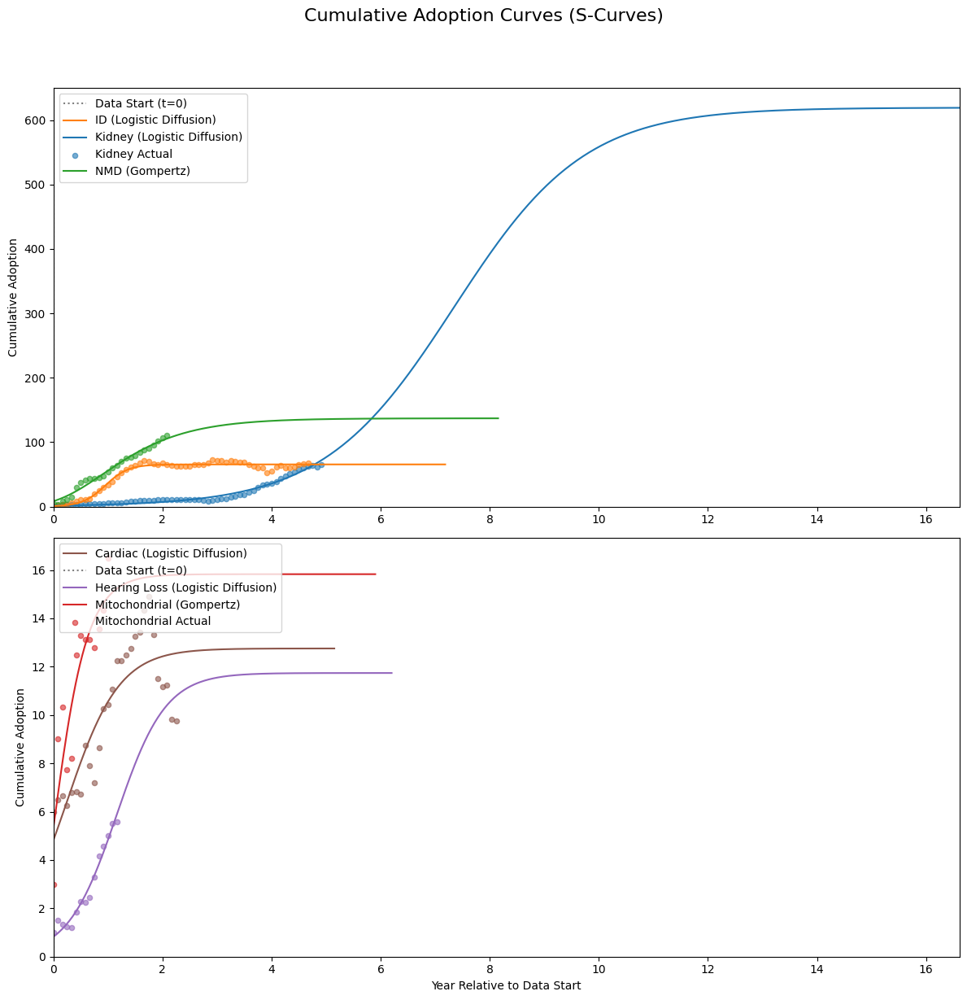

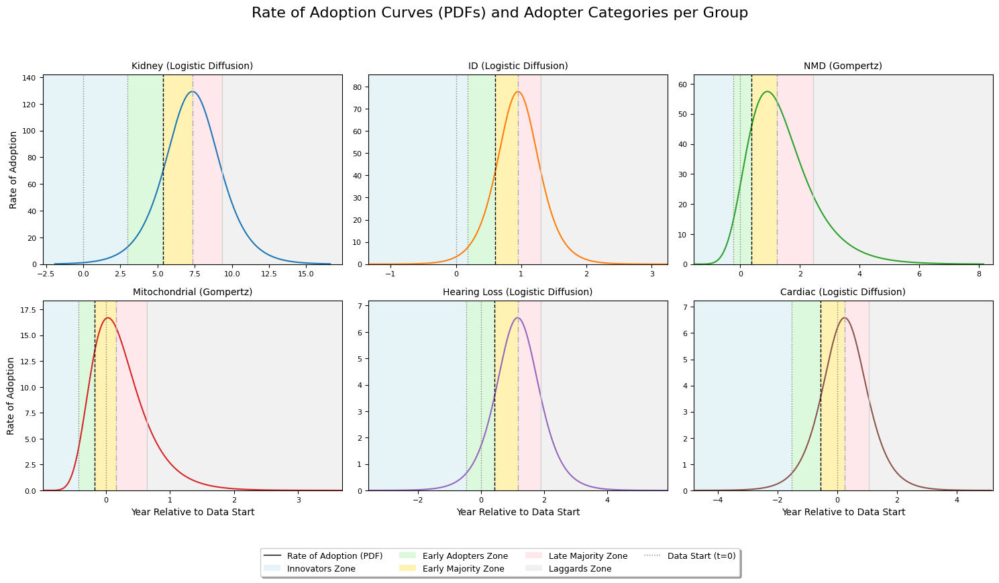

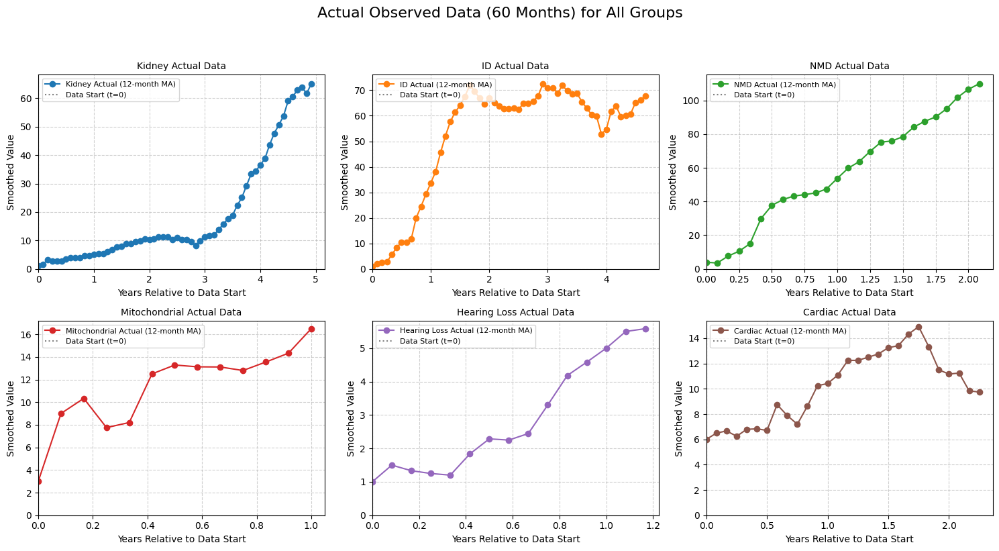


                       Aggregated Model Fit Metrics and Parameters

<h3>Goodness-of-Fit Metrics:</h3>


R-squared    MAE   RMSE     AIC     BIC
Group         Model                                                     
Kidney        Logistic Diffusion    0.9676   2.93   3.44  154.10  160.38
              Gompertz              0.9659   3.04   3.52  159.09  167.47
              Bass Diffusion        0.7821   7.81   8.90  270.38  278.75
ID            Logistic Diffusion    0.9689   3.07   4.01  164.46  170.59
              Gompertz              0.9606   3.62   4.51  179.82  187.99
              Bass Diffusion       -2.6666  37.09  43.56  438.25  446.42
NMD           Logistic Diffusion    0.9720   4.38   5.38   93.46   97.23
              Gompertz              0.9804   3.76   4.50   86.20   91.24
              Bass Diffusion        0.5929  17.06  20.50  165.06  170.09
Mitochondrial Logistic Diffusion    0.7941   1.35   1.56   17.49   19.19
              Gompertz              0.8014   1.33   1.53   19.02   21.28
              Bass Diffusion        0.6354   1.80   2.07   26.92   29.18
Hearing Loss  Logistic Diffusion    0.9689   0.24   0.28  -31.80  -29.67
              Gompertz              0.9659   0.25   0.30  -28.42  -25.59
              Bass Diffusion        0.8760   0.43   0.57   -9.07   -6.24
Cardiac       Logistic Diffusion    0.7401   1.15   1.39   24.27   28.27
              Gompertz              0.7230   1.20   1.43   28.05   33.38
              Bass Diffusion       -3.3429   4.80   5.66  105.12  110.45



<h4>Best Fitting Model (Goodness-of-Fit Metrics):</h4>


,,R-squared,MAE,RMSE,AIC,BIC
Group,Model,,,,,
Kidney,Logistic Diffusion,0.9676,2.93,3.44,154.10,160.38
ID,Logistic Diffusion,0.9689,3.07,4.01,164.46,170.59
NMD,Gompertz,0.9804,3.76,4.50,86.20,91.24
Mitochondrial,Gompertz,0.8014,1.33,1.53,19.02,21.28
Hearing Loss,Logistic Diffusion,0.9689,0.24,0.28,-31.80,-29.67
Cardiac,Logistic Diffusion,0.7401,1.15,1.39,24.27,28.27




<h3>Estimated Parameters:</h3>


Market Potential (K/M/a)  \
Group         Model                                         
Kidney        Logistic Diffusion                   619.33   
              Gompertz                        41565483.31   
              Bass Diffusion                        68.34   
ID            Logistic Diffusion                    65.36   
              Gompertz                              65.56   
              Bass Diffusion                        76.13   
NMD           Logistic Diffusion                   117.13   
              Gompertz                             136.96   
              Bass Diffusion                       115.41   
Mitochondrial Logistic Diffusion                    15.40   
              Gompertz                              15.83   
              Bass Diffusion                        17.33   
Hearing Loss  Logistic Diffusion                    11.74   
              Gompertz                             115.14   
              Bass Diffusion                         5.86   
Cardiac       Logistic Diffusion                    12.75   
              Gompertz                              12.99   
              Bass Diffusion                        15.66   

                                 Est. Offset (t0/t_offset)       K     r  \
Group         Model                                                        
Kidney        Logistic Diffusion                      7.35  619.33  0.84   
              Gompertz                               10.00     N/A   N/A   
              Bass Diffusion                          3.43     N/A   N/A   
ID            Logistic Diffusion                      0.95   65.36  4.76   
              Gompertz                                0.65     N/A   N/A   
              Bass Diffusion                          2.25     N/A   N/A   
NMD           Logistic Diffusion                      1.07  117.13  2.07   
              Gompertz                                0.41     N/A   N/A   
              Bass Diffusion                          0.61     N/A   N/A   
Mitochondrial Logistic Diffusion                      0.15   15.40  3.80   
              Gompertz                               -0.10     N/A   N/A   
              Bass Diffusion                         -0.25     N/A   N/A   
Hearing Loss  Logistic Diffusion                      1.16   11.74  2.23   
              Gompertz                                2.30     N/A   N/A   
              Bass Diffusion                          0.05     N/A   N/A   
Cardiac       Logistic Diffusion                      0.24   12.75  2.07   
              Gompertz                               -0.20     N/A   N/A   
              Bass Diffusion                          0.51     N/A   N/A   

                                    t0            a      b     c t_offset  \
Group         Model                                                         
Kidney        Logistic Diffusion  7.35          N/A    N/A   N/A      N/A   
              Gompertz             N/A  41565483.31  10.00  0.06    10.00   
              Bass Diffusion       N/A          N/A    N/A   N/A     3.43   
ID            Logistic Diffusion  0.95          N/A    N/A   N/A      N/A   
              Gompertz             N/A        65.56   1.73  3.40     0.65   
              Bass Diffusion       N/A          N/A    N/A   N/A     2.25   
NMD           Logistic Diffusion  1.07          N/A    N/A   N/A      N/A   
              Gompertz             N/A       136.96   1.76  1.14     0.41   
              Bass Diffusion       N/A          N/A    N/A   N/A     0.61   
Mitochondrial Logistic Diffusion  0.15          N/A    N/A   N/A      N/A   
              Gompertz             N/A        15.83   1.46  2.87    -0.10   
              Bass Diffusion       N/A          N/A    N/A   N/A    -0.25   
Hearing Loss  Logistic Diffusion  1.16          N/A    N/A   N/A      N/A   
              Gompertz             N/A       115.14   1.80  0.44     2.30   
              Bass Diffusion       N/A          N/A    N/A 



<h4>Best Fitting Model (Estimated Parameters):</h4>


,,Market Potential (K/M/a),Est. Offset (t0/t_offset),K,r,t0,a,b,c,t_offset,p,q,M,p+q
Group,Model,,,,,,,,,,,,,
Kidney,Logistic Diffusion,619.33,7.35,619.33,0.84,7.35,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A
ID,Logistic Diffusion,65.36,0.95,65.36,4.76,0.95,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A
NMD,Gompertz,136.96,0.41,N/A,N/A,N/A,136.96,1.76,1.14,0.41,N/A,N/A,N/A,N/A
Mitochondrial,Gompertz,15.83,-0.10,N/A,N/A,N/A,15.83,1.46,2.87,-0.10,N/A,N/A,N/A,N/A
Hearing Loss,Logistic Diffusion,11.74,1.16,11.74,2.23,1.16,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A
Cardiac,Logistic Diffusion,12.75,0.24,12.75,2.07,0.24,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A




<h3>Adopter Category Timings:</h3>


Market Potential Innovators Early Adopters  \
Group         Model                                                           
Kidney        Logistic Diffusion           619.33   2.96 yrs       5.36 yrs   
              Gompertz                41565483.31  27.92 yrs      40.49 yrs   
              Bass Diffusion                68.34   3.45 yrs       3.59 yrs   
ID            Logistic Diffusion            65.36   0.18 yrs       0.60 yrs   
              Gompertz                      65.56   0.43 yrs       0.64 yrs   
              Bass Diffusion                76.13   2.27 yrs       2.41 yrs   
NMD           Logistic Diffusion           117.13  -0.70 yrs       0.27 yrs   
              Gompertz                     136.96  -0.24 yrs       0.38 yrs   
              Bass Diffusion               115.41   0.63 yrs       0.77 yrs   
Mitochondrial Logistic Diffusion            15.40  -0.82 yrs      -0.29 yrs   
              Gompertz                      15.83  -0.43 yrs      -0.18 yrs   
              Bass Diffusion                17.33  -0.23 yrs      -0.09 yrs   
Hearing Loss  Logistic Diffusion            11.74  -0.48 yrs       0.42 yrs   
              Gompertz                     115.14   0.66 yrs       2.27 yrs   
              Bass Diffusion                 5.86   0.07 yrs       0.21 yrs   
Cardiac       Logistic Diffusion            12.75  -1.53 yrs      -0.56 yrs   
              Gompertz                      12.99  -0.85 yrs      -0.39 yrs   
              Bass Diffusion                15.66   0.53 yrs       0.67 yrs   

                                 Early Majority Late Majority  Laggards  
Group         Model                                                      
Kidney        Logistic Diffusion       7.35 yrs      9.33 yrs       N/A  
              Gompertz                57.96 yrs     82.76 yrs       N/A  
              Bass Diffusion           3.97 yrs      4.40 yrs  4.62 yrs  
ID            Logistic Diffusion       0.95 yrs      1.30 yrs       N/A  
              Gompertz                 0.92 yrs      1.33 yrs       N/A  
              Bass Diffusion           2.79 yrs      3.21 yrs  3.43 yrs  
NMD           Logistic Diffusion       1.07 yrs      1.87 yrs       N/A  
              Gompertz                 1.23 yrs      2.44 yrs       N/A  
              Bass Diffusion           1.15 yrs      1.58 yrs  1.80 yrs  
Mitochondrial Logistic Diffusion       0.15 yrs      0.58 yrs       N/A  
              Gompertz                 0.16 yrs      0.64 yrs       N/A  
              Bass Diffusion           0.29 yrs      0.72 yrs  0.94 yrs  
Hearing Loss  Logistic Diffusion       1.16 yrs      1.90 yrs       N/A  
              Gompertz                 4.50 yrs      7.67 yrs       N/A  
              Bass Diffusion           0.59 yrs      1.01 yrs  1.23 yrs  
Cardiac       Logistic Diffusion       0.24 yrs      1.04 yrs       N/A  
              Gompertz                 0.24 yrs      1.13 yrs       N/A  
              Bass Diffusion           1.05 yrs      1.47 yrs  1.69 yrs



<h4>Best Fitting Model (Adopter Category Timings):</h4>


,,Market Potential,Innovators,Early Adopters,Early Majority,Late Majority,Laggards
Group,Model,,,,,,
Kidney,Logistic Diffusion,619.33,2.96 yrs,5.36 yrs,7.35 yrs,9.33 yrs,N/A
ID,Logistic Diffusion,65.36,0.18 yrs,0.60 yrs,0.95 yrs,1.30 yrs,N/A
NMD,Gompertz,136.96,-0.24 yrs,0.38 yrs,1.23 yrs,2.44 yrs,N/A
Mitochondrial,Gompertz,15.83,-0.43 yrs,-0.18 yrs,0.16 yrs,0.64 yrs,N/A
Hearing Loss,Logistic Diffusion,11.74,-0.48 yrs,0.42 yrs,1.16 yrs,1.90 yrs,N/A
Cardiac,Logistic Diffusion,12.75,-1.53 yrs,-0.56 yrs,0.24 yrs,1.04 yrs,N/A


In [95]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit, OptimizeWarning
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
import math
from IPython.display import display # Import display for Jupyter rich output

# --- User-configurable parameters ---
# Percentage of the PDF's range to display on the x-axis for "Rate of Adoption Curves".
# For example, 99.99 means the x-axis will span from the 0.005th percentile to the 99.995th percentile of the PDF's values.
pdf_x_axis_range_percentage = 99.99

# Optionally, filter out some warnings if desired
warnings.simplefilter("ignore", category=RuntimeWarning)
warnings.simplefilter("ignore", category=OptimizeWarning)

# Load the data (update file_path as needed)
# Ensure this path is correct for your local environment
file_path = "/Users/doughnut/OneDrive - Victoria University of Wellington - STAFF/PhD/Phase 1 - Study 4 - Australian Genetic and Genomic Test Utilisation/MBSGeneticsBenefit_202502.feather"
try:
    data = pd.read_feather(file_path)
except ImportError:
    print("Error: Missing optional dependency 'pyarrow'. Please install it using 'pip install pyarrow' or 'conda install pyarrow'.")
    exit() # Exit the script if pyarrow is not installed
except FileNotFoundError:
    print(f"Error: The file '{file_path}' was not found. Please check the file path.")
    exit() # Exit if the file is not found

# Clean and prepare the data
data['Item'] = data['Item'].astype(str).str.strip()
data['Month'] = pd.to_datetime(data['Month']).dt.to_period('M').dt.to_timestamp()
data.set_index('Month', inplace=True)

# Define groups by original item codes:
group_definitions = {
    'Kidney': ['73298', '73401', '73402'],
    'ID': ['73358', '73359'],
    'NMD': ['73422'],
    'Mitochondrial': ['73456', '73457', '73460'],
    'Hearing Loss': ['73440', '73441', '73444'],
    'Cardiac': ['73416']
}

# Define a mapping so that each group always uses the same unique color
color_mapping = {
    'Kidney': 'tab:blue',
    'ID': 'tab:orange',
    'NMD': 'tab:green',
    'Mitochondrial': 'tab:red',
    'Hearing Loss': 'tab:purple',
    'Cardiac': 'tab:brown'
}

# Filter the data to include only the items that are part of our groups
all_valid_items = [item for items in group_definitions.values() for item in items]
filtered_data = data[data['Item'].isin(all_valid_items)]

# --- Diffusion Model Functions (CDF) with t_offset / t0 ---
def logistic_diffusion(t, K, r, t0):
    # t0 already acts as the time-shift
    return K / (1 + np.exp(-r * (t - t0)))

def gompertz(t, a, b, c, t_offset):
    # Introducing t_offset for Gompertz
    return a * np.exp(-b * np.exp(-c * (t - t_offset)))

def bass_diffusion(t, p, q, M, t_offset):
    # Introducing t_offset for Bass
    effective_t = np.maximum(0, t - t_offset)
    denominator = (p + q * np.exp(-(p + q) * effective_t))
    
    result = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    
    result[non_zero_denom_indices] = M * (1 - np.exp(-(p + q) * effective_t[non_zero_denom_indices])) / denominator[non_zero_denom_indices]
    return result


# --- Probability Distribution Functions (PDF) with t_offset / t0 ---
def logistic_pdf(t, K, r, t0):
    effective_t = t - t0
    exp_term = np.exp(-r * effective_t)
    denominator = (1 + exp_term)**2
    pdf = np.zeros_like(t, dtype=float)
    non_zero_denom_indices = np.abs(denominator) > 1e-10
    pdf[non_zero_denom_indices] = K * r * exp_term[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

def gompertz_pdf(t, a, b, c, t_offset):
    effective_t = t - t_offset
    exp_c_t = np.exp(-c * effective_t)
    exp_b_exp_c_t = np.exp(-b * exp_c_t)
    pdf = a * b * c * exp_c_t * exp_b_exp_c_t
    return pdf

def bass_pdf(t, p, q, M, t_offset):
    effective_t = np.maximum(0, t - t_offset)
    pdf = np.zeros_like(t, dtype=float)
    valid_indices = effective_t >= 0

    numerator = M * p * (p + q)**2 * np.exp(-(p + q) * effective_t[valid_indices])
    denominator = (p + q * np.exp(-(p + q) * effective_t[valid_indices]))**2
    
    non_zero_denom_indices = np.abs(denominator) > 1e-10 
    pdf[valid_indices[non_zero_denom_indices]] = numerator[non_zero_denom_indices] / denominator[non_zero_denom_indices]
    return pdf

# --- Adopter Category Calculation Function ---
def get_adopter_categories_time(cdf_func, params, market_potential, years_range):
    """
    Calculates the time points for Rogers' adopter categories.
    
    Args:
        cdf_func: The cumulative diffusion function (e.g., logistic_diffusion).
        params: Parameters for the cdf_func.
        market_potential: The total market potential (K or M).
        years_range: An array of time points (years) for evaluation.
        
    Returns:
        A dictionary with category names as keys and their end time points as values.
    """
    adopter_percentages = {
        'Innovators': 0.025,
        'Early Adopters': 0.16, # 0.025 + 0.135
        'Early Majority': 0.50, # 0.16 + 0.34
        'Late Majority': 0.84, # 0.50 + 0.34
        'Laggards': 1.0 # 1.00 (all remaining)
    }
    
    adopter_times = {}
    
    cumulative_adoption_values = cdf_func(years_range, *params)
    
    # Handle cases where the target value might exceed the maximum predicted CDF due to curve shape/range
    for category, percentage in adopter_percentages.items():
        target_value = percentage * market_potential
        
        if target_value > np.max(cumulative_adoption_values) + (market_potential * 0.001): # Small buffer
             adopter_times[category] = None
             continue
        
        # Use searchsorted to find the index where the value would be inserted to maintain order
        time_index = np.searchsorted(cumulative_adoption_values, target_value)
        
        # Ensure that cumulative_adoption_values is not empty and time_index is valid
        if len(cumulative_adoption_values) == 0 or time_index >= len(years_range): # If target value is beyond the evaluated years_range
            adopter_times[category] = None
        else:
            # Linear interpolation for better precision
            if time_index > 0:
                t1, t2 = years_range[time_index-1], years_range[time_index]
                y1, y2 = cumulative_adoption_values[time_index-1], cumulative_adoption_values[time_index]
                if y2 != y1: # Avoid division by zero if values are flat
                    interpolated_t = t1 + (target_value - y1) * (t2 - t1) / (y2 - y1)
                else:
                    interpolated_t = t1 
                adopter_times[category] = interpolated_t
            else: # If target is before the first point in years_range, use the first point
                adopter_times[category] = years_range[0] if cumulative_adoption_values[0] >= target_value else None
                
    return adopter_times

# --- New Goodness-of-Fit Metrics ---
def calculate_mae(y_true, y_pred):
    return mean_absolute_error(y_true, y_pred)

def calculate_rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def calculate_aic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, AIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + 2 * k

def calculate_bic(y_true, y_pred, k):
    n = len(y_true)
    mse = mean_squared_error(y_true, y_pred)
    # Avoid log(0) if MSE is extremely small
    if mse <= 1e-10: # Use a small threshold instead of exact zero
        # For a perfect fit or near-perfect fit, BIC approaches negative infinity.
        # This large negative number indicates a very good fit.
        return -2 * np.inf 
    return n * np.log(mse) + k * np.log(n)

# This dictionary will store results for ALL models for ALL groups
all_group_models_results = {}
# This list will still hold the best model predictions for plotting
best_predictions = [] 

# Loop over each group
for group, items in group_definitions.items():
    group_data = filtered_data[filtered_data['Item'].isin(items)]['Value'].resample('ME').sum().dropna()
    group_data = group_data.rolling(window=12, min_periods=1).mean()
    group_data = group_data.iloc[:60] # Use only first 60 months of observed data
    
    if group_data.empty or group_data.sum() == 0:
        print(f"Group {group} has no data or zero sum after processing. Skipping.")
        continue

    fitted_years = np.arange(len(group_data)) / 12.0 # Time axis for observed data
    n_data_points = len(group_data)

    models_config = {
        "Logistic Diffusion": {'cdf': logistic_diffusion, 'pdf': logistic_pdf, 'params_count': 3, 'p0': lambda mv, fy: [mv * 1.2, 0.5, np.median(fy)], 'bounds': lambda mv: ([mv * 0.5, 0.001, -20.0], [np.inf, 10.0, 10.0])},
        "Gompertz": {'cdf': gompertz, 'pdf': gompertz_pdf, 'params_count': 4, 'p0': lambda mv, fy: [mv * 1.2, 1.0, 0.5, -1.0], 'bounds': lambda mv: ([mv * 0.5, 0.001, 0.001, -20.0], [np.inf, 10.0, 10.0, 10.0])},
        "Bass Diffusion": {'cdf': bass_diffusion, 'pdf': bass_pdf, 'params_count': 4, 'p0': lambda mv, fy: [0.01, 0.1, max(mv * 1.2, group_data.iloc[-1] * 1.1), -1.0], 'bounds': lambda mv: ([1e-9, 1e-4, mv * 1.05, -20.0], [0.3, 0.7, np.inf, 10.0])}
    }
    
    group_model_results = {} # Store results for all models for current group
    max_val = group_data.max()
    
    for model_name, config in models_config.items():
        try:
            cdf_func = config['cdf']
            pdf_func = config['pdf']
            k_params = config['params_count'] # Number of parameters for AIC/BIC
            p0 = config['p0'](max_val, fitted_years)
            bounds = config['bounds'](max_val)
            
            params, _ = curve_fit(cdf_func, fitted_years, group_data, p0=p0, bounds=bounds, maxfev=100000)
            fitted_pred = cdf_func(fitted_years, *params)
            
            # Calculate all goodness-of-fit metrics
            r2 = r2_score(group_data, fitted_pred)
            mae = calculate_mae(group_data, fitted_pred)
            rmse = calculate_rmse(group_data, fitted_pred)
            aic = calculate_aic(group_data, fitted_pred, k_params)
            bic = calculate_bic(group_data, fitted_pred, k_params)

            # Determine market potential and offset based on model
            current_market_potential = 0
            estimated_t_offset = 0
            if model_name == "Logistic Diffusion":
                current_market_potential = params[0] # K
                estimated_t_offset = params[2] # t0
            elif model_name == "Gompertz":
                current_market_potential = params[0] # a
                estimated_t_offset = params[3] # t_offset
            elif model_name == "Bass Diffusion":
                current_market_potential = params[2] # M
                estimated_t_offset = params[3] # t_offset

            # Dynamic plot ranges (same logic as before for visual consistency)
            temp_wide_years = np.linspace(-100.0, 200.0, 1000) 
            pred_wide_cdf = cdf_func(temp_wide_years, *params)
            
            # Recalculate based on current model's market potential
            threshold_low = 0.001 * current_market_potential 
            threshold_high = 0.999 * current_market_potential 

            idx_start = np.argmax(pred_wide_cdf >= threshold_low)
            t_start_visible = temp_wide_years[idx_start] if idx_start > 0 else temp_wide_years[0]
            
            idx_end_reversed = np.argmax(pred_wide_cdf[::-1] <= threshold_high)
            idx_end = len(temp_wide_years) - 1 - idx_end_reversed
            t_end_visible = temp_wide_years[idx_end] if idx_end < len(temp_wide_years) - 1 else temp_wide_years[-1]

            plot_start_year = min(t_start_visible - 1.0, -1.0) 
            plot_end_year = max(t_end_visible + 1.0, fitted_years[-1] + 1.0)

            if plot_end_year - plot_start_year < 10.0: 
                center = (plot_start_year + plot_end_year) / 2
                plot_start_year = center - 5.0
                plot_end_year = center + 5.0

            # --- Specific PDF Plotting Ranges for defining `full_years_pdf` ---
            pdf_plot_start_year = plot_start_year
            pdf_plot_end_year = plot_end_year
            num_pdf_points = 500

            full_years_cdf = np.linspace(plot_start_year, plot_end_year, 500)
            full_years_pdf = np.linspace(pdf_plot_start_year, pdf_plot_end_year, num_pdf_points)

            # Calculate adopter times for the current model
            adopter_times = get_adopter_categories_time(cdf_func, params, current_market_potential, full_years_cdf)

            # Calculate PDF peak and time
            pred_full_pdf = pdf_func(full_years_pdf, *params)
            
            pdf_peak_value = np.max(pred_full_pdf) if len(pred_full_pdf) > 0 else 0
            pdf_peak_time = full_years_pdf[np.argmax(pred_full_pdf)] if len(pred_full_pdf) > 0 else np.nan

            # Store all results for this model
            group_model_results[model_name] = {
                'Rsquared': r2,
                'MAE': mae,
                'RMSE': rmse,
                'AIC': aic,
                'BIC': bic,
                'FittedParameters': params,
                'MarketPotential': current_market_potential,
                'EstimatedOffset': estimated_t_offset,
                'AdopterTimes': adopter_times,
                'PDF_Peak_Value': pdf_peak_value,
                'PDF_Peak_Time': pdf_peak_time,
                'CDF_Years': full_years_cdf, 
                'CDF_Predicted': cdf_func(full_years_cdf, *params),
                'PDF_Years': full_years_pdf, 
                'PDF_Predicted': pred_full_pdf
            }
            
            # --- Specific Bass Parameters ---
            if model_name == "Bass Diffusion":
                p, q, M, t_offset = params
                group_model_results[model_name]['p_coeff'] = p
                group_model_results[model_name]['q_coeff'] = q
                group_model_results[model_name]['p_plus_q'] = p + q

        except Exception as e:
            print(f"Error fitting {model_name} for group {group}: {e}")
            group_model_results[model_name] = {
                'Rsquared': np.nan, 'MAE': np.nan, 'RMSE': np.nan, 'AIC': np.nan, 'BIC': np.nan,
                'FittedParameters': None, 'MarketPotential': np.nan, 'EstimatedOffset': np.nan,
                'AdopterTimes': {}, 'PDF_Peak_Value': np.nan, 'PDF_Peak_Time': np.nan
            }
    
    all_group_models_results[group] = group_model_results

    # Determine the BEST model for plotting only
    best_r2 = -np.inf
    best_model_name_for_plot = None
    for model_name, results in group_model_results.items():
        # Check if R-squared is valid before comparing
        if not np.isnan(results['Rsquared']) and results['Rsquared'] > best_r2:
            best_r2 = results['Rsquared']
            best_model_name_for_plot = model_name
    
    # Add best model info to a list for plotting (keeping existing plotting structure)
    if best_model_name_for_plot:
        best_predictions.append({
            'Group': group,
            'BestModel': best_model_name_for_plot,
            'CDF_Years': group_model_results[best_model_name_for_plot]['CDF_Years'],
            'CDF_Predicted': group_model_results[best_model_name_for_plot]['CDF_Predicted'],
            'PDF_Years': group_model_results[best_model_name_for_plot]['PDF_Years'],
            'PDF_Predicted': group_model_results[best_model_name_for_plot]['PDF_Predicted'],
            'ActualYears': fitted_years,
            'Actual': group_data,
            'AdopterTimes': group_model_results[best_model_name_for_plot]['AdopterTimes'],
            'MarketPotential': group_model_results[best_model_name_for_plot]['MarketPotential'],
            'EstimatedOffset': group_model_results[best_model_name_for_plot]['EstimatedOffset'],
            'FittedParameters': group_model_results[best_model_name_for_plot]['FittedParameters']
        })
    else:
        print(f"Warning: No best model found for {group} (all fits failed or had NaN R-squared).")


# --- Conditional Plotting based on whether best_predictions is populated ---
if not best_predictions:
    print("\nNo valid model fits were generated for plotting. Check data and fitting process.")
else:
    # --- Plotting the CDFs (using only the best model) ---
    subplot2_groups = ['Cardiac', 'Mitochondrial', 'Hearing Loss']
    subplot2_predictions = [bp for bp in best_predictions if bp['Group'] in subplot2_groups]
    subplot1_predictions = [bp for bp in best_predictions if bp['Group'] not in subplot2_groups]

    fig_cdf, (ax1_cdf, ax2_cdf) = plt.subplots(nrows=2, ncols=1, figsize=(12, 12), sharex=False) 

    # Determine a suitable max x-limit for CDF plots
    # This ensures that plots extend a bit beyond the last actual data point or the 99.9% adoption point
    max_cdf_x_overall = max(bp['CDF_Years'][-1] for bp in best_predictions)
    max_actual_x_overall = max(bp['ActualYears'][-1] for bp in best_predictions)
    
    # Ensure the x-axis always covers from 0 up to at least the last data point or a reasonable prediction extent
    plot_x_limit = max(max_cdf_x_overall, max_actual_x_overall + 1.0) # Extend slightly beyond actual data
    plot_x_limit = max(plot_x_limit, 5.0) # Ensure a minimum reasonable span even if curves are fast

    # Plot in subplot 1: Kidney, ID, NMD
    for bp in subplot1_predictions:
        color = color_mapping[bp['Group']]
        ax1_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax1_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot1_predictions[0] else "_nolegend_") 
    ax1_cdf.set_ylabel("Cumulative Adoption")
    ax1_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax1_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax1_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles1_cdf, labels1_cdf = ax1_cdf.get_legend_handles_labels()
    sorted_handles_labels1_cdf = sorted(zip(labels1_cdf, handles1_cdf), key=lambda x: x[0])
    sorted_labels1_cdf, sorted_handles1_cdf = zip(*sorted_handles_labels1_cdf)
    ax1_cdf.legend(sorted_handles1_cdf, sorted_labels1_cdf, loc='upper left')


    # Plot in subplot 2: Cardiac, Mitochondrial, Hearing Loss
    for bp in subplot2_predictions:
        color = color_mapping[bp['Group']]
        ax2_cdf.plot(bp['CDF_Years'], bp['CDF_Predicted'], linestyle='-',
                             label=f"{bp['Group']} ({bp['BestModel']})", color=color)
        ax2_cdf.scatter(bp['ActualYears'], bp['Actual'], s=20, alpha=0.6, color=color,
                                     label=f"{bp['Group']} Actual" if bp==subplot2_predictions[0] else "_nolegend_") 
    ax2_cdf.set_xlabel("Year Relative to Data Start")
    ax2_cdf.set_ylabel("Cumulative Adoption")
    ax2_cdf.set_xlim(left=0, right=plot_x_limit) # Fixed x-axis lower limit to 0
    ax2_cdf.set_ylim(bottom=0) # Fixed y-axis lower limit to 0
    ax2_cdf.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
    handles2_cdf, labels2_cdf = ax2_cdf.get_legend_handles_labels()
    sorted_handles_labels2_cdf = sorted(zip(labels2_cdf, handles2_cdf), key=lambda x: x[0])
    sorted_labels2_cdf, sorted_handles2_cdf = zip(*sorted_handles_labels2_cdf) 
    ax2_cdf.legend(sorted_handles2_cdf, sorted_labels2_cdf, loc='upper left')

    plt.suptitle("Cumulative Adoption Curves (S-Curves)", fontsize=16, y=1.02)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()


    # --- Plotting the PDFs and Adopter Categories (with individual Y-axis scaling) ---
    num_groups = len(best_predictions)
    num_cols = 3
    num_rows = math.ceil(num_groups / num_cols)

    # Only create subplots if there are groups to plot
    if num_groups > 0:
        fig_pdf, axes_pdf = plt.subplots(num_rows, num_cols, figsize=(5 * num_cols, 4 * num_rows),
                                             sharex=False, sharey=False) 
        axes_pdf = axes_pdf.flatten()

        adopter_categories_lines = {
            'Innovators': {'perc': 0.025, 'color': 'gray', 'linestyle': ':','linewidth':1, 'label': 'Innovators (2.5%)'},
            'Early Adopters': {'perc': 0.16, 'color': 'black', 'linestyle': '--','linewidth':1, 'label': 'Early Adopters (16%)'},
            'Early Majority': {'perc': 0.50, 'color': 'darkgray', 'linestyle': '-.','linewidth':1, 'label': 'Early Majority (50%)'},
            'Late Majority': {'perc': 0.84, 'color': 'lightgray', 'linestyle': '-','linewidth':1, 'label': 'Late Majority (84%)'},
            'Laggards': {'perc': 1.0, 'color': 'lightgrey', 'linestyle': '-','linewidth':1, 'label': 'Laggards (100%)'} # Added Laggards for definition
        }

        # Define colors for shaded regions
        adopter_category_shades = {
            'Innovators': {'color': '#ADD8E6', 'alpha': 0.3},  # Light Blue
            'Early Adopters': {'color': '#90EE90', 'alpha': 0.3}, # Light Green
            'Early Majority': {'color': '#FFD700', 'alpha': 0.3}, # Gold
            'Late Majority': {'color': '#FFB6C1', 'alpha': 0.3},  # Light Pink
            'Laggards': {'color': '#D3D3D3', 'alpha': 0.3} # Light Gray
        }

        # --- Global legend elements for the PDF plot ---
        global_pdf_legend_handles = []
        global_pdf_legend_labels = []

        # Add a dummy handle for the PDF curve itself (appears once in global legend)
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='black', lw=1))
        global_pdf_legend_labels.append("Rate of Adoption (PDF)")

        # Add dummy handles for shaded zones in chronological order
        ordered_adopter_categories = [
            'Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards'
        ]
        for category_name in ordered_adopter_categories:
            if category_name in adopter_category_shades:
                global_pdf_legend_handles.append(plt.Rectangle((0, 0), 1, 1, 
                                                              fc=adopter_category_shades[category_name]['color'], 
                                                              alpha=adopter_category_shades[category_name]['alpha']))
                global_pdf_legend_labels.append(f"{category_name} Zone")
        
        # Add a dummy handle for the Data Start (t=0) line
        global_pdf_legend_handles.append(plt.Line2D([0], [0], color='grey', linestyle=':', lw=1))
        global_pdf_legend_labels.append("Data Start (t=0)")

        for i, bp in enumerate(best_predictions):
            ax = axes_pdf[i]
            color = color_mapping[bp['Group']]
            
            # Get the PDF data
            pdf_years = bp['PDF_Years']
            pdf_predicted = bp['PDF_Predicted']

            # Plot the PDF curve
            ax.plot(pdf_years, pdf_predicted, color=color) # Label removed as handled by global legend

            # Calculate the lower and upper percentiles based on the user-defined range percentage
            if pdf_x_axis_range_percentage < 0 or pdf_x_axis_range_percentage > 100:
                print(f"Warning: Invalid pdf_x_axis_range_percentage ({pdf_x_axis_range_percentage}). Using default 95%.")
                current_pdf_x_axis_range_percentage = 95
            else:
                current_pdf_x_axis_range_percentage = pdf_x_axis_range_percentage

            lower_percentile_val = (100 - current_pdf_x_axis_range_percentage) / 200.0
            upper_percentile_val = 1.0 - lower_percentile_val

            # Calculate x-axis range based on PDF values
            if np.sum(pdf_predicted) > 1e-9: # Ensure there's significant activity in the PDF
                normalized_pdf = pdf_predicted / np.sum(pdf_predicted) # corrected from pdf_predicted to normalized_pdf
                cumulative_pdf = np.cumsum(normalized_pdf)

                # Find the years corresponding to the calculated lower and upper percentiles of the cumulative PDF
                idx_lower = np.searchsorted(cumulative_pdf, lower_percentile_val)
                idx_upper = np.searchsorted(cumulative_pdf, upper_percentile_val)

                # Get the corresponding years. Handle potential out-of-bounds indices for robustness.
                x_min_range = pdf_years[max(0, idx_lower)]
                x_max_range = pdf_years[min(len(pdf_years) - 1, idx_upper)]

                # Add some padding to the calculated range for better visualization
                padding = (x_max_range - x_min_range) * 0.05 
                if padding == 0: # Handle cases where the range might be very small or zero
                    padding = 0.5 # A default small padding in years

                ax.set_xlim(left=x_min_range - padding, right=x_max_range + padding)
            else:
                # Fallback if PDF is all zeros or negligible
                ax.set_xlim(left=min(pdf_years), right=max(pdf_years))

            # Get adopter times
            adopter_times = bp['AdopterTimes']
            
            prev_time = ax.get_xlim()[0] # Start shading from the beginning of the x-axis
            
            # Plot shaded regions
            for category_name in ordered_adopter_categories: # Use the defined order for shading
                details = adopter_categories_lines[category_name]
                current_time = adopter_times.get(category_name)
                
                if current_time is not None:
                    # Ensure shading doesn't go beyond the current subplot's x-axis limit
                    end_time = min(current_time, ax.get_xlim()[1]) 
                    
                    if prev_time < end_time:
                        ax.axvspan(prev_time, end_time, 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])
                    prev_time = current_time
                elif category_name == 'Laggards': # If Laggards is None, but previous categories exist, shade to end
                    if prev_time < ax.get_xlim()[1]:
                        ax.axvspan(prev_time, ax.get_xlim()[1], 
                                   facecolor=adopter_category_shades[category_name]['color'], 
                                   alpha=adopter_category_shades[category_name]['alpha'])


            # Plot vertical lines (on top of shading for visibility)
            for category_name, details in adopter_categories_lines.items():
                if bp['AdopterTimes'].get(category_name) is not None: 
                    ax.axvline(x=bp['AdopterTimes'][category_name], color=details['color'], linestyle=details['linestyle'], linewidth=details['linewidth'])
            
            ax.axvline(x=0, color='grey', linestyle=':', lw=1) # No label, as it's in the global legend

            ax.set_title(f"{bp['Group']} ({bp['BestModel']})", fontsize=10)
            
            max_pdf_val = np.max(pdf_predicted)
            if max_pdf_val > 0:
                if max_pdf_val < 1e-5: 
                    ax.set_ylim(bottom=0, top=max_pdf_val * 2.0) 
                else:
                    ax.set_ylim(bottom=0, top=max_pdf_val * 1.1) 
            else:
                ax.set_ylim(bottom=0, top=1.0) 
            
            if i >= (num_rows - 1) * num_cols:
                ax.set_xlabel("Year Relative to Data Start")
            
            if i % num_cols == 0:
                ax.set_ylabel("Rate of Adoption")

            # No individual legend for subplots now
            ax.tick_params(axis='x', labelsize=8)
            ax.tick_params(axis='y', labelsize=8)


        for i in range(num_groups, num_rows * num_cols):
            fig_pdf.delaxes(axes_pdf[i])

        plt.suptitle("Rate of Adoption Curves (PDFs) and Adopter Categories per Group", fontsize=16, y=1.02)
        
        # Add the single legend for the entire figure at the bottom
        fig_pdf.legend(global_pdf_legend_handles, global_pdf_legend_labels, loc='lower center', 
                       bbox_to_anchor=(0.5, -0.05), # Position below the plots
                       ncol=math.ceil(len(global_pdf_legend_labels)/2), # Adjust number of columns based on entries
                       fontsize=9, frameon=True, fancybox=True, shadow=True)
        
        # Adjust layout to make space for the legend
        plt.tight_layout(rect=[0, 0.05, 1, 0.98]) # [left, bottom, right, top] - increased bottom margin
        plt.show()

    else:
        print("\nNo PDF plots generated as no valid model fits were found.")


    # --- New Plot: Facet Plot of All Groups' Actual Data ---
    num_groups_actual = len(best_predictions)
    num_cols_actual = 3
    num_rows_actual = math.ceil(num_groups_actual / num_cols_actual)

    if num_groups_actual > 0:
        fig_actual_facet, axes_actual_facet = plt.subplots(num_rows_actual, num_cols_actual, 
                                                           figsize=(5 * num_cols_actual, 4 * num_rows_actual),
                                                           sharex=False, sharey=False)
        axes_actual_facet = axes_actual_facet.flatten()

        for i, bp in enumerate(best_predictions):
            ax = axes_actual_facet[i]
            color = color_mapping[bp['Group']]
            
            ax.plot(bp['ActualYears'], bp['Actual'], marker='o', linestyle='-', color=color, 
                     label=f"{bp['Group']} Actual (12-month MA)")
            
            ax.set_title(f"{bp['Group']} Actual Data", fontsize=10)
            ax.set_xlabel("Years Relative to Data Start")
            ax.set_ylabel("Smoothed Value")
            ax.set_xlim(left=0) # Set x-axis lower limit to 0
            ax.set_ylim(bottom=0) # Set y-axis lower limit to 0
            ax.axvline(x=0, color='grey', linestyle=':', label='Data Start (t=0)')
            ax.legend(loc='upper left', fontsize=8)
            ax.grid(True, linestyle='--', alpha=0.6)

        # Remove any unused subplots
        for i in range(num_groups_actual, num_rows_actual * num_cols_actual):
            fig_actual_facet.delaxes(axes_actual_facet[i])

        plt.suptitle("Actual Observed Data (60 Months) for All Groups", fontsize=16, y=1.02)
        plt.tight_layout(rect=[0, 0, 1, 0.98])
        plt.show()
    else:
        print("\nNo facet plot of actual data generated as no valid groups were processed.")

# --- Display Goodness-of-Fit Metrics and Parameters in separate wide tables ---
print("\n" + "="*80)
print("                       Aggregated Model Fit Metrics and Parameters")
print("="*80 + "\n")

# Lists to hold data for each DataFrame
metrics_data_list = []
params_data_list = []
adopter_times_data_list = []

# Main loop to collect data for the tables
for group, models_results in all_group_models_results.items():
    for model_name, res in models_results.items():
        # Goodness-of-Fit Metrics data
        metrics_data_list.append({
            "Group": group,
            "Model": model_name,
            "R-squared": f"{res['Rsquared']:.4f}" if not np.isnan(res['Rsquared']) else 'N/A',
            "MAE": f"{res['MAE']:.2f}" if not np.isnan(res['MAE']) else 'N/A',
            "RMSE": f"{res['RMSE']:.2f}" if not np.isnan(res['RMSE']) else 'N/A',
            "AIC": f"{res['AIC']:.2f}" if not np.isinf(res['AIC']) and not np.isnan(res['AIC']) else ('-Inf' if np.isinf(res['AIC']) else 'N/A'),
            "BIC": f"{res['BIC']:.2f}" if not np.isinf(res['BIC']) and not np.isnan(res['BIC']) else ('-Inf' if np.isinf(res['BIC']) else 'N/A')
        })

        # Parameters data
        params_row = {
            "Group": group,
            "Model": model_name,
            "Market Potential (K/M/a)": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A',
            "Est. Offset (t0/t_offset)": f"{res['EstimatedOffset']:.2f}" if not np.isnan(res['EstimatedOffset']) else 'N/A'
        }
        if res['FittedParameters'] is not None:
            if model_name == "Logistic Diffusion":
                params_row["K"] = f"{res['FittedParameters'][0]:.2f}"
                params_row["r"] = f"{res['FittedParameters'][1]:.2f}"
                params_row["t0"] = f"{res['FittedParameters'][2]:.2f}"
            elif model_name == "Gompertz":
                params_row["a"] = f"{res['FittedParameters'][0]:.2f}"
                params_row["b"] = f"{res['FittedParameters'][1]:.2f}"
                params_row["c"] = f"{res['FittedParameters'][2]:.2f}"
                params_row["t_offset"] = f"{res['FittedParameters'][3]:.2f}" # Keep consistent naming for t_offset here
            elif model_name == "Bass Diffusion":
                params_row["p"] = f"{res['FittedParameters'][0]:.4f}"
                params_row["q"] = f"{res['FittedParameters'][1]:.4f}"
                params_row["M"] = f"{res['FittedParameters'][2]:.2f}"
                params_row["t_offset"] = f"{res['FittedParameters'][3]:.2f}" # Keep consistent naming for t_offset here
                params_row["p+q"] = f"{res['p_plus_q']:.4f}"
        params_data_list.append(params_row)

        # Adopter Category Timings data
        adopter_times_row = {
            "Group": group,
            "Model": model_name,
            "Market Potential": f"{res['MarketPotential']:.2f}" if not np.isnan(res['MarketPotential']) else 'N/A' # Added Market Potential here
        }
        ordered_adopter_categories = ['Innovators', 'Early Adopters', 'Early Majority', 'Late Majority', 'Laggards']
        for category_name in ordered_adopter_categories:
            time_val = res['AdopterTimes'].get(category_name)
            adopter_times_row[category_name] = f"{time_val:.2f} yrs" if time_val is not None else 'N/A'
        adopter_times_data_list.append(adopter_times_row)

# --- Create and Display Goodness-of-Fit Metrics Table ---
metrics_columns = ["Group", "Model", "R-squared", "MAE", "RMSE", "AIC", "BIC"]
df_metrics = pd.DataFrame(metrics_data_list, columns=metrics_columns)
df_metrics.set_index(['Group', 'Model'], inplace=True)

print("<h3>Goodness-of-Fit Metrics:</h3>")
display(df_metrics)
print("\n") # Add a newline for separation

# --- Display Best Fitting Model (Goodness-of-Fit Metrics) ---
print("<h4>Best Fitting Model (Goodness-of-Fit Metrics):</h4>")
best_metrics_data = []
for bp in best_predictions:
    group = bp['Group']
    best_model_name = bp['BestModel']
    # Find the full metrics row for this best model
    for row in metrics_data_list:
        if row['Group'] == group and row['Model'] == best_model_name:
            best_metrics_data.append(row)
            break
df_best_metrics = pd.DataFrame(best_metrics_data, columns=metrics_columns)
df_best_metrics.set_index(['Group', 'Model'], inplace=True)
display(df_best_metrics)
print("\n")


# --- Create and Display Estimated Parameters Table ---
# Collect all possible specific parameter keys dynamically for parameters table
all_specific_param_keys_params = set()
for row in params_data_list:
    for key in ["K", "r", "t0", "a", "b", "c", "t_offset", "p", "q", "M", "p+q"]: # Include 'M' and 't_offset'
        if key in row:
            all_specific_param_keys_params.add(key)

ordered_specific_param_keys_params = ["K", "r", "t0", "a", "b", "c", "t_offset", "p", "q", "M", "p+q"]
final_specific_param_columns_params = [col for col in ordered_specific_param_keys_params if col in all_specific_param_keys_params]

params_columns = ["Group", "Model", "Market Potential (K/M/a)", "Est. Offset (t0/t_offset)"] + final_specific_param_columns_params

# Reconstruct params_df_data to ensure all columns exist and are in order
params_df_final_data = []
for row_dict in params_data_list:
    new_row = {col: row_dict.get(col, 'N/A') for col in params_columns}
    params_df_final_data.append(new_row)

df_params = pd.DataFrame(params_df_final_data, columns=params_columns)
df_params.set_index(['Group', 'Model'], inplace=True)

print("<h3>Estimated Parameters:</h3>")
display(df_params)
print("\n")

# --- Display Best Fitting Model (Estimated Parameters) ---
print("<h4>Best Fitting Model (Estimated Parameters):</h4>")
best_params_data = []
for bp in best_predictions:
    group = bp['Group']
    best_model_name = bp['BestModel']
    # Find the full params row for this best model
    for row in params_data_list:
        if row['Group'] == group and row['Model'] == best_model_name:
            best_params_data.append(row)
            break
# Reconstruct params_df_data for the best models to ensure all columns exist and are in order
best_params_df_final_data = []
for row_dict in best_params_data:
    new_row = {col: row_dict.get(col, 'N/A') for col in params_columns}
    best_params_df_final_data.append(new_row)
df_best_params = pd.DataFrame(best_params_df_final_data, columns=params_columns)
df_best_params.set_index(['Group', 'Model'], inplace=True)
# Apply renaming for consistency
df_best_params.rename(columns={'t_offset_specific': 't_offset', 'M_specific': 'M'}, inplace=True) 
display(df_best_params)
print("\n")


# --- Create and Display Adopter Category Timings Table ---
adopter_times_columns = ["Group", "Model", "Market Potential", "Innovators", "Early Adopters", "Early Majority", "Late Majority", "Laggards"]
df_adopter_times = pd.DataFrame(adopter_times_data_list, columns=adopter_times_columns)
df_adopter_times.set_index(['Group', 'Model'], inplace=True)

print("<h3>Adopter Category Timings:</h3>")
display(df_adopter_times)
print("\n")

# --- Display Best Fitting Model (Adopter Category Timings) ---
print("<h4>Best Fitting Model (Adopter Category Timings):</h4>")
best_adopter_times_data = []
for bp in best_predictions:
    group = bp['Group']
    best_model_name = bp['BestModel']
    # Find the full adopter times row for this best model
    for row in adopter_times_data_list:
        if row['Group'] == group and row['Model'] == best_model_name:
            best_adopter_times_data.append(row)
            break
df_best_adopter_times = pd.DataFrame(best_adopter_times_data, columns=adopter_times_columns)
df_best_adopter_times.set_index(['Group', 'Model'], inplace=True)
display(df_best_adopter_times)
print("\n")
